# Prerequisites

In [2]:
%reload_ext autoreload
%autoreload 2

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import os
import pickle
import copy

import pandas as pd
import numpy as np
from collections import OrderedDict
import itertools
from natsort import natsorted

# Regression and statistical tests
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.sandbox.regression.predstd import wls_prediction_std
from statsmodels.stats.outliers_influence import summary_table
from statsmodels.stats.weightstats import ttost_ind
from scipy.optimize import least_squares
from scipy.interpolate import interp1d
from linearmodels.panel import PanelOLS, PooledOLS, RandomEffects
from linearmodels.panel import compare
import pymannkendall as mk

# Interaction with R
import rpy2
import rpy2.robjects as robjects
from rpy2.robjects import r
from rpy2.robjects import pandas2ri
rpy2.robjects.numpy2ri.activate()
pandas2ri.activate()
_ = r('library(pdynmc)')
_ = r('library(plm)')
_ = r('library(pacman)')
_ = r('p_load(tidyverse,panelvar)')
_ = r('library(dynlm)')

import ipywidgets as widgets
from ipywidgets import interact, Button, Output

from IPython.display import Markdown, Image, display
def printmd(string):
    """Embed the input string into Markdown."""
    display(Markdown(string))

## Visualisation settings
[$\LaTeX$ preamble in matplotlib](https://stackoverflow.com/questions/41453109/how-to-write-your-own-latex-preamble-in-matplotlib)

In [3]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

from matplotlib import rc
rc('text', usetex=True)

latex_packages = [r'\usepackage{siunitx}', r'\sisetup{detect-all}',
                  r'\usepackage{helvet}', r'\usepackage{sansmath}',
                  r'\sansmath', r'\usepackage{amsmath}', r'\usepackage{geometry}']
latex_commands = [r'\newcommand{\epr}[2]{[\underline{\pi}^*#1, \overline{\pi}^*#2]}',
                  r'\newcommand{\bbid}[2]{\beta_{#1}^{#2}}',
                  r'\newcommand{\bval}[1]{\overline{\beta}_{#1}}',
                  r'\newcommand{\sbid}[2]{\sigma_{#1}^{#2}}',
                  r'\newcommand{\sval}[1]{\underline{\sigma}_{#1}}',
                  r'\newcommand{\med}[1]{\mathrm{M}_{#1}}',
                  r'\newcommand{\DCE}{\mathrm{DCE}}',
                  r'\newcommand{\AEff}{\mathrm{AEff}}',
                  r'\newcommand{\PSI}{\mathrm{PSI}}']
latex_preamble = ' '.join(latex_packages + latex_commands)

mpl.rcParams['text.latex.preamble'] = latex_preamble
printmd(r'${}$'.format(' '.join(latex_commands)))

from matplotlib.patches import Patch
from matplotlib.lines import Line2D

from matplotlib.colors import ListedColormap
import matplotlib.ticker as tick

import matplotlib.style as style
style.use('seaborn-poster')
style.use('ggplot')
sns.set_style('whitegrid', {'grid.linestyle': 'dotted'})

parameters = {'axes.labelsize': 14, 'axes.titlesize': 14, 'figure.titlesize': 16,
              'xtick.labelsize': 12, 'ytick.labelsize': 12, 'legend.fontsize': 10,
              'xtick.major.pad': -0.5, 'xtick.minor.pad': -0.5,
              'ytick.major.pad': -0.5, 'ytick.minor.pad': -0.5,}

plt.rcParams.update(parameters)

def adjust_lightness(color, amount=0.5):
    import matplotlib.colors as mc
    import colorsys
    
    try:
        c = mc.cnames[color]
    except:
        c = color
    c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    
    return colorsys.hls_to_rgb(c[0], max(0, min(1, amount * c[1])), c[2])

$\newcommand{\epr}[2]{[\underline{\pi}^*#1, \overline{\pi}^*#2]} \newcommand{\bbid}[2]{\beta_{#1}^{#2}} \newcommand{\bval}[1]{\overline{\beta}_{#1}} \newcommand{\sbid}[2]{\sigma_{#1}^{#2}} \newcommand{\sval}[1]{\underline{\sigma}_{#1}} \newcommand{\med}[1]{\mathrm{M}_{#1}} \newcommand{\DCE}{\mathrm{DCE}} \newcommand{\AEff}{\mathrm{AEff}} \newcommand{\PSI}{\mathrm{PSI}}$

$\LaTeX$ shortcuts defined in the cell above:

| Label | Command | Description |
|---|---|---|
| $\bbid{i}{k}$ | ``\bbid{i}{k}`` | $k$-th bid overall submitted by buyer $b_i$ |
| $\bbid{i}{k,T}$ | ``\bbid{i}{k,T}`` | $k$-th bid submitted by buyer $b_i$ in trading round $T$ |
| $\bval{i}$ | ``\bval{i}`` | buyer $b_i$'s valuation (reservation price) |
| $\sbid{j}{k}$ | ``\sbid{j}{k}`` | $k$-th ask overall submitted by seller $s_j$ |
| $\sbid{j}{k,T}$ | ``\sbid{j}{k,T}`` | $k$-th ask submitted by seller $s_j$ in trading round $T$ |
| $\sval{j}$ | ``\sval{j}`` | buyer $s_j$'s valuation (reservation price)

[Enable ```R``` inline plots](https://stackoverflow.com/questions/43110228/how-to-plot-inline-with-rpy2-in-jupyter-notebook)

In [4]:
from contextlib import contextmanager
from rpy2.robjects.lib import grdevices

@contextmanager
def r_inline_plot(width=600, height=600, dpi=100):
    with grdevices.render_to_bytesio(grdevices.png, width=width, height=height, res=dpi) as b:
        yield

    data = b.getvalue()
    display(Image(data=data, format='png', embed=True))

c:\users\bikica\miniconda3\lib\site-packages\rpy2\robjects\packages.py:366: UserWarning: The symbol 'quartz' is not in this R namespace/package.
  "The symbol '%s' is not in this R namespace/package." % name


## Helper functions

In [5]:
from copy import deepcopy
from collections import deque

def flatten_list(nested_list):
    """Flatten an arbitrarily nested list (without recursion to avoid
    stack overflows). Returns a new list, the original list is unchanged."""
    q = deque()
    
    for current in nested_list:
        if isinstance(current, list):
            q.extendleft(reversed(current))
        else:
            q.appendleft(current)
        while q:
            toFlat = q.popleft()
            if isinstance(toFlat, list):
                q.extendleft(reversed(toFlat))
            else:
                yield toFlat
                
def bold_text(string):
    """Render the input string as bold.
    Returns a new string, the original string is unchanged."""
    return r'\textbf{{{}}}'.format(string)

## Importing & pre-processing data

In [6]:
df = pd.read_csv('Data/old_data.csv')

Add new experimental sessions (5 Large CE with Full feedback and 10 with an upper limit to sellers' asks of which 5 have Black Box feedback and 5 have Full feedback)

In [7]:
df_new = pd.read_csv('Data/new_data.csv')

# Add a valuation of 1 to the sellers with no production costs
df_new['valuation'] = df_new['valuation'].fillna(1).astype('int64')
# Remove the (only) violating ask exceeding 200 in one of the sessions with restricted asks from the data
df_new.drop(df_new[(df_new['treatment'].str.contains('LimS')) & (df_new['side'] == 'Seller') & (df_new['bid'] > 200)].index, inplace=True)

df = df.append(df_new[df_new['treatment'].isin(['BBLimS', 'FullLimS', 'CSRnormal'])]).reset_index(drop=True)

# Create globally unique subject IDs
df['old_id'] = df['id']
df['id'] = df.groupby(['treatment', 'game', 'id']).ngroup()

# Update the column with match IDs accordingly
for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    for idx, row in df_game[df_game['match_id'].notna()].iterrows():
        df.loc[idx, 'match_id'] = df_game[df_game['old_id'] == row['match_id']]['id'].iloc[0]

df.drop(columns=['old_id'], axis=1, inplace=True)

# Merge the CSRnormal sessions with the Large CE sessions
df.loc[df['treatment'] == 'CSRnormal', 'game'] += max(df[df['treatment'] == 'FullLargeCE']['game'])
df.replace({'CSRnormal': 'FullLargeCE'}, inplace=True)
df.loc[df['time'] < 0, 'time'] = 0

In [8]:
# Dictionary of the form: 
# {'variable dimension': (list of corresponding treatments, overarching title, relevant part of the treatment name)}
treatment_dimensions = {'structure': (['BBLimS', 'BBMoreB', 'BBMoreS', 'BBLargeCE', 'BBMoreRounds', 'FullLimS', 'FullMoreB', 'FullMoreS', 'FullLargeCE'], 'Varying the market structure', 0),
                        'dynamics': (['FullSShift','FullFromBtoS','FullFromStoB'], 'Dynamic environments', 0),
                        'feedback': (['BB', 'Same', 'Other', 'Full'], 'Varying the amount of feedback', 1),
                        'price': (['BBRandom','BBMMK','SameMMK'], 'Varying the price rule', 2)}

dynamic_treatments = treatment_dimensions['dynamics'][0]
BB_treatments = set(filter(lambda treatment: 'BB' in treatment, df['treatment']))
all_treatments = set(df['treatment'])

treatment_groups = OrderedDict(
                        {('Regular markets', 'Private Information'): ['Full', 'FullLimS', 'Other', 'Same', 'SameMMK'],
                         ('Asymmetric markets', 'Private Information'): ['FullMoreB', 'FullMoreS'],
                         ('Large markets', 'Private Information'): ['FullLargeCE', 'FullSShift', 'FullFromBtoS', 'FullFromStoB'],
                         ('Regular markets', 'Black Box'): ['BB', 'BBLimS', 'BBRandom', 'BBMMK'],
                         ('Asymmetric markets', 'Black Box'): ['BBMoreB', 'BBMoreS'], 
                         ('Large markets', 'Black Box'): ['BBLargeCE', 'BBMoreRounds']})

treatment_names = {'BB': 'Regular, Black Box, First price', 'BBRandom': 'Regular, Black Box, Random price',
                   'BBMMK': r'Regular, Black Box, Matchmaker keeps', 'BBMoreS': r'More sellers, Black Box, First price',
                   'BBMoreB': r'More buyers, Black Box, First price', 'BBLargeCE': r'Large CE, Black Box, First price',
                   'BBMoreRounds': r'More rounds, Black Box, First price',
                   'Full': 'Regular, Full PI, First price', 'Same': 'Regular, Same-side PI, First price',
                   'SameMMK': 'Regular, Same-side PI, Matchmaker keeps', 'Other': 'Regular, Other-side PI, First price',
                   'FullLargeCE': 'Large CE, Full PI, First price', 'FullMoreS': 'More sellers, Full PI, First price',
                   'FullMoreB': 'More buyers, Full PI, First price', 'FullSShift': 'Seller shift, Full PI, First price',
                   'FullFromBtoS': 'From buyers to sellers, Full PI, First price', 'FullFromStoB': 'From sellers to buyers, Full PI, First price',
                   # New data (CSRnormal merged with Full):
                   'BBLimS': 'Regular with restricted asks, Black Box, First price',
                   'FullLimS': 'Regular with restricted asks, Full PI, First price'}

## Colour schemes

[Colour scheme generator](https://coolors.co) \
[Colour picker](https://www.htmlcsscolor.com/)

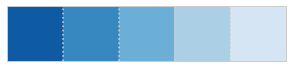

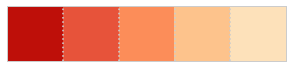

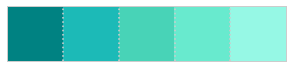

In [9]:
blue_palette = sns.color_palette('Blues_r', n_colors=5) # used for plotting distance to CE
red_palette = sns.color_palette('OrRd_r', n_colors=5) # used for plotting allocative efficiency
teal_palette = sns.color_palette(['#008282', '#1cbab7', '#48D3B7', '#68EACE', '#96F8E5']) # used for plotting Selten index

sns.palplot(blue_palette)
sns.palplot(red_palette)
sns.palplot(teal_palette)

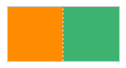

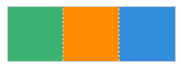

In [10]:
side_colours = {'Seller': 'darkorange', 'Buyer': 'mediumseagreen'}
sns.palplot(side_colours.values())

extraMarg_palette = {'More buyers': side_colours['Buyer'], 'More sellers': side_colours['Seller'], 'Regular and Large': '#308EDB'}
_ = sns.palplot(extraMarg_palette.values())

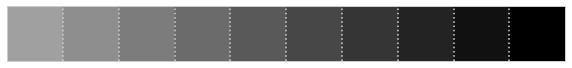

In [11]:
gray_palette = []
n_colours = 10
R1, G1, B1 = [0.7,0.7,0.7]
R2, G2, B2 = [0,0,0]
Rdelta, Gdelta, Bdelta = (R2-R1)/n_colours, (G2-G1)/n_colours, (B2-B1)/n_colours
for col in range(n_colours):
    R1 += Rdelta
    G1 += Gdelta
    B1 += Bdelta
    gray_palette.append((R1, G1, B1))
    
sns.palplot(gray_palette)

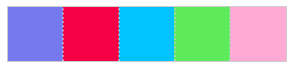

In [12]:
#feedback_palette = {'Full': '#FFC1A7', 'Same': '#F67E7D', 'Other': '#7D7AA2', 'BB': '#5A819E', 'PI': '#6CC2BD'}
feedback_palette = {'BB': '#7678ED', 'Same': '#F60045', 'Other': '#01C4FE', 'Full': '#5EEB5B', 'PI': '#FFAAD4'}

sns.palplot(feedback_palette.values())

# Data overview

[```ipython-tikzmagic``` documentation](https://github.com/mkrphys/ipython-tikzmagic) (prerequisites: ImageMagick, pdf2svg)

In [13]:
%load_ext tikzmagic

preamble = r"""\definecolor{price_rule}{HTML}{586BA4}
\definecolor{market_structure}{HTML}{F5DD90}
\definecolor{feedback}{HTML}{F68E5F}
\definecolor{dynamic}{HTML}{84dcc6}
\usepackage{fourier}
"""

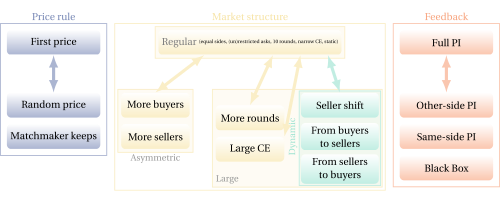

In [14]:
%%tikz -f svg -s 500,200 -l calc,backgrounds -p xcolor -x $preamble
\tikzset{
    block/.style = {shape=rectangle, rounded corners, align=center, minimum size=0.8cm, font=\normalsize},
    price/.style = {top color=white, bottom color=price_rule!50, minimum width=3cm},
    structure/.style = {top color=white, bottom color=market_structure!50, minimum width=2.2cm},
    feedback/.style = {top color=white, bottom color=feedback!50, minimum width=3cm},
    dynamic/.style = {top color=white, bottom color=dynamic!50, minimum width=2.5cm},
    }
    
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %% Market structure
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    \node[block, structure] (ES) at (0,0) {\textcolor{gray}{Regular} \raisebox{0.5\height}{\tiny (equal sides, (un)restricted asks, 10 rounds, narrow CE, static)}};

    % Dynamic markets
    \node[block, dynamic, anchor=north east] (SShift) at ($(ES.south east)+(1.2,-1.2)$) {Seller shift};
    \node[block, dynamic] (FromBtoS) at ($(SShift.south)+(0,-0.6)$) {From buyers\\to sellers};
    \node[block, dynamic] (FromStoB) at ($(FromBtoS.south)+(0,-0.6)$) {From sellers\\to buyers};
    \draw[line width=1mm, <->, >=latex, color=dynamic!50] ($(ES.south)!0.85!(ES.south east)$) -- (SShift.north);

    % More rounds, large CE
    \node[block, structure, anchor=north] (MR) at ($(ES.south |- SShift.center)$) {More rounds};
    \node[block, structure] (LargeCE) at ($(MR.south)+(0,-0.6)$) {Large CE};
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] ($(ES.south)!0.25!(ES.south east)$) -- (MR.north);
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] ($(ES.south)!0.55!(ES.south east)$) -- (LargeCE.north east);
        
    % More buyers, more sellers
    \node[block, structure, anchor=north west] (MB) at ($(ES.south west)+(-1.2,-1.2)$) {More buyers};
    \node[block, structure] (MS) at ($(MB.south)+(0,-0.6)$) {More sellers};
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] ($(ES.south west)!0.5!(ES.south)$) -- (MB.north);
    
    \begin{scope}[on background layer]
        \draw[thick, market_structure!50] ($(MS.south west |- FromStoB.south)+(-0.2,-0.2)$) rectangle ($(SShift.east |- ES.north east)+(0.2,0.2)$);
        \node[market_structure!80, anchor=south] at ($(ES.north)+(0,0.2)$) {Market structure};
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(LargeCE.west |- FromStoB.south)+(-0.1,-0.1)$) rectangle ($(SShift.north east)+(0.1,0.1)$);
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(ES.south west)+(-0.1,-0.1)$) rectangle ($(ES.north east)+(0.1,0.1)$);
        \node[gray!80, anchor=north, font=\small] at ($(MS.south)+(0,-0.05)$) {Asymmetric};
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(MS.south west)+(-0.1,-0.1)$) rectangle ($(MB.north east)+(0.1,0.1)$);
        \node[gray!80, anchor=south west, font=\small] at ($(LargeCE.west |- FromStoB.south)+(-0.1,-0.1)$) {Large};
        
        \draw[thick, dynamic!50, fill=dynamic, opacity=1, fill opacity=0.1] ($(FromStoB.south west)+(-0.05,-0.05)$) rectangle ($(SShift.north east)+(0.05,0.05)$);
        \node[dynamic!80, anchor=south, font=\small, rotate=90] at ($(FromBtoS.west)$) {Dynamic};
    \end{scope}

    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %%  Price rule
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    \node[block, price, anchor=east] (FP) at ($(ES.center)+(-4.8,0)$) {First price};
    \node[block, price, anchor=north] (RP) at ($(FP.south)+(0,-1.2)$) {Random price};
    \node[block, price] (MMK) at ($(RP.south)+(0,-0.6)$) {Matchmaker keeps};
    
    \draw[line width=1mm, <->, >=latex, color=price_rule!50] (FP.south) -- (RP.north);
    
    \begin{scope}[on background layer]
        \draw[thick, price_rule!50] ($(MMK.south west)+(-0.2,-0.2)$) rectangle ($(FP.north east)+(0.2,0.2)$);
        \node[price_rule!80, anchor=south] at ($(FP.north)+(0,0.2)$) {Price rule};
    \end{scope}
    
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %% Feedback
    %%%%%%%%%%%%%%%%%%%%%%%%%%    
    \node[block, feedback, anchor=west] (PI) at ($(ES.center)+(4.8,0)$) {Full PI};
    \node[block, feedback, anchor=north] (Other) at ($(PI.south)+(0,-1.2)$) {Other-side PI};
    \node[block, feedback] (Same) at ($(Other.south)+(0,-0.6)$) {Same-side PI};
    \node[block, feedback] (BB) at ($(Same.south)+(0,-0.6)$) {Black Box};
    \draw[line width=1mm, <->, >=latex, color=feedback!50] (PI.south) -- (Other.north);
    
    \begin{scope}[on background layer]
        \draw[thick, feedback!50] ($(BB.south west)+(-0.2,-0.2)$) rectangle ($(PI.north east)+(0.2,0.2)$);
        \node[feedback!80, anchor=south] at ($(PI.north)+(0,0.2)$) {Feedback};
    \end{scope}

In [15]:
data = []
treatments = dict()

for key, vals in copy.deepcopy(treatment_groups).items():
    k = key[0]
    if k in treatments.keys():
        treatments[k].extend(vals)
    else:
        treatments[k] = vals

for treatment in flatten_list(treatments.values()):
    title = treatment_names[treatment].split(',')
    df_treatment = df[df['treatment'] == treatment]
    
    subjects = len(set(df_treatment['id']))
    markets = len(set(df_treatment['game']))
    observations = len(df_treatment)
    
    data.append(title + [subjects, markets, observations])
    
columns = pd.MultiIndex.from_tuples([('Treatment', col) for col in ['Market structure', 'Feedback', 'Price rule']] + 
                                    [('Experimental data', col) for col in ['Subjects', 'Markets', 'Observations']])
treatment_overview = pd.DataFrame.from_records(data, columns=columns)
treatment_overview = treatment_overview.append(treatment_overview.sum(numeric_only=True), ignore_index=True)
treatment_overview.iloc[:,-3:] = treatment_overview.iloc[:,-3:].astype(int)
treatment_overview[('Experimental data','Subjects')] = treatment_overview.apply(lambda row: '{} ({})'.format(row[('Experimental data','Subjects')], 
                                                                                       row[('Experimental data','Markets')]), axis=1)
treatment_overview.rename({'Subjects': 'Subjects (markets)'}, inplace=True, axis=1, level=1)
treatment_overview.drop('Markets', inplace=True, axis=1, level=1)

Group by (1) market structure (2) feedback (3) price rule

In [16]:
sort_dict = {# Market structure 
             'Regular': 0, 'Regular with restricted asks': 1, 'More buyers': 2, 'More sellers': 3,
             'More rounds': 4, 'Large CE': 5, 'Seller shift': 6, 'From buyers to sellers': 7, 'From sellers to buyers': 8,
             # Feedback
             'Full PI': 0, 'Other-side PI': 1, 'Same-side PI': 2, 'Black Box': 3,
             # Price rule
             'First price': 0, 'Random price': 1, 'Matchmaker keeps': 2}

treatment_overview.sort_values([('Treatment', col) for col in ['Market structure', 'Feedback', 'Price rule']],
                                key=lambda x: x.map(sort_dict))

print(treatment_overview.sort_values([('Treatment', col) for col in ['Market structure', 'Feedback', 'Price rule']],
                                     key=lambda x: x.map(sort_dict)).to_latex(index=False))

Treatment                                     \
                Market structure        Feedback         Price rule   
0                        Regular         Full PI        First price   
2                        Regular   Other-side PI        First price   
3                        Regular    Same-side PI        First price   
4                        Regular    Same-side PI   Matchmaker keeps   
5                        Regular       Black Box        First price   
7                        Regular       Black Box       Random price   
8                        Regular       Black Box   Matchmaker keeps   
1   Regular with restricted asks         Full PI        First price   
6   Regular with restricted asks       Black Box        First price   
9                    More buyers         Full PI        First price   
11                   More buyers       Black Box        First price   
10                  More sellers         Full PI        First price   
12                  More sellers       Black Box        First price   
18                   More rounds       Black Box        First price   
13                      Large CE         Full PI        First price   
17                      Large CE       Black Box        First price   
14                  Seller shift         Full PI        First price   
15        From buyers to sellers         Full PI        First price   
16        From sellers to buyers         Full PI        First price   
19                           NaN             NaN                NaN   

    Experimental data               
   Subjects (markets) Observations  
0              73 (4)         4810  
2              70 (5)         4238  
3              71 (5)         4069  
4              64 (4)         4605  
5              84 (5)         4495  
7              78 (5)         4249  
8              88 (5)         5334  
1              76 (5)         2802  
6              71 (5)         2446  
9             130 (5)         5683  
11            113 (5)         4792  
10            140 (5)         8012  
12            124 (5)         5236  
18             77 (5)         7392  
13           183 (13)         6999  
17             74 (8)         3259  
14             80 (5)         2467  
15             74 (5)         2380  
16             81 (5)         3118  
19         1751 (104)        86386

\begin{tabular}{llllr}
\toprule
                    Treatment & \multicolumn{2}{l}{Experimental data} \\
             Market structure &        Feedback &         Price rule & Subjects (markets) & Observations \\
\midrule
                      Regular &         Full PI &        First price &             73 (4) &         4810 \\
                      Regular &   Other-side PI &        First price &             70 (5) &         4238 \\
                      Regular &    Same-side PI &        First price &             71 (5) &         4069 \\
                      Regular &    Same-side PI &   Matchmaker keeps &             64 (4) &         4605 \\
                      Regular &       Black Box &        First price &             84 (5) &         4495 \\
                      Regular &       Black Box &       Random price &             78 (5) &         4249 \\
                      Regular &       Black Box &   Matchmaker keeps &             88 (5) &         5334 \\
 Regular with restrict

# Market-level data analysis

## Equilibrium price range & gains of trade

In [17]:
def get_valuations(df):
    '''Extract buyer and seller valuations.'''
    valuations = {}
    
    for side, df_side in df.groupby(['side']):
        side_valuations = df_side[['id', 'valuation']].drop_duplicates()['valuation'].tolist()
    
        if side == 'Buyer':
            side_valuations.sort(reverse=True)
        else:
            side_valuations.sort()
    
        valuations[side] = side_valuations
    
    return valuations

def get_equilibrium(df):
    '''Extract the equilibrium price range, the gains of trade,
    and the equilibrium quantity corresponding to a given experimental market.'''
    
    valuations = get_valuations(df)
    buyer_valuations = valuations['Buyer']
    seller_valuations = valuations['Seller']

    GOT = 0
    eq_quantity = min(len(buyer_valuations), len(seller_valuations))
    
    # Find the intersection of supply and demand schedules and compute the corresponding gains of trade 
    for i in range(eq_quantity):
        if seller_valuations[i] > buyer_valuations[i]:
            eq_quantity = i
            break
        else:
            GOT += buyer_valuations[i] - seller_valuations[i]

    EPR = [seller_valuations[eq_quantity-1], buyer_valuations[eq_quantity-1]]
        
    return EPR, GOT, eq_quantity

Game-specific equilibrium price ranges, gains of trade, and equilibrium quantities

In [18]:
equilibrium_price_ranges = {}
gains_of_trade = {}
equilibrium_quantities = {}

for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    if treatment in dynamic_treatments:
        # The structure of these markets changes after round 5
        df_game1 = df_game[(df_game['round'].isin(range(1,6)))]
        df_game2 = df_game[(df_game['round'].isin(range(6,11)))]
        
        EPR1, GOT1, eq_quantity1 = get_equilibrium(df_game1) 
        EPR2, GOT2, eq_quantity2 = get_equilibrium(df_game2)
        
        equilibrium_price_ranges[treatment, game] = [EPR1, EPR2]
        gains_of_trade[treatment, game] = [GOT1, GOT2]
        equilibrium_quantities[treatment, game] = [eq_quantity1, eq_quantity2]
      
    else:
        EPR, GOT, eq_quantity = get_equilibrium(df_game)

        equilibrium_price_ranges[treatment, game] = [EPR]
        gains_of_trade[treatment, game] = [GOT]
        equilibrium_quantities[treatment, game] = [eq_quantity]

Round-specific equilibrium price ranges, gains of trade, and equilibrium quantities

In [19]:
EPR_rounds = {}
GOT_rounds = {}
eq_quantity_rounds = {}

for (treatment, game, rnd), df_round in df.groupby(['treatment', 'game', 'round']):
    EPR, GOT, eq_quantity = get_equilibrium(df_round)

    EPR_rounds[treatment, game, rnd] = EPR
    GOT_rounds[treatment, game, rnd] = GOT
    eq_quantity_rounds[treatment, game, rnd] = eq_quantity

## Convergence to equilibrium price range & allocative efficiency

### Overview of individual sessions

_Left panel_: demand and supply schedules\
_Right panel_: realised prices with a one-standard-deviation interval around the average per round

The area highlighted in red represents the CE price range $\epr{}{}$.

In [20]:
def plot_epr(ax, EPR):
    [epr1, epr2] = EPR
    
    # Equilibrium price range   
    _ = ax.axhline(y=epr1, linestyle='dashed', linewidth=1.0, color='#E24A33', alpha=0.3)
    _ = ax.axhline(y=epr2, linestyle='dashed', linewidth=1.0, color='#E24A33', alpha=0.3)
    _ = ax.axhspan(epr1, epr2, color='#E24A33', alpha=0.15)

def supply_demand_schedule(ax, buyer_valuations, seller_valuations, eq_quantity):    
    # Supply and demand curves
    buyer_valuations = buyer_valuations.copy()
    seller_valuations = seller_valuations.copy()
    
    buyer_valuations.append(min(seller_valuations))
    seller_valuations.append(max(buyer_valuations))
    len_bvals = len(buyer_valuations)
    len_svals = len(seller_valuations)
    
    _ = ax.step(range(len_bvals), buyer_valuations, 
                 color='black', linewidth=1.2, alpha=0.5, where='post');
    _ = ax.step(range(len_svals), seller_valuations, 
                 color='black', linewidth=1.2, alpha=0.5, where='post');
    _ = ax.fill_between(range(eq_quantity+1), 
                        seller_valuations[0:eq_quantity+1],
                        buyer_valuations[0:eq_quantity+1], 
                        step="post", color='grey', alpha=0.15)

    # Layout
    _ = ax.set_xlabel('Player', fontsize=12)
    xmax = max(len_bvals, len_svals) - 1
    _ = ax.set_xticks(np.arange(0.5, xmax, step=1))
    _ = ax.set_xticks(np.arange(0, xmax+1, step=1), minor=True)
    _ = ax.xaxis.grid(True, which='minor')
    _ = ax.xaxis.grid(False, which='major')
    _ = ax.set_xticklabels(range(1, xmax+1), size=12)

    _ = ax.set_ylabel('Price', fontsize=12)
    ymin = (min(seller_valuations)-9)//10*10+10
    ymax = (max(buyer_valuations)+9)//10*10+10

    _ = ax.set_ylim(ymin-5, ymax-5)
    _ = ax.set_yticks(np.arange(ymin, ymax, step=10));
    _ = ax.set_yticklabels(range(ymin, ymax, 10), size=12)  

def price_evolution(ax, df, rounds, colour, label):
    time_elapsed = pd.Series((max(df_game['time'])+9)//10*10, index=rounds)
    time_elapsed = time_elapsed.expanding(1).sum()
    time_elapsed.loc[time_elapsed.first_valid_index() - 1] = 0
    time_elapsed.sort_index(inplace=True)
    time_steps = time_elapsed.rolling(2).mean().shift(-1)[:-1]

    # Add rounds in which no bids were submitted
    missing_rounds = pd.DataFrame({'round': [rnd for rnd in rounds if rnd not in df['round'].unique()]}, columns=df.columns)
    df = df.merge(missing_rounds, how='outer').sort_values(['round','time'])

    # Realised prices
    mask = df['price'].notna().values          
    times = df[mask].apply(lambda row: row['match_time'] + time_elapsed[row['round'] - 1], axis=1)
    _ = ax.plot(times, df[mask]['price'], 'ko-', markersize=6, linewidth=2, alpha=0.6)

    # Error bars
    means = df.groupby(['round'])['price'].mean()
    sdevs = df.groupby(['round'])['price'].std()

    mask = means.notna().values
    out = ax.errorbar(time_steps[mask], means[mask], sdevs[mask].fillna(0), 
                      color=colour, fmt='-o', capsize=1, ms=0, linewidth=2, ecolor=colour)
    _ = ax.fill_between(time_steps[mask], out[1][0].get_data()[1], out[1][1].get_data()[1],
                        alpha=0.2, facecolor=colour, label=label)
    
    if label == 'Sellers':
        _ = ax.legend() 
        
    # Layout
    _ = ax.set_xlabel('Round', fontsize=12);
    _ = ax.set_xticks(ticks=time_steps)
    _ = ax.set_xticks(time_elapsed, minor=True)
    _ = ax.set_xlim(min(time_elapsed)-50, max(time_elapsed)+50)
    _ = ax.xaxis.grid(True, which='minor')
    _ = ax.xaxis.grid(False, which='major')
    _ = ax.set_xticklabels(rounds, size=12)
    
def plot_session(treatment, game):
    EPR = equilibrium_price_ranges[treatment, game]
    
    if len(EPR) == 1:
        if 'MoreRounds' in treatment:
            rounds = [np.arange(1,51)]
        else:
            rounds = [np.arange(1,11)]
    else:
        rounds = [np.arange(1,6), np.arange(6,11)]
    
    global session_plots 
    session_plots = []
    
    for idx, [epr1, epr2] in enumerate(EPR): # output two plots when the market is dynamic
        df_game = df[(df['treatment'] == treatment) & (df['game'] == game) & (df['round'].isin(rounds[idx]))]
        eq_quantity = equilibrium_quantities[treatment, game][idx]
        
        valuations = get_valuations(df_game)
        buyer_valuations = valuations['Buyer']
        seller_valuations = valuations['Seller']
        
        # Prepare the figure layout
        width_ratios = [0.1*max(len(buyer_valuations)-1, len(seller_valuations)-1), 2]        
        
        if 'MoreRounds' in treatment:
            width_ratios[1] *= 2
            figwidth = 15
        elif treatment in dynamic_treatments:
            width_ratios[1] /= 2
            figwidth = 7
        else:
            figwidth = 9
        
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(figwidth,3),
                                       constrained_layout=True, sharey=True, 
                                       gridspec_kw={'width_ratios': width_ratios})

        # Equilibrium price range
        plot_epr(ax1, [epr1, epr2])
        plot_epr(ax2, [epr1, epr2])
        
        ###############################################
        # Left-hand side: demand and supply schedules
        ###############################################       
        supply_demand_schedule(ax1, buyer_valuations, seller_valuations, eq_quantity)

        ###############################################
        # Right-hand side: realised prices
        ###############################################
        df_buyers = df_game[df_game['side'] == 'Buyer']
        price_evolution(ax2, df_buyers, rounds[idx], '#348ABD', 'Buyers')
        
        if 'MMK' in treatment: # in these treatments, buyer and seller deal prices differ
            df_sellers = df_game[df_game['side'] == 'Seller']
            price_evolution(ax2, df_sellers, rounds[idx], 'Coral', 'Sellers')
        
        session_plots.append(fig)

treatments = widgets.Dropdown(options=all_treatments)
games = widgets.Dropdown(options=set(df[df['treatment'] == treatments.value]['game']))

def update_game(*args):
    games.options = set(df[df['treatment'] == treatments.value]['game'])

_ = treatments.observe(update_game, 'value')

_ = interact(plot_session, treatment=treatments, game=games)

button = widgets.Button(description='Save figure')
display(button)

def on_button_clicked(b):
    _ = plot_session(treatments.value, games.value)
        
    for idx, fig in enumerate(session_plots):
        if len(session_plots) == 1:
            fig_title = 'Figures/ExampleSession_{}_G{}.pdf'.format(treatments.value, games.value)
        else:
            fig_title = 'Figures/ExampleSession_{}_G{}_{}.pdf'.format(treatments.value, games.value, idx+1)

        _ = fig.savefig(fig_title, bbox_inches='tight', transparent=True)

button.on_click(on_button_clicked)

interactive(children=(Dropdown(description='treatment', options=('SameMMK', 'BBLargeCE', 'BBMoreS', 'BBRandom'…

Button(description='Save figure', style=ButtonStyle())

Regular, Black Box, First price 1


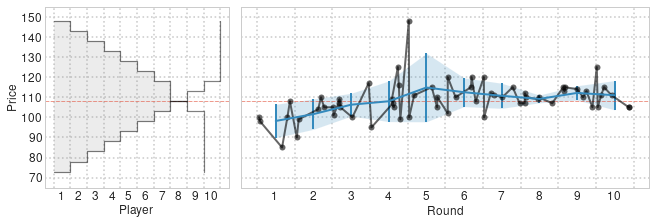

Regular, Black Box, First price 2


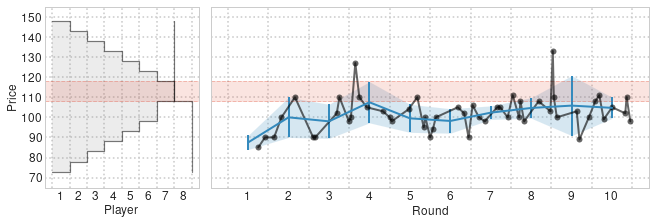

Regular, Black Box, First price 3


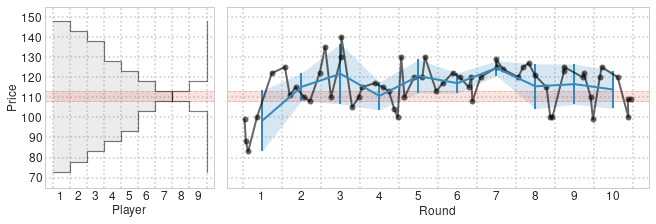

Regular, Black Box, First price 4


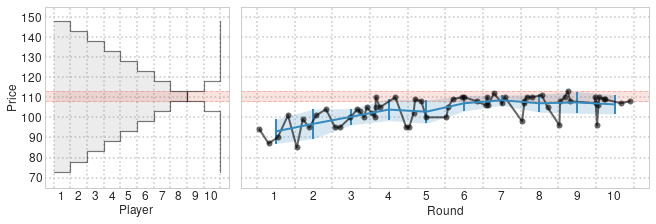

Regular, Black Box, First price 5


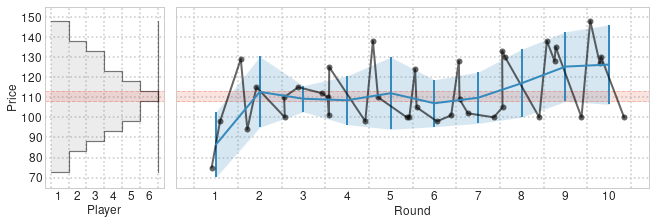

Large CE, Black Box, First price 1


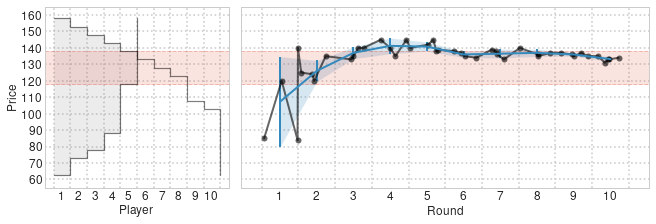

Large CE, Black Box, First price 2


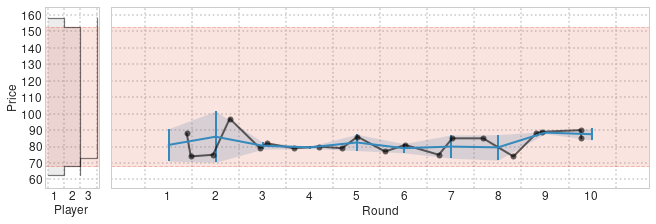

Large CE, Black Box, First price 3


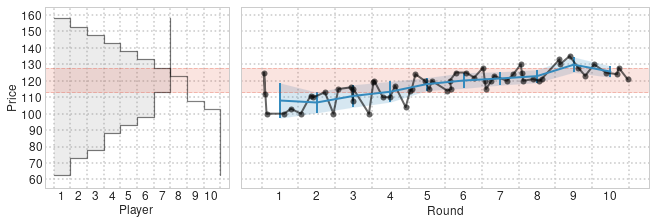

Large CE, Black Box, First price 4


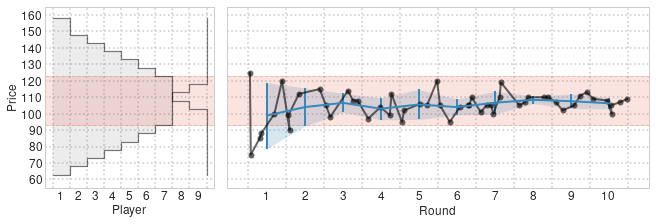

Large CE, Black Box, First price 5


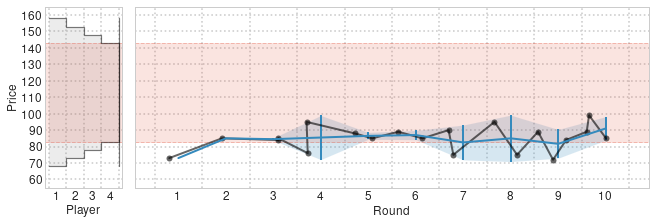

Large CE, Black Box, First price 6


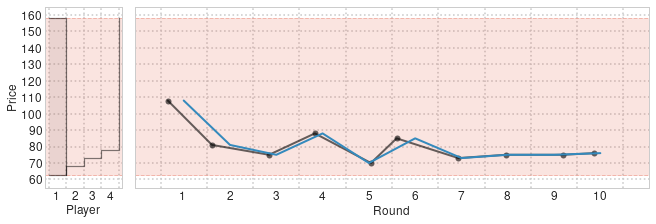

Large CE, Black Box, First price 7


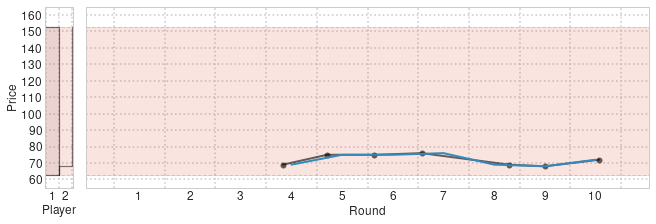

Large CE, Black Box, First price 8


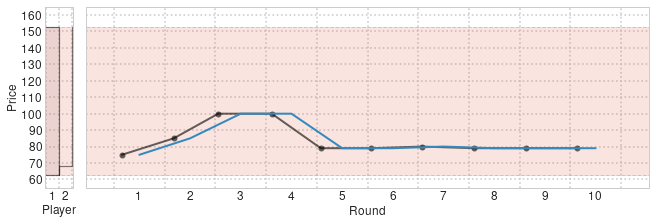

Regular with restricted asks, Black Box, First price 1


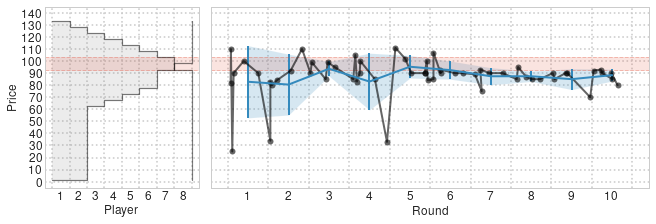

Regular with restricted asks, Black Box, First price 2


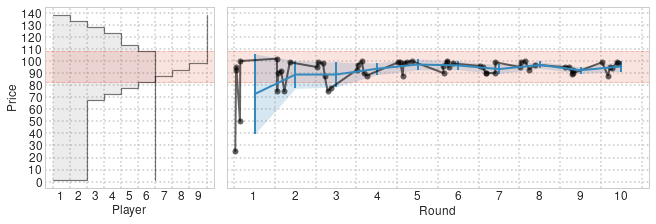

Regular with restricted asks, Black Box, First price 3


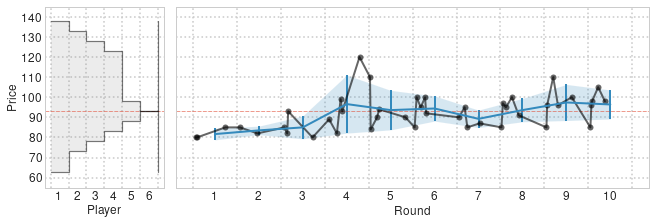

Regular with restricted asks, Black Box, First price 4


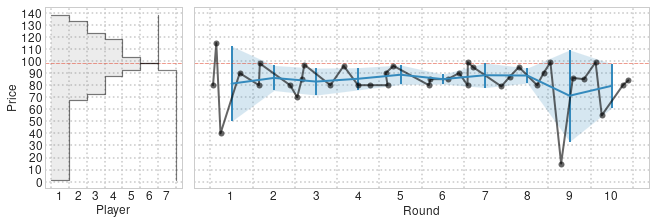

Regular with restricted asks, Black Box, First price 5


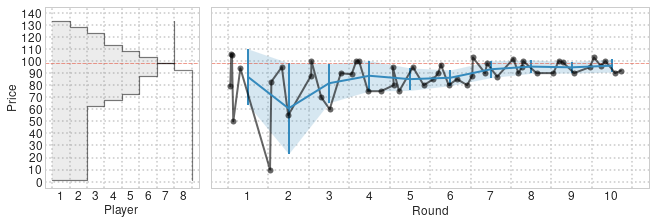

Regular, Black Box, Matchmaker keeps 1


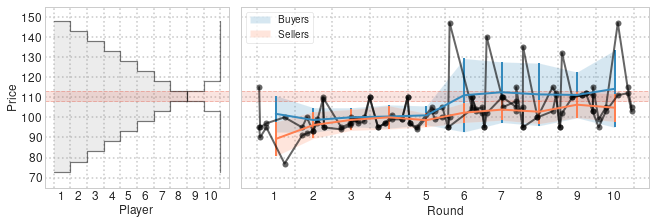

Regular, Black Box, Matchmaker keeps 2


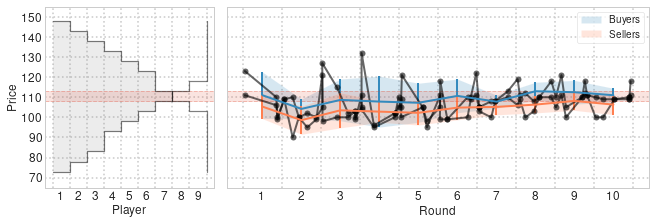

Regular, Black Box, Matchmaker keeps 3


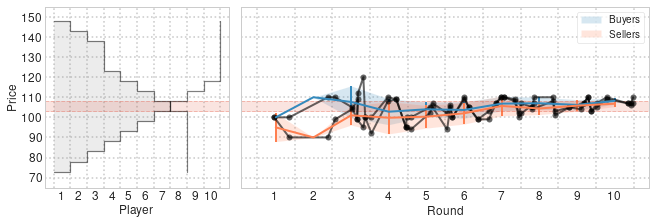

Regular, Black Box, Matchmaker keeps 4


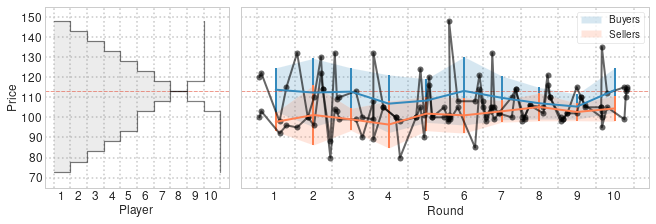

Regular, Black Box, Matchmaker keeps 5


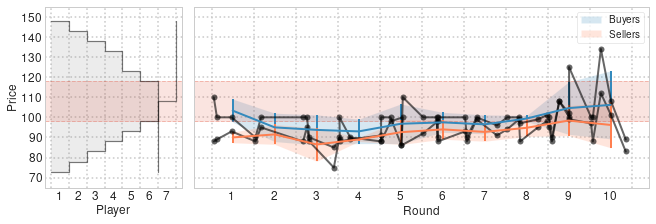

More buyers, Black Box, First price 1


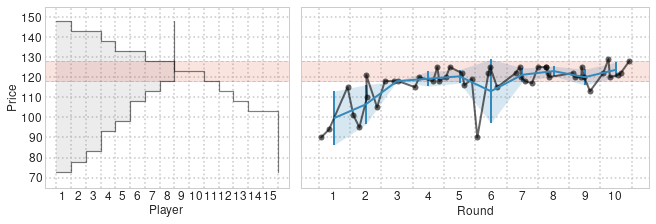

More buyers, Black Box, First price 2


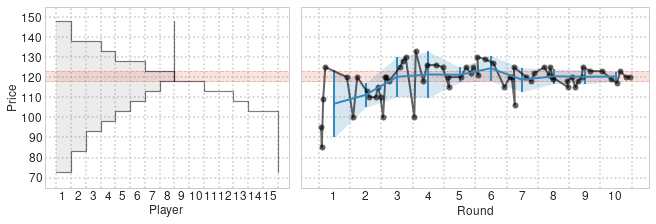

More buyers, Black Box, First price 3


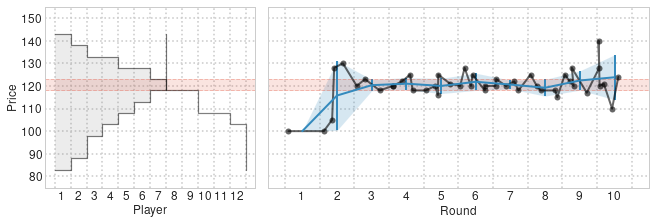

More buyers, Black Box, First price 4


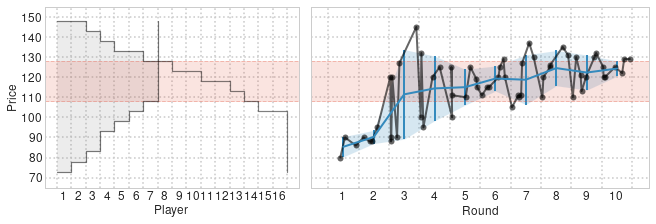

More buyers, Black Box, First price 5


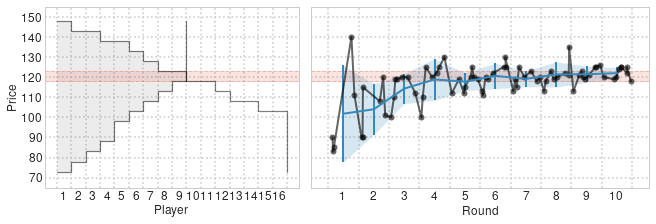

More rounds, Black Box, First price 1


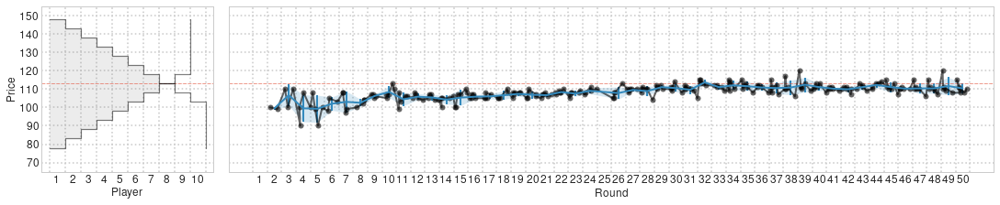

More rounds, Black Box, First price 2


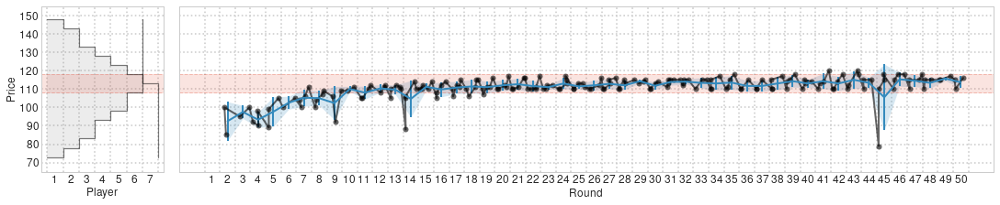

More rounds, Black Box, First price 3


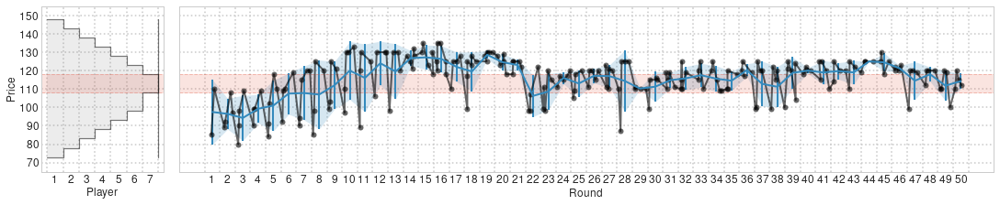

More rounds, Black Box, First price 4


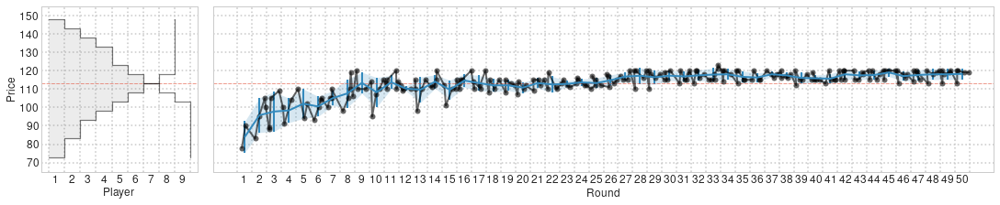

More rounds, Black Box, First price 5


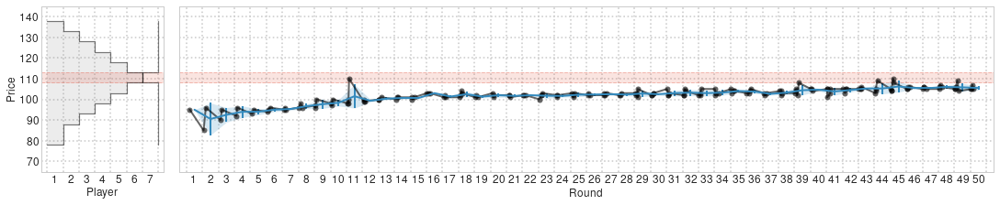

More sellers, Black Box, First price 1


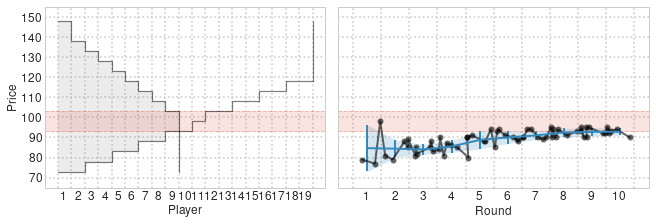

More sellers, Black Box, First price 2


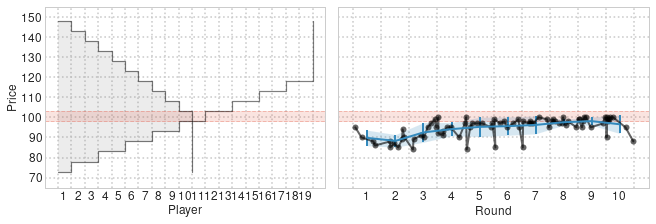

More sellers, Black Box, First price 3


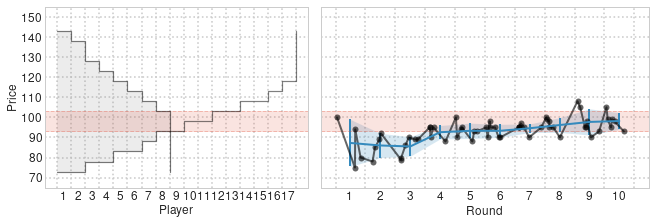

More sellers, Black Box, First price 4


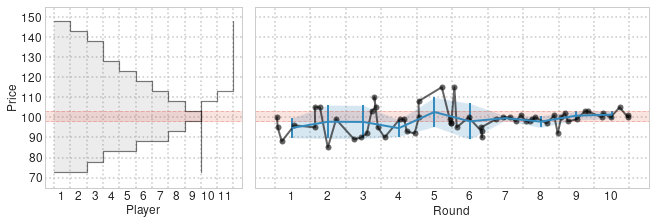

More sellers, Black Box, First price 5


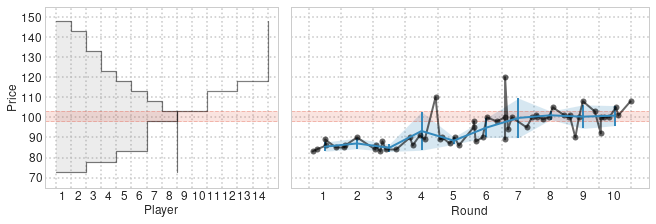

Regular, Black Box, Random price 1


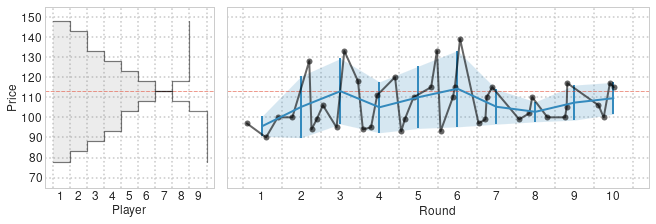

Regular, Black Box, Random price 2


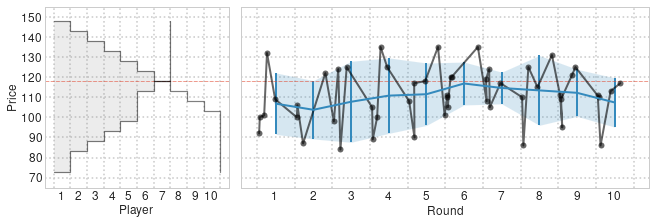

Regular, Black Box, Random price 3


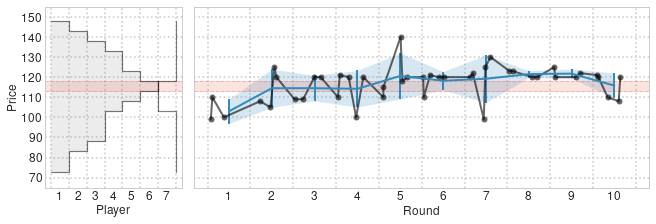

Regular, Black Box, Random price 4


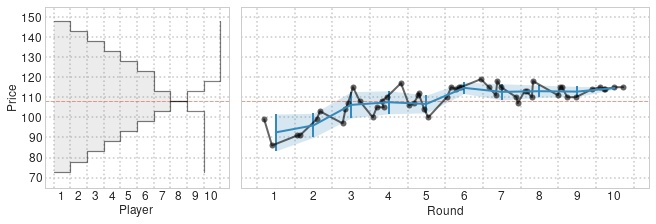

Regular, Black Box, Random price 5


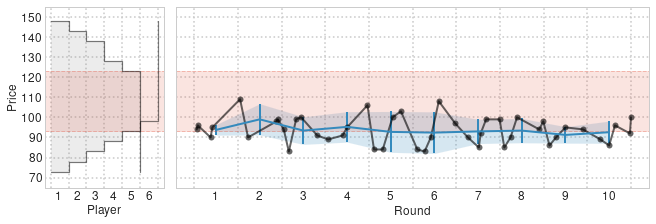

Regular, Full PI, First price 1


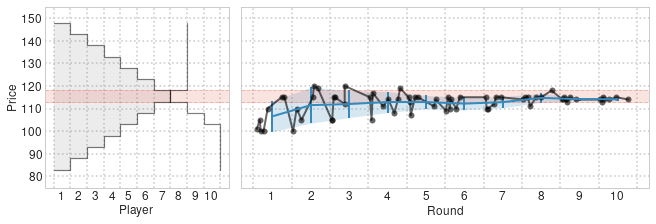

Regular, Full PI, First price 2


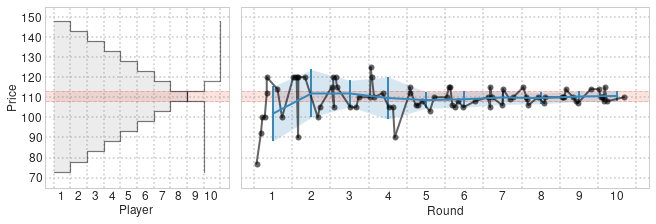

Regular, Full PI, First price 3


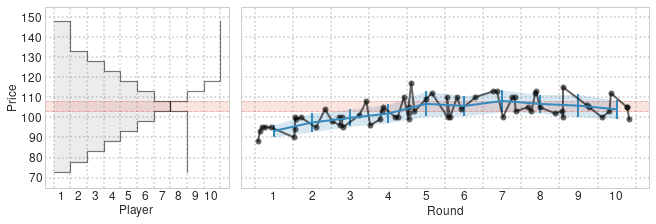

Regular, Full PI, First price 4


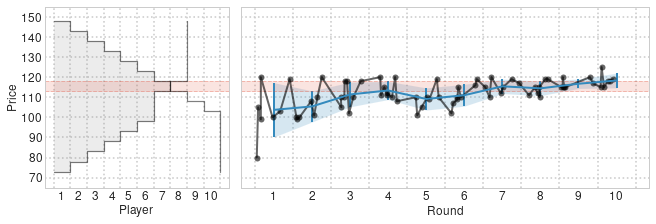

From buyers to sellers, Full PI, First price 1


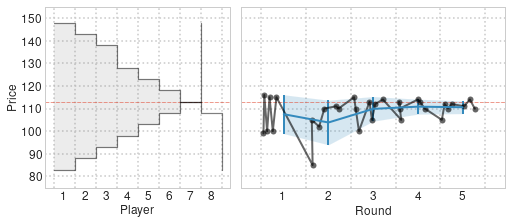

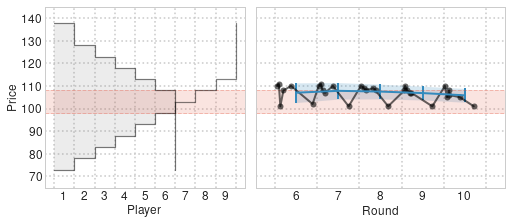

From buyers to sellers, Full PI, First price 2


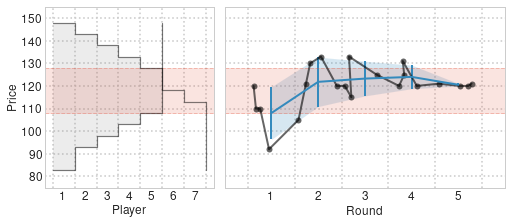

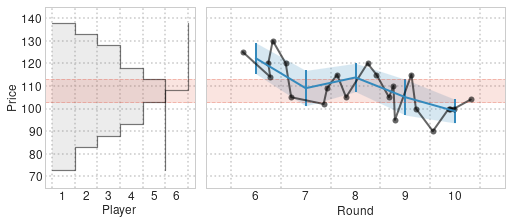

From buyers to sellers, Full PI, First price 3


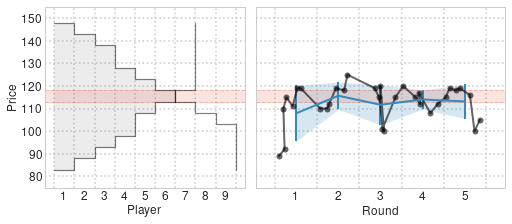

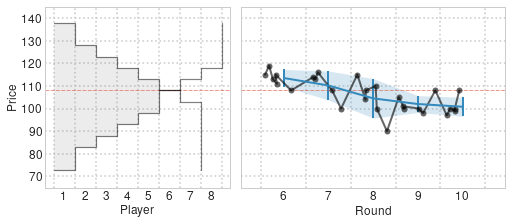

From buyers to sellers, Full PI, First price 4


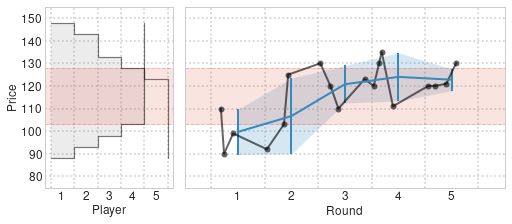

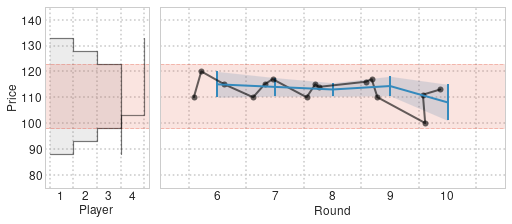

From buyers to sellers, Full PI, First price 5


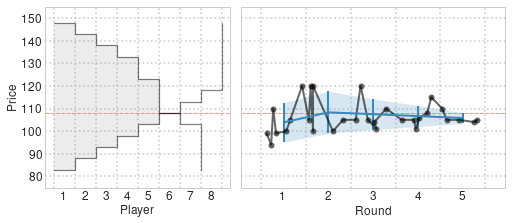

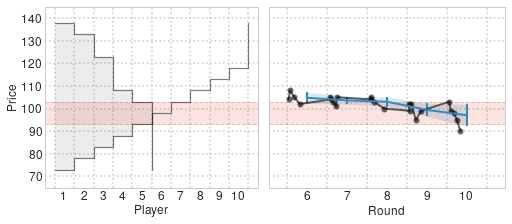

From sellers to buyers, Full PI, First price 1


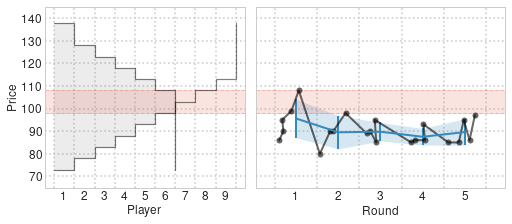

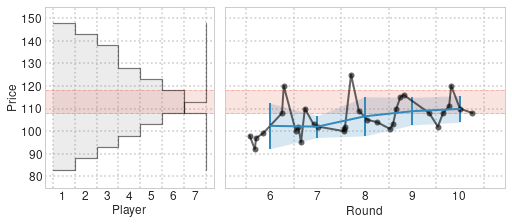

From sellers to buyers, Full PI, First price 2


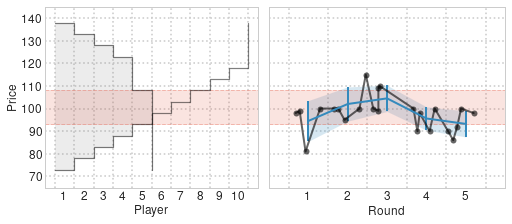

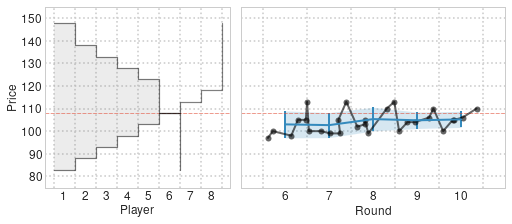

From sellers to buyers, Full PI, First price 3


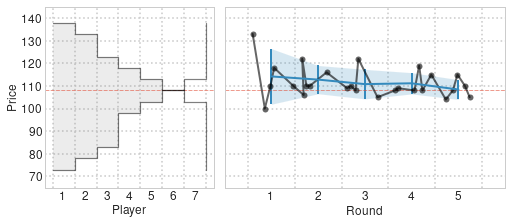

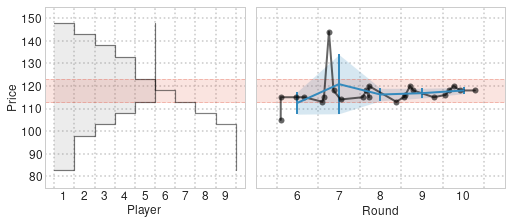

From sellers to buyers, Full PI, First price 4


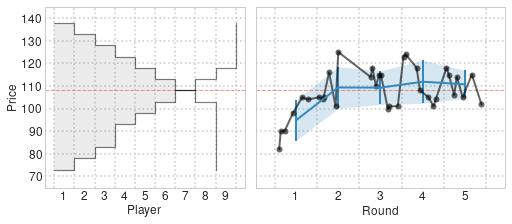

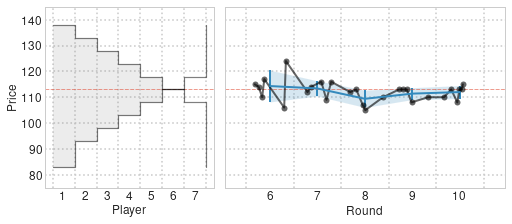

From sellers to buyers, Full PI, First price 5


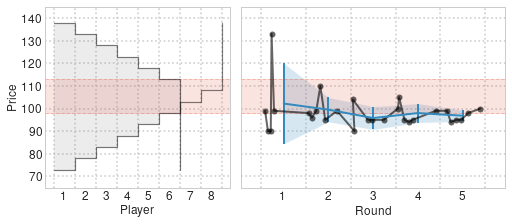

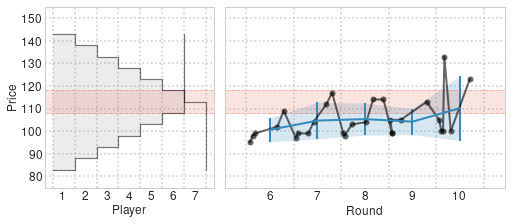

Large CE, Full PI, First price 1


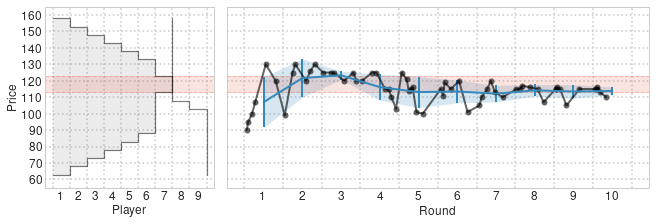

Large CE, Full PI, First price 2


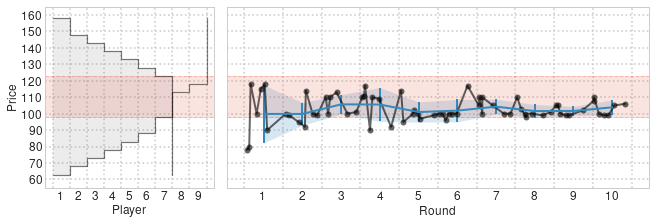

Large CE, Full PI, First price 3


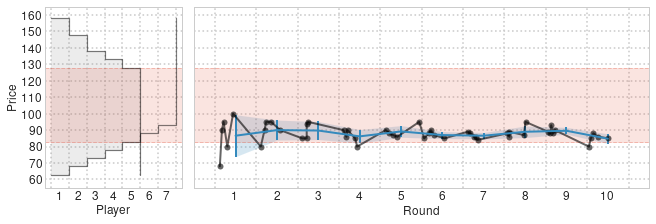

Large CE, Full PI, First price 4


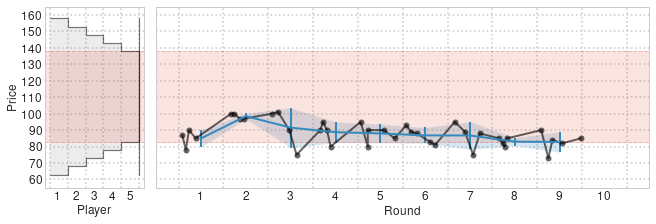

Large CE, Full PI, First price 5


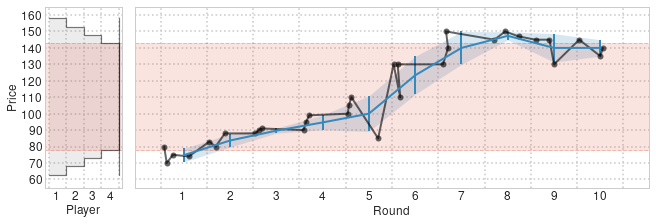

Large CE, Full PI, First price 6


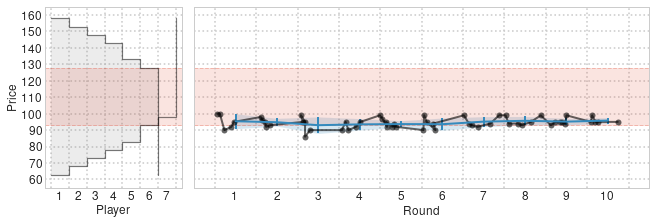

Large CE, Full PI, First price 7


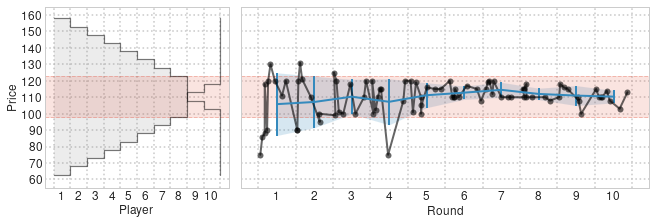

Large CE, Full PI, First price 8


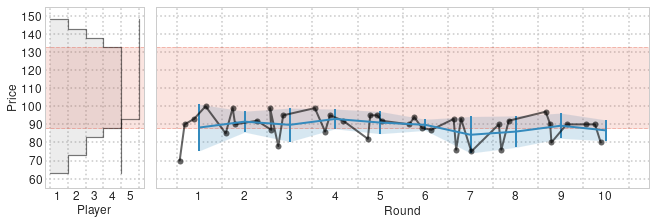

Large CE, Full PI, First price 9


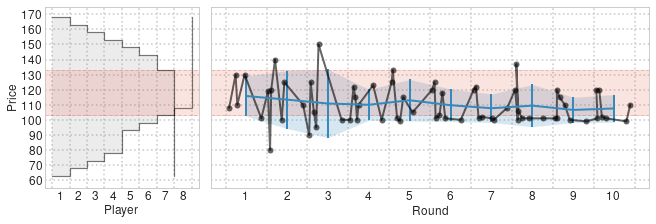

Large CE, Full PI, First price 10


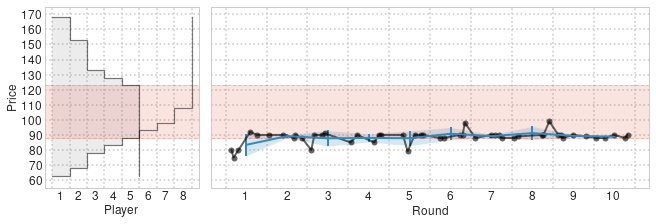

Large CE, Full PI, First price 11


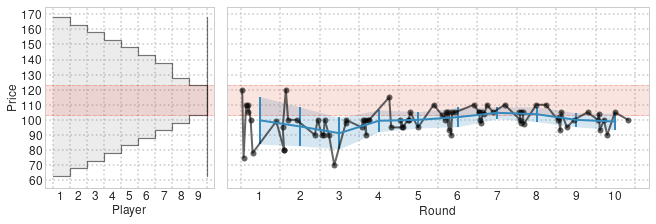

Large CE, Full PI, First price 12


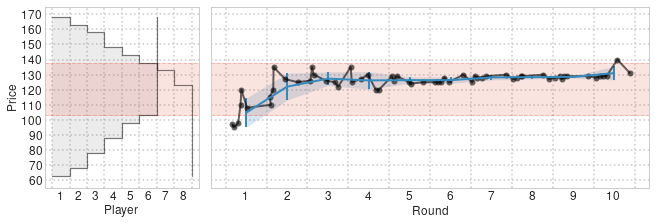

Large CE, Full PI, First price 13


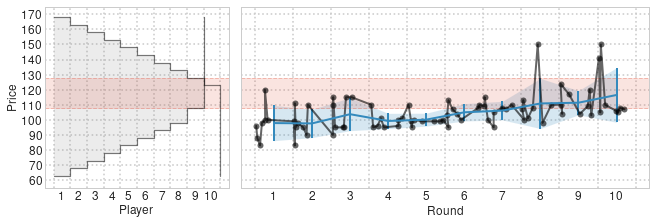

Regular with restricted asks, Full PI, First price 1


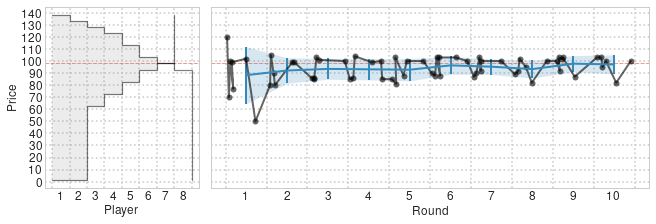

Regular with restricted asks, Full PI, First price 2


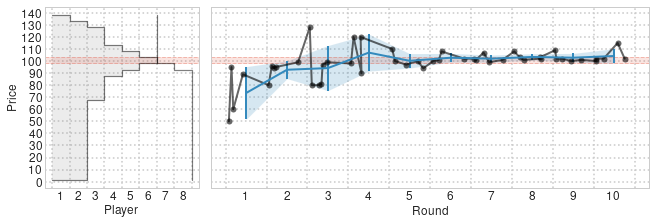

Regular with restricted asks, Full PI, First price 3


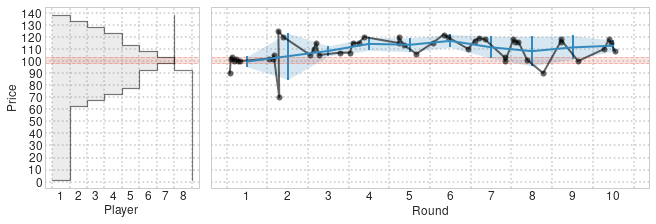

Regular with restricted asks, Full PI, First price 4


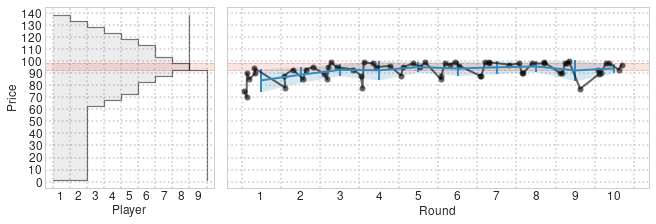

Regular with restricted asks, Full PI, First price 5


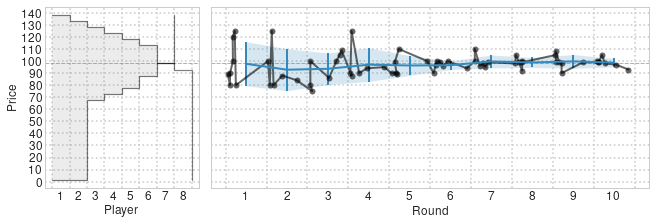

More buyers, Full PI, First price 1


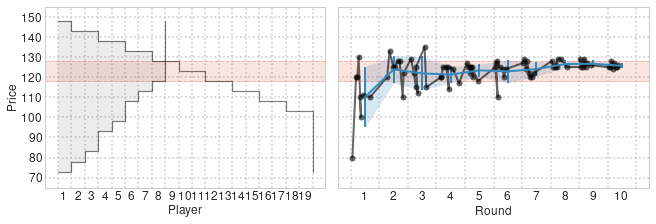

More buyers, Full PI, First price 2


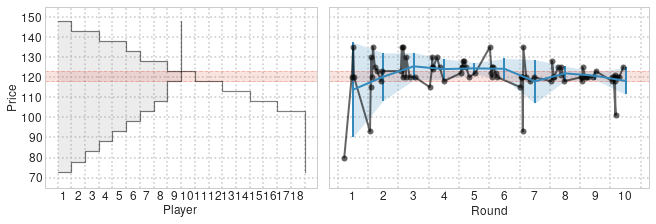

More buyers, Full PI, First price 3


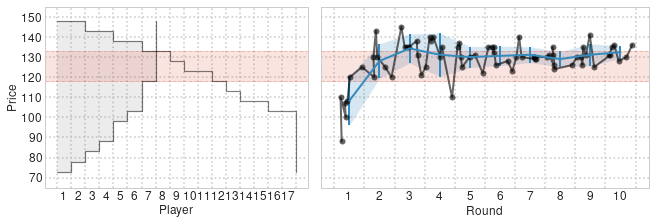

More buyers, Full PI, First price 4


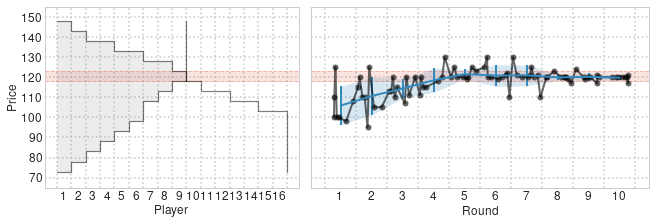

More buyers, Full PI, First price 5


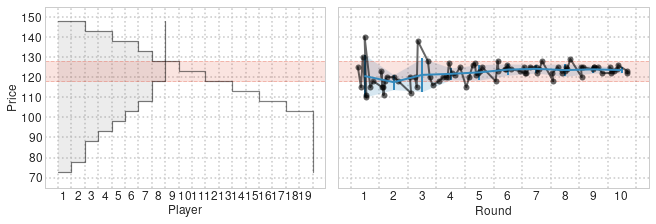

More sellers, Full PI, First price 1


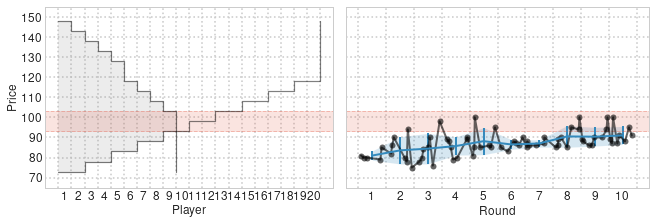

More sellers, Full PI, First price 2


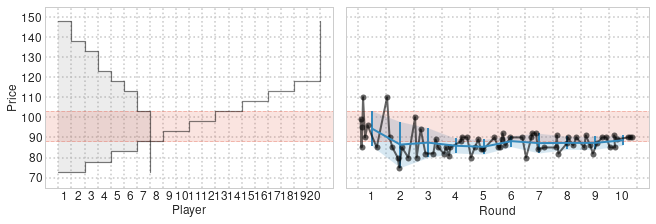

More sellers, Full PI, First price 3


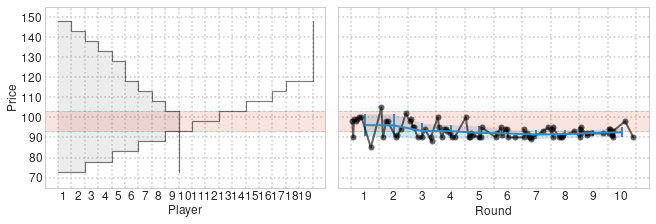

More sellers, Full PI, First price 4


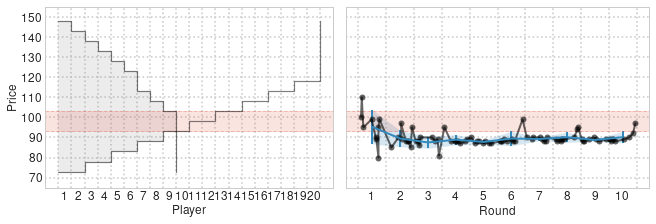

More sellers, Full PI, First price 5


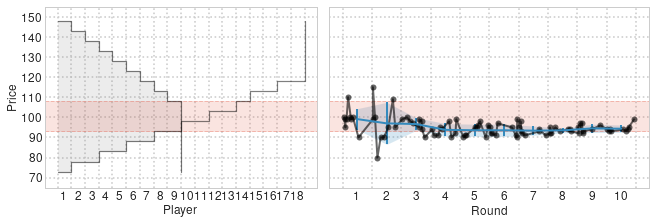

Seller shift, Full PI, First price 1


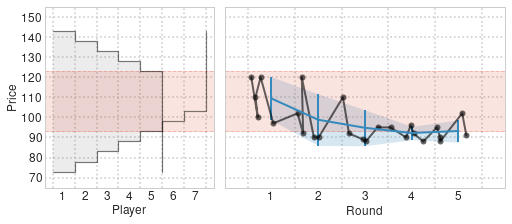

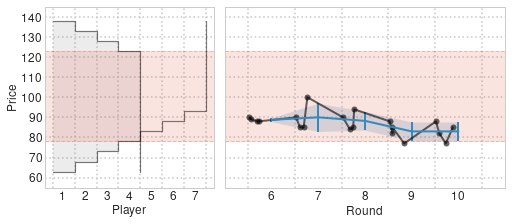

Seller shift, Full PI, First price 2


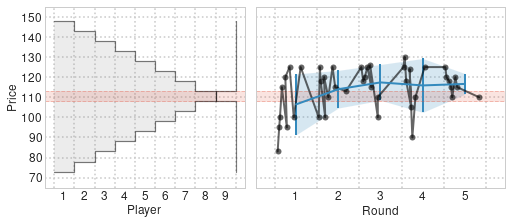

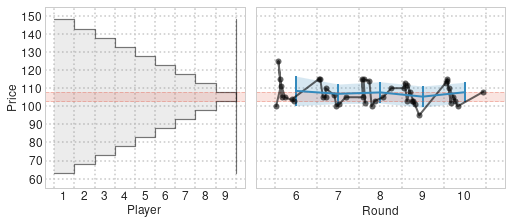

Seller shift, Full PI, First price 3


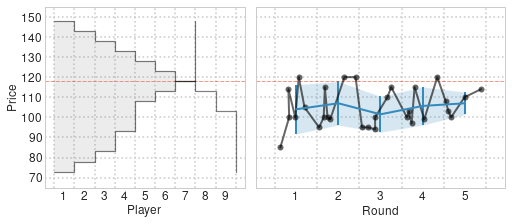

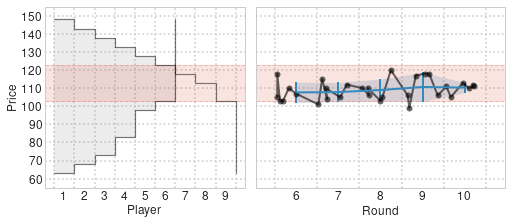

Seller shift, Full PI, First price 4


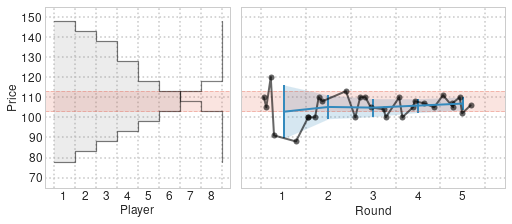

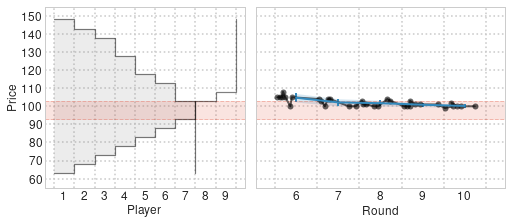

Seller shift, Full PI, First price 5


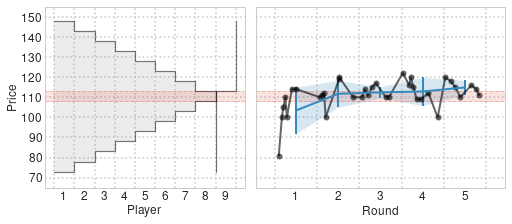

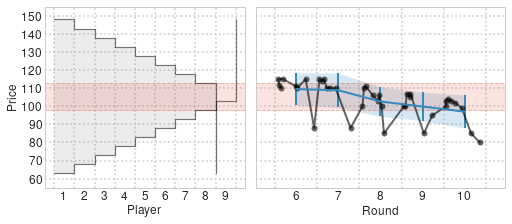

Regular, Other-side PI, First price 1


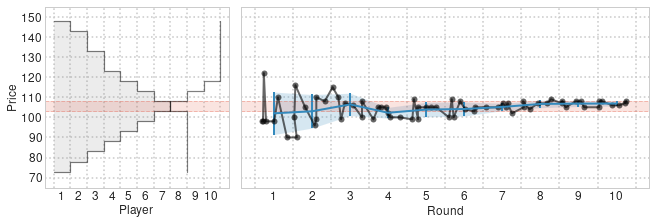

Regular, Other-side PI, First price 2


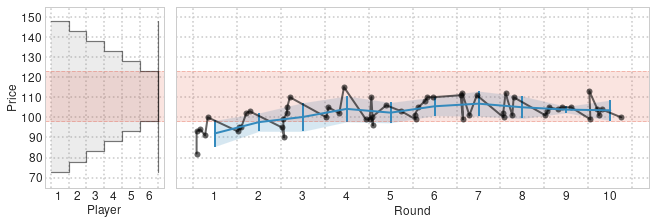

Regular, Other-side PI, First price 3


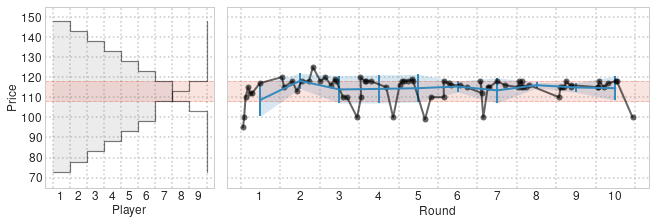

Regular, Other-side PI, First price 4


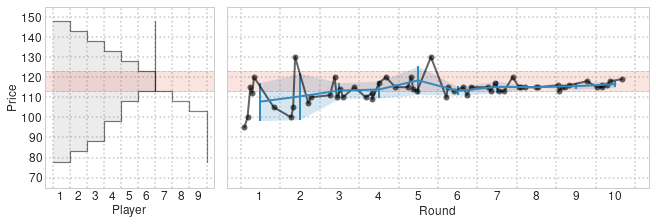

Regular, Other-side PI, First price 5


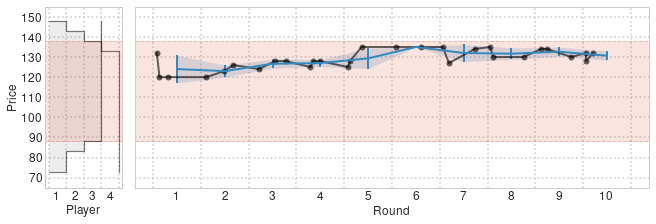

Regular, Same-side PI, First price 1


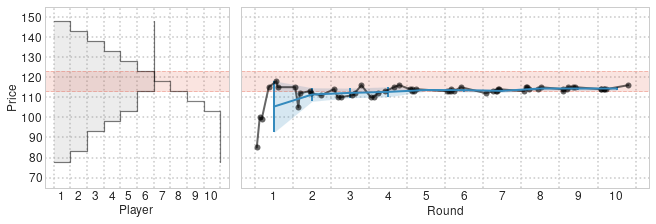

Regular, Same-side PI, First price 2


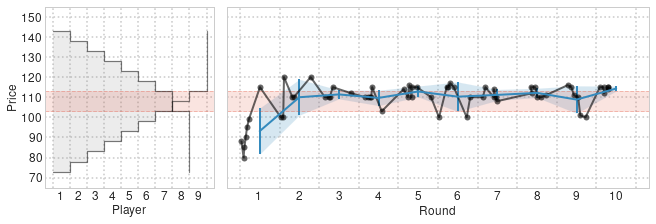

Regular, Same-side PI, First price 3


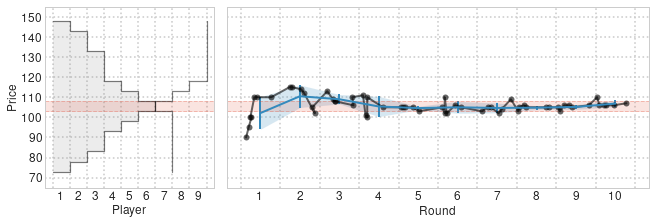

Regular, Same-side PI, First price 4


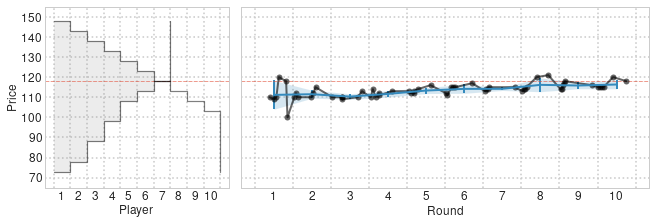

Regular, Same-side PI, First price 5


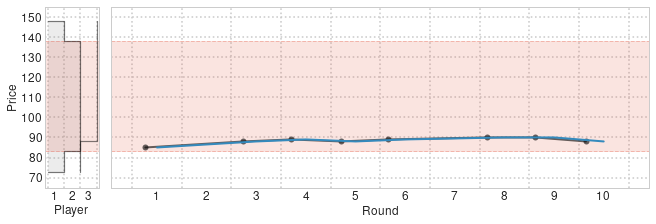

Regular, Same-side PI, Matchmaker keeps 1


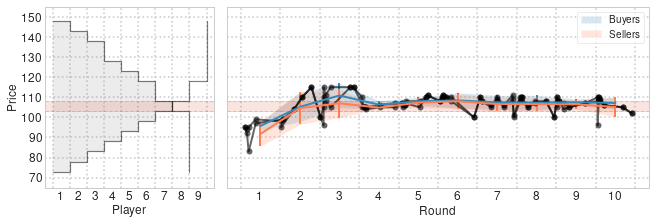

Regular, Same-side PI, Matchmaker keeps 2


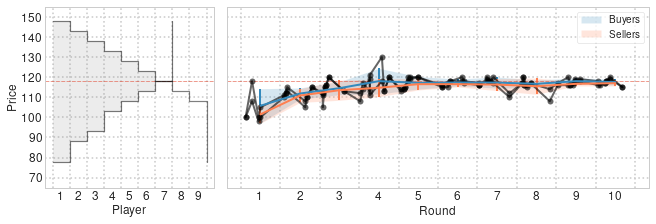

Regular, Same-side PI, Matchmaker keeps 3


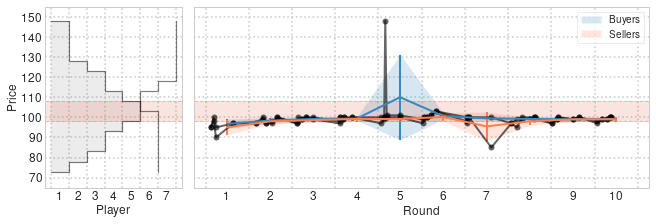

Regular, Same-side PI, Matchmaker keeps 4


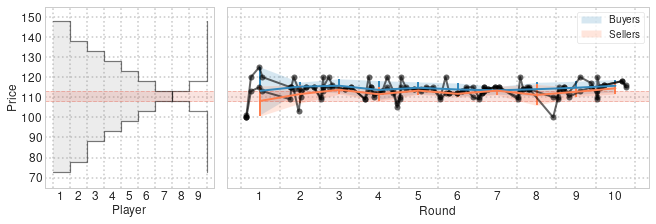

In [21]:
for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    print(treatment_names[treatment], game)
    figures = plot_session(treatment, game)
    _ = plt.show()

#### Black Box versus Private Information

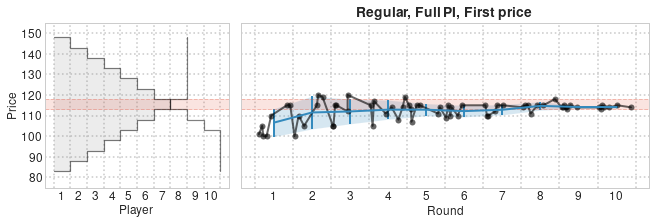

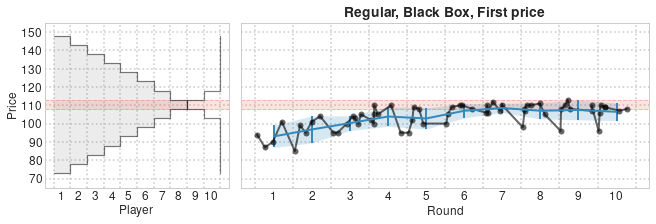

In [22]:
plot_session('Full', 1)
fig = session_plots[0]
#  for ax in fig.axes:
#      _ = ax.get_xaxis().set_ticks([])
#      _ = ax.set_xlabel('')
_ = fig.axes[1].set_title(bold_text(treatment_names['Full']))
_ = plt.savefig('Figures/ExampleSession_PI_G1.pdf', bbox_inches='tight', transparent=True)

plot_session('BB', 4)
_ = plt.title(bold_text(treatment_names['BB']))
_ = plt.savefig('Figures/ExampleSession_BB_G4.pdf', bbox_inches='tight', transparent=True)

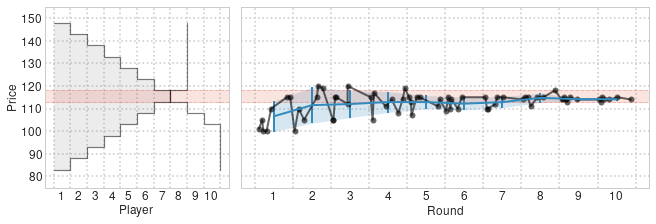

In [23]:
plot_session('Full', 1)
fig = session_plots[0]
_ = plt.savefig('Figures/ExampleSession_PI_G1_noTitle.pdf', bbox_inches='tight', transparent=True)

#### Demand and supply schedules (by experimental design)

Regular

CE range: [108, 113]

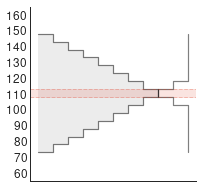

More buyers

CE range: [118, 128]

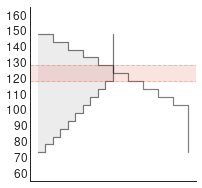

More sellers

CE range: [93, 103]

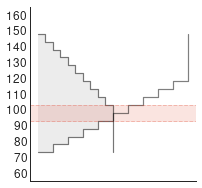

Large CE

CE range: [98, 123]

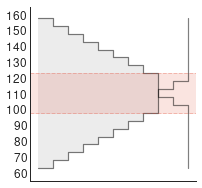

CSR

CE range: [108, 123]

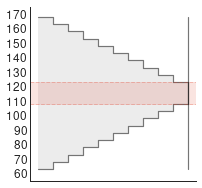

Restricted asks

CE range: [93, 98]

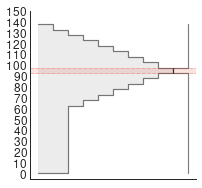

Seller shift

CE range: [108, 113]

CE range: [103, 108]

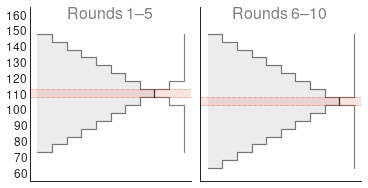

From buyers to sellers

CE range: [113, 118]

CE range: [103, 108]

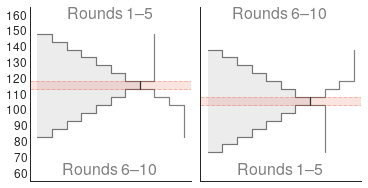

From sellers to buyers

CE range: [103, 108]

CE range: [113, 118]

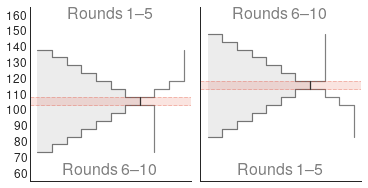

In [24]:
def plot_supply_demand(ax, buyer_valuations, seller_valuations):    
    eq_quantity = min(len(buyer_valuations), len(seller_valuations))

    for i in range(eq_quantity):
        if seller_valuations[i] > buyer_valuations[i]:
            eq_quantity = i
            break

    EPR = [seller_valuations[eq_quantity-1], buyer_valuations[eq_quantity-1]]
    printmd('CE range: {}'.format(EPR))
    
    supply_demand_schedule(ax, buyer_valuations, seller_valuations, eq_quantity)
    plot_epr(ax, EPR)

    _ = ax.set_xlabel('')
    _ = ax.set_xticks(range(max(len(buyer_valuations), len(seller_valuations))+1))
    _ = ax.set_ylabel('')
    _ = ax.set_yticks([10*k for k in range(6,17)])
    _ = ax.set_yticklabels([10*k for k in range(6,17)])
    _ = ax.set_ylim((55,165))
    _ = sns.despine()

market_structures = {'regular': 'Regular', 'moreB': 'More buyers', 'moreS': 'More sellers', 'largeCE': 'Large CE', 'CSR': 'CSR',
                     'LimS': 'Restricted asks', 'SShift': 'Seller shift', 'FromBtoS1': 'From buyers to sellers', 'FromBtoS2': 'From sellers to buyers'}

df_CSR = df_new[df_new['treatment'] == 'CSRnormal']

regular = [148-5*k for k in range(0,10)]
largeCE = list(set(regular).union([153, 158]).difference([113, 118]))
largeCE.sort(reverse=True)
CSR = list(set(df_CSR[df_CSR['side'] == 'Buyer']['valuation']))
CSR.sort(reverse=True)
LimS = [138-5*k for k in range(0,10)]

bvals = {'regular': regular, 'moreB': [148-5*(k//2) for k in range(0,20)], 'moreS': regular, 'largeCE': largeCE, 'CSR': CSR,
         'LimS': LimS, 'SShift': regular, 'FromBtoS1': regular, 'FromBtoS2': [148-5*k for k in range(2,10)]}

regular = [73+5*k for k in range(0,10)]
largeCE = list(set(regular).union([63, 68]).difference([103, 108]))
largeCE.sort()
CSR = list(set(df_CSR[df_CSR['side'] == 'Seller']['valuation']))
CSR.sort()
LimS = [1,1] + [63+5*k for k in range(0,8)]

svals = {'regular': regular, 'moreB': regular, 'moreS': [73+5*(k//2) for k in range(0,20)], 'largeCE': largeCE, 'CSR': CSR,
         'LimS': LimS, 'SShift': [v-10 for v in regular], 'FromBtoS1': [73+5*k for k in range(2,10)], 'FromBtoS2': regular}

for key in bvals.keys():
    printmd(market_structures[key])
    
    if key in ['SShift', 'FromBtoS1', 'FromBtoS2']:
        with sns.axes_style('white'):
            fig, ax = plt.subplots(1,2, figsize=(5,2.5), constrained_layout=True, sharex=True, sharey=True)
        _ = ax[0].set_title('Rounds 1--5', y=0.9, fontsize=16, color='gray')
        _ = ax[1].set_title('Rounds 6--10', y=0.9, fontsize=16, color='gray')
            
    else:
        with sns.axes_style('white'):
            fig, ax = plt.subplots(1,1, figsize=(2.7,2.5), constrained_layout=True)
    
    buyer_valuations = bvals[key]
    seller_valuations = svals[key]
    
    if key == 'SShift':
        plot_supply_demand(ax[0], bvals['regular'], svals['regular'])
        plot_supply_demand(ax[1], buyer_valuations, seller_valuations)

    elif key == 'FromBtoS1':
        plot_supply_demand(ax[0], buyer_valuations, seller_valuations)
        plot_supply_demand(ax[1], bvals['FromBtoS2'], svals['FromBtoS2'])

        _ = ax[0].text(0.5, 0.02, 'Rounds 6--10', fontsize=16, transform=ax[0].transAxes, color='gray',
                       horizontalalignment='center', verticalalignment='bottom')
        _ = ax[1].text(0.5, 0.02, 'Rounds 1--5', fontsize=16, transform=ax[1].transAxes, color='gray',
                       horizontalalignment='center', verticalalignment='bottom')

    elif key == 'FromBtoS2':
        plot_supply_demand(ax[0], buyer_valuations, seller_valuations)
        plot_supply_demand(ax[1], bvals['FromBtoS1'], svals['FromBtoS1'])
        
        _ = ax[0].text(0.5, 0.02, 'Rounds 6--10', fontsize=16, transform=ax[0].transAxes, color='gray',
                       horizontalalignment='center', verticalalignment='bottom')
        _ = ax[1].text(0.5, 0.02, 'Rounds 1--5', fontsize=16, transform=ax[1].transAxes, color='gray',
                       horizontalalignment='center', verticalalignment='bottom')
    else:
        plot_supply_demand(ax, buyer_valuations, seller_valuations)
        
        if key == 'CSR':
            _ = ax.set_ylim((55,175)) 
            _ = ax.set_yticks([10*k for k in range(6,18)])
            _ = ax.set_yticklabels([10*k for k in range(6,18)])
        elif key == 'LimS':
            _ = ax.set_ylim((-5,150)) 
            _ = ax.set_yticks([10*k for k in range(0,16)])
            _ = ax.set_yticklabels([10*k for k in range(0,16)])
    
    _ = plt.savefig('Figures/supplyDemand_{}.pdf'.format(key), bbox_inches='tight', transparent=True)
    _ = plt.show()

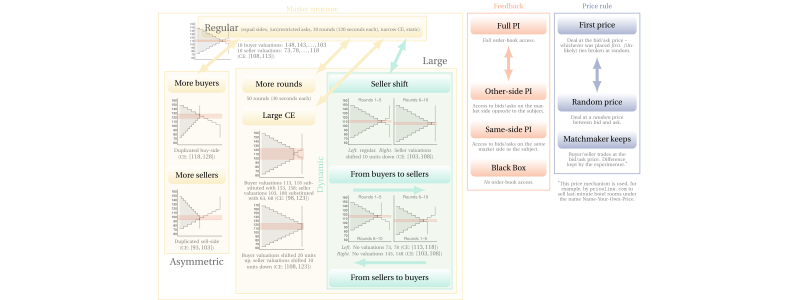

In [25]:
%%tikz -f svg -s 800,300 -l calc,backgrounds -p xcolor -x $preamble
\tikzset{
    block/.style = {shape=rectangle, rounded corners, align=center, minimum size=0.6cm, font=\footnotesize},
    price/.style = {top color=white, bottom color=price_rule!50, minimum width=2.6cm},
    structure/.style = {top color=white, bottom color=market_structure!50, minimum width=1.9cm},
    feedback/.style = {top color=white, bottom color=feedback!50, minimum width=2.5cm},
    dynamic/.style = {top color=white, bottom color=dynamic!50, minimum width=4cm},
    description/.style = {anchor=north, align=center, font=\tiny\linespread{0.8}\selectfont, color=gray, text width=2.8cm},
    }

    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %% Market structure
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    \node[block, structure] (ES) at (0,0) {\normalsize\textcolor{darkgray!80}{Regular} {\tiny\textcolor{gray}{(equal sides, (un)restricted asks, 10 rounds (120 seconds each), narrow CE, static)}}};
    \node (regMarket) at ($(ES.south west)+(0.3,-0.1)$) {\includegraphics[scale=0.2]{Figures/supplyDemand_regular.pdf}};
    \node[description, text width=4cm, anchor=north] (ES_descr) at ($(ES.south)+(-1,-0.05)$) {\begin{tabular}{l} 10 buyer valuations: $148, 143, \ldots, 103$ \\ 10 seller valuations: $73, 78, \ldots, 118$ \\ (CE: $[108, 113]$)\end{tabular}};

    % Dynamic markets
    \node[block, dynamic, anchor=north east] (SShift) at ($(ES.south east)+(0.9,-1.2)$) {Seller shift};
    \node[description, text width=5cm] (SShift_descr) at (SShift.south) {\includegraphics[scale=0.25]{Figures/supplyDemand_SShift.pdf} \\ \emph{Left.} regular. \emph{Right.} Seller valuations shifted 10 units down (CE: $[103, 108]$)};
    \node[block, dynamic] (FromBtoS) at ($(SShift_descr.south)+(0,-0.4)$) {From buyers to sellers};
    \draw[line width=1mm, ->, >=latex, color=dynamic!50] ($(FromBtoS.south)+(-1.2,-0.2)$) -- ($(FromBtoS.south)+(1.2,-0.2)$);
    \node[description, text width=5cm] (FromBtoS_descr) at ($(FromBtoS.south)+(0,-0.2)$) {\includegraphics[scale=0.25]{Figures/supplyDemand_FromBtoS1.pdf} \\ \emph{Left.} No valuations 73, 78 (CE: $[113, 118]$) \emph{Right.} No valuations 143, 148 (CE: $[103, 108]$)};
    \node[block, dynamic] (FromStoB) at ($(FromBtoS_descr.south)+(0,-0.6)$) {From sellers to buyers};
    \draw[line width=1mm, <-, >=latex, color=dynamic!50] ($(FromStoB.north)+(-1.2,0.2)$) -- ($(FromStoB.north)+(1.2,0.2)$);
    \draw[line width=1mm, <->, >=latex, color=dynamic!50] ($(ES.south)!0.85!(ES.south east)$) -- (SShift.north);

    % More rounds, large CE
    \node[block, structure, text width=2.2cm, anchor=north] (MR) at ($(ES.south)+(-1.1,-1.2)$) {More rounds};
    \node[description, text width=2.7cm] (MR_descr) at ($(MR.south)$) {50 rounds (30 seconds each)};
    \node[block, structure, text width=2.2cm] (LargeCE) at ($(MR_descr.south)+(0,-0.4)$) {Large CE};
    \node[description, text width=2.7cm] (LargeCE_descr) at ($(LargeCE.south)$) {\includegraphics[scale=0.25]{Figures/supplyDemand_largeCE.pdf} \\ Buyer valuations 113, 118 substituted with 153, 158; seller valuations 103, 108 substituted with 63, 68 (CE: $[98, 123]$)};
    \node[description, text width=2.7cm] (CSR_descr) at ($(LargeCE_descr.south)+(0,0.2)$) {\includegraphics[scale=0.25]{Figures/supplyDemand_CSR.pdf} \\ Buyer valuations shifted 20 units up, seller valuations shifted 10 units down (CE: $[108, 123]$)};
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] ($(ES.south)!0.35!(ES.south east)$) -- (MR.north east);
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] ($(ES.south)!0.65!(ES.south east)$) -- (LargeCE.north east);
        
    % More buyers, more sellers
    \node[block, structure, anchor=north west] (MB) at ($(ES.south west)+(-1.1,-1.2)$) {More buyers};
    \node[description] (MB_descr) at (MB.south) {\includegraphics[scale=0.25]{Figures/supplyDemand_moreB.pdf} Duplicated buy-side\\(CE: $[118, 128]$)};
    \node[block, structure] (MS) at ($(MB_descr.south)+(0,-0.4)$) {More sellers};
    \node[description] (MS_descr) at (MS.south) {\includegraphics[scale=0.25]{Figures/supplyDemand_moreS.pdf} Duplicated sell-side\\(CE: $[93, 103]$)};
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] ($(ES.south west)!0.35!(ES.south)$) -- (MB.north);
    
    \begin{scope}[on background layer]
        \draw[thick, market_structure!50] ($(MS.south west |- FromStoB.south)+(-0.3,-0.4)$) rectangle ($(SShift.east |- ES.north east)+(0.4,0.2)$);
        \node[market_structure!80, anchor=south, font=\scriptsize] at ($(ES.north)+(0,0.15)$) {Market structure};
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(LargeCE.west |- FromStoB.south)+(-0.2,-0.2)$) rectangle ($(SShift.north east)+(0.2,0.2)$);
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(ES.south west)+(-0.1,-0.1)$) rectangle ($(ES.north east)+(0.1,0.1)$);
        \node[darkgray!80, anchor=north, font=\normalsize] at ($(MS_descr.south)+(0,-0.03)$) {Asymmetric};
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(MS.west |- MS_descr.south)+(-0.1,0)$) rectangle ($(MB.north east)+(0.1,0.1)$);
        \node[darkgray!80, font=\normalsize, anchor=south east] at ($(SShift.north east)+(0,0.15)$) {Large};
        
        \draw[thick, dynamic!50, fill=dynamic, opacity=1, fill opacity=0.1] ($(FromStoB.south west)+(-0.05,-0.05)$) rectangle ($(SShift.north east)+(0.05,0.05)$);
        \node[dynamic!80, anchor=south, font=\small, rotate=90] at ($(FromBtoS.west)$) {Dynamic};
    \end{scope}
    
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %% Feedback
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    \node[block, feedback, anchor=west] (PI) at ($(SShift.east |- ES.center)+(0.65,0.1)$) {Full PI};
    \node[description] (PI_descr) at (PI.south) {\tiny \emph{Full} order-book access.};
    \node[block, feedback, anchor=north] (Other) at ($(PI_descr.south)+(0,-1.2)$) {Other-side PI};
    \node[description] (Other_descr) at (Other.south) {Access to bids/asks on the market side \emph{opposite} to the subject.};
    \node[block, feedback] (Same) at ($(Other_descr.south)+(0,-0.4)$) {Same-side PI};
    \node[description] (Same_descr) at (Same.south)
    {Access to bids/asks on the \emph{same} market side as the subject.};
    \node[block, feedback] (BB) at ($(Same_descr.south)+(0,-0.4)$) {Black Box};
    \node[description] (BB_descr) at (BB.south) {\tiny \emph{No} order-book access.};
    \draw[line width=1mm, <->, >=latex, color=feedback!50] (PI_descr.south) -- (Other.north);
    
    \begin{scope}[on background layer]
        \draw[thick, feedback!50] ($(BB.west |- BB_descr.south)+(-0.1,-0.1)$) rectangle ($(PI.north east)+(0.1,0.1)$);
        \node[feedback!80, anchor=south, font=\scriptsize] at ($(PI.north)+(0,0.15)$) {Feedback};
    \end{scope}
    
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %%  Price rule
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    \node[block, price, anchor=west] (FP) at ($(PI.east |- ES.center)+(0.35,0.1)$) {First price};
    \node[description] (FP_descr) at (FP.south) {Deal at the bid/ask price -- whichever was placed \emph{first}. (Unlikely) ties broken at random.};
    \node[block, price, anchor=north] (RP) at ($(FP_descr.south)+(0,-1.2)$) {Random price};
    \node[description] (RP_descr) at (RP.south) {Deal at a \emph{random} price between bid and ask.};
    \node[block, price] (MMK) at ($(RP_descr.south)+(0,-0.4)$) {Matchmaker keeps};
    \node[description] (MMK_descr) at (MMK.south) {Buyer/seller trades at the bid/ask price. Difference kept by the experimenter.\smash{\raise0.5ex\hbox{*}}};
    
    \draw[line width=1mm, <->, >=latex, color=price_rule!50] (FP_descr.south) -- (RP.north);
    
    \node[description, text width=3.2cm] (MMK_footnote) at ($(MMK_descr.south)+(0,-0.25)$) {\smash{\raise0.5ex\hbox{*}}This price mechanism is used, for example, by \texttt{priceline.com} to sell last-minute hotel rooms under the name Name-Your-Own-Price.};
    
    \begin{scope}[on background layer]
        \draw[thick, price_rule!50] ($(MMK.west |- MMK_descr.south)+(-0.1,-0.1)$) rectangle ($(FP.north east)+(0.1,0.1)$);
        \node[price_rule!80, anchor=south, font=\scriptsize] at ($(FP.north)+(0,0.15)$) {Price rule};
    \end{scope}

### Comparison across treatments

_Distance to CE_: signed distance between realised prices and closest equilibrium. The panels show the realised price averages with a one-standard-deviation interval around the average per round.

_Allocative efficiency_: allocative efficiency, i.e., the realised gains of trade as the percentage of the maximum attained by competitive equilibrium. The panels show the average realised efficiency with an interval indicating the least and the most efficient markets around it.

**Note**: all market sessions subject to the treatment under consideration and _per-round_ CE ranges are taken into account

In [26]:
def distances_to_EPR(df, treatment, game, rnd):
    [epr1, epr2] = EPR_rounds[treatment, game, rnd]
    prices = df['price'].dropna()

    distances = []
    
    for price in prices:    
        if price > epr2:
            distances.append(price - epr2)
        elif price < epr1:
            distances.append(price - epr1)
        else:
            distances.append(0)
    
    return distances

def allocative_efficiency(df, treatment, game, rnd):
    GOT = GOT_rounds[treatment, game, rnd]
    realised_vals = get_valuations(df[df['price'].notna()])
    
    return (sum(realised_vals.get('Buyer', [])) - sum(realised_vals.get('Seller', [])))/GOT

def mean_evolution(ax, df, fun, errorbar_type, alpha=0.2, **kwargs):
    means = []
    kwargs_fun = kwargs.get('extra_params', {})
    
    if errorbar_type == 'sdev':
        sdevs = []
    elif errorbar_type == 'minmax':
        lower_bounds = []
        upper_bounds = []
    
    for rnd, df_round in df.groupby(['round']):
        yvals = []
        
        for (treatment, game), df_game in df_round.groupby(['treatment', 'game']):
            yvals.append(fun(df_game, treatment, game, rnd, **kwargs_fun))
    
        yvals = list(flatten_list(yvals))
        means.append(np.nanmean(yvals))

        if errorbar_type == 'sdev':
            sdevs.append(np.nanstd(yvals))
        elif errorbar_type == 'minmax':
            lower_bounds.append(np.nanmean(yvals) - min(yvals))
            upper_bounds.append(max(yvals) - np.nanmean(yvals))
    
    if errorbar_type == 'sdev':
        bars = sdevs
    elif errorbar_type == 'minmax':
        bars = np.vstack((lower_bounds, upper_bounds))
    
    colour = ecolor = facecolor = kwargs.get('colour')
    label = kwargs.get('label')
    
    rounds = range(1, len(means)+1)
    out = ax.errorbar(rounds, means, bars, 
                      color=colour, fmt='-o', ms=8, capsize=1, 
                      ecolor=colour, label='{}'.format(label))
    _ = ax.fill_between(rounds, out[1][0].get_data()[1], out[1][1].get_data()[1], 
                        alpha=alpha, facecolor=colour)

def treatment_subplot(ax, treatment, fun, errorbar_type):
    df_treatment = df[df['treatment'] == treatment]
    
    # Dynamic markets change after round 5
    if treatment in dynamic_treatments:
        _ = ax.axvline(x=5.5, linestyle='dashed', linewidth=2.0, color='darkgrey', alpha=0.8)

    # Distances to equilibrium price range
    if fun == distances_to_EPR:
        df_side = df_treatment[df_treatment['side'] == 'Buyer']   
        mean_evolution(ax, df_side, fun, errorbar_type, **{'colour': '#348ABD', 'label': 'Buyers'})

        # Equilibrium price ranges collapse to the line through the origin
        _ = ax.axhline(y=0, linestyle='solid', linewidth=5.0, color='darkgrey', alpha=0.8)
        
        if 'MMK' in treatment:
            df_side = df_treatment[df_treatment['side'] == 'Seller']
            mean_evolution(ax, df_side, fun, errorbar_type, **{'colour': 'darkmagenta', 'label': 'Seller'})
            _ = ax.legend(loc='lower right', fontsize=10)
        
        yticks = np.arange(-30,20,10)
        _ = ax.set_ylim(min(yticks)-5,max(yticks)+5)
    
    # Allocative efficiency
    elif fun == allocative_efficiency:
        mean_evolution(ax, df_treatment, fun, errorbar_type, **{'colour': '#E24A33'})
        
        yticks = np.arange(0,1.1,0.2).round(1)
        _ = ax.set_ylim(min(yticks)-0.1,max(yticks)+0.1)
        
    # Selten index
    elif fun == Selten_index:
        mean_evolution(ax, df_treatment, fun, errorbar_type, **{'colour': 'aquamarine', 'label': 'CE area', 'extra_params': {'output': 'area'}})
        mean_evolution(ax, df_treatment, fun, errorbar_type, **{'colour': 'turquoise', 'label': 'Hit rate', 'extra_params': {'output': 'hitRate'}})
        mean_evolution(ax, df_treatment, fun, errorbar_type, **{'colour': 'teal', 'label': 'Selten index', 'extra_params': {'output': 'SI'}})
    
        yticks = np.arange(-1,1.1,0.5).round(1)
        _ = ax.set_ylim(min(yticks)-0.1,max(yticks)+0.1)
        _ = ax.legend(loc='lower right', fontsize=10)
    
    # Subplot layout
    if 'MoreRounds' in treatment:
        xticks = range(0,60,10)
    else:
        xticks = range(1,11)
        
    _ = ax.set_xticks(xticks)
    _ = ax.set_xticklabels(xticks, size=12)

    _ = ax.set_yticks(yticks)
    _ = ax.set_yticklabels(yticks, size=12)          

def emphasise_text(string, separator, part):
    new_string = string.split(separator)
    new_string[part] = bold_text(new_string[part])
    new_string = separator.join(new_string)
    return new_string
    
def treatment_grid(treatments, suptitle, bold_title_part, functions, **kwargs):
    factor = len(functions)
    (rows, columns) = np.shape(treatments)
    fig, ax = plt.subplots(rows*factor, columns, figsize=(14,2.5*rows*factor), 
                           sharex='col', sharey='row', constrained_layout=True, **kwargs)
    ax = ax.flatten()
    
    for idx, treatment in enumerate(flatten_list(treatments)):
        if idx >= 4:
            idx = idx+(factor-1)*columns
        
        for j, (fun, errorbar_type) in enumerate(functions):
            treatment_subplot(ax[idx+j*columns], treatment, fun, errorbar_type)
        
        title = emphasise_text(treatment_names[treatment], separator=', ', part=bold_title_part)
        title = title.replace('Matchmaker keeps', 'Matchm. keeps')
        title = title.replace('Regular with restricted asks', 'Reg. restr. asks')
        title = title.replace('From buyers to sellers', 'From B to S')
        title = title.replace('From sellers to buyers', 'From S to B')
        _ = ax[idx].set_title(title, fontsize=14)

    _ = plt.suptitle(bold_text(suptitle), fontsize=16)
    
    return fig, ax

_Top_: distance to CE\
_Bottom_: allocative efficiency

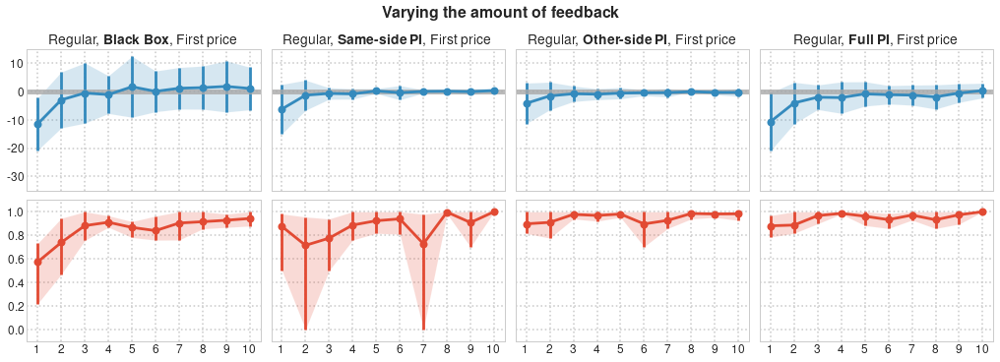

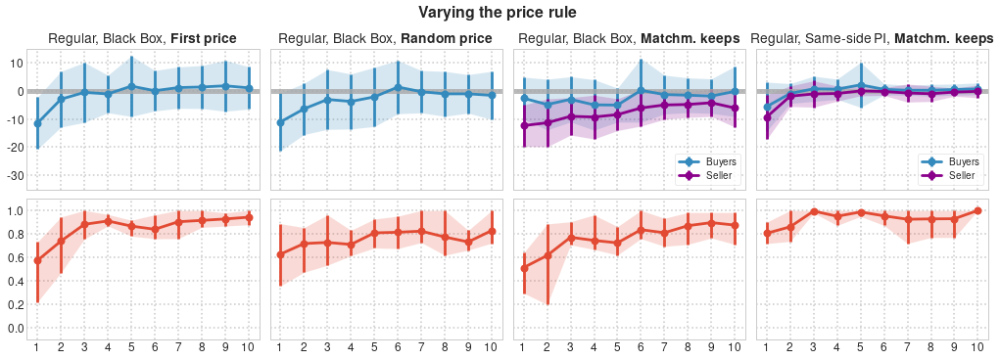

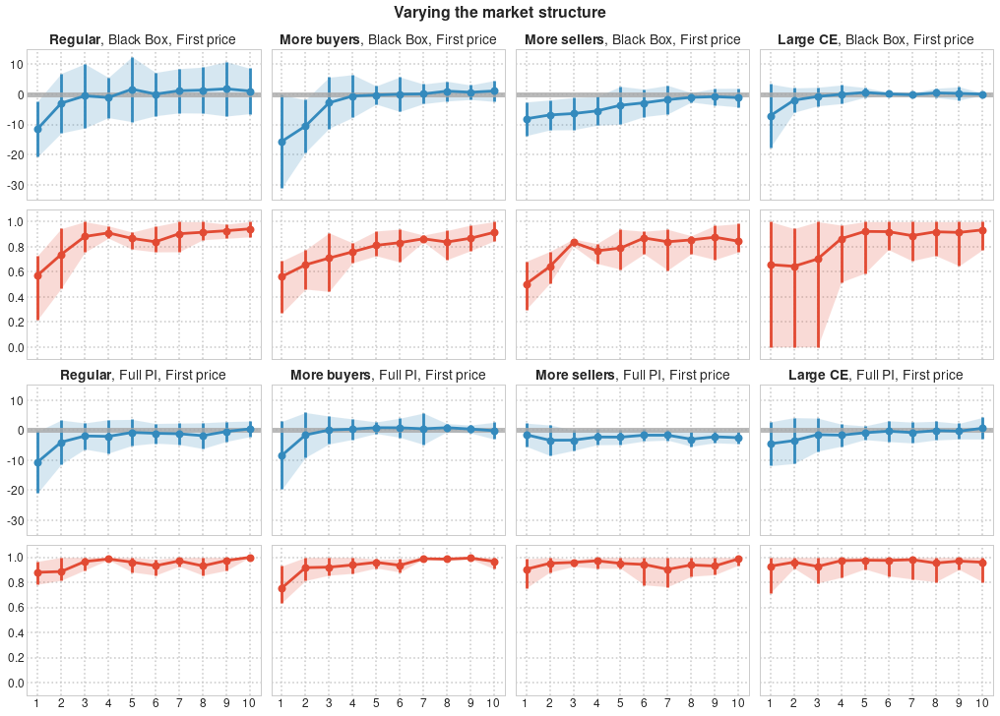

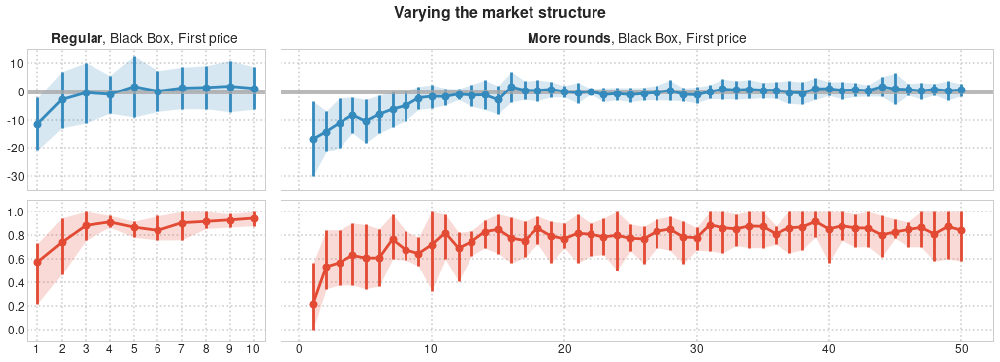

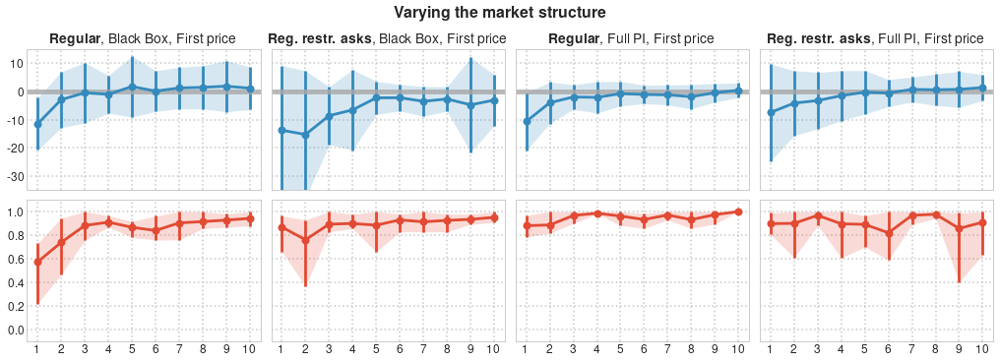

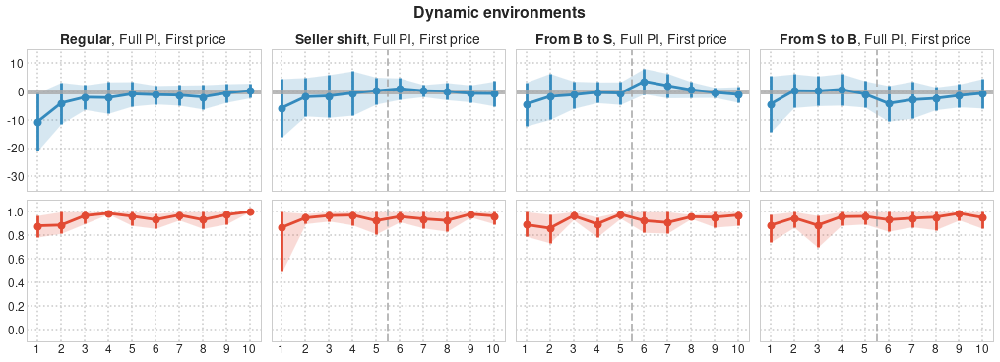

In [27]:
treatment_grid_arrangement = {'feedback': [['BB', 'Same', 'Other', 'Full']],
                              'price': [['BB', 'BBRandom', 'BBMMK', 'SameMMK']],
                              'structure_1': [['BB', 'BBMoreB', 'BBMoreS', 'BBLargeCE'], ['Full', 'FullMoreB', 'FullMoreS', 'FullLargeCE']],
                              'structure_2': [['BB', 'BBMoreRounds']],
                              'structure_3': [['BB', 'BBLimS', 'Full', 'FullLimS']],
                              'dynamics': [['Full', 'FullSShift', 'FullFromBtoS', 'FullFromStoB']]}

for key, treatments in treatment_grid_arrangement.items():
    dim = key.split('_')[0]
    
    suptitle = treatment_dimensions[dim][1]
    bold_title_part = treatment_dimensions[dim][2]
        
    if 'MoreRounds' in ' '.join(flatten_list(treatments)):
        kwargs = {'gridspec_kw': {'width_ratios': [1, 3]}} # reserve more space for the treatment with more periods
    else:
        kwargs = {}
    
    fig, ax = treatment_grid(treatments=treatments, suptitle=suptitle, bold_title_part=bold_title_part, functions=[(distances_to_EPR, 'sdev'), (allocative_efficiency, 'minmax')], **kwargs)

#     _ = plt.savefig('Figures/EPR_AllEff_{}.pdf'.format(key), bbox_inches='tight', transparent=True)

#### Comparison across groups of treatments

In [28]:
def grid_layout(ax, fun):
    xticks = range(1,11)
    _ = ax.set_xticks(xticks)
    _ = ax.set_xticklabels(xticks, size=12)

    if fun == distances_to_EPR:
        # Equilibrium price ranges collapse to the line through the origin
        _ = ax.axhline(y=0, linestyle='solid', linewidth=5.0, color='darkgrey', alpha=0.8)

        yticks = np.arange(-30,20,10)
        _ = ax.set_ylim(min(yticks)-5,max(yticks)+5)

    elif fun == allocative_efficiency:
        yticks = np.arange(0,1.1,0.2).round(1)
        _ = ax.set_ylim(min(yticks)-0.1,max(yticks)+0.1)
    
    elif (fun == Selten_index) or (fun == Selten_eps3):
        yticks = np.arange(-1,1.1,0.5).round(1)
        _ = ax.set_ylim(min(yticks)-0.1,max(yticks)+0.1)        
    
    _ = ax.set_yticks(yticks)
    _ = ax.set_yticklabels(yticks, size=12)

def treatment_grid_combined(treatments, fun, errorbar_type, colours):
    def treatment_subplot(ax):
        df_treatment = df[df['treatment'] == treatment].copy()
        label = treatment_names[treatment]

        if 'MoreRounds' in treatment:
            ax2 = ax.twiny() # add an additional x-axis on top
            ax.set_zorder(1)
            ax.patch.set_visible(False)
            
            mean_evolution(ax2, df_treatment, fun, errorbar_type, alpha=0.1,
                           **{'colour': colours[j], 'label': label})

            xticks = np.arange(0,51,10)
            _ = ax2.set_xticks(xticks)
            _ = ax2.set_xticklabels(xticks, fontsize=12)
            _ = ax2.tick_params(axis='x', colors=colours[j])
                        
            handles, labels = ax.get_legend_handles_labels()
            handles2, labels2 = ax2.get_legend_handles_labels()
            handles.extend(handles2)
            labels.extend(labels2)
            
            _ = ax2.legend(handles, labels, loc='lower right', fontsize=10, framealpha=0.8)
        else:
            mean_evolution(ax, df_treatment, fun, errorbar_type, alpha=0.1,
                           **{'colour': colours[j], 'label': label})

            if idx != 5:
                _ = ax.legend(loc='lower right', fontsize=10)
            else:
                _ = ax.tick_params(axis='x', colors=colours[j])
        
        grid_layout(ax, fun)
 
    fig, ax = plt.subplots(2,3, figsize=(14,2.5*2), sharey='row', constrained_layout=True)
    ax = ax.flatten()
    
    for idx, ((title, ylabel), treatment_list) in enumerate(treatments.items()):        
        for j, treatment in enumerate(treatment_list): # j iterates through colours
            treatment_subplot(ax[idx])
            _ = ax[idx].set_title(bold_text(title), fontsize=14)
            
            if (idx == 0) or (idx == 3):
                _ = ax[idx].set_ylabel(bold_text(ylabel), fontsize=14)

**Convergence to CE**

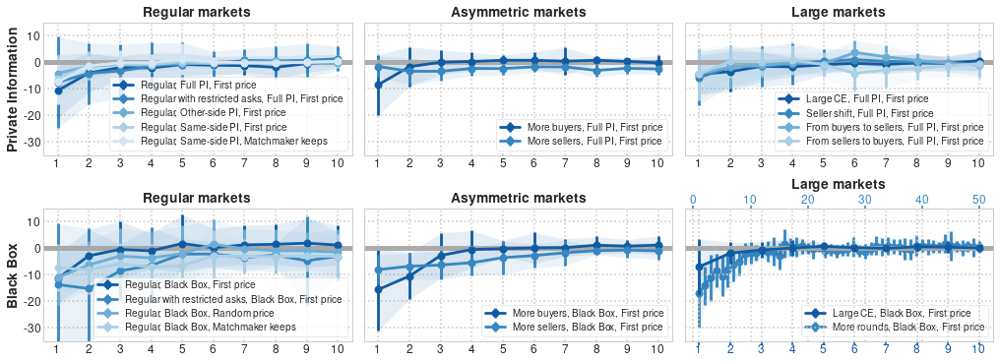

In [29]:
treatment_grid_combined(treatment_groups, distances_to_EPR, 'sdev', blue_palette)
_ = plt.savefig('Figures/CE_convergence.pdf', bbox_inches='tight', transparent=True)

**Allocative efficiency**

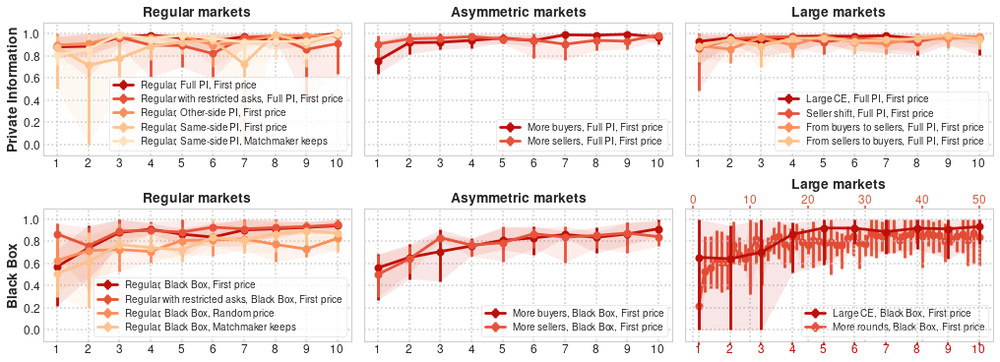

In [30]:
treatment_grid_combined(treatment_groups, allocative_efficiency, 'minmax', red_palette)
_ = plt.savefig('Figures/Allocative_efficiency.pdf', bbox_inches='tight', transparent=True)

#### Black Box versus Private Information

_Left_: distance to CE\
_Right_: allocative efficiency

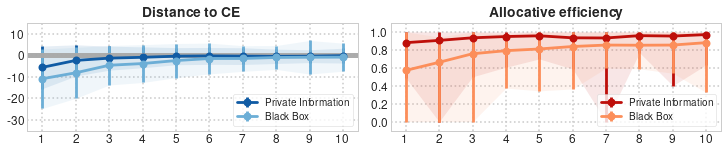

In [31]:
fig, ax = plt.subplots(1,2, figsize=(10,2), sharex=True, constrained_layout=True)

df10 = df[df['round'] <= 10].copy()

df10_BB = df10[df10['treatment'].isin(BB_treatments)]
df10_PI = df10[~df10['treatment'].isin(BB_treatments)]

rows = [('Private Information', df10_PI, 0), ('Black Box', df10_BB, 2)]
cols = [(0, distances_to_EPR, 'sdev', blue_palette, 'Distance to CE'),
        (1, allocative_efficiency, 'minmax', red_palette, 'Allocative efficiency')]

for (label, data, colour_id) in rows:
    for (col, fun, errorbar_type, palette, title) in cols:
        mean_evolution(ax[col], data, fun, errorbar_type, alpha=0.1,
                       **{'colour': palette[colour_id], 'label': label})
        grid_layout(ax[col], fun) 
        _ = ax[col].legend(loc='lower right', fontsize=10, framealpha=0.8)
        _ = ax[col].set_title(bold_text(title), fontsize=14)

_ = plt.savefig('Figures/AllMarkets_CE_AE.pdf', bbox_inches='tight', transparent=True)

### Hypothesis testing

Aggregate the (mean/first) per-round <span style='color:#DB5461'>signed distances to CE</span> and the per-round <span style='color:#DB5461'>allocative efficiency</span> over all experimental sessions (for rounds 1 to 10)

In [32]:
all_distances = dict()
first_distances = dict()
mean_distances = dict()
allocative_efficiencies = dict()

for rnd in range(1, 11):
    all_distances[rnd] = []
    first_distances[rnd] = []
    mean_distances[rnd] = []
    allocative_efficiencies[rnd] = []
    
    for (treatment, game), df_game in df[df['round'] == rnd].groupby(['treatment', 'game']):
        distances = distances_to_EPR(df_game, treatment, game, rnd)
        all_distances[rnd].extend(distances)
        
        if len(distances) > 0:
            first_distances[rnd].append(distances[0])
            mean_distances[rnd].append(np.nanmean(distances))
        
        allocative_efficiencies[rnd].append(allocative_efficiency(df_game, treatment, game, rnd))
        
convergence_metrics = {'All distances': all_distances,
                       'First distances': first_distances,
                       'Mean per-treatment distances': mean_distances,
                       'Allocative efficiency': allocative_efficiencies}

Inspect the (mean/first) distance distribution and the distribution of the allocative efficiency over time

Skewness,All distances,First distances,Mean per-treatment distances,Allocative efficiency
Round,,,,
1,-1.28463,-0.632913,-0.773617,-1.29725
2,-2.25356,-2.5683,-1.81277,-1.69363
3,-0.580255,0.156361,-0.718076,-2.11079
4,-1.44822,0.426608,-1.18063,-1.39148
5,0.158807,1.02052,-0.578251,-1.66368
6,0.268017,-1.0451,-0.83798,-1.6433
7,-0.16611,-0.120059,0.884839,-3.37884
8,-0.27323,-0.828016,0.0309477,-1.41996
9,-5.42821,1.40576,-2.20447,-1.88095


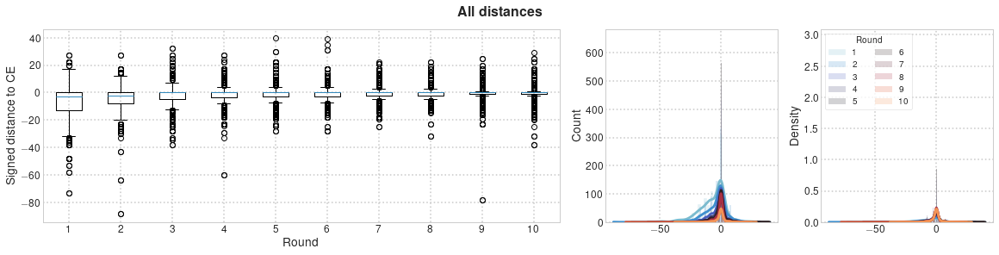

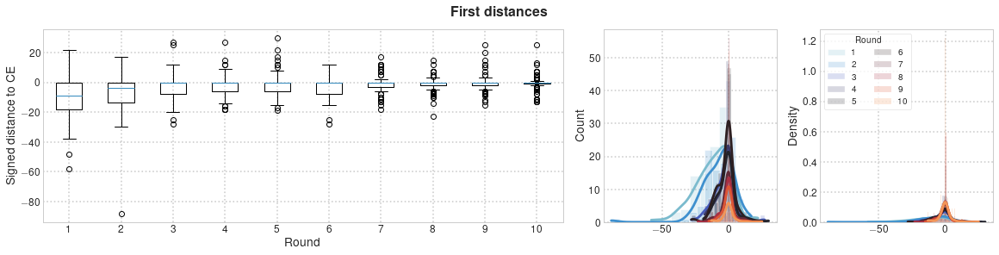

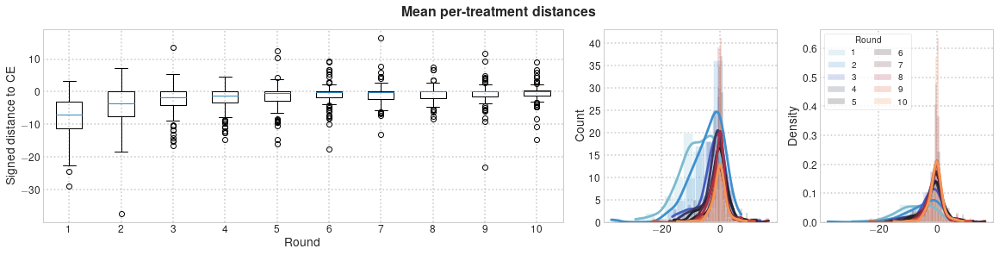

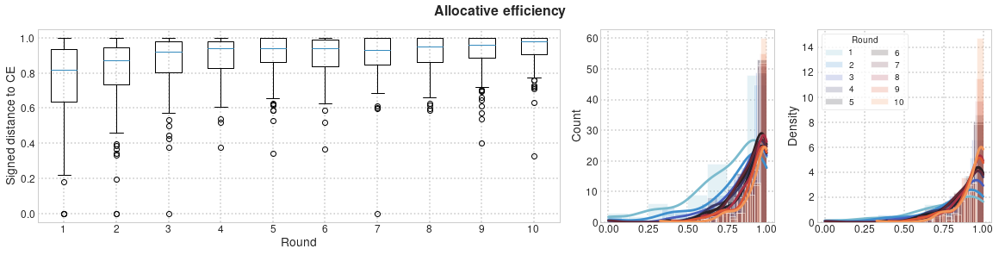

In [33]:
# Skewness
index = pd.Index(range(1,11), name='Round')
columns = pd.Index(convergence_metrics.keys(), name='Skewness')
skewness = pd.DataFrame(index=index, columns=columns)

# Boxplots, histograms, and kernel density estimates
for idx, vals in enumerate(convergence_metrics.values()):
    fig, ax = plt.subplots(1,3, figsize=(16,4), constrained_layout=True, gridspec_kw={'width_ratios':[3,1,1]})
    _ = plt.suptitle(bold_text(columns[idx]))
    palette = itertools.cycle(sns.color_palette('icefire', 10))
    
    _ = ax[0].boxplot(list(vals.values()), positions=list(vals.keys()))
    _ = ax[0].set_xlabel('Round')
    _ = ax[0].set_ylabel('Signed distance to CE')
 
    for rnd in range(1,11):
        colour = next(palette)
        _ = sns.histplot(vals[rnd], kde=True, stat='count', ax=ax[1], alpha=0.2, color=colour, label=rnd)
        _ = sns.histplot(vals[rnd], kde=True, stat='density', ax=ax[2], alpha=0.2, color=colour, label=rnd)

        skewness.loc[rnd, columns[idx]] = stats.skew(vals[rnd])
        
    _ = ax[2].legend(title='Round', ncol=2, loc='upper left')

skewness

**Wilcoxon signed-rank test** ([```Scipy``` documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.wilcoxon.html))
- Applies to _symmetric_ continuous distributions (when the distribution is symmetric, the median and the mean are equal)
- The null hypothesis is that the data is symmetrically distributed around the hypothesised median. A small $p$-value means that the null hypothesis is rejected, i.e., that there is evidence against this, which may be because the distribution is not centered at the median, or because it is asymmetric (see [discussion](https://stats.stackexchange.com/questions/332469/symmetry-assumption-in-wilcoxons-signed-rank-test)).

In [34]:
def Wilcoxon_oneSided(vals, alternative, M0):
    vals = [v-M0 for v in vals]
    w, p = stats.wilcoxon(vals, alternative=alternative, zero_method='pratt')
    
    return p

def Wilcoxon_table(agg_level, alternative, M0):
    index = pd.Index(range(1,11), name='Round')
    metrics = ['Mean', 'Median', 'Sample size', r'$p$-value']
    columns = pd.MultiIndex.from_product([agg_level, metrics])
    results = pd.DataFrame(index=index, columns=columns)

    for idx, vals_dict in enumerate([convergence_metrics[l] for l in agg_level]):
        for rnd, vals in vals_dict.items():
            results.loc[rnd, (agg_level[idx], 'Mean')] = np.mean(vals)
            results.loc[rnd, (agg_level[idx], 'Median')] = np.median(vals)
            results.loc[rnd, (agg_level[idx], 'Sample size')] = len(vals)
            
            p = Wilcoxon_oneSided(vals, alternative, M0)
            results.loc[rnd, (agg_level[idx], r'$p$-value')] = p
    
    return results

def Wilcoxon_plot(ax, vals_dict, alternative, M0_list, palette, title):
    _ = ax.set_title(title)
    _ = ax.axhline(0.05, linestyle='dashed', linewidth=2, color='gray')
    
    for M0 in M0_list:
        pvals = []

        for rnd, vals in vals_dict.items():
            if alternative == 'equivalence':
                p1 = Wilcoxon_oneSided(vals, 'greater', -M0)
                p2 = Wilcoxon_oneSided(vals, 'less', M0)
                p = max(p1,p2)
            else:
                p = Wilcoxon_oneSided(vals, alternative, M0)
            
            pvals.append(p)
        
        _ = ax.plot(range(1,11), pvals, '.-', label=abs(M0), color=next(palette))

    _ = ax.set_xticks(range(1,11))
    _ = ax.set_xlabel('Round')
    _ = ax.set_ylabel('$p$-value')
    _ = ax.label_outer()
    _ = ax.legend(title=r'$\varepsilon$')

Below, the distribution of the **(mean) per-session signed distance to the CE range** is considered for each round $r \in \{1, 2 \ldots, 10\}$ separately.

One-sided tests are used to test:
- $H_0: \med{\DCE} \geq 0$ against $H_a : \med{\DCE} < 0$ (```alternative == 'less'```);
- $H_0: \med{\DCE} \leq - \varepsilon$ against $H_a : \med{\DCE} > -\varepsilon$ for $\varepsilon > 0$ (```alternative == 'greater'```).

In [35]:
printmd(r'**Test 1**: $\med{\DCE}$ bounded from above by 0')

agg_level = ['All distances', 'First distances', 'Mean per-treatment distances']
Wilcoxon_table(agg_level, 'less', 0)

**Test 1**: $\med{\DCE}$ bounded from above by 0

All distances                                 First distances         \
               Mean Median Sample size    $p$-value            Mean Median   
Round                                                                        
1          -7.04116     -3         996  9.73214e-78        -11.5743     -9   
2          -4.15428     -2        1076  1.64257e-52         -7.5098     -4   
3          -2.49388      0        1144  1.76686e-35        -3.35922      0   
4          -1.94792      0        1152  2.36659e-32        -2.46154      0   
5          -1.16007      0        1162  3.21247e-16        -1.65385      0   
6         -0.748294      0        1172  1.32441e-06        -2.50962      0   
7         -0.818259      0        1172  4.07215e-12       -0.747573      0   
8          -0.69863      0        1168  6.19739e-13              -1      0   
9         -0.617698      0        1164  4.99707e-08       -0.201923      0   
10        -0.454545      0        1188   0.00115255       -0.271845      0   

                               Mean per-treatment distances            \
      Sample size    $p$-value                         Mean    Median   
Round                                                                   
1             101  1.81646e-13                     -7.59103        -7   
2             102  5.10552e-10                     -4.50615      -3.5   
3             103  6.40901e-06                     -2.62839  -1.83333   
4             104  9.81592e-06                     -2.10452      -1.2   
5             104  0.000764308                      -1.3979      -0.4   
6             104  0.000139943                    -0.826076     -0.05   
7             103    0.0321275                    -0.811381 -0.166667   
8             104        0.023                    -0.734264         0   
9             104     0.104741                    -0.623794         0   
10            103     0.186329                    -0.452708         0   

                                
      Sample size    $p$-value  
Round                           
1             101  1.22685e-17  
2             102  5.11726e-12  
3             103  4.14845e-09  
4             104  2.94915e-08  
5             104  0.000121147  
6             104   0.00180936  
7             103  0.000640718  
8             104   0.00185756  
9             104   0.00621649  
10            103     0.044207

**Test 2**: $\med{\DCE}$ bounded from below by $-\varepsilon$ ($\iff \med{\DCE} + \varepsilon > 0$)

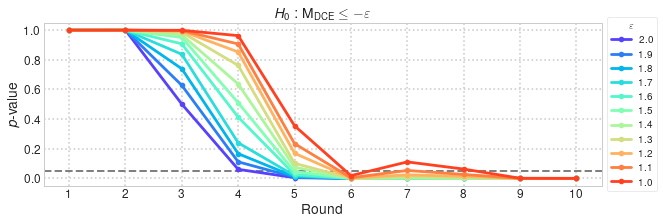

In [36]:
printmd(r'**Test 2**: $\med{\DCE}$ bounded from below by $-\varepsilon$ ($\iff \med{\DCE} + \varepsilon > 0$)')

fig, ax = plt.subplots(1,1, figsize=(10,3))
palette = itertools.cycle(sns.color_palette('rainbow', 11))
Wilcoxon_plot(ax, mean_distances, 'greater', np.linspace(-2,-1,11).round(1),
              palette, r'$H_0: \med{\DCE} \leq -\varepsilon$')
_ = ax.legend(title=r'$\varepsilon$', loc='center left', bbox_to_anchor=(1, 0.5))

In [37]:
eps = 1.5
printmd(r'**Test 2 ($\varepsilon = {}$)**: $\med{{\DCE}}$ bounded from below by $-\varepsilon$ ($\iff \med{{\DCE}} + \varepsilon > 0$)'.format(eps))

agg_level = ['All distances', 'First distances', 'Mean per-treatment distances']
Wilcoxon_table(agg_level, 'greater', -eps)

**Test 2 ($\varepsilon = 1.5$)**: $\med{\DCE}$ bounded from below by $-\varepsilon$ ($\iff \med{\DCE} + \varepsilon > 0$)

All distances                                 First distances         \
               Mean Median Sample size    $p$-value            Mean Median   
Round                                                                        
1          -7.04116     -3         996            1        -11.5743     -9   
2          -4.15428     -2        1076            1         -7.5098     -4   
3          -2.49388      0        1144     0.896608        -3.35922      0   
4          -1.94792      0        1152    0.0691493        -2.46154      0   
5          -1.16007      0        1162  1.67536e-13        -1.65385      0   
6         -0.748294      0        1172  2.37218e-23        -2.50962      0   
7         -0.818259      0        1172  4.00457e-27       -0.747573      0   
8          -0.69863      0        1168  2.30442e-27              -1      0   
9         -0.617698      0        1164  6.43726e-44       -0.201923      0   
10        -0.454545      0        1188  2.28444e-48       -0.271845      0   

                               Mean per-treatment distances            \
      Sample size    $p$-value                         Mean    Median   
Round                                                                   
1             101            1                     -7.59103        -7   
2             102     0.999997                     -4.50615      -3.5   
3             103     0.953004                     -2.62839  -1.83333   
4             104     0.785197                     -2.10452      -1.2   
5             104      0.52297                      -1.3979      -0.4   
6             104      0.59074                    -0.826076     -0.05   
7             103   0.00178069                    -0.811381 -0.166667   
8             104   0.00774362                    -0.734264         0   
9             104  0.000177277                    -0.623794         0   
10            103   3.7371e-05                    -0.452708         0   

                                
      Sample size    $p$-value  
Round                           
1             101            1  
2             102     0.999993  
3             103     0.950756  
4             104     0.510354  
5             104    0.0459917  
6             104  0.000250675  
7             103   0.00219888  
8             104  0.000386144  
9             104  5.88969e-07  
10            103  3.25183e-07

Below, the distribution of **allocative efficiency** is considered for each round $r \in \{ 1, 2, \ldots, 10 \}$ separately.

One-sided test is used to test:
- $H_0: \med{\AEff} \leq \med{0}$ against $H_a : \med{\AEff} > \med{0}$ (```alternative == 'greater'```).

**Test**: $\med{\AEff}$ bounded from below by $\med{0}$ ($\iff \med{\AEff} - \med{0} > 0$)

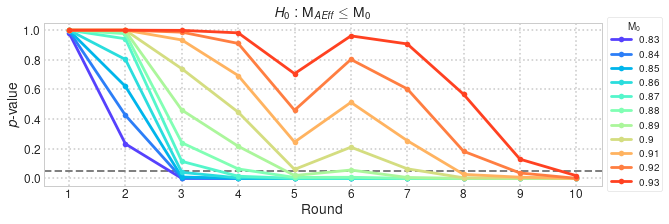

In [38]:
printmd(r'**Test**: $\med{\AEff}$ bounded from below by $\med{0}$ ($\iff \med{\AEff} - \med{0} > 0$)')

fig, ax = plt.subplots(1,1, figsize=(10,3))
palette = itertools.cycle(sns.color_palette('rainbow', 11))
Wilcoxon_plot(ax, allocative_efficiencies, 'greater', np.linspace(0.83,0.93,11).round(2), 
              palette, r'$H_0: \med{AEff} \leq \med{0}$')
_ = ax.legend(title=r'$\med{0}$', loc='center left', bbox_to_anchor=(1, 0.5))

In [39]:
printmd(r'**Test**: $\med{\AEff}$ bounded from below by $\med{0}$ ($\iff \med{\AEff} - \med{0} > 0$)')

agg_level = ['Allocative efficiency']
results1 = Wilcoxon_table(agg_level, 'greater', 0.85)
results1.rename({r'$p$-value': r'$p$-value (0.85)'}, level=1, axis=1, inplace=True)
results2 = Wilcoxon_table(agg_level, 'greater', 0.9)
results1[agg_level[0], r'$p$-value (0.9)'] = results2[agg_level[0], r'$p$-value']
results1

**Test**: $\med{\AEff}$ bounded from below by $\med{0}$ ($\iff \med{\AEff} - \med{0} > 0$)

Allocative efficiency                                         \
                       Mean    Median Sample size $p$-value (0.85)   
Round                                                                
1                  0.752138  0.815741         104         0.998278   
2                  0.804396  0.871549         104         0.620411   
3                  0.860626  0.920422         104       0.00941035   
4                  0.882912  0.938953         104      0.000847656   
5                  0.895542  0.938619         104      3.62429e-05   
6                  0.893728  0.939537         104      5.64327e-06   
7                   0.89946  0.933333         104      1.71297e-07   
8                  0.913763  0.949875         104      1.41224e-08   
9                  0.912002  0.962523         104      1.39411e-07   
10                 0.932256  0.981618         103      1.63096e-12   

                       
      $p$-value (0.9)  
Round                  
1            0.999999  
2            0.999351  
3            0.739722  
4            0.447061  
5           0.0607918  
6            0.210752  
7           0.0648051  
8          0.00418329  
9           0.0029141  
10        7.30155e-06

**Mann-Kendall trend test** ([```pyMannKendall``` documentation](https://pypi.org/project/pymannkendall/))
- The [Mann-Kendall trend test](https://www.statisticshowto.com/mann-kendall-trend-test/) is used to analyse data collected over time for consistently increasing or decreasing trends. It is a non-parametric test (and hence works for all distributions), but there should be no serial correlation.
- The test can be used to find trends for as few as four samples. However, with only a few data points, the test has a high probability of not finding a trend when one would be present if more points were provided. The more data points you have the more likely the test is going to find a true trend (as opposed to one found by chance). The minimum number of recommended measurements is therefore at least 8 to 10.
- If there are multiple points per time period, the median value should be used.

Mann-Kendall test applied to <span style='color:#00cc66'>**individual sessions**</span> (_all_ rounds taken into account)

Decreasing trend detected in game 9 under FullLargeCE treatment


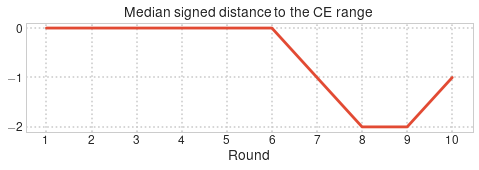

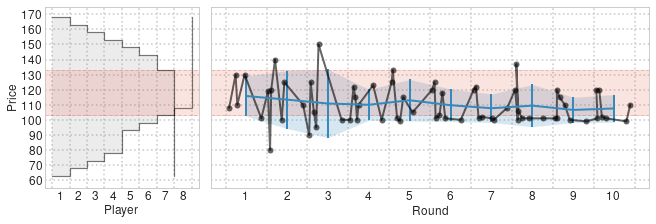

In [40]:
eps = 1.5
M0 = 0.85

n_total = 0
n_increasing = {'Median distance': 0, 'Allocative efficiency': 0}
n_decreasing = {'Median distance': 0, 'Allocative efficiency': 0}

dist_noTrend_means = []
dist_noTrend_nearCE = 0
allEff_noTrend_near1 = 0

for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    metrics = {'Median distance': [], 'Allocative efficiency': []}
    game_distances = []
    
    for rnd, df_round in df_game.groupby(['round']):   
        distances = distances_to_EPR(df_round, treatment, game, rnd)
        
        if len(distances) > 0:
            metrics['Median distance'].append(np.median(distances))
            game_distances.extend(distances)
            
        metrics['Allocative efficiency'].append(allocative_efficiency(df_round, treatment, game, rnd))
    
    for metric, vals in metrics.items():
        result = mk.original_test(vals)

        if result.trend == 'increasing':
            n_increasing[metric] += 1
        elif result.trend == 'decreasing':
            n_decreasing[metric] += 1
            print('Decreasing trend detected in game {} under {} treatment'.format(game, treatment))
            _ = plt.figure(figsize=(8,2))
            _ = plt.plot(range(1,11), vals)
            _ = plt.xticks(range(1,11))
            _ = plt.xlabel('Round')
            _ = plt.title('Median signed distance to the CE range')
            plot_session(treatment, game)
        else:
            if metric == 'Median distance':
                dist_noTrend_means.append(np.mean(metrics['Median distance']))

                w, p1 = stats.wilcoxon([d + eps for d in game_distances], alternative='greater')
                w, p2 = stats.wilcoxon([d - eps for d in game_distances], alternative='less')

                if (p1 <= 0.01) and (p2 <= 0.01):
                    dist_noTrend_nearCE += 1
            elif metric == 'Allocative efficiency':
                w, p = stats.wilcoxon([a - M0 for a in vals], alternative='greater')
                
                if (p <= 0.01):
                    allEff_noTrend_near1 += 1                

    n_total += 1

All sessions: 104

<span style="color:#DB5461">**Median distance**</span>

Increasing trend: **35**, decreasing trend: 1, no trend: 68

Sessions with no trend:

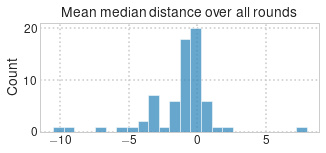

DescribeResult(nobs=68, minmax=(-10.5, 7.95), mean=-1.2027287581699346, variance=6.23894248880868, skewness=-0.9148741586810675, kurtosis=5.46957561681986)

In **38** sessions, no trend was observed due to $\med{\DCE} \in (-\varepsilon, \varepsilon)$ for the overall $\med{\DCE}$ ($\varepsilon = 1.5$).

<span style="color:#DB5461">**Allocative efficiency**</span>

Increasing trend: **27**, decreasing trend: 0, no trend: 77

Sessions with no trend:

In **44** sessions, no trend was observed due to $\med{\AEff} > \med{0}$ for the overall $\med{\AEff}$ ($\med{0} = 0.85$).

In [41]:
printmd(r'All sessions: {}'.format(n_total)) 

for metric in metrics.keys():
    printmd('<span style="color:#DB5461">**{}**</span>'.format(metric))
    printmd('Increasing trend: **{}**, decreasing trend: {}, no trend: {}'.format(n_increasing[metric], n_decreasing[metric], n_total - n_increasing[metric] - n_decreasing[metric]))

    printmd('Sessions with no trend:')

    if metric == 'Median distance':
        _ = plt.figure(figsize=(5,2))
        _ = plt.title('Mean median distance over all rounds')
        _ = sns.histplot(dist_noTrend_means)
        _ = plt.show()

        stats.describe(dist_noTrend_means)

        printmd(r'In **{}** sessions, no trend was observed due to $\med{{\DCE}} \in (-\varepsilon, \varepsilon)$ for the overall $\med{{\DCE}}$ ($\varepsilon = {}$).'.format(dist_noTrend_nearCE, eps))
        
    elif metric == 'Allocative efficiency':
        printmd(r'In **{}** sessions, no trend was observed due to $\med{{\AEff}} > \med{{0}}$ for the overall $\med{{\AEff}}$ ($\med{{0}} = {}$).'.format(allEff_noTrend_near1, M0))

Mann-Kendall test applied to <span style='color:#00cc66'>**individual treatments**</span> (_all_ rounds taken into account)

In [42]:
eps = 1.5
M0 = 0.85

index = [treatment_names[treatment] for treatment in df['treatment'].unique()]
index = pd.Index(index, name='Treatment')
columns = pd.MultiIndex.from_product([['Median distance', 'Standard deviation'], ['Trend', r'$p$-value']])
results = pd.DataFrame(index=index, columns=columns)

dist_noTrend_nearCE_list = []
allEff_noTrend_near1_list = []

for treatment, df_treatment in df.groupby(['treatment']):
    metrics = {'Median distance': [], 'Standard deviation': [], 'Allocative efficiency': []}
    treatment_distances = []

    for rnd, df_round in df_treatment.groupby(['round']):
        round_distances = []
        
        for game, df_game in df_round.groupby(['game']):
            distances = distances_to_EPR(df_game, treatment, game, rnd)
            round_distances.extend(distances)
            treatment_distances.extend(distances)
            
            metrics['Allocative efficiency'].append(allocative_efficiency(df_game, treatment, game, rnd))

        metrics['Median distance'].append(np.nanmedian(round_distances))
        metrics['Standard deviation'].append(np.nanstd(round_distances))
    
    for metric, vals in metrics.items():
        result = mk.original_test(vals)
        results.loc[treatment_names[treatment], (metric, 'Trend')] = result.trend
        results.loc[treatment_names[treatment], (metric, r'$p$-value')] = result.p
    
        if result.trend == 'no trend':
            if metric == 'Median distance':
                w, p1 = stats.wilcoxon([d + eps for d in treatment_distances], alternative='greater')
                w, p2 = stats.wilcoxon([d - eps for d in treatment_distances], alternative='less')

                if (p1 <= 0.01) and (p2 <= 0.01):
                    dist_noTrend_nearCE_list.append(treatment_names[treatment])
            
            elif metric == 'Allocative efficiency':
                w, p = stats.wilcoxon([a - M0 for a in vals], alternative='greater')
                
                if (p <= 0.01):
                    allEff_noTrend_near1_list.append(treatment_names[treatment])

In [43]:
results

printmd('<span style="color:#DB5461">**Median distance**</span>')
printmd(r'No trend, but $\med{{\DCE}} \in (-\varepsilon, \varepsilon)$ for the overall $\med{{\DCE}}$ ($\varepsilon = {}$):'.format(eps))

for treatment in dist_noTrend_nearCE_list:
     printmd('- {}'.format(treatment))

printmd('')
printmd(r'Note that if e.g. $\varepsilon \geq 3.5$, $\med{\DCE} \in (-\varepsilon, \varepsilon)$ holds for all treatments for which no trend was observed.')

printmd('')
printmd('<span style="color:#DB5461">**Allocative efficiency**</span>')

printmd(r'No trend, but $\med{{\AEff}} > \med{{0}}$ for the overall $\med{{\AEff}}$ ($\med{{0}} = {}$):'.format(M0))

for treatment in allEff_noTrend_near1_list:
     printmd('- {}'.format(treatment))

Median distance  \
                                                             Trend   
Treatment                                                            
More sellers, Full PI, First price                        no trend   
More sellers, Black Box, First price                    increasing   
More buyers, Full PI, First price                         no trend   
More buyers, Black Box, First price                     increasing   
Large CE, Full PI, First price                            no trend   
More rounds, Black Box, First price                     increasing   
Seller shift, Full PI, First price                      increasing   
From buyers to sellers, Full PI, First price              no trend   
Large CE, Black Box, First price                          no trend   
From sellers to buyers, Full PI, First price              no trend   
Regular, Black Box, First price                         increasing   
Regular, Black Box, Matchmaker keeps                    increasing   
Regular, Black Box, Random price                          no trend   
Regular, Full PI, First price                           increasing   
Regular, Other-side PI, First price                       no trend   
Regular, Same-side PI, First price                      increasing   
Regular, Same-side PI, Matchmaker keeps                   no trend   
Regular with restricted asks, Black Box, First ...      increasing   
Regular with restricted asks, Full PI, First price      increasing   

                                                                 \
                                                      $p$-value   
Treatment                                                         
More sellers, Full PI, First price                     0.396493   
More sellers, Black Box, First price                0.000844676   
More buyers, Full PI, First price                      0.163734   
More buyers, Black Box, First price                   0.0383258   
Large CE, Full PI, First price                                1   
More rounds, Black Box, First price                 7.14672e-09   
Seller shift, Full PI, First price                    0.0383258   
From buyers to sellers, Full PI, First price           0.147778   
Large CE, Black Box, First price                       0.163734   
From sellers to buyers, Full PI, First price                  1   
Regular, Black Box, First price                       0.0193795   
Regular, Black Box, Matchmaker keeps                 0.00111787   
Regular, Black Box, Random price                      0.0853999   
Regular, Full PI, First price                         0.0302458   
Regular, Other-side PI, First price                    0.163734   
Regular, Same-side PI, First price                    0.0383258   
Regular, Same-side PI, Matchmaker keeps                0.163734   
Regular with restricted asks, Black Box, First ...    0.0264161   
Regular with restricted asks, Full PI, First price    0.0104422   

                                                   Standard deviation  \
                                                                Trend   
Treatment                                                               
More sellers, Full PI, First price                         decreasing   
More sellers, Black Box, First price                       decreasing   
More buyers, Full PI, First price                          decreasing   
More buyers, Black Box, First price                        decreasing   
Large CE, Full PI, First price                             decreasing   
More rounds, Black Box, First price                        decreasing   
Seller shift, Full PI, First price                         decreasing   
From buyers to sellers, Full PI, First price               decreasing   
Large CE, Black Box, First price                           decreasing   
From sellers to buyers, Full PI, First price                 no trend   
Regular, Black Box, First price                              no trend   
Regular, Blac

<span style="color:#DB5461">**Median distance**</span>

No trend, but $\med{\DCE} \in (-\varepsilon, \varepsilon)$ for the overall $\med{\DCE}$ ($\varepsilon = 1.5$):

- Large CE, Black Box, First price

- From buyers to sellers, Full PI, First price

- Large CE, Full PI, First price

- More buyers, Full PI, First price

- Regular, Other-side PI, First price

- Regular, Same-side PI, Matchmaker keeps

Note that if e.g. $\varepsilon \geq 3.5$, $\med{\DCE} \in (-\varepsilon, \varepsilon)$ holds for all treatments for which no trend was observed.

<span style="color:#DB5461">**Allocative efficiency**</span>

No trend, but $\med{\AEff} > \med{0}$ for the overall $\med{\AEff}$ ($\med{0} = 0.85$):

- From sellers to buyers, Full PI, First price

- Regular with restricted asks, Full PI, First price

- More sellers, Full PI, First price

- Seller shift, Full PI, First price

- Regular, Other-side PI, First price

#### Price convergence to CE, initial asymmetry, convergence of allocative efficiency

$\med{\DCE}$: median signed distance to CE, $\med{\AEff}$: median allocative efficiency

_Left_: $H_0: \med{\DCE} \notin (-\varepsilon, \varepsilon)$ for $\varepsilon \in \{ 0, 1, \ldots, 5 \}$\
_Right_: $H_0: \med{\AEff} \leq \med{0}$ for $\med{0} \in \{ 0.75, 0.80, \ldots, 1.0 \}$ 

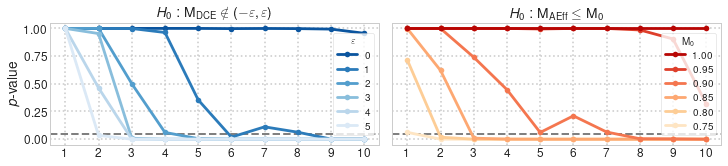

In [44]:
fig, ax = plt.subplots(1,2, figsize=(10,2.2), sharex=True, sharey=True, constrained_layout=True)

palette = itertools.cycle(sns.color_palette('Blues_r', n_colors=6))
Wilcoxon_plot(ax[0], mean_distances, 'equivalence', range(0,6), palette, r'$H_0 : \med{\DCE} \notin (-\varepsilon, \varepsilon)$')
palette = itertools.cycle(sns.color_palette('OrRd', n_colors=6))
Wilcoxon_plot(ax[1], allocative_efficiencies, 'greater', np.linspace(0.75,1,6).round(2), palette, r'$H_0 : \med{\AEff} \leq \med{0}$')

_ = ax[0].legend(loc=5, title=r'$\varepsilon$')
_ = handles, labels = ax[1].get_legend_handles_labels()
_ = ax[1].legend(handles[::-1], labels[::-1], title=r'$\med{0}$', ncol=1, framealpha=0.8, loc=5)
for t in ax[1].get_legend().texts:
    t.set_text('{:.2f}'.format(float(t.get_text())))

for ax in fig.axes:
    _ = ax.set_xlabel('')
    
_ = plt.savefig('Figures/Wilcoxon.pdf', bbox_inches='tight', transparent=True)

$H_0: \med{\DCE} \geq -\varepsilon$ for $\varepsilon \in \{ 0, 1, \ldots, 5 \}$

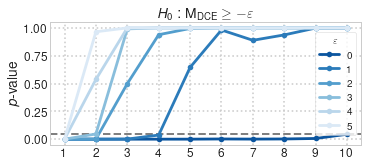

In [45]:
fig, ax = plt.subplots(1,1, figsize=(5,2.2), sharex=True, sharey=True, constrained_layout=True)
palette = itertools.cycle(sns.color_palette('Blues_r', n_colors=6))
Wilcoxon_plot(ax, mean_distances, 'less', [-eps for eps in range(0,6)], palette, r'$H_0 : \med{\DCE} \geq -\varepsilon$')
_ = ax.set_xlabel('')

CE prices across the first 10 rounds

DescribeResult(nobs=18654, minmax=(63, 158), mean=110.01109681569636, variance=267.1456979016325, skewness=-0.0005427727883786798, kurtosis=0.24249983896976124)

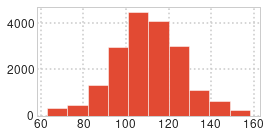

CE prices across all rounds

DescribeResult(nobs=20858, minmax=(63, 158), mean=110.15912359766037, variance=243.4942162717249, skewness=-0.02549772121188665, kurtosis=0.5018277614471933)

Sample size across the first 10 rounds

[101, 102, 103, 104, 104, 104, 103, 104, 104, 103]

DescribeResult(nobs=10, minmax=(101, 104), mean=103.2, variance=1.0666666666666664, skewness=-1.0461362443136581, kurtosis=-0.010416666666653196)

In [46]:
CE_10Rounds = []
CE_allRounds = []
n_samples = []

for key, CE_range in EPR_rounds.items():
    CE_prices = list(range(CE_range[0], CE_range[1]+1))
    
    if key[2] <= 10:
        CE_10Rounds.extend(CE_prices)

    CE_allRounds.extend(CE_prices)

printmd('CE prices across the first 10 rounds')
stats.describe(CE_10Rounds)

_ = plt.figure(figsize=(4,2))
_ = plt.hist(CE_10Rounds)
_ = plt.show()

printmd('CE prices across all rounds')
stats.describe(CE_allRounds)

for vals in mean_distances.values():
    n_samples.append(len(vals))

printmd('Sample size across the first 10 rounds')
n_samples
stats.describe(n_samples)

## Selten's index of predictive success

[R. Selten: Properties of a measure of predictive success (1991)](https://www.sciencedirect.com/science/article/pii/0165489691900764) 
  
Measure of predictive success: $m = h - a$ where
- $r \in [0, 1]$: _hit rate_, the relative frequency of correct predictions
- $a \in [0, 1]$: _the area_, the relative size of the predicted subset compared with the set of all possible outcomes

Notes:
1. How should the area of a heterogeneous sample be defined? In applications the convention is used that the area of a heterogeneous sample is the _arithmetic mean of all areas_, computed on the basis of the parameter combinations underlying the observations; every observation has the same weight in this arithmetic mean.

2. Notice that a high ‘hit rate’ means high accuracy, whereas a small ‘area’ means high precision. Observe that $-1 < m < 1$, _with $m = 0$ indicating a rule which predicts just as well as uniform random behaviour over output levels_ (as the expected hit rate $r$ equals the area $a$ when play was in fact uniform random). In other words, $m$ will be positive only if actual behaviour is better described by a given rule than by uniform random behaviour. [A. Bosch‐Domènech, N. J. Vriend : Imitation of successful behaviour in cournot markets (2003)](https://academic.oup.com/ej/article-abstract/113/487/495/5061009)

3. <font color='#DB5461'>The _random simulations also allow us to calculate the Predictive Success Index_ (PSI, Selten (1991)), a measure that adjusts the frequency of successful predictions by the power of the test (the area of the core region in the present case). The values of PSI for the three treatments can be obtained by subtracting values for simulated power tests in Table III from actual results for human subjects in Table IX.</font> [A. Dolgopolov, D. Houser, C. Martinelli, T. Stratmann: Assignment Markets: Theory and Experiments (2019)](https://ideas.repec.org/p/gms/wpaper/1075.html)

The implementation below assumes that all compatible buyer-seller pairs are equally likely to strike a deal, whereby the resulting deal price may assume any value between the respective valuations.

In [47]:
def Selten_index(dfr, treatment, game, rnd, output='SI', eps1=0, eps2=0):
    [epr1, epr2] = EPR_rounds[treatment, game, rnd]
    prices = dfr['price'].dropna()
    
    epr1 -= eps1
    epr2 += eps2
    
    if len(prices) > 0:
        EPR_prices = sum((epr1 <= prices) & (prices <= epr2)) # realised prices in EPR
        all_prices = prices.count() # all realised prices

        r = EPR_prices/all_prices

        width_EPR = epr2 - epr1 + 1

        valuations = get_valuations(dfr)
        possible_trade_pairs = [(vals, valb) for (vals, valb) in itertools.product(valuations['Seller'], valuations['Buyer']) if vals <= valb]

        nOutcomes = [valb - vals + 1 for (vals, valb) in possible_trade_pairs]
        nOutcomes = np.mean(nOutcomes)

#         # Alternative approach: span of treatment-wise realised prices
#         minTreatmentPrice = min(df[df['treatment'] == treatment]['price'].dropna())
#         maxTreatmentPrice = max(df[df['treatment'] == treatment]['price'].dropna())
#         nOutcomes = maxTreatmentPrice - minTreatmentPrice + 1
        
        if width_EPR < nOutcomes:
            a = width_EPR/nOutcomes
        else:
            a = 1
        
        m = r-a

    else:
        m = np.nan
        r = np.nan
        a = np.nan
    
    if output == 'SI':
        out = m
    elif output == 'hitRate':
        out = r
    elif output == 'area':
        out = a
    elif output == 'all':
        out = m, r, a
        
    return out

### Evolution over time

_Top_: distance to CE\
_Middle_: allocative efficiency\
_Bottom_: Selten index $m$, hit rate $r$, CE area $a$

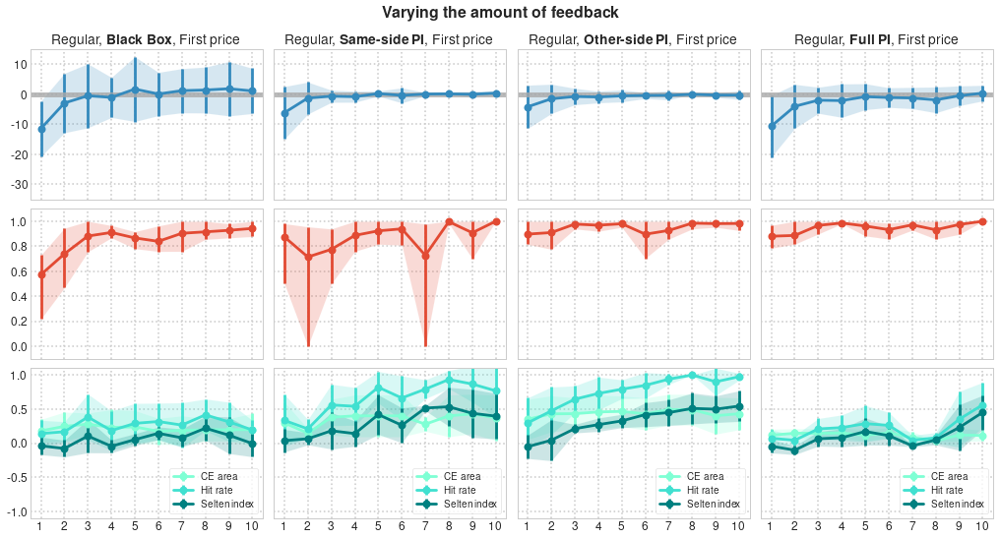

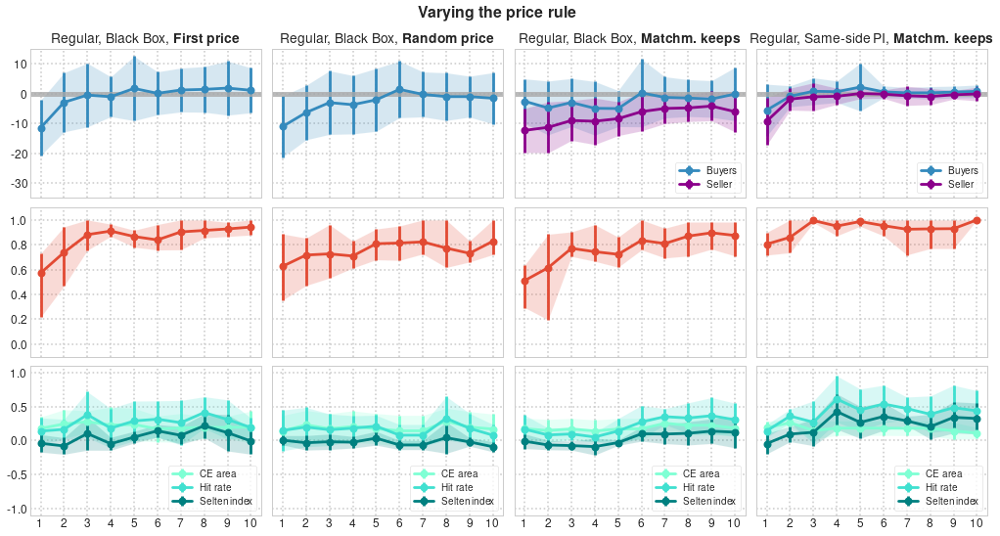

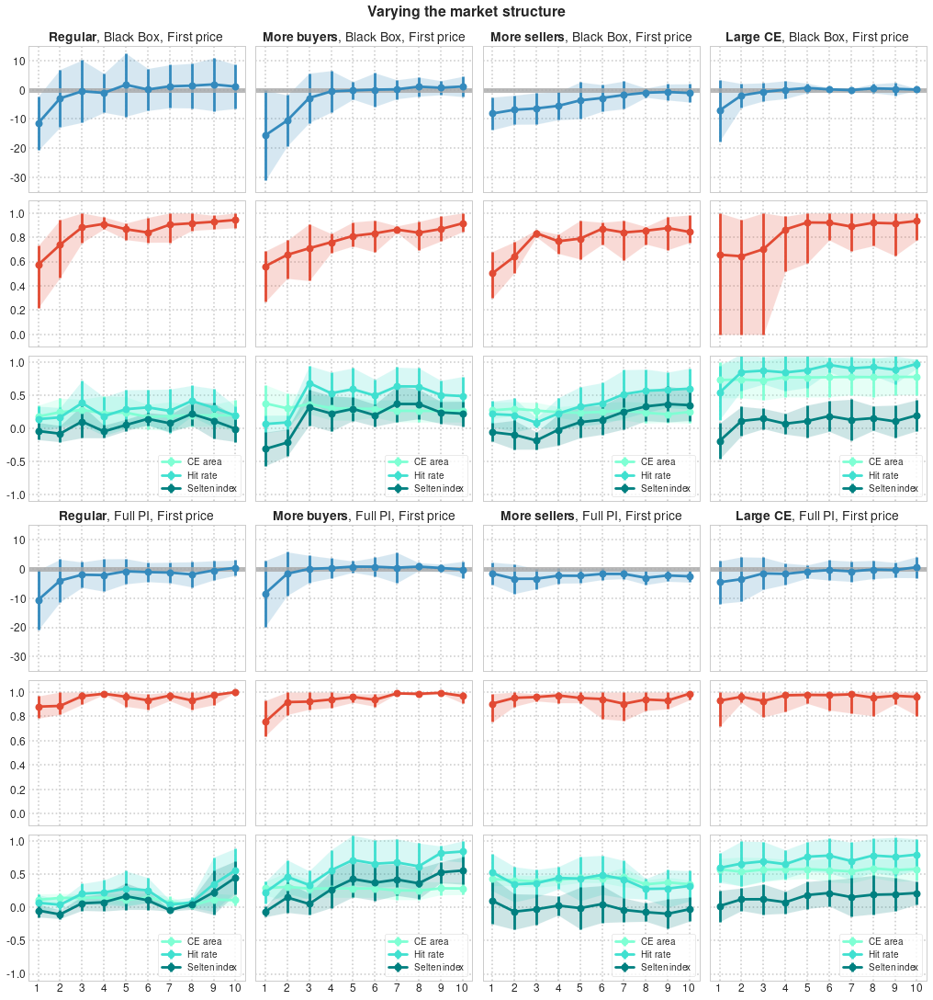

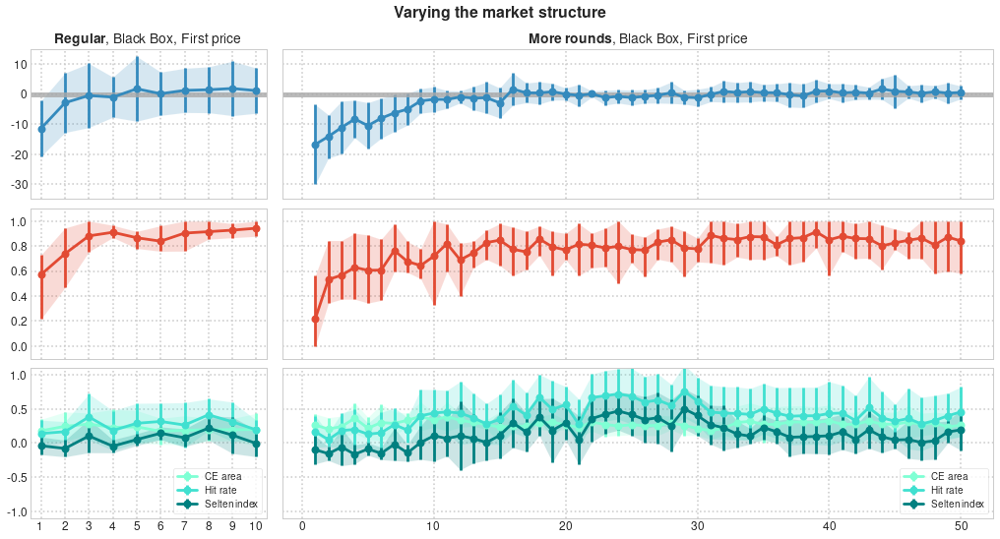

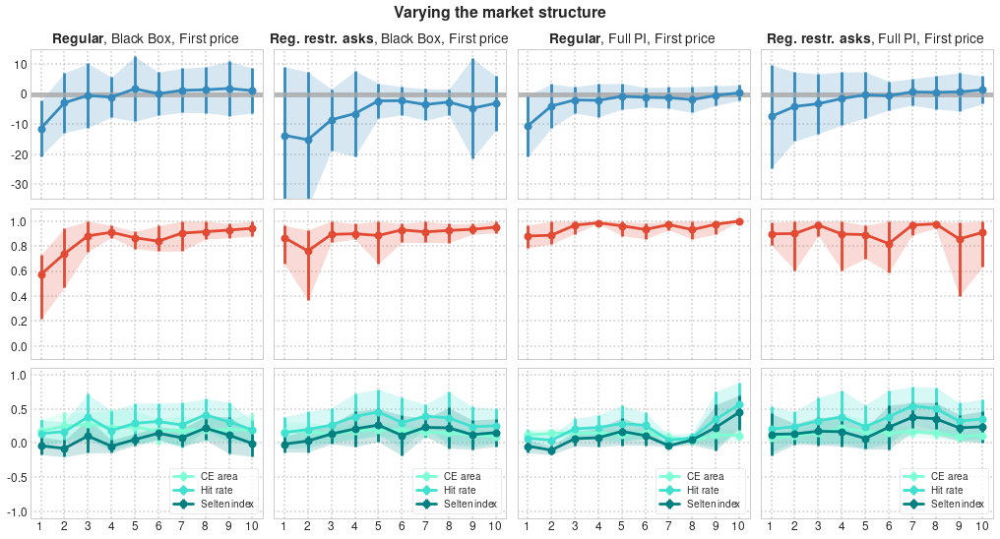

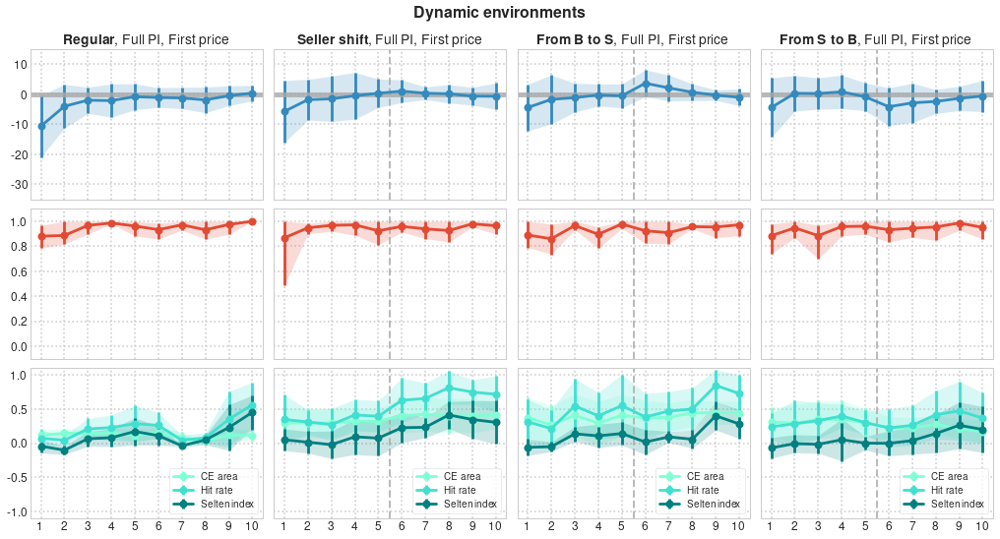

In [48]:
treatment_grid_arrangement = {'feedback': [['BB', 'Same', 'Other', 'Full']],
                              'price': [['BB', 'BBRandom', 'BBMMK', 'SameMMK']],
                              'structure_1': [['BB', 'BBMoreB', 'BBMoreS', 'BBLargeCE'], ['Full', 'FullMoreB', 'FullMoreS', 'FullLargeCE']],
                              'structure_2': [['BB', 'BBMoreRounds']],
                              'structure_3': [['BB', 'BBLimS', 'Full', 'FullLimS']],
                              'dynamics': [['Full', 'FullSShift', 'FullFromBtoS', 'FullFromStoB']]}

for key, treatments in treatment_grid_arrangement.items():
    dim = key.split('_')[0]
    
    suptitle = treatment_dimensions[dim][1]
    bold_title_part = treatment_dimensions[dim][2]
        
    if 'MoreRounds' in ' '.join(flatten_list(treatments)):
        kwargs = {'gridspec_kw': {'width_ratios': [1, 3]}} # reserve more space for the treatment with more periods
    else:
        kwargs = {}
    
    fig, ax = treatment_grid(treatments=treatments, suptitle=suptitle, bold_title_part=bold_title_part,
                             functions=[(distances_to_EPR, 'sdev'), (allocative_efficiency, 'minmax'), (Selten_index, 'sdev')], **kwargs)

#     _ = plt.savefig('Figures/EPR_AllEff_SI_{}.pdf'.format(key), bbox_inches='tight', transparent=True)

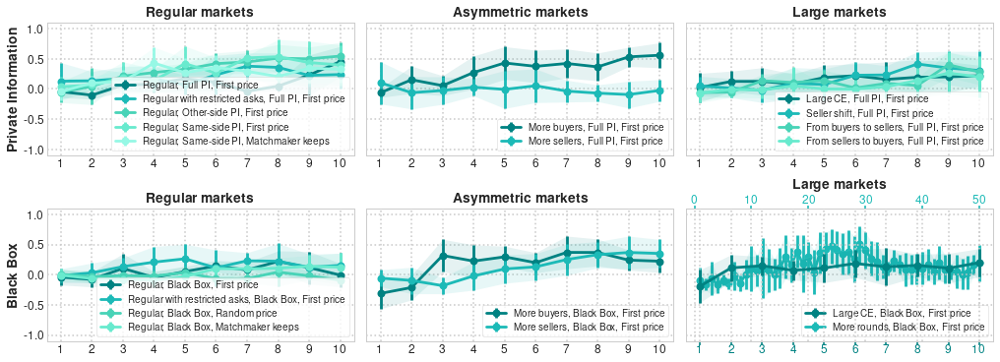

In [49]:
treatment_grid_combined(treatment_groups, Selten_index, 'sdev', teal_palette)
_ = plt.savefig('Figures/Selten_index.pdf', bbox_inches='tight', transparent=True)

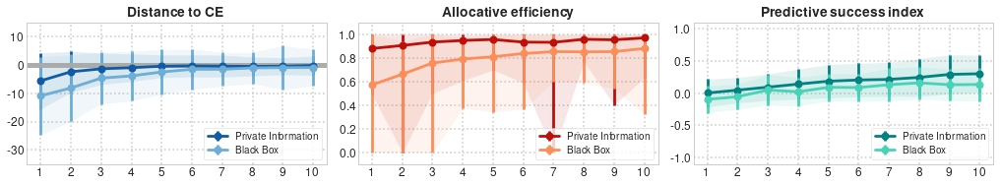

In [50]:
fig, ax = plt.subplots(1,3, figsize=(14,2.5), sharex=True, constrained_layout=True)

df10 = df[df['round'] <= 10].copy()

df10_BB = df10[df10['treatment'].isin(BB_treatments)]
df10_PI = df10[~df10['treatment'].isin(BB_treatments)]

rows = [('Private Information', df10_PI, 0), ('Black Box', df10_BB, 2)]
cols = [(0, distances_to_EPR, 'sdev', blue_palette, 'Distance to CE'),
        (1, allocative_efficiency, 'minmax', red_palette, 'Allocative efficiency'),
        (2, Selten_index, 'sdev', teal_palette, 'Predictive success index')]

for (label, data, colour_id) in rows:
    for (col, fun, errorbar_type, palette, title) in cols:
        mean_evolution(ax[col], data, fun, errorbar_type, alpha=0.1,
                       **{'colour': palette[colour_id], 'label': label})
        grid_layout(ax[col], fun) 
        _ = ax[col].legend(loc='lower right', fontsize=10)
        _ = ax[col].set_title(bold_text(title), fontsize=14)

_ = plt.savefig('Figures/AllMarkets_CE_AE_SI.pdf', bbox_inches='tight', transparent=True)

### Comparison across treatments

In [51]:
def Selten_index_treatments(eps1=0, eps2=0):
    index = pd.Index([treatment_names[treatment] for treatment in df['treatment'].unique()], name='Treatment')
    columns = pd.MultiIndex.from_product([['All', 'Last five'], ['Predictive success index', 'Hit rate', 'Area']], names=['Rounds', 'Metrics'])
    df_SeltenIndex = pd.DataFrame(index=index, columns=columns, dtype=float)

    for treatment, df_treatment in df.groupby(['treatment']):
        metrics = {(rounds, metric): [] for (rounds, metric) in columns}

        maxRound = df_treatment['round'].max()
        n_lastFive = df_treatment[df_treatment['round'] > maxRound-5]['price'].count()
        n_all = df_treatment['price'].count()

        for (game, rnd), dfr in df_treatment.groupby(['game', 'round']):
            m, r, a = Selten_index(dfr, treatment, game, rnd, output='all', eps1=eps1, eps2=eps2)
            n = dfr['price'].count()

            metrics['All', 'Predictive success index'].append(m*n/n_all)
            metrics['All', 'Hit rate'].append(r*n/n_all)
            metrics['All', 'Area'].append(a*n/n_all)

            if rnd > maxRound-5:
                metrics['Last five', 'Predictive success index'].append(m*n/n_lastFive)
                metrics['Last five', 'Hit rate'].append(r*n/n_lastFive)
                metrics['Last five', 'Area'].append(a*n/n_lastFive)

        metrics = {key: np.nansum(values) for (key, values) in metrics.items()}

        df_SeltenIndex.loc[treatment_names[treatment]] = metrics
    
    return df_SeltenIndex

In [52]:
df_SeltenIndex = Selten_index_treatments()
df_SeltenIndex.round(2)
# print(df_SeltenIndex.round(2).to_latex())

Rounds                                                                  All  \
Metrics                                            Predictive success index   
Treatment                                                                     
More sellers, Full PI, First price                                    -0.00   
More sellers, Black Box, First price                                   0.14   
More buyers, Full PI, First price                                      0.32   
More buyers, Black Box, First price                                    0.20   
Large CE, Full PI, First price                                         0.17   
More rounds, Black Box, First price                                    0.16   
Seller shift, Full PI, First price                                     0.19   
From buyers to sellers, Full PI, First price                           0.11   
Large CE, Black Box, First price                                       0.21   
From sellers to buyers, Full PI, First price                           0.06   
Regular, Black Box, First price                                        0.07   
Regular, Black Box, Matchmaker keeps                                   0.04   
Regular, Black Box, Random price                                      -0.02   
Regular, Full PI, First price                                          0.10   
Regular, Other-side PI, First price                                    0.35   
Regular, Same-side PI, First price                                     0.33   
Regular, Same-side PI, Matchmaker keeps                                0.24   
Regular with restricted asks, Black Box, First ...                     0.16   
Regular with restricted asks, Full PI, First price                     0.20   

Rounds                                                             \
Metrics                                            Hit rate  Area   
Treatment                                                           
More sellers, Full PI, First price                     0.39  0.40   
More sellers, Black Box, First price                   0.39  0.25   
More buyers, Full PI, First price                      0.59  0.27   
More buyers, Black Box, First price                    0.48  0.28   
Large CE, Full PI, First price                         0.70  0.53   
More rounds, Black Box, First price                    0.43  0.27   
Seller shift, Full PI, First price                     0.50  0.31   
From buyers to sellers, Full PI, First price           0.44  0.33   
Large CE, Black Box, First price                       0.80  0.59   
From sellers to buyers, Full PI, First price           0.31  0.25   
Regular, Black Box, First price                        0.25  0.18   
Regular, Black Box, Matchmaker keeps                   0.22  0.18   
Regular, Black Box, Random price                       0.17  0.18   
Regular, Full PI, First price                          0.21  0.11   
Regular, Other-side PI, First price                    0.73  0.38   
Regular, Same-side PI, First price                     0.59  0.25   
Regular, Same-side PI, Matchmaker keeps                0.40  0.17   
Regular with restricted asks, Black Box, First ...     0.32  0.16   
Regular with restricted asks, Full PI, First price     0.33  0.13   

Rounds                                                            Last five  \
Metrics                                            Predictive success index   
Treatment                                                                     
More sellers, Full PI, First price                                    -0.04   
More sellers, Black Box, First price                                   0.29   
More buyers, Full PI, First price                                      0.45   
More buyers, Black Box, First price                                    0.28   
Large CE, Full PI, First price                                         0.23   
More rounds, Black Box, First price                                    0.08   
Seller shift, Full PI, First pr

In [53]:
def Selten_index_groups(eps1=0, eps2=0):
    feedback_type = list(set([key[1] for key in treatment_groups.keys()]))
    market_type = list(set([key[0].split()[0] for key in treatment_groups.keys()]))

    index = pd.MultiIndex.from_product([feedback_type, market_type], names=['Feedback', 'Market type'])
    columns = pd.MultiIndex.from_product([['All', 'Last five'], ['Predictive success index', 'Hit rate', 'Area']], names=['Rounds', 'Metrics'])
    df_SeltenIndex = pd.DataFrame(index=index, columns=columns, dtype=float)
    
    for group_name, group in treatment_groups.items():
        feedback = group_name[1]
        market = group_name[0].split()[0]
        
        metrics = {(rounds, metric): [] for (rounds, metric) in columns} # store the metrics for each of the market groups separately
    
        df_group = df[df['treatment'].isin(group)]
    
        n_lastFive = df_group.groupby(['treatment']).apply(lambda g: g[g['round'] > max(g['round']-5)])['price'].count()
        n_all = df_group['price'].count()
    
        for treatment, df_treatment in df_group.groupby(['treatment']):
            maxRound = df_treatment['round'].max()

            for (game, rnd), dfr in df_treatment.groupby(['game', 'round']):
                m, r, a = Selten_index(dfr, treatment, game, rnd, output='all', eps1=eps1, eps2=eps2)
                n = dfr['price'].count()

                metrics['All', 'Predictive success index'].append(m*n/n_all)
                metrics['All', 'Hit rate'].append(r*n/n_all)
                metrics['All', 'Area'].append(a*n/n_all)

                if rnd > maxRound-5:
                    metrics['Last five', 'Predictive success index'].append(m*n/n_lastFive)
                    metrics['Last five', 'Hit rate'].append(r*n/n_lastFive)
                    metrics['Last five', 'Area'].append(a*n/n_lastFive)

        metrics = {key: np.nansum(values) for (key, values) in metrics.items()}

        df_SeltenIndex.loc[feedback, market] = metrics
    
    return df_SeltenIndex

In [54]:
df_SeltenIndex_groups = Selten_index_groups(eps1=0, eps2=0)
df_SeltenIndex_groups.round(2)
# print(df_SeltenIndex_groups.round(2).to_latex())

Rounds                                               All                 \
Metrics                         Predictive success index Hit rate  Area   
Feedback            Market type                                           
Private Information Asymmetric                      0.16     0.49  0.34   
                    Regular                         0.24     0.45  0.21   
                    Large                           0.15     0.55  0.41   
Black Box           Asymmetric                      0.17     0.43  0.26   
                    Regular                         0.07     0.24  0.18   
                    Large                           0.17     0.50  0.33   

Rounds                                         Last five                 
Metrics                         Predictive success index Hit rate  Area  
Feedback            Market type                                          
Private Information Asymmetric                      0.21     0.53  0.33  
                    Regular                         0.35     0.56  0.21  
                    Large                           0.22     0.64  0.42  
Black Box           Asymmetric                      0.28     0.54  0.26  
                    Regular                         0.10     0.28  0.18  
                    Large                           0.19     0.62  0.43

### Black Box versus Private Information

In [55]:
def Selten_index_BB_PI(eps1=0, eps2=0, rounds='All'):
    index = pd.Index(['Private Information', 'Black Box', 'All'], name='Treatments')
    columns = ['Predictive success index', 'Hit rate', 'Area']
    df_results = pd.DataFrame(index=index, columns=columns, dtype=float)

    df_SeltenIndex = Selten_index_treatments(eps1=eps1, eps2=eps2)
    
    for idx in index:
        if idx == 'Black Box':
            metrics = df_SeltenIndex[df_SeltenIndex.index.str.contains('Black Box')]
            data = df[df['treatment'].isin(BB_treatments)]
        elif idx == 'Private Information':
            metrics = df_SeltenIndex[~df_SeltenIndex.index.str.contains('Black Box')]
            data = df[~df['treatment'].isin(BB_treatments)]
        else:
            metrics = df_SeltenIndex
            data = df

        m = []
        r = []
        a = []
        
        if rounds == 'All':
            n_all = data['price'].count()
        elif rounds == 'Last five':
            n_all = data.groupby(['treatment']).apply(lambda g: g[g['round'] > max(g['round']-5)])['price'].count()

        for treatment, df_treatment in data.groupby(['treatment']):
            if rounds == 'All':
                n = df_treatment['price'].count()
            elif rounds == 'Last five':
                n = df_treatment[df_treatment['round'] > max(df_treatment['round']-5)]['price'].count()

            m.append(metrics.loc[treatment_names[treatment], (rounds, 'Predictive success index')]*n/n_all)
            r.append(metrics.loc[treatment_names[treatment], (rounds, 'Hit rate')]*n/n_all)
            a.append(metrics.loc[treatment_names[treatment], (rounds, 'Area')]*n/n_all)

        df_results.loc[idx, 'Predictive success index'] = np.nansum(m)
        df_results.loc[idx, 'Hit rate'] = np.nansum(r)
        df_results.loc[idx, 'Area'] = np.nansum(a)
    
    return df_results

In [56]:
printmd(r'**$\pi \in \epr{}{}$, all rounds**')
df_SeltenIndex_BBPI = Selten_index_BB_PI(eps1=0, eps2=0, rounds='All')
df_SeltenIndex_BBPI.round(2)
print(df_SeltenIndex_BBPI.round(2).to_latex())

printmd(r'**$\pi \in \epr{}{}$, last five rounds**')
df_results = Selten_index_BB_PI(eps1=0, eps2=0, rounds='Last five')
df_results.round(2)
# print(df_results.round(2).to_latex())

**$\pi \in \epr{}{}$, all rounds**

,Predictive success index,Hit rate,Area
Treatments,,,
Private Information,0.18,0.50,0.32
Black Box,0.13,0.40,0.26
All,0.16,0.46,0.30


\begin{tabular}{lrrr}
\toprule
{} &  Predictive success index &  Hit rate &  Area \\
Treatments          &                           &           &       \\
\midrule
Private Information &                      0.18 &      0.50 &  0.32 \\
Black Box           &                      0.13 &      0.40 &  0.26 \\
All                 &                      0.16 &      0.46 &  0.30 \\
\bottomrule
\end{tabular}



**$\pi \in \epr{}{}$, last five rounds**

,Predictive success index,Hit rate,Area
Treatments,,,
Private Information,0.26,0.59,0.32
Black Box,0.17,0.43,0.25
All,0.23,0.53,0.30


In [57]:
def PSI_rounds_1_10(eps1=0, eps2=0):
    index = pd.Index(['Private Information', 'Black Box', 'All'], name='Treatments')
    columns = pd.MultiIndex.from_product([['Round 1', 'Round 10'], ['Predictive success index', 'Hit rate', 'Area']])
    df_results = pd.DataFrame(index=index, columns=columns, dtype=float)

    for idx in index:
        if idx == 'Black Box':
            data = df[df['treatment'].isin(BB_treatments)]
        elif idx == 'Private Information':
            data = df[~df['treatment'].isin(BB_treatments)]
        else:
            data = df

        metrics = {}
            
        for rnd in [1, 10]:
            n_all = data[data['round'] == rnd]['price'].count()

            metrics[('Round {}'.format(rnd), 'Predictive success index')] = []
            metrics[('Round {}'.format(rnd), 'Hit rate')] = []
            metrics[('Round {}'.format(rnd), 'Area')] = []
            
            for (treatment, game), dfr in data[data['round'] == rnd].groupby(['treatment', 'game']):
                m, r, a = Selten_index(dfr, treatment, game, rnd, output='all', eps1=eps1, eps2=eps2)
                n = dfr['price'].count()

                metrics[('Round {}'.format(rnd), 'Predictive success index')].append(m*n/n_all)
                metrics[('Round {}'.format(rnd), 'Hit rate')].append(r*n/n_all)
                metrics[('Round {}'.format(rnd), 'Area')].append(a*n/n_all)
        
        metrics = {key: np.nansum(values) for (key, values) in metrics.items()}

        df_results.loc[idx] = metrics
            
    return df_results

In [58]:
df_results = PSI_rounds_1_10(eps1=0, eps2=0)
df_results
print(df_results.round(2).to_latex())

Round 1                      \
                    Predictive success index  Hit rate      Area   
Treatments                                                         
Private Information                 0.014215  0.321823  0.307608   
Black Box                          -0.068986  0.187500  0.256486   
All                                -0.008506  0.285141  0.293647   

                                    Round 10                      
                    Predictive success index  Hit rate      Area  
Treatments                                                        
Private Information                 0.317078  0.626005  0.308928  
Black Box                           0.162454  0.416290  0.253835  
All                                 0.259549  0.547980  0.288430

\begin{tabular}{lrrrrrr}
\toprule
{} & \multicolumn{3}{l}{Round 1} & \multicolumn{3}{l}{Round 10} \\
{} & Predictive success index & Hit rate &  Area & Predictive success index & Hit rate &  Area \\
Treatments          &                          &          &       &                          &          &       \\
\midrule
Private Information &                     0.01 &     0.32 &  0.31 &                     0.32 &     0.63 &  0.31 \\
Black Box           &                    -0.07 &     0.19 &  0.26 &                     0.16 &     0.42 &  0.25 \\
All                 &                    -0.01 &     0.29 &  0.29 &                     0.26 &     0.55 &  0.29 \\
\bottomrule
\end{tabular}



### Widening the CE range

In [59]:
rounds = df.groupby(['treatment', 'game', 'round'])
rounds_woDeal = rounds.filter(lambda g: g['price'].count() == 0)[['treatment', 'game', 'round']].drop_duplicates()

In [60]:
printmd('Rounds with no deal struck: {}'.format(len(rounds_woDeal)))
rounds_woDeal

printmd('All rounds: {}'.format(len(rounds)))

Rounds with no deal struck: 7

,treatment,game,round
27202,BBMoreRounds,1,1
28748,BBMoreRounds,2,1
42473,BBLargeCE,7,1
42491,BBLargeCE,7,2
42505,BBLargeCE,7,3
72880,Same,5,2
72958,Same,5,7


All rounds: 1238

Check for rounds with no bids submitted

In [61]:
for treatment, df_treatment in df.groupby(['treatment']):
    max_round = max(df_treatment['round'])
    
    for rnd in range(1, max_round+1):
        for game, df_game in df_treatment.groupby(['game']):
            if len(df_game[df_game['round'] == rnd]) == 0:
                print('Round {} of game {} under treatment {} is missing'.format(rnd, game, treatment))

Round 25 of game 1 under treatment BBMoreRounds is missing
Round 10 of game 4 under treatment FullLargeCE is missing


**Problem 1**: The absence of some players may reduce the CE price range to a single point, resulting in a low value of PSI (despite convergence)

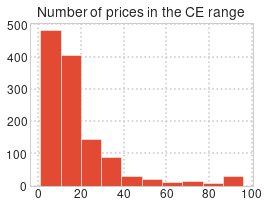

Fraction of rounds with a singleton CE range

0.19305331179321486

Summary statistics

count    1238.000000
mean       16.848142
std        19.675201
min         1.000000
25%         6.000000
50%        11.000000
75%        21.000000
max        96.000000
dtype: float64

In [62]:
nEPR = []
_ = plt.figure(figsize=(4,3))

for key, EPR in EPR_rounds.items():
    nEPR.append(EPR[1] - EPR[0] + 1)

_ = plt.title('Number of prices in the CE range')
_ = plt.hist(nEPR)
_ = plt.show()

printmd('Fraction of rounds with a singleton CE range')
len([n for n in nEPR if n == 1])/len(nEPR)

printmd('Summary statistics')
pd.Series(nEPR).describe()

**Problem 2**: The absence of some players may lead to an excessively wide CE price range, resulting in a low value of PSI (despite the existence of a much narrower range of attraction)

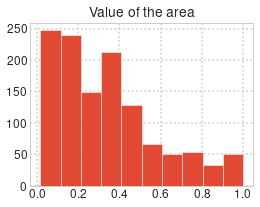

Fraction of rounds with an area of 1

0.026807473598700244

Summary statistics

count    1231.000000
mean        0.332401
std         0.252869
min         0.016053
25%         0.172164
50%         0.306115
75%         0.466907
max         1.000000
dtype: float64

In [63]:
_ = plt.figure(figsize=(4,3))
areas = []

for (treatment, game, rnd), dfr in df.groupby(['treatment', 'game', 'round']):
    prices = dfr[dfr['price'].notna()]
    
    if len(prices) > 0:
        valuations = get_valuations(dfr)
        possible_trade_pairs = [(vals, valb) for (vals, valb) in itertools.product(valuations['Seller'], valuations['Buyer']) if vals <= valb]

        nOutcomes = [valb - vals + 1 for (vals, valb) in possible_trade_pairs]
        nOutcomes = np.mean(nOutcomes)

        EPR = EPR_rounds[treatment, game, rnd]

        area = (EPR[1] - EPR[0] + 1)/nOutcomes
        
        if area > 1:
            area = 1
            
        areas.append(area)

_ = plt.title('Value of the area')
_ = plt.hist(areas)
_ = plt.show()

printmd('Fraction of rounds with an area of 1')
len([a for a in areas if a >= 1])/len(areas)

printmd('Summary statistics')
pd.Series(areas).describe()

Max PSI at eps=3


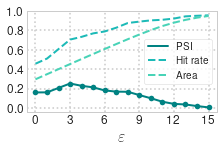

In [64]:
fig, ax = plt.subplots(1,1, figsize=(3,2), sharex=True, sharey=True, constrained_layout=True)

#_ = ax.set_title(bold_text(r'Predictive success index of $\epr{-\varepsilon}{+\varepsilon}$'), fontsize=14)
metrics = {metric: [] for metric in ['Predictive success index', 'Hit rate', 'Area']}

eps_range = np.arange(0,16,1)

for eps in eps_range:
    df_results = Selten_index_BB_PI(eps1=eps, eps2=eps)

    for col in df_results.columns:
        metrics[col].append(df_results.loc['All', col])

colours = {'$\mathrm{PSI}$': teal_palette[0], 'Hit rate': teal_palette[1], 'Area': teal_palette[2]}
legend_elements = []

for metric, values in metrics.items():
    if metric == 'Predictive success index':
        metric = '$\mathrm{PSI}$'
        linestyle = 'solid'
        marker = '.'
    else:
        linestyle = 'dashed'
        marker = None
        
    _ = ax.plot(eps_range, values, color=colours[metric],
                marker=marker, linestyle=linestyle, linewidth=2)        
    legend_elements.append(Line2D([0], [0], color=colours[metric], lw=2,
                                  linestyle=linestyle, label=metric))

xticks = np.arange(0,16,3)
_ = ax.set_xticks(xticks)
_ = ax.set_xticklabels(xticks, fontsize=12)
_ = ax.set_xlabel(r'$\varepsilon$', fontsize=16)

yticks = np.arange(0,1.1,0.2).round(1)
_ = ax.set_yticks(yticks)
_ = ax.set_yticklabels(yticks, fontsize=12)
    
_ = ax.legend(handles=legend_elements, fontsize=10, loc='center right')

index_max = metrics['Predictive success index'].index(max(metrics['Predictive success index']))
print('Max PSI at eps={}'.format(eps_range[index_max]))

_ = plt.savefig('Figures/Selten_index_extendedCE.pdf', bbox_inches='tight', transparent=True)

Private Information: max PSI at eps=3
Black Box: max PSI at eps=3


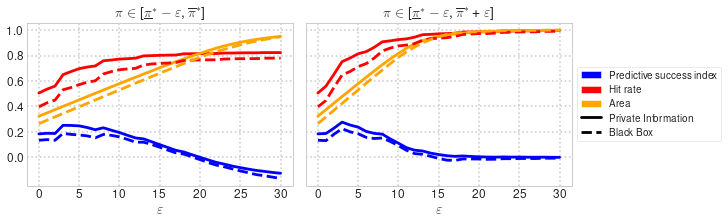

In [65]:
fig, ax = plt.subplots(1,2, figsize=(10,3), sharex=True, sharey=True, constrained_layout=True)

for j in range(2):
    if j == 0:
        title = r'$\pi \in \epr{-\varepsilon}{}$'
    else:
        title = r'$\pi \in \epr{-\varepsilon}{+\varepsilon}$'
        
    metrics = {(idx, metric): [] for (idx, metric) in itertools.product(['Private Information', 'Black Box'], ['Predictive success index', 'Hit rate', 'Area'])}
    eps_range = range(0,31,1)

    for eps1 in eps_range:
        if j == 0:
            eps2 = 0
        else:
            eps2 = eps1
            
        df_results = Selten_index_BB_PI(eps1=eps1, eps2=eps2)

        for idx in ['Private Information', 'Black Box']:
            for col in df_results.columns:
                metrics[(idx, col)].append(df_results.loc[idx, col])

    colours = {'Predictive success index': 'blue', 'Hit rate': 'red', 'Area': 'orange'}
    styles = {'Black Box': 'dashed', 'Private Information': 'solid'}

    for (idx, metric), values in metrics.items():
        _ = ax[j].plot(eps_range, values, color=colours[metric], linestyle=styles[idx])
    
    xticks = np.arange(0,31,5)
    _ = ax[j].set_xticks(xticks)
    _ = ax[j].set_xticklabels(xticks, fontsize=12)
    _ = ax[j].set_xlabel(r'$\varepsilon$', fontsize=14)
    
    yticks = np.arange(0,1.1,0.2).round(1)
    _ = ax[j].set_yticks(yticks)
    _ = ax[j].set_yticklabels(yticks, fontsize=12)

    _ = ax[j].set_title(title, fontsize=14)
    
legend_elements = [Patch(facecolor='blue', label='Predictive success index'),
                   Patch(facecolor='red', label='Hit rate'),
                   Patch(facecolor='orange', label='Area'),
                   Line2D([0], [0], color='black', label='Private Information'),
                   Line2D([0], [0], color='black', linestyle='dashed', label='Black Box')]
    
_ = ax[1].legend(handles=legend_elements, fontsize=10, loc='center left', bbox_to_anchor=(1, 0.5))

for idx in ['Private Information', 'Black Box']:
    index_max = metrics[(idx, 'Predictive success index')].index(max(metrics[(idx, 'Predictive success index')]))
    print('{}: max PSI at eps={}'.format(idx, eps_range[index_max]))

In [66]:
printmd(r'**$\pi \in \epr{-3}{}$, all rounds**')
df_results = Selten_index_BB_PI(eps1=3, eps2=0)
df_results.round(2)
# print(df_results.round(2).to_latex())

printmd(r'**$\pi \in \epr{-3}{+3}$, all rounds**')
df_results = Selten_index_BB_PI(eps1=3, eps2=3)
df_results.round(2)
# print(df_results.round(2).to_latex())

**$\pi \in \epr{-3}{}$, all rounds**

,Predictive success index,Hit rate,Area
Treatments,,,
Private Information,0.25,0.65,0.40
Black Box,0.19,0.53,0.34
All,0.22,0.60,0.37


**$\pi \in \epr{-3}{+3}$, all rounds**

,Predictive success index,Hit rate,Area
Treatments,,,
Private Information,0.28,0.75,0.48
Black Box,0.22,0.65,0.42
All,0.25,0.71,0.45


In [67]:
def Selten_eps3(dfr, treatment, game, rnd, eps1=3, eps2=3):
    return Selten_index(dfr, treatment, game, rnd, output='SI', eps1=eps1, eps2=eps2)

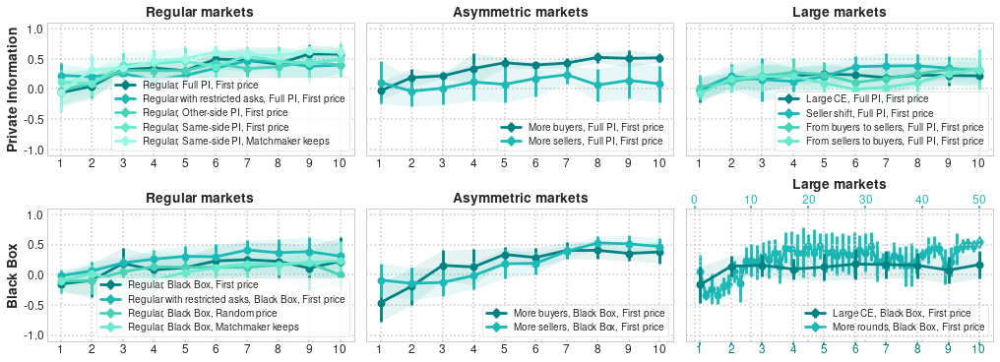

In [68]:
treatment_grid_combined(treatment_groups, Selten_eps3, 'sdev', teal_palette)
_ = plt.savefig('Figures/Selten_index_eps3.pdf', bbox_inches='tight', transparent=True)

In [69]:
df_SeltenIndex_groups3 = Selten_index_groups(eps1=3, eps2=3)
df_SeltenIndex_groups3.round(2)
#print(df_SeltenIndex_groups3.round(2).to_latex())

Rounds                                               All                 \
Metrics                         Predictive success index Hit rate  Area   
Feedback            Market type                                           
Private Information Asymmetric                      0.23     0.75  0.51   
                    Regular                         0.38     0.75  0.37   
                    Large                           0.21     0.76  0.55   
Black Box           Asymmetric                      0.23     0.68  0.45   
                    Regular                         0.15     0.48  0.33   
                    Large                           0.28     0.76  0.48   

Rounds                                         Last five                 
Metrics                         Predictive success index Hit rate  Area  
Feedback            Market type                                          
Private Information Asymmetric                      0.31     0.81  0.50  
                    Regular                         0.50     0.86  0.37  
                    Large                           0.26     0.81  0.55  
Black Box           Asymmetric                      0.40     0.84  0.44  
                    Regular                         0.23     0.55  0.33  
                    Large                           0.39     0.94  0.56

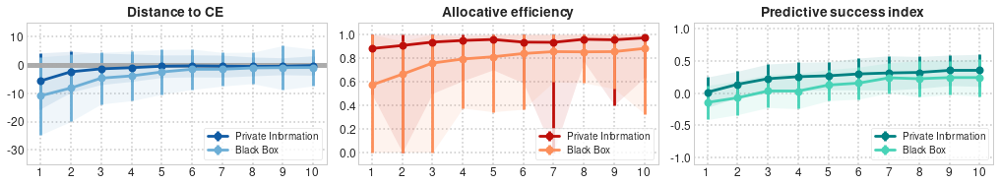

In [70]:
fig, ax = plt.subplots(1,3, figsize=(14,2.5), sharex=True, constrained_layout=True)

df10 = df[df['round'] <= 10].copy()

df10_BB = df10[df10['treatment'].isin(BB_treatments)]
df10_PI = df10[~df10['treatment'].isin(BB_treatments)]

rows = [('Private Information', df10_PI, 0), ('Black Box', df10_BB, 2)]
cols = [(0, distances_to_EPR, 'sdev', blue_palette, 'Distance to CE'),
        (1, allocative_efficiency, 'minmax', red_palette, 'Allocative efficiency'),
        (2, Selten_eps3, 'sdev', teal_palette, 'Predictive success index')]

for (label, data, colour_id) in rows:
    for (col, fun, errorbar_type, palette, title) in cols:
        mean_evolution(ax[col], data, fun, errorbar_type, alpha=0.1,
                       **{'colour': palette[colour_id], 'label': label})
        grid_layout(ax[col], fun) 
        _ = ax[col].legend(loc='lower right', fontsize=10)
        _ = ax[col].set_title(bold_text(title), fontsize=14)

_ = plt.savefig('Figures/AllMarkets_CE_AE_SI_eps3.pdf', bbox_inches='tight', transparent=True)

In [71]:
df_SeltenIndex_BBPI3 = Selten_index_BB_PI(eps1=3, eps2=3).round(2)
df_SeltenIndex_BBPI3
print(df_SeltenIndex_BBPI3.round(2).to_latex())

,Predictive success index,Hit rate,Area
Treatments,,,
Private Information,0.28,0.75,0.48
Black Box,0.22,0.65,0.42
All,0.25,0.71,0.45


\begin{tabular}{lrrr}
\toprule
{} &  Predictive success index &  Hit rate &  Area \\
Treatments          &                           &           &       \\
\midrule
Private Information &                      0.28 &      0.75 &  0.48 \\
Black Box           &                      0.22 &      0.65 &  0.42 \\
All                 &                      0.25 &      0.71 &  0.45 \\
\bottomrule
\end{tabular}



### Hypothesis testing

In [72]:
mean_SI = {}
eps = 0

for rnd in range(1, 11):
    mean_SI[rnd] = []

    for (treatment, game), df_game in df[df['round'] == rnd].groupby(['treatment', 'game']):
        SI = Selten_index(df_game, treatment, game, rnd, output='SI', eps1=eps, eps2=eps)

        if not np.isnan(SI):
            mean_SI[rnd].append(SI)

$\med{\PSI}$: median predictive success index

$H_0: \med{\PSI} \leq \med{0}$ for $\med{0} \in \{ 0, 0.1, \ldots, 0.5 \}$

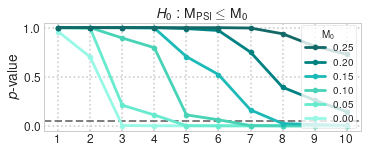

In [73]:
fig, ax = plt.subplots(1,1, figsize=(5,2), sharex=True, sharey=True, constrained_layout=True)

palette = itertools.cycle(reversed(['#136868'] + teal_palette))
Wilcoxon_plot(ax, mean_SI, 'greater', np.linspace(0,0.25,6).round(2), palette, r'$H_0 : \med{\PSI} \leq \med{0}$')
teal_palette = sns.color_palette(['#008282', '#1cbab7', '#48D3B7', '#68EACE', '#96F8E5']) # used for plotting Selten index

_ = ax.set_xlabel('')
_ = handles, labels = ax.get_legend_handles_labels()
_ = ax.legend(handles[::-1], labels[::-1], title=r'$\med{0}$', ncol=1, framealpha=0.8, loc=5)
for t in ax.get_legend().texts:  
    t.set_text('{:.2f}'.format(float(t.get_text())))
    
_ = plt.savefig('Figures/Wilcoxon_SI.pdf', bbox_inches='tight', transparent=True)

# Individual-level data analysis

## Initial demands

In [74]:
df['demand'] = abs(df['valuation'] - df['bid'])
df['reldemand'] = df['demand']/df['valuation']

**Initial bid** = a bid submitted before receiving any feedback whatsoever, i.e.,
- **BlackBox**: each player's first bid
- **Full**: bids submitted (simultaneously) at the very first time step
- **Same**: first (simultaneous) sell-side bids and first (simultaneous) buy-side bids
- **Other**: first bids submitted by players from the side to bid first which precede the other side's first bid

In [75]:
df['initial_bid'] = False

def player_first_bids(df_subset):
    for idx, dfi in df_subset.groupby(['id']):
        first_bid = dfi.nsmallest(1, ['round','time'])
        df.loc[first_bid.index, 'initial_bid'] = True    

for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    if 'BB' in treatment:
        player_first_bids(df_game)
    
    elif 'Full' in treatment:
        game_first_bids = df_game.nsmallest(1, ['round', 'time'], keep='all')
        player_first_bids(game_first_bids)
        
    elif 'Same' in treatment:
        for side, df_side in df_game.groupby(['side']):
            side_first_bids = df_side.nsmallest(1, ['round', 'time'], keep='all')
            player_first_bids(side_first_bids)
            
    elif 'Other' in treatment:
        first_side = df_game.nsmallest(1, ['round', 'time'])['side'].iloc[0]
        other_first_bid = df_game[df_game['side'] != first_side].nsmallest(1, ['round', 'time']).iloc[0]

        df_first_side = df_game[df_game['side'] == first_side]
        other_preceding_bids = df_first_side[(df_first_side['round'] < other_first_bid['round']) | 
                                       ((df_first_side['round'] == other_first_bid['round']) & (df_first_side['time'] <= other_first_bid['time']))]
        player_first_bids(other_preceding_bids)

### Comparison across treatments

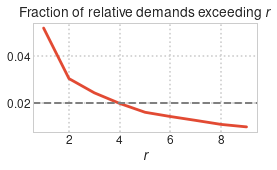

Fraction of relative demands > 4: 0.01971384252077883

Fraction of _initial_ relative demands > 4: 0.040194884287454324

In [76]:
_ = plt.figure(figsize=(4,2))
_ = plt.title('Fraction of relative demands exceeding $r$')
_ = plt.plot(range(1,10), [len(df[df['reldemand'] > rnd])/len(df) for rnd in range(1,10)])
_ = plt.axhline(0.02, color='gray', linestyle='dashed', linewidth=2)
_ = plt.xlabel('$r$')
_ = plt.show()

printmd('Fraction of relative demands > 4: {}'.format(len(df[df['reldemand'] > 4])/len(df)))
printmd('Fraction of _initial_ relative demands > 4: {}'.format(len(df[(df['initial_bid']) & (df['reldemand'] > 4)])/len(df[df['initial_bid']])))

Notes:
1. Private Information treatments are not plotted separately due to the small numbers of initial bids.
2. Linear (resp. symmetrical logarithmic) scale is used to plot relative (resp. absolute) demands.
3. <s>To make figures with a linear scale more visually appealing, sellers' asks that exceed the value of 250 are not plotted (this applies to 3% of the data, that is, 2,322 observations out of a total of 77,618 observations – see ``df_truncated`` below).</s> Due to technical issues (sellers being assigned a valuation of 1) that occurred during the newly conducted experimental sessions, truncating the data with the approach outlined does not eliminate all outliers in terms of relative demands. In the updated analysis, all the data is kept and all relative demands exceeding 4 are clipped to 4 (which applies to roughly 2\% of relative demands – see above).
4. To avoid $\log{0}$, a symmetrical logarithmic scale with ```linthresh``` set to 3* is used (i.e., the plot is linear within ```(-linthresh, linthresh)``` and logarithmic elsewhere). 

<sub>[*] 3 was chosen at a later stage to always use a linear scale when plotting non-outlier sellers' asks.</sub>

In [77]:
linthresh = 3
clipthresh = 4

scale_vars = {'relative': 'reldemand', 'midpointCE': 'rescaledBid', 'log': 'demand'}

In [78]:
bid_q97 = df['bid'].quantile(.97)
print('97th quantile:', bid_q97)
df_truncated = df[df['bid'] <= bid_q97].copy()

print('Total number of samples:', len(df))
print('Samples in the truncated dataset:', len(df_truncated))

97th quantile: 250.0
Total number of samples: 86386
Samples in the truncated dataset: 83976


```symlog``` below manually computes symmetrical log and as such handles a broader range of use cases than [matplotlib's symlog scale](https://matplotlib.org/3.1.1/api/scale_api.html#matplotlib.scale.SymmetricalLogScale)

In [79]:
def symlog(x, linthresh=linthresh):
    if x <= linthresh:
        return x
    else:
        return np.log10(x)

In [80]:
def initial_demand_subplot(ax, df, scale, title, bins=None):    
    df_initial_demands = df[df['initial_bid']]

    # Relative demands are bounded below by zero
    if scale in ['relative', 'midpointCE']:
        _ = ax.axvline(x=0, linestyle='solid', linewidth=5.0,
                       color='darkgrey', alpha=0.8, zorder=0)
    
    initial_demands = {}
    
    for side, df_side in df_initial_demands.groupby(['side']):
        if scale == 'relative':
            initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side]['reldemand']
            initial_demands[side] = np.clip(initial_demands[side], None, clipthresh)
        elif scale == 'log':
            initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side]['demand'].apply(symlog)
        elif scale == 'midpointCE':
            initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side]['rescaledBid']
            initial_demands[side] = np.clip(initial_demands[side], None, clipthresh)
            
    if bins is None:
        bins = np.histogram(np.hstack(list(initial_demands.values())), bins=8)[1]
    
    for side, vals in initial_demands.items():
        _ = sns.histplot(vals, label = '{}s'.format(side), stat='density',
                         ax=ax, bins=bins, color=side_colours[side], kde=True, kde_kws={'cut': 3})

    if scale == 'log':
        xticks = ax.get_xticks()
        _ = ax.set_xticks(xticks)
        _ = ax.set_xticklabels([r'$10^{{{}}}$'.format(int(x)) for x in xticks])
        
    _ = ax.set_xlabel('')
    _ = ax.set_ylabel('')

    _ = ax.set_title(title, fontsize=14)
    
def initial_demand_grid(rows, columns, treatments, suptitle, scale):
    (rows, columns) = np.shape(treatments)
    fig, ax = plt.subplots(rows, columns, figsize=(14,2.5*rows), 
                           sharex=True, sharey=True, constrained_layout=True)
    ax = ax.flatten()

#     if scale == 'relative':
#         data = df_truncated
#         var = 'reldemand'
#     elif scale == 'midpointCE':
#         data = df_truncated
#         var = 'rescaledBid'
#     elif scale == 'log':
#         var = 'demand'
    data = df
    var = scale_vars[scale]
    
    # Same bins across all histograms
    all_initial_demands = {}
    df_initial_demands = data[data['initial_bid']]
    
    for side, df_side in df_initial_demands.groupby(['side']):
        all_initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side][var]
        
        if scale == 'log':
            all_initial_demands[side] = all_initial_demands[side].apply(symlog)
        elif (scale == 'relative') or (scale == 'midpointCE'):
            all_initial_demands[side] = np.clip(all_initial_demands[side], None, clipthresh)
    
    bins = np.histogram(np.hstack(list(all_initial_demands.values())), bins=12)[1]
    
    for idx, treatment in enumerate(flatten_list(treatments)):
        if not treatment is None:
            title = emphasise_text(treatment_names[treatment], ',', 0)
            title = title.replace('Regular with restricted asks', 'Reg. restr. asks')
                
            initial_demand_subplot(ax[idx], data[data['treatment'] == treatment], scale=scale,
                                   title=title, bins=bins)
        
    _ = plt.suptitle(bold_text(suptitle), fontsize=16)
            
    return fig, ax, bins

#### Initial relative demands

Histograms and Gaussian kernel density estimates of the initial demands for payoff relative to the valuations, as expressed by $(\bval{i} - \bbid{i}{1})/\bval{i}$ and $(\sbid{j}{1} - \sval{j})/\sval{j}$ for buyers $b_i \in B$ and sellers $s_j \in S$, respectively. Note that bids/asks that would result in negative payoffs are not permitted.

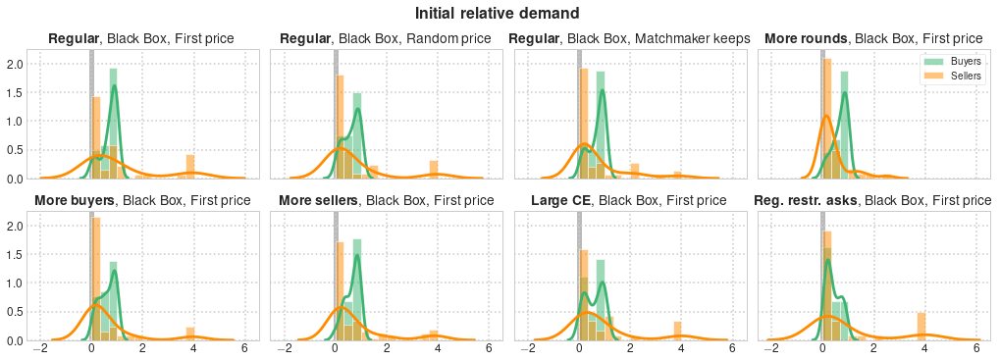

In [81]:
treatments = [['BB', 'BBRandom', 'BBMMK', 'BBMoreRounds'], ['BBMoreB', 'BBMoreS', 'BBLargeCE', 'BBLimS']]

fig, ax, bins = initial_demand_grid(2, 4, treatments, 'Initial relative demand', scale='relative')
ax = ax.flatten()

_ = ax[3].legend(loc='upper right', fontsize=10)    
    
_ = plt.savefig('Figures/InitialRelDemands_treatmets.pdf', bbox_inches='tight', transparent=True)

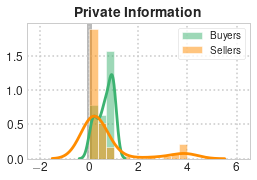

In [82]:
fig, ax_PI = plt.subplots(1,1, figsize=(4,2.5))
initial_demand_subplot(ax_PI, df[df['treatment'].isin(all_treatments.difference(BB_treatments))],
                       scale='relative', title=bold_text('Private Information'), bins=bins)
_ = plt.setp(ax_PI, xlim=ax[0].get_xlim())
_ = ax_PI.legend(loc='upper right', fontsize=10)

#### Initial log demands versus initial relative demands

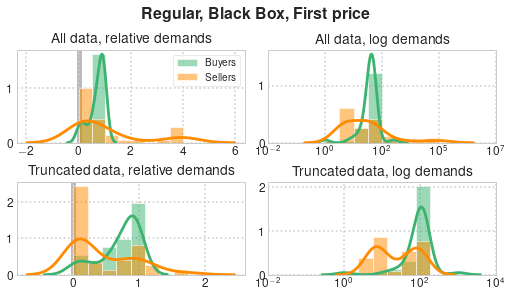

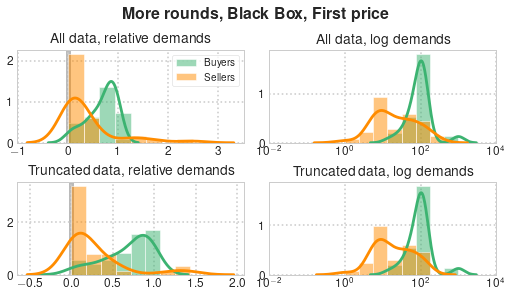

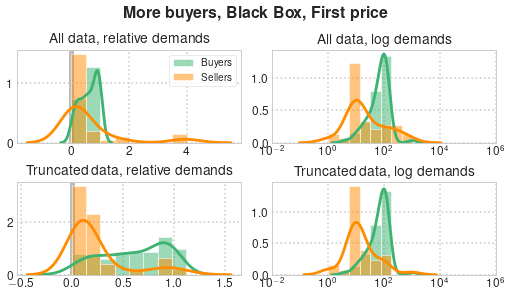

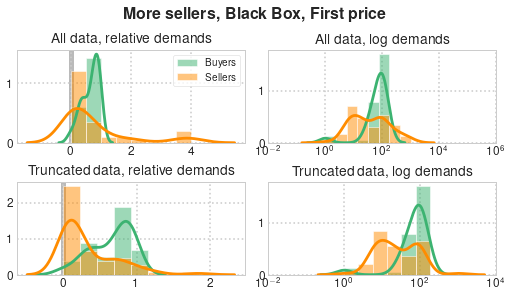

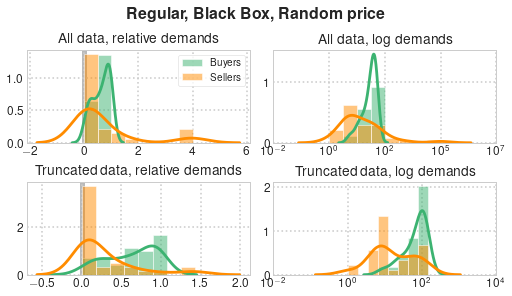

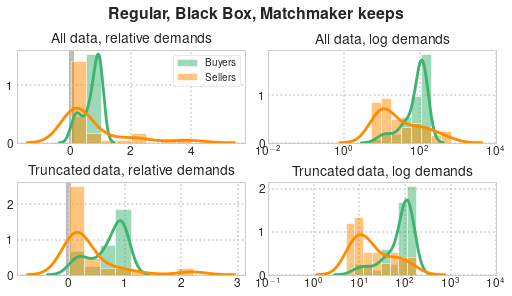

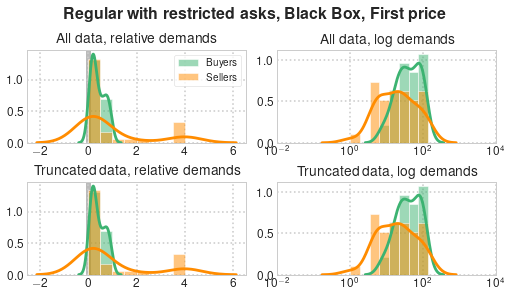

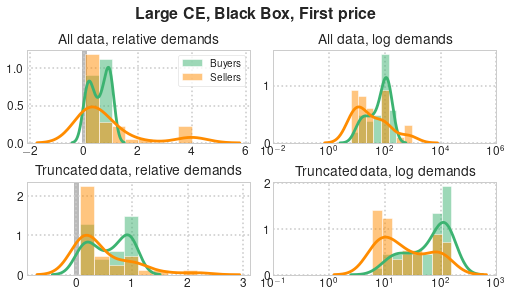

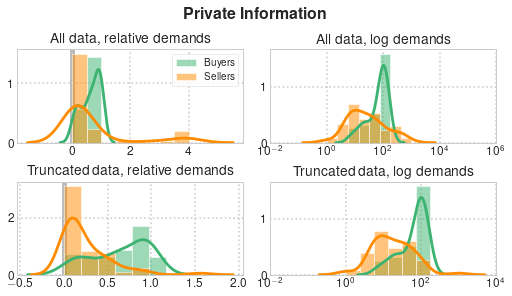

In [83]:
def initial_demand_scale_comparison(treatment, suptitle):
    data = {'all': df, 'truncated': df_truncated}

    fig, ax = plt.subplots(2,2, figsize=(7,4), constrained_layout=True)
    ax = ax.flatten()
    
    for idx, (data_filter, scale) in enumerate(itertools.product(['all', 'truncated'], ['relative', 'log'])): 
        df_treatment = data[data_filter]
        df_treatment = df_treatment[df_treatment['treatment'].isin(treatment)]
        initial_demand_subplot(ax[idx], df_treatment, scale=scale,
                               title='{} data, {} demands'.format(data_filter.capitalize(), scale))
         
    _ = ax[0].legend(fontsize=10)
    _ = plt.suptitle(bold_text(suptitle), fontsize=16)
    _ = plt.show()   

for treatment in BB_treatments:
    initial_demand_scale_comparison([treatment], treatment_names[treatment])
    
initial_demand_scale_comparison(all_treatments.difference(BB_treatments), 'Private Information')

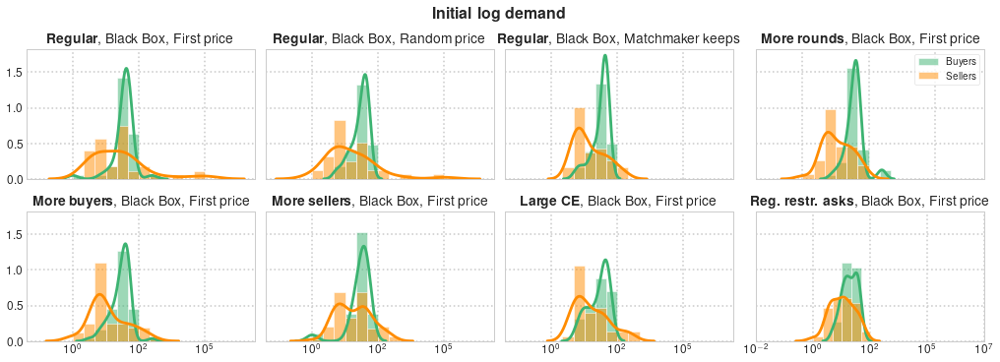

In [84]:
treatments = [['BB', 'BBRandom', 'BBMMK', 'BBMoreRounds'], ['BBMoreB', 'BBMoreS', 'BBLargeCE', 'BBLimS']]

fig, ax, bins = initial_demand_grid(2, 4, treatments, 'Initial log demand', scale='log')
ax = ax.flatten()

_ = ax[3].legend(loc='upper right', fontsize=10)

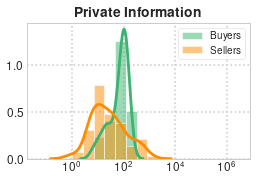

In [85]:
fig, ax_PI = plt.subplots(1,1, figsize=(4,2.5))
initial_demand_subplot(ax_PI, df[df['treatment'].isin(all_treatments.difference(BB_treatments))],
                       scale='log', title=bold_text('Private Information'), bins=bins)
_ = plt.setp(ax_PI, xlim=ax[0].get_xlim())
_ = ax_PI.legend(loc='upper right', fontsize=10)

#### Initial bids/asks shifted and scaled by the CE midpoint

Histograms and Gaussian kernel density estimates of the first bids/asks submitted by the market participants shifted and scaled by the midpoint $\pi_M^* := (\underline \pi^* + \overline \pi^*)/2$ of the CE price range $\epr{}{}$. That is, $(\bbid{i}{1} - \pi_M^*)/\pi_M^*$ and $(\sbid{j}{1} - \pi_M^*)/\pi_M^*$ are reported for buyers $b_i \in B$ and sellers $s_j \in S$, respectively.

In [86]:
def rescale_CErange(x, a, b):
    avg = (a+b)/2
    return (x - avg)/avg

In [87]:
for (treatment, game, rnd), dfr in df.groupby(['treatment', 'game', 'round']): #df_truncated.groupby(['treatment', 'game', 'round']):
    [epr1,epr2] = EPR_rounds[treatment, game, rnd]

#     df_truncated.loc[dfr.index, 'rescaledBid'] = dfr['bid'].apply(rescale_CErange, args=(epr1, epr2))
    df.loc[dfr.index, 'rescaledBid'] = dfr['bid'].apply(rescale_CErange, args=(epr1, epr2))

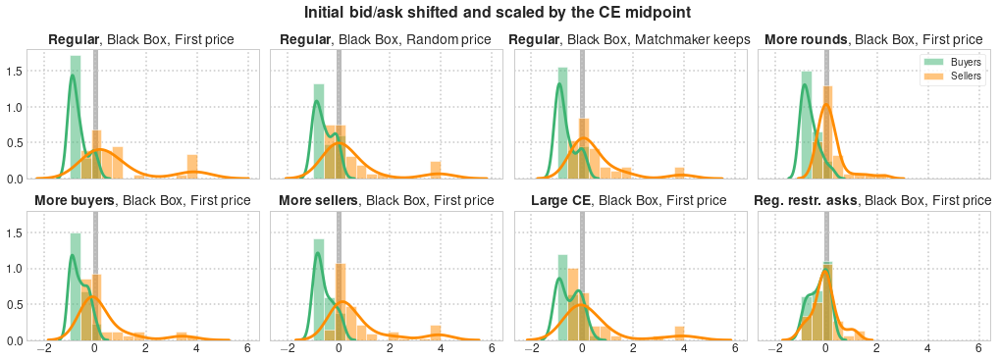

In [88]:
treatments = [['BB', 'BBRandom', 'BBMMK', 'BBMoreRounds'], ['BBMoreB', 'BBMoreS', 'BBLargeCE', 'BBLimS']]

fig, ax, bins = initial_demand_grid(2, 4, treatments, 'Initial bid/ask shifted and scaled by the CE midpoint', 
                                    scale='midpointCE')
ax = ax.flatten()

_ = ax[3].legend(loc='upper right', fontsize=10)    

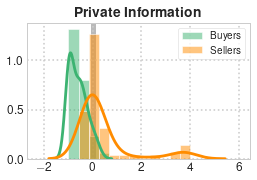

In [89]:
fig, ax_PI = plt.subplots(1,1, figsize=(4,2.5))
initial_demand_subplot(ax_PI, df[df['treatment'].isin(all_treatments.difference(BB_treatments))],
                       scale='midpointCE', title=bold_text('Private Information'), bins=bins)
_ = plt.setp(ax_PI, xlim=ax[0].get_xlim())
_ = ax_PI.legend(loc='upper right', fontsize=10)

#### Median initial relative demands

Note: the sessions with restricted asks are left out of the plot below

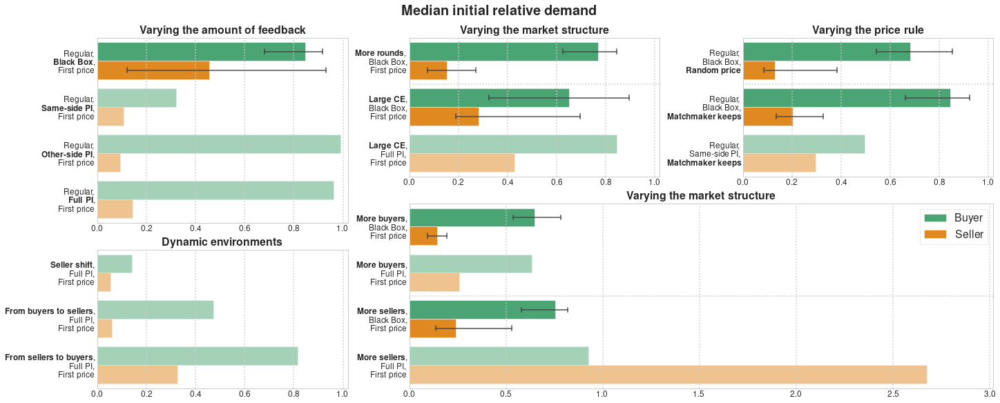

In [90]:
fig = plt.figure(constrained_layout=True, figsize=(20,8))
gs = fig.add_gridspec(7,9)

ax = []
ax.append(fig.add_subplot(gs[0:4, 0:3]))
ax.append(fig.add_subplot(gs[0:3, 6:9], sharex=ax[0]))
ax.append(fig.add_subplot(gs[0:3, 3:6], sharex=ax[0]))
ax.append(fig.add_subplot(gs[3:7, 3:9]))
ax.append(fig.add_subplot(gs[4:7, 0:3], sharex=ax[0]))

treatment_grid_arrangement = {'feedback': ['BB', 'Same', 'Other', 'Full'],
                              'price': ['BBRandom', 'BBMMK', 'SameMMK'],
                              'structure_1': ['BBMoreRounds', 'BBLargeCE','FullLargeCE'],
                              'structure_2': ['BBMoreB','FullMoreB','BBMoreS','FullMoreS'],
                              'dynamics': ['FullSShift', 'FullFromBtoS', 'FullFromStoB']}

for idx, (key, treatments) in enumerate(treatment_grid_arrangement.items()):
    dim = key.split('_')[0]
    title = treatment_dimensions[dim][1]
    bold_title_part = treatment_dimensions[dim][2]

    data = df[(df['initial_bid']) & (df['treatment'].isin(treatments))]

    sfig = sns.barplot(y='treatment', x='reldemand', hue='side', data=data, ax=ax[idx],
                       zorder=-100, palette=side_colours, hue_order=['Buyer', 'Seller'],
                       order=treatments, ci=95, estimator=np.median, **{'capsize':0.1})
 
    # Subplot layout
    _ = ax[idx].set_xlabel('')
    
    if 'FullMoreS' in treatments:
        _ = ax[idx].set_xlim((0,3.02))
        _ = ax[idx].legend(title=None, fontsize=16)
    else:
        _ = ax[idx].set_xlim((0,1.02))
        _ = ax[idx].legend_.remove()
    
    _ = ax[idx].set_ylabel('') 
    _ = ax[idx].set_yticks(ax[idx].get_yticks().tolist())
    _ = ax[idx].set_yticklabels([emphasise_text(treatment_names[treatment], separator=', ', part=bold_title_part).replace(',', ',\n') for treatment in treatments])
    
    _ = ax[idx].set_title(bold_text(title), fontsize=16)
    
    # Remove error bars and change transparency when there is only a small number of initial bids
    kept_lines = []
    wrap_lines = int(len(ax[idx].lines)/2)
    wrap_patches = int(len(ax[idx].patches)/2)
    
    for (j, treatment) in enumerate(ax[idx].get_ymajorticklabels()):
        if 'Black Box' in treatment.get_text():
            kept_lines.extend(ax[idx].lines[3*j:3*j+3]) # buyer error bars
            kept_lines.extend(ax[idx].lines[3*j+wrap_lines:3*j+wrap_lines+3]) # seller error bars
        else:
            ax[idx].patches[j].set_alpha(0.5)
            ax[idx].patches[j+wrap_patches].set_alpha(0.5)
            
    ax[idx].lines = kept_lines
    
    for line in ax[idx].lines:
        line.set_alpha(0.7)
        line.set_linewidth(2)

# Add separators to group related treatments
for idx, yticks in zip([1,2,3],[[0.5],[0.5],[1.5]]):
    _ = ax[idx].yaxis.grid(True, which='minor')
    _ = ax[idx].set_yticks(yticks, minor=True)

_ = fig.suptitle(bold_text('Median initial relative demand'), fontsize=20)

Mann–Whitney–Wilcoxon rank-sum tests to compare differences between buyers and sellers

In [91]:
index = pd.Index([treatment_names[treatment] for treatment in df['treatment'].unique()],
                 name='Treatment')

dtypes = {('Median initial bid vs. ask', 'Buyers'): float, ('Median initial bid vs. ask', 'Sellers'): float,
          ('Sample size', 'Buyers'): int, ('Sample size', 'Sellers'): int, ('MWW', '$p$-value'): float, ('MWW', 'P(X > Y)'): float}
columns = pd.MultiIndex.from_tuples(dtypes.keys())

df_initial_reldemands = pd.DataFrame(index=index, columns=columns)

def initial_reldemands_add_row(idx, df, MWW, df_results):
    initial_reldemands = []
    
    for side, df_side in df.groupby(['side']):
        df_results.loc[idx, ('Median initial bid vs. ask', '{}s'.format(side))] = df_side['reldemand'].median()
        df_results.loc[idx, ('Sample size', '{}s'.format(side))] = df_side['reldemand'].size
        initial_reldemands.append(df_side['reldemand'])
        
    if MWW:
        U, p = stats.mannwhitneyu(*initial_reldemands)
        df_results.loc[idx, ('MWW', 'P(X > Y)')] = U/np.product([len(reld) for reld in initial_reldemands])
        df_results.loc[idx, ('MWW', '$p$-value')] = p        

initial_bids = df[(df['initial_bid'])]

for treatment, df_treatment in initial_bids.groupby(['treatment']):
    idx = treatment_names[treatment]

    if 'BB' in treatment:
        MWW = True
    else:
        MWW = False
    
    initial_reldemands_add_row(idx, df_treatment, MWW=MWW, df_results=df_initial_reldemands)

initial_reldemands_add_row('Private Information combined', initial_bids[~initial_bids['treatment'].isin(BB_treatments)], MWW=True, df_results=df_initial_reldemands)
initial_reldemands_add_row('Black Box combined', initial_bids[initial_bids['treatment'].isin(BB_treatments)], MWW=True, df_results=df_initial_reldemands)
initial_reldemands_add_row('All treatments', initial_bids, MWW=True, df_results=df_initial_reldemands)

df_initial_reldemands = df_initial_reldemands.astype(dtype=dtypes)

In [92]:
df_initial_reldemands.round(2)
# print(df_initial_reldemands.round(2).to_latex())

Median initial bid vs. ask  \
                                                                       Buyers   
Treatment                                                                       
More sellers, Full PI, First price                                       0.93   
More sellers, Black Box, First price                                     0.76   
More buyers, Full PI, First price                                        0.63   
More buyers, Black Box, First price                                      0.65   
Large CE, Full PI, First price                                           0.84   
More rounds, Black Box, First price                                      0.77   
Seller shift, Full PI, First price                                       0.14   
From buyers to sellers, Full PI, First price                             0.47   
Large CE, Black Box, First price                                         0.65   
From sellers to buyers, Full PI, First price                             0.82   
Regular, Black Box, First price                                          0.85   
Regular, Black Box, Matchmaker keeps                                     0.84   
Regular, Black Box, Random price                                         0.68   
Regular, Full PI, First price                                            0.96   
Regular, Other-side PI, First price                                      0.99   
Regular, Same-side PI, First price                                       0.32   
Regular, Same-side PI, Matchmaker keeps                                  0.50   
Regular with restricted asks, Black Box, First ...                       0.32   
Regular with restricted asks, Full PI, First price                       0.59   
Private Information combined                                             0.68   
Black Box combined                                                       0.71   
All treatments                                                           0.71   

                                                           Sample size  \
                                                   Sellers      Buyers   
Treatment                                                                
More sellers, Full PI, First price                    2.68           1   
More sellers, Black Box, First price                  0.24          44   
More buyers, Full PI, First price                     0.26           6   
More buyers, Black Box, First price                   0.14          74   
Large CE, Full PI, First price                        0.43           6   
More rounds, Black Box, First price                   0.15          40   
Seller shift, Full PI, First price                    0.05           3   
From buyers to sellers, Full PI, First price          0.06           2   
Large CE, Black Box, First price                      0.28          38   
From sellers to buyers, Full PI, First price          0.33           4   
Regular, Black Box, First price                       0.46          42   
Regular, Black Box, Matchmaker keeps                  0.20          43   
Regular, Black Box, Random price                      0.13          40   
Regular, Full PI, First price                         0.14           3   
Regular, Other-side PI, First price                   0.09           3   
Regular, Same-side PI, First price                    0.11           7   
Regular, Same-side PI, Matchmaker keeps               0.30           4   
Regular with restricted asks, Black Box, First ...    0.24          35   
Regular with restricted asks, Full PI, First price    0.21           3   
Private Information combined                          0.19          42   
Black Box combined                                    0.19         356   
All treatments                                        0.19         398   

                                                                 MWW           
                                                   Sellers $p$-value P(X > Y)  
Treatment     

### Black Box versus Private Information

In [93]:
def initial_BB_PI(scale, ax=None):
    if ax is None:
        fig, ax = plt.subplots(1,2, figsize=(8,2), sharex=True, sharey=True,
                               constrained_layout=True)
    
#     if scale == 'relative':
#         data = df_truncated
#         var = 'reldemand'
#     elif scale == 'midpointCE':
#         data = df_truncated
#         var = 'rescaledBid'
#     elif scale == 'log':
#         data = df
#         var = 'demand'
    data = df
    var = scale_vars[scale]

    subplots = {'Private Information': data[~data['treatment'].isin(BB_treatments)],
                'Black Box': data[data['treatment'].isin(BB_treatments)]}

    # Same bins across all histograms
    all_initial_demands = {}
    df_initial_demands = data[data['initial_bid']]

    for side, df_side in df_initial_demands.groupby(['side']):
        all_initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side][var]

        if scale == 'log':
            all_initial_demands[side] = all_initial_demands[side].apply(symlog)
        elif (scale == 'relative') or (scale == 'midpointCE'):
            all_initial_demands[side] = np.clip(all_initial_demands[side], None, clipthresh)
            
    bins = np.histogram(np.hstack(list(all_initial_demands.values())), bins=12)[1]

    for idx, (title, data) in enumerate(subplots.items()):
        initial_demand_subplot(ax[idx], df=data, scale=scale, title=bold_text(title), bins=bins)
        
    for axi in ax:
        _ = axi.set_xlabel('')
        _ = axi.set_ylabel('')

    _ = ax[1].legend(fontsize=10)
    
    return ax[0].figure, ax

#### Initial relative demands

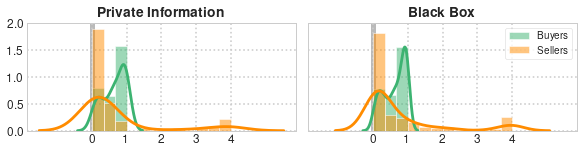

In [94]:
fig, ax = initial_BB_PI('relative')

for axi in ax:
    xticks = np.arange(0,5,1)
    _ = axi.set_xticks(xticks)
    _ = axi.set_xticklabels(xticks, size=12)
    _ = axi.set_ylim((0,2))
    
_ = plt.savefig('Figures/InitialRelDemands.pdf', bbox_inches='tight', transparent=True)

In [95]:
df_initial_BB_PI = df_initial_reldemands.loc[df_initial_reldemands.index.str.contains('combined')].copy()
df_initial_BB_PI.index = df_initial_BB_PI.index.str.replace('combined', '')

df_initial_BB_PI.index.names = ['Treatments']
df_initial_BB_PI.round(2)
# print(df_initial_BB_PI.round(2).to_latex())

Median initial bid vs. ask         Sample size          \
                                         Buyers Sellers      Buyers Sellers   
Treatments                                                                    
Private Information                        0.68    0.19          42      70   
Black Box                                  0.71    0.19         356     353   

                           MWW           
                     $p$-value P(X > Y)  
Treatments                               
Private Information        0.0     0.27  
Black Box                  0.0     0.35

#### Initial log demands

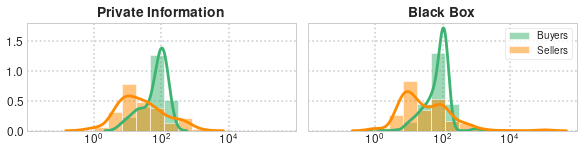

In [96]:
fig, ax = initial_BB_PI('log')

for axi in ax:
    xticks = np.arange(0,5,2)
    _ = axi.set_xticks(xticks)
    _ = axi.set_xticklabels([r'$10^{{{}}}$'.format(int(x)) for x in xticks], size=12)
    _ = axi.set_xlim((-2,6))

#### Initial bids/asks shifted and scaled by the CE midpoint

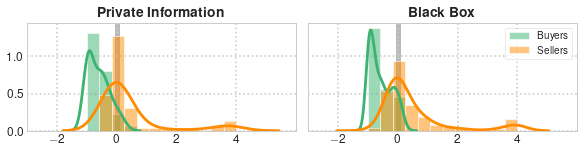

In [97]:
fig, ax = initial_BB_PI('midpointCE')

for axi in ax:
    xticks = np.arange(-2,5,2)
    _ = axi.set_xticks(xticks)
    _ = axi.set_xlim((-3,6))

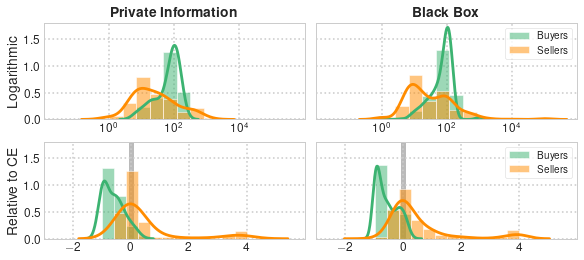

In [98]:
fig, ax = plt.subplots(2,2, figsize=(8,3.5), sharex='row', sharey=True,
                       constrained_layout=True)

_ = initial_BB_PI('log', ax[0])

for axi in ax[0]:
    xticks = np.arange(0,5,2)
    _ = axi.set_xticks(xticks)
    _ = axi.set_xticklabels([r'$10^{{{}}}$'.format(int(x)) for x in xticks], size=12)
    _ = axi.set_xlim((-2,6))
_ = ax[0][0].set_ylabel('Logarithmic')
    
_ = initial_BB_PI('midpointCE', ax[1])

for axi in ax[1]:
    xticks = np.arange(-2,5,2)
    _ = axi.set_xticks(xticks)
    _ = axi.set_xlim((-3,6))
    _ = axi.set_title('')
_ = ax[1][0].set_ylabel('Relative to CE')

_ = plt.savefig('Figures/InitialAbsDemands.pdf', bbox_inches='tight', transparent=True)

### Comparisson across groups of treatments

In [99]:
def treatment_grid_combined(treatments, scale): 
    fig, ax = plt.subplots(1,3, figsize=(14,2.5), sharex=True, sharey=True, constrained_layout=True)
    ax = ax.flatten()

    var = scale_vars[scale]
    
    # Same bins across all histograms
    all_initial_demands = {}
    df_initial_demands = df[df['initial_bid']]

    for side, df_side in df_initial_demands.groupby(['side']):
        all_initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side][var]

        if scale == 'log':
            all_initial_demands[side] = all_initial_demands[side].apply(symlog)
        elif (scale == 'relative') or (scale == 'midpointCE'):
            all_initial_demands[side] = np.clip(all_initial_demands[side], None, clipthresh)
            
    bins = np.histogram(np.hstack(list(all_initial_demands.values())), bins=12)[1]
            
    # Grid with treatment groups
    for idx, ((title, ylabel), treatment_list) in enumerate(treatments.items()):
        if ylabel == 'Private Information':
            treatment_list = list(flatten_list([treatment_groups.get(key) for key in treatment_groups.keys() if key[0] == title]))
        
            data = df[df['treatment'].isin(treatment_list)]

            initial_demand_subplot(ax[idx], df=data, scale=scale, title=bold_text(title), bins=bins)

    _ = ax[2].legend(loc='upper right', fontsize=10)

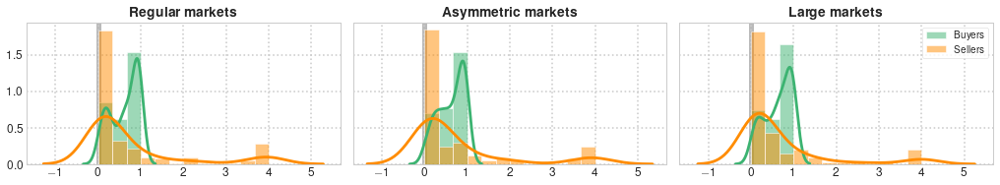

In [100]:
treatment_grid_combined(treatment_groups, 'relative')

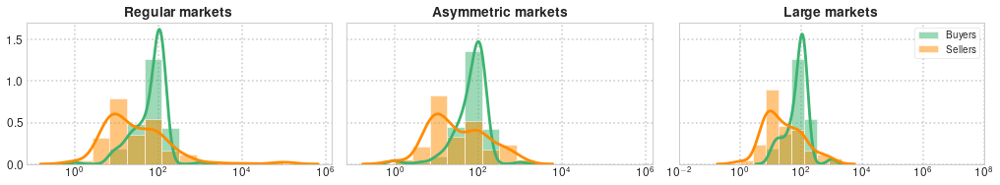

In [101]:
treatment_grid_combined(treatment_groups, 'log')

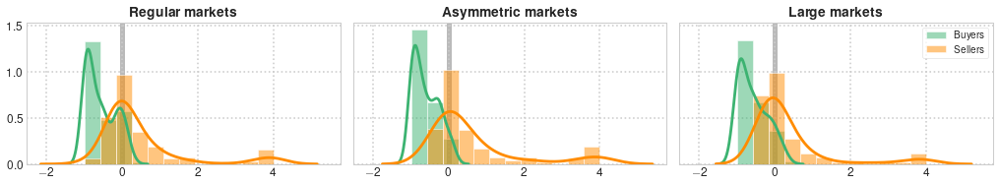

In [102]:
treatment_grid_combined(treatment_groups, 'midpointCE')

In [103]:
index = pd.MultiIndex.from_tuples(list(treatment_groups.keys()), names=['Market structure', 'Feedback'])
dtypes = {('Median initial bid vs. ask', 'Buyers'): float, ('Median initial bid vs. ask', 'Sellers'): float,
          ('Sample size', 'Buyers'): int, ('Sample size', 'Sellers'): int,
          ('MWW', '$p$-value'): float, ('MWW', 'P(X > Y)'): float}
columns = pd.MultiIndex.from_tuples(dtypes.keys())
df_initial_reldemands_groups = pd.DataFrame(index=index, columns=columns)
initial_bids = df[(df['initial_bid'])]

for key, treatments in treatment_groups.items():
    data = initial_bids[initial_bids['treatment'].isin(treatments)]
    idx = treatment_names[treatment]
    
    initial_reldemands_add_row(key, data, MWW=True, df_results=df_initial_reldemands_groups)

df_initial_reldemands_groups = df_initial_reldemands_groups.astype(dtype=dtypes)
df_initial_reldemands_groups.reorder_levels(['Feedback', 'Market structure']).round(2)

Median initial bid vs. ask          \
                                                           Buyers Sellers   
Feedback            Market structure                                        
Private Information Regular markets                          0.73    0.14   
                    Asymmetric markets                       0.84    0.37   
                    Large markets                            0.67    0.19   
Black Box           Regular markets                          0.71    0.20   
                    Asymmetric markets                       0.71    0.17   
                    Large markets                            0.72    0.19   

                                       Sample size               MWW           
                                            Buyers Sellers $p$-value P(X > Y)  
Feedback            Market structure                                           
Private Information Regular markets             20      33      0.00     0.24  
                    Asymmetric markets           7       6      0.42     0.45  
                    Large markets               15      31      0.01     0.28  
Black Box           Regular markets            160     161      0.00     0.37  
                    Asymmetric markets         118     119      0.00     0.34  
                    Large markets               78      73      0.00     0.33

In [104]:
PI_treatment_groups = {key: value for key, value in treatment_groups.items() if key[1] == 'Private Information'}
BB_treatment_groups = {key: value for key, value in treatment_groups.items() if key[1] == 'Black Box'}

index_list = []

for idx, groups in enumerate([PI_treatment_groups, BB_treatment_groups]):
    if idx == 0:
        index_list.append(('Private Information', '', ''))
    else:
        index_list.append(('Black Box', '', ''))
        
    for key, treatments in groups.items():
        index_list.append((key[1], key[0], ''))

        for treatment in treatments:
            name = treatment_names[treatment]
            name = name.split(', ')
            index_list.append((name[1], name[0], name[2]))
        
index_list.append(('', '', ''))
index = pd.MultiIndex.from_tuples(index_list, names=['Feedback', 'Market structure', 'Price rule'])
dtypes = {('Median initial bid vs. ask', 'Buyers'): float, ('Median initial bid vs. ask', 'Sellers'): float,
          ('Sample size', 'Buyers'): int, ('Sample size', 'Sellers'): int,
          ('MWW', '$p$-value'): float, ('MWW', 'P(X > Y)'): float}
columns = pd.MultiIndex.from_tuples(dtypes.keys())
df_initial_reldemands_all = pd.DataFrame(index=index, columns=columns)
df_initial_reldemands_all.sort_index(inplace=True)

initial_bids = df[(df['initial_bid'])]
initial_reldemands_add_row(('Black Box', '', ''), initial_bids[initial_bids['treatment'].str.contains('BB')], MWW=True, df_results=df_initial_reldemands_all)
initial_reldemands_add_row(('Private Information', '', ''), initial_bids[~initial_bids['treatment'].str.contains('BB')], MWW=True, df_results=df_initial_reldemands_all)

for key, treatments in treatment_groups.items():
    initial_reldemands_add_row((key[1], key[0], ''), initial_bids[initial_bids['treatment'].isin(treatments)], MWW=True, df_results=df_initial_reldemands_all)
    
    for treatment in treatments:
        name = treatment_names[treatment]
        name = name.split(', ')
        
        if name[1] == 'Black Box':
            MWW = True
        else:
            MWW = False
        
        initial_reldemands_add_row((name[1], name[0], name[2]), initial_bids[initial_bids['treatment'] == treatment], MWW=MWW, df_results=df_initial_reldemands_all)

initial_reldemands_add_row(('', '', ''), initial_bids, MWW=True, df_results=df_initial_reldemands_all)

df_initial_reldemands_all = df_initial_reldemands_all.reindex(index_list)
df_initial_reldemands_all = df_initial_reldemands_all.astype(dtype=dtypes)
df_initial_reldemands_all.round(2)
df_initial_reldemands_all[('MWW', r'$p$-value')] = df_initial_reldemands_all[('MWW', r'$p$-value')].apply(lambda p: r'$< 0.01$' if p < 0.01 else ('' if np.isnan(p) else r'$({})$'.format(np.round(p,2))))
df_initial_reldemands_all = df_initial_reldemands_all.round(2)

for idx, row in df_initial_reldemands_all.iterrows():
    df_initial_reldemands_all.loc[idx, ('Median initial bid vs. ask', 'Buyers')] = '{} ({})'.format(row[('Median initial bid vs. ask', 'Buyers')], row[('Sample size', 'Buyers')])
    df_initial_reldemands_all.loc[idx, ('Median initial bid vs. ask', 'Sellers')] = '{} ({})'.format(row[('Median initial bid vs. ask', 'Sellers')], row[('Sample size', 'Sellers')])

df_initial_reldemands_all.drop([('Sample size', 'Buyers'), ('Sample size', 'Sellers'), ('MWW', 'P(X > Y)')], axis=1, inplace=True)
print(df_initial_reldemands_all.to_latex(escape=False))

Median initial bid vs. ask  \
                                                                                      Buyers   
Feedback            Market structure             Price rule                                    
Private Information                                                                     0.68   
                    Regular markets                                                     0.73   
Full PI             Regular                      First price                            0.96   
                    Regular with restricted asks First price                            0.59   
Other-side PI       Regular                      First price                            0.99   
Same-side PI        Regular                      First price                            0.32   
                                                 Matchmaker keeps                       0.50   
Private Information Asymmetric markets                                                  0.84   
Full PI             More buyers                  First price                            0.63   
                    More sellers                 First price                            0.93   
Private Information Large markets                                                       0.67   
Full PI             Large CE                     First price                            0.84   
                    Seller shift                 First price                            0.14   
                    From buyers to sellers       First price                            0.47   
                    From sellers to buyers       First price                            0.82   
Black Box                                                                               0.71   
                    Regular markets                                                     0.71   
                    Regular                      First price                            0.85   
                    Regular with restricted asks First price                            0.32   
                    Regular                      Random price                           0.68   
                                                 Matchmaker keeps                       0.84   
                    Asymmetric markets                                                  0.71   
                    More buyers                  First price                            0.65   
                    More sellers                 First price                            0.76   
                    Large markets                                                       0.72   
                    Large CE                     First price                            0.65   
                    More rounds                  First price                            0.77   
                                                                                        0.71   

                                                                           \
                                                                  Sellers   
Feedback            Market structure             Price rule                 
Private Information                                                  0.19   
                    Regular markets                                  0.14   
Full PI             Regular                      First price         0.14   
                    Regular with restricted asks First price         0.21   
Other-side PI       Regular                      First price         0.09   
Same-side PI        Regular                      First price         0.11   
                                                 Matchmaker keeps    0.30   
Private Information Asymmetric markets                               0.37   
Full PI             More buyers                  First price         0.26   
                    More sellers                 First price         2.68   
Private Information Large markets                                    0.19   
Full PI    

\begin{tabular}{llllll}
\toprule
          &             &             & \multicolumn{2}{l}{Median initial bid vs. ask} &       MWW \\
          &             &             &                     Buyers &     Sellers & $p$-value \\
Feedback & Market structure & Price rule &                            &             &           \\
\midrule
Private Information &             &             &                  0.68 (42) &   0.19 (70) &  $< 0.01$ \\
          & Regular markets &             &                  0.73 (20) &   0.14 (33) &  $< 0.01$ \\
Full PI & Regular & First price &                   0.96 (3) &    0.14 (5) &           \\
          & Regular with restricted asks & First price &                   0.59 (3) &    0.21 (4) &           \\
Other-side PI & Regular & First price &                   0.99 (3) &   0.09 (10) &           \\
Same-side PI & Regular & First price &                   0.32 (7) &    0.11 (6) &           \\
          &             & Matchmaker keeps &                 

c:\users\bikica\miniconda3\lib\site-packages\IPython\core\interactiveshell.py:2867: PerformanceWarning: indexing past lexsort depth may impact performance.
  raw_cell, store_history, silent, shell_futures)


Black Box regular with restricted asks without valuation 1

In [105]:
data = df[(df['initial_bid']) & (df['treatment'] == 'BBLimS') & (df['valuation'] > 1)]
buyers = data[data['side'] == 'Buyer']['reldemand']
sellers = data[data['side'] == 'Seller']['reldemand']

print('Buyers: {} ({})'.format(np.median(buyers).round(2), len(buyers)))
print('Sellers: {} ({})'.format(np.median(sellers).round(2), len(sellers)))
U, p = stats.mannwhitneyu(buyers, sellers)
print('p < 0.01: {}'.format(p < 0.01))
print('P(X > Y): {}'.format(np.round(U/(len(buyers)*len(sellers)), 2)))

Buyers: 0.32 (35)
Sellers: 0.14 (29)
p < 0.01: True
P(X > Y): 0.33


### Restricted versus unrestricted asks

In [106]:
df_temp = df.copy()
df_temp.loc[~df_temp['treatment'].str.contains('BB'), 'treatment'] = 'PI'

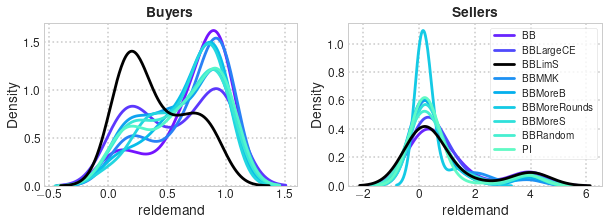

In [107]:
palette = itertools.cycle(sns.color_palette('rainbow', 40))

fig, ax = plt.subplots(1,2, figsize=(10,3))

for (treatment, side), df_side in df_temp[df_temp['initial_bid']].groupby(['treatment', 'side']):
    if side == 'Buyer':
        idx = 0
    else:
        idx = 1
    
    zorder = 1
    
    colour = next(palette)
    if 'LimS' in treatment:
        colour = 'black'
        zorder = 100

    _ = sns.kdeplot(np.clip(df_side['reldemand'], None, 4), label=treatment, color=colour, ax=ax[idx], zorder=zorder)
    _ = ax[idx].set_title(bold_text('{}s'.format(side)))

_ = ax[1].legend()

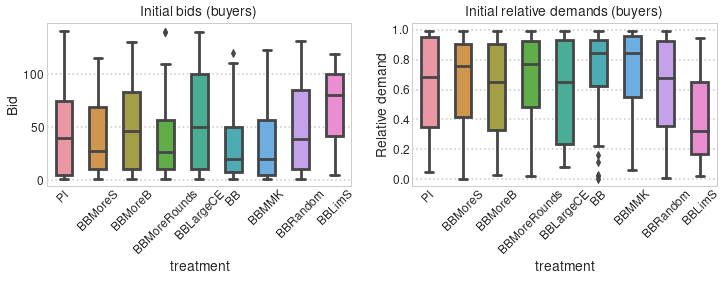

In [108]:
data = df_temp[(df_temp['side'] == 'Buyer') & (df_temp['initial_bid'])]

fig, ax = plt.subplots(1,2, figsize=(12,3), sharex=True)

_ = ax[0].set_title('Initial bids (buyers)')
_ = sns.boxplot(x='treatment', y='bid', data=data, width=0.5, ax=ax[0])
_ = plt.sca(ax[0])
_ = plt.xticks(rotation=45)
_ = ax[0].set_ylabel('Bid')

_ = ax[1].set_title('Initial relative demands (buyers)')
_ = sns.boxplot(x='treatment', y='reldemand', data=data, width=0.5, ax=ax[1])
_ = plt.sca(ax[1])
_ = plt.xticks(rotation=45)
_ = ax[1].set_ylabel('Relative demand')

Note that applying a linear transformation to map seller $s_j$'s action space $[\sval{j}, 200]$ onto $[1, 201-\sval{j}]$ makes $s_j$ directly comparable to buyer $b_i$ with $\bval{i} = 201-\sval{j}$.

Median initial relative demands

Buyers: 0.35
Sellers: 0.11
Mann-Whitney-Wilcoxon test: 0.0
P(X > Y): 0.23


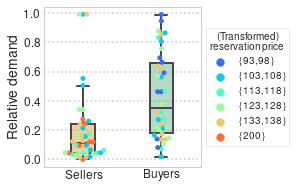

In [109]:
data = df[(df['treatment'].str.contains('LimS')) & (df['initial_bid'])].copy()

sellers = (data['side'] == 'Seller')
data.loc[sellers, 'valuation'] = 201 - data[sellers]['valuation']
data.loc[sellers, 'bid'] = 201 - data[sellers]['bid']
data.loc[sellers, 'reldemand'] = (data[sellers]['valuation'] - data[sellers]['bid'])/data[sellers]['valuation']

printmd('Median initial relative demands')

for side, df_side in data.groupby('side'):
    print('{}s: {}'.format(side, np.median(df_side['reldemand']).round(2)))

reld_buyers = data[data['side'] == 'Buyer']['reldemand']
reld_sellers = data[data['side'] == 'Seller']['reldemand']
U, p = stats.mannwhitneyu(reld_buyers, reld_sellers)
print('Mann-Whitney-Wilcoxon test: {}'.format(p.round(2)))
print('P(X > Y): {}'.format(round(U/(len(reld_buyers)*len(reld_sellers)),2)))

data['valcat'] = data['valuation'].apply(lambda val: r'${} {}3, {}8 {}$'.format('\{', val//10, val//10, '\}') if val != 200 else r'$\{ 200 \}$')

fig, ax = plt.subplots(1,1, figsize=(4,2.5), constrained_layout=True)

_ = sns.boxplot(x='side', y='reldemand', data=data, showfliers=False, ax=ax,
                palette=side_colours, width=0.3, linewidth=2)

for patch in ax.artists:
    *rgb, alpha = patch.get_facecolor()
    patch.set_facecolor((*rgb, 0.4))

_ = sns.swarmplot(x='side', y='reldemand', data=data, ax=ax, palette=sns.color_palette('rainbow', 6),
                  hue='valcat', hue_order=natsorted(data['valcat'].unique()))

_ = ax.set_xticklabels(['{}s'.format(side.get_text()) for side in ax.get_xticklabels()])
_ = ax.set_xlabel('')
_ = ax.set_ylabel('Relative demand')

legend = ax.legend(title='(Transformed)\nreservation price', loc='center left', bbox_to_anchor=(1, 0.5))
_ = plt.setp(legend.get_title(), multialignment='center')

_ = plt.savefig('Figures/RestrictedAsks.pdf', bbox_inches='tight', transparent=True)

Restricted versus unrestricted asks in Black Box versus Private Information

Private Information (buyers: 42, sellers: 70)

Black Box (buyers: 356, sellers: 353)

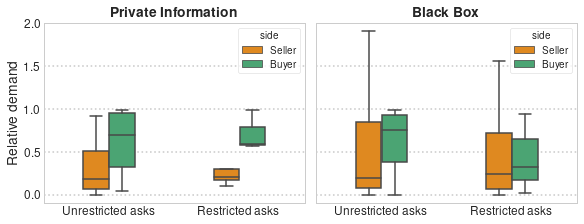

In [110]:
data = df[(df['initial_bid'])].copy()

fig, ax = plt.subplots(1,2, figsize=(8,3), sharey=True, constrained_layout=True)

data['restricted'] = data['treatment'].apply(lambda treatment: 'Restricted asks' if 'LimS' in treatment else 'Unrestricted asks')
data['BB'] = data['treatment'].apply(lambda treatment: 'BB' in treatment)

for BB_flag, d in data.groupby(['BB']):
    title = 'Black Box' if BB_flag else 'Private Information'
    axi = ax[int(BB_flag)]
    
    printmd('{} (buyers: {}, sellers: {})'.format(title, len(d[d['side'] == 'Buyer']), len(d[d['side'] == 'Seller'])))
    
    _ = axi.set_title(bold_text(title))
    _ = sns.boxplot(x='restricted', y='reldemand', data=d, hue='side', ax=axi, hue_order=['Seller', 'Buyer'],
                    showfliers=False, palette=side_colours, width=0.4, linewidth=1.5)
    _ = axi.set_xlabel('')
    _ = axi.set_ylabel('Relative demand')
    _ = axi.label_outer()       
    
_ = plt.show()

## Within-round demand adjustments

Relative-demand adjustment in round $T$:

Buyers:
\begin{equation*}
    \frac{\bval{i} - \bbid{i}{k, T}}{\bval{i}} - \frac{\bval{i} - \bbid{i}{k - 1, T}}{\bval{i}} = -\Delta \bbid{i}{k, T}/\bval{i},
\end{equation*}

Sellers:
\begin{equation*}
    \frac{\sbid{j}{k, T} - \sval{j}}{\sval{j}} - \frac{\sbid{j}{k - 1, T} - \sval{j}}{\sval{j}} = \Delta \sbid{j}{k, T}/\sval{j}
\end{equation*}

In [111]:
df['adjWithin'] = df.groupby(['treatment', 'game', 'round', 'id'])['reldemand'].diff()

### Comparison across treatments

In [112]:
index = pd.Index([treatment_names[treatment] for treatment in df['treatment'].unique()],
                 name='Treatment')

dtypes = {('Median within-round bid/ask adjustment', 'Buyers'): float, ('Median within-round bid/ask adjustment', 'Sellers'): float,
          ('MWW', '$p$-value'): float, ('MWW', 'P(X > Y)'): float,
          ('Non-positive within-round bid/ask adjustment', 'Buyers'): float, ('Non-positive within-round bid/ask adjustment', 'Sellers'): float,
          ('Sample size', 'Buyers'): int, ('Sample size', 'Sellers'): int}
columns = pd.MultiIndex.from_tuples(dtypes.keys())

df_within_round_adjustments = pd.DataFrame(index=index, columns=columns)

def within_round_adjustments_add_row(idx, df, df_results):
    for side, df_side in df.groupby(['side']):
        df_results.loc[idx, ('Median within-round bid/ask adjustment', '{}s'.format(side))] = df_side['adjWithin'].dropna().median()
        
        n_nonPositive = df_side[df_side['adjWithin'] <= 0]['adjWithin'].count()
        n_all = df_side['adjWithin'].count()
        df_results.loc[idx, ('Non-positive within-round bid/ask adjustment', '{}s'.format(side))] = n_nonPositive/n_all*100
        df_results.loc[idx, ('Sample size', '{}s'.format(side))] = n_all
    
    adj_buyers = df[df['side'] == 'Buyer']['adjWithin'].dropna()
    adj_sellers = df[df['side'] == 'Seller']['adjWithin'].dropna()
    U, p = stats.mannwhitneyu(adj_buyers, adj_sellers)
    df_results.loc[idx, ('MWW', '$p$-value')] = p
    df_results.loc[idx, ('MWW', 'P(X > Y)')] = U/(len(adj_buyers)*len(adj_sellers))
    
for treatment, df_treatment in df.groupby(['treatment']):
    idx = treatment_names[treatment]
    within_round_adjustments_add_row(idx, df_treatment, df_within_round_adjustments)

within_round_adjustments_add_row('Private Information combined', df[~df['treatment'].isin(BB_treatments)], df_within_round_adjustments)
within_round_adjustments_add_row('Black Box combined', df[df['treatment'].isin(BB_treatments)], df_within_round_adjustments)

df_within_round_adjustments = df_within_round_adjustments.astype(dtype=dtypes)

In [113]:
columns_round = {('Median within-round bid/ask adjustment', 'Buyers'): 2, ('Median within-round bid/ask adjustment', 'Sellers'): 2, ('MWW', '$p$-value'): 2,
                 ('Non-positive within-round bid/ask adjustment', 'Buyers'): 0, ('Non-positive within-round bid/ask adjustment', 'Sellers'): 0}
dtypes = {('Non-positive within-round bid/ask adjustment', 'Buyers'): int, ('Non-positive within-round bid/ask adjustment', 'Sellers'): int}
add_percentage = lambda col: col.astype(str) + '%' if 'Non-positive' in col.name[0] else col

df_within_round_adjustments.round(columns_round).astype(dtypes).apply(add_percentage)
# df_within_round_adjustments.round(columns_round).astype(dtypes).apply(add_percentage).to_latex(escape=False)

Median within-round bid/ask adjustment  \
                                                                                   Buyers   
Treatment                                                                                   
More sellers, Full PI, First price                                                  -0.01   
More sellers, Black Box, First price                                                -0.03   
More buyers, Full PI, First price                                                    0.00   
More buyers, Black Box, First price                                                 -0.02   
Large CE, Full PI, First price                                                      -0.01   
More rounds, Black Box, First price                                                 -0.03   
Seller shift, Full PI, First price                                                  -0.01   
From buyers to sellers, Full PI, First price                                        -0.01   
Large CE, Black Box, First price                                                    -0.02   
From sellers to buyers, Full PI, First price                                        -0.02   
Regular, Black Box, First price                                                     -0.02   
Regular, Black Box, Matchmaker keeps                                                -0.02   
Regular, Black Box, Random price                                                    -0.04   
Regular, Full PI, First price                                                        0.00   
Regular, Other-side PI, First price                                                  0.00   
Regular, Same-side PI, First price                                                   0.00   
Regular, Same-side PI, Matchmaker keeps                                              0.00   
Regular with restricted asks, Black Box, First ...                                  -0.04   
Regular with restricted asks, Full PI, First price                                  -0.01   
Private Information combined                                                         0.00   
Black Box combined                                                                  -0.03   

                                                                 MWW  \
                                                   Sellers $p$-value   
Treatment                                                              
More sellers, Full PI, First price                    0.00      0.00   
More sellers, Black Box, First price                 -0.01      0.00   
More buyers, Full PI, First price                    -0.03      0.00   
More buyers, Black Box, First price                  -0.04      0.00   
Large CE, Full PI, First price                       -0.01      0.24   
More rounds, Black Box, First price                  -0.02      0.27   
Seller shift, Full PI, First price                   -0.03      0.00   
From buyers to sellers, Full PI, First price         -0.01      0.06   
Large CE, Black Box, First price                     -0.02      0.00   
From sellers to buyers, Full PI, First price          0.00      0.00   
Regular, Black Box, First price                      -0.02      0.38   
Regular, Black Box, Matchmaker keeps                 -0.01      0.00   
Regular, Black Box, Random price                     -0.01      0.00   
Regular, Full PI, First price                         0.00      0.00   
Regular, Other-side PI, First price                   0.00      0.00   
Regular, Same-side PI, First price                    0.00      0.24   
Regular, Same-side PI, Matchmaker keeps               0.00      0.00   
Regular with restricted asks, Black Box, First ...   -0.03      0.00   
Regular with restricted asks, Full PI, First price   -0.01      0.00   
Private Information combined                          0.00      0.00   
Black Box combined                                   -0.01      0.00   

                                                              \
                         

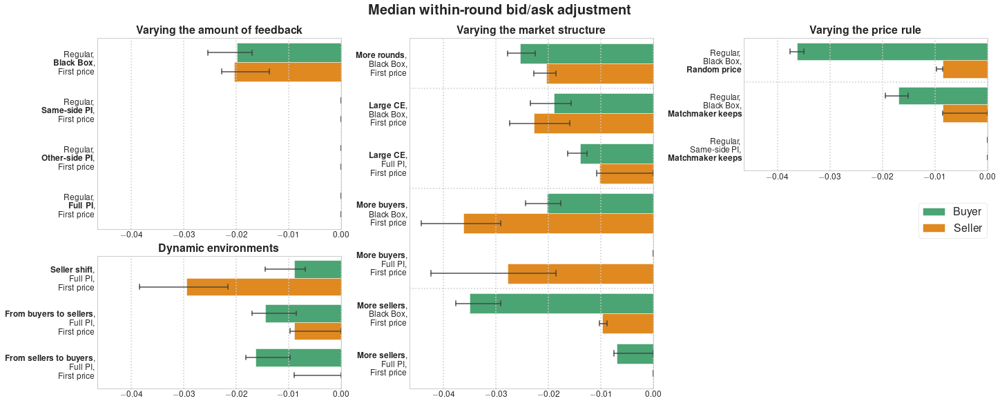

In [114]:
fig = plt.figure(constrained_layout=True, figsize=(20,8))
gs = fig.add_gridspec(7,9)

ax = []
ax.append(fig.add_subplot(gs[0:4, 0:3]))
ax.append(fig.add_subplot(gs[0:3, 6:9], sharex=ax[0]))
ax.append(fig.add_subplot(gs[0:7, 3:6], sharex=ax[0]))
ax.append(fig.add_subplot(gs[4:7, 0:3], sharex=ax[0]))

treatment_grid_arrangement = {'feedback': ['BB', 'Same', 'Other', 'Full'],
                              'price': ['BBRandom', 'BBMMK', 'SameMMK'],
                              'structure': ['BBMoreRounds', 'BBLargeCE', 'FullLargeCE', 'BBMoreB', 'FullMoreB', 'BBMoreS', 'FullMoreS'],
                              'dynamics': ['FullSShift', 'FullFromBtoS', 'FullFromStoB']}

for idx, (key, treatments) in enumerate(treatment_grid_arrangement.items()):
    dim = key.split('_')[0]
    title = treatment_dimensions[dim][1]
    bold_title_part = treatment_dimensions[dim][2]
    
    data = df[df['treatment'].isin(treatments)]

    sfig = sns.barplot(y='treatment', x='adjWithin', hue='side', data=data,
                       ax=ax[idx], zorder=-100,
                       palette=side_colours, hue_order=['Buyer', 'Seller'],
                       order=treatments, ci=95, estimator=np.median, **{'capsize':0.1})
 
    # Subplot layout
    _ = ax[idx].set_xlabel('')
    
    _ = ax[idx].set_ylabel('') 
    _ = ax[idx].set_yticks(ax[idx].get_yticks().tolist())
    _ = ax[idx].set_yticklabels([emphasise_text(treatment_names[treatment], separator=', ', part=bold_title_part).replace(',', ',\n') for treatment in treatments])
    
    _ = ax[idx].set_title(bold_text(title), fontsize=16)
    _ = ax[idx].legend_.remove()
    
    for line in ax[idx].lines:
        line.set_alpha(0.7)
        line.set_linewidth(2)

_ = ax[1].legend(title=None, fontsize=16,
                 loc='upper right', bbox_to_anchor=(1.02, -0.2))
      
# Add separators to group related treatments
for idx, yticks in zip([1,2],[[0.5],[0.5, 2.5, 4.5]]):
    _ = ax[idx].yaxis.grid(True, which='minor')
    _ = ax[idx].set_yticks(yticks, minor=True)

_ = fig.suptitle(bold_text('Median within-round bid/ask adjustment'), fontsize=20)

### Comparisson across groups of treatments

In [115]:
PI_treatment_groups = {key: value for key, value in treatment_groups.items() if key[1] == 'Private Information'}
BB_treatment_groups = {key: value for key, value in treatment_groups.items() if key[1] == 'Black Box'}

index_list = []

for idx, groups in enumerate([PI_treatment_groups, BB_treatment_groups]):
    if idx == 0:
        index_list.append(('Private Information', '', ''))
    else:
        index_list.append(('Black Box', '', ''))
        
    for key, treatments in groups.items():
        index_list.append((key[1], key[0], ''))

        for treatment in treatments:
            name = treatment_names[treatment]
            name = name.split(', ')
            index_list.append((name[1], name[0], name[2]))

index_list.append(('', '', ''))
        
index = pd.MultiIndex.from_tuples(index_list, names=['Feedback', 'Market structure', 'Price rule'])
dtypes = {('Median within-round bid/ask adjustment', 'Buyers'): float, ('Median within-round bid/ask adjustment', 'Sellers'): float, ('MWW', '$p$-value'): float,
          ('Non-positive within-round bid/ask adjustment', 'Buyers'): float, ('Non-positive within-round bid/ask adjustment', 'Sellers'): float,
          ('Sample size', 'Buyers'): int, ('Sample size', 'Sellers'): int}
columns = pd.MultiIndex.from_tuples(dtypes.keys())
df_within_round_adjustments_all = pd.DataFrame(index=index, columns=columns, dtype=float)
df_within_round_adjustments_all.sort_index(inplace=True)

within_round_adjustments_add_row(('Black Box', '', ''), df[df['treatment'].str.contains('BB')], df_results=df_within_round_adjustments_all)
within_round_adjustments_add_row(('Private Information', '', ''), df[~df['treatment'].str.contains('BB')], df_results=df_within_round_adjustments_all)

for key, treatments in treatment_groups.items():
    within_round_adjustments_add_row((key[1], key[0], ''), df[df['treatment'].isin(treatments)], df_results=df_within_round_adjustments_all)
    
    for treatment in treatments:
        name = treatment_names[treatment]
        name = name.split(', ')
        
        within_round_adjustments_add_row((name[1], name[0], name[2]), df[df['treatment'] == treatment], df_results=df_within_round_adjustments_all)

within_round_adjustments_add_row(('', '', ''), df, df_results=df_within_round_adjustments_all)

df_within_round_adjustments_all.drop([('MWW', r'$p$-value'), ('MWW', 'P(X > Y)')], axis=1, inplace=True)
df_within_round_adjustments_all = df_within_round_adjustments_all.reindex(index_list)

In [116]:
columns_round = {('Median within-round bid/ask adjustment', 'Buyers'): 2, ('Median within-round bid/ask adjustment', 'Sellers'): 2,
                 ('Non-positive within-round bid/ask adjustment', 'Buyers'): 0, ('Non-positive within-round bid/ask adjustment', 'Sellers'): 0}
dtypes = {('Non-positive within-round bid/ask adjustment', 'Buyers'): int, ('Non-positive within-round bid/ask adjustment', 'Sellers'): int,
          ('Sample size', 'Buyers'): int, ('Sample size', 'Sellers'): int}
add_percentage = lambda col: col.astype(str) + '%' if 'Non-positive' in col.name[0] else col

df_within_round_adjustments_all = df_within_round_adjustments_all.round(columns_round).astype(dtypes).apply(add_percentage)
df_within_round_adjustments_all = df_within_round_adjustments_all.swaplevel(axis=1)
df_within_round_adjustments_all.sort_index(axis=1, level=0, inplace=True)
df_within_round_adjustments_all

for idx, row in df_within_round_adjustments_all.iterrows():
    df_within_round_adjustments_all.loc[idx, ('Buyers', 'Median within-round bid/ask adjustment')] = '{} ({})'.format(row[('Buyers', 'Median within-round bid/ask adjustment')], row[('Buyers', 'Sample size')])
    df_within_round_adjustments_all.loc[idx, ('Sellers', 'Median within-round bid/ask adjustment')] = '{} ({})'.format(row[('Sellers', 'Median within-round bid/ask adjustment')], row[('Sellers', 'Sample size')])
df_within_round_adjustments_all.drop([('Buyers', 'Sample size'), ('Sellers', 'Sample size')], axis=1, inplace=True)

print(df_within_round_adjustments_all.to_latex())

Buyers  \
                                                                  Median within-round bid/ask adjustment   
Feedback            Market structure             Price rule                                                
Private Information                                                                                 0.00   
                    Regular markets                                                                 0.00   
Full PI             Regular                      First price                                        0.00   
                    Regular with restricted asks First price                                       -0.01   
Other-side PI       Regular                      First price                                        0.00   
Same-side PI        Regular                      First price                                        0.00   
                                                 Matchmaker keeps                                   0.00   
Private Information Asymmetric markets                                                              0.00   
Full PI             More buyers                  First price                                        0.00   
                    More sellers                 First price                                       -0.01   
Private Information Large markets                                                                  -0.01   
Full PI             Large CE                     First price                                       -0.01   
                    Seller shift                 First price                                       -0.01   
                    From buyers to sellers       First price                                       -0.01   
                    From sellers to buyers       First price                                       -0.02   
Black Box                                                                                          -0.03   
                    Regular markets                                                                -0.03   
                    Regular                      First price                                       -0.02   
                    Regular with restricted asks First price                                       -0.04   
                    Regular                      Random price                                      -0.04   
                                                 Matchmaker keeps                                  -0.02   
                    Asymmetric markets                                                             -0.03   
                    More buyers                  First price                                       -0.02   
                    More sellers                 First price                                       -0.03   
                    Large markets                                                                  -0.02   
                    Large CE                     First price                                       -0.02   
                    More rounds                  First price                                       -0.03   
                                                                                                   -0.01   

                                                                                                                \
                                                                  Non-positive within-round bid/ask adjustment   
Feedback            Market structure             Price rule                                                      
Private Information                                                                                        86%   
                    Regular markets                                                                        86%   
Full PI             Regular                      First price                                               87%   
                    Regular with restricted asks First price     

\begin{tabular}{lllllll}
\toprule
          &             &             & \multicolumn{2}{l}{Buyers} & \multicolumn{2}{l}{Sellers} \\
          &             &             & Median within-round bid/ask adjustment & Non-positive within-round bid/ask adjustment & Median within-round bid/ask adjustment & Non-positive within-round bid/ask adjustment \\
Feedback & Market structure & Price rule &                                        &                                              &                                        &                                              \\
\midrule
Private Information &             &             &                            0.0 (19098) &                                          86\% &                            0.0 (20326) &                                          87\% \\
          & Regular markets &             &                             0.0 (9269) &                                          86\% &                             0.0 (7892) &                  

c:\users\bikica\miniconda3\lib\site-packages\IPython\core\interactiveshell.py:2867: PerformanceWarning: indexing past lexsort depth may impact performance.
  raw_cell, store_history, silent, shell_futures)


In [117]:
df_within_round_adjustments_all

Buyers  \
                                                                  Median within-round bid/ask adjustment   
Feedback            Market structure             Price rule                                                
Private Information                                                                          0.0 (19098)   
                    Regular markets                                                           0.0 (9269)   
Full PI             Regular                      First price                                  0.0 (2092)   
                    Regular with restricted asks First price                                -0.01 (1521)   
Other-side PI       Regular                      First price                                  0.0 (1830)   
Same-side PI        Regular                      First price                                  0.0 (1976)   
                                                 Matchmaker keeps                             0.0 (1850)   
Private Information Asymmetric markets                                                        0.0 (5112)   
Full PI             More buyers                  First price                                  0.0 (3639)   
                    More sellers                 First price                                -0.01 (1473)   
Private Information Large markets                                                           -0.01 (4717)   
Full PI             Large CE                     First price                                -0.01 (2182)   
                    Seller shift                 First price                                 -0.01 (809)   
                    From buyers to sellers       First price                                 -0.01 (692)   
                    From sellers to buyers       First price                                -0.02 (1034)   
Black Box                                                                                  -0.03 (14024)   
                    Regular markets                                                         -0.03 (6577)   
                    Regular                      First price                                -0.02 (1792)   
                    Regular with restricted asks First price                                 -0.04 (917)   
                    Regular                      Random price                               -0.04 (1765)   
                                                 Matchmaker keeps                           -0.02 (2103)   
                    Asymmetric markets                                                      -0.03 (3704)   
                    More buyers                  First price                                -0.02 (2581)   
                    More sellers                 First price                                -0.03 (1123)   
                    Large markets                                                           -0.02 (3743)   
                    Large CE                     First price                                -0.02 (1198)   
                    More rounds                  First price                                -0.03 (2545)   
                                                                                           -0.01 (33122)   

                                                                                                                \
                                                                  Non-positive within-round bid/ask adjustment   
Feedback            Market structure             Price rule                                                      
Private Information                                                                                        86%   
                    Regular markets                                                                        86%   
Full PI             Regular                      First price                                               87%   
                    Regular with restricted asks First price     

### Black Box versus Private Information

In [118]:
df_within_BB_PI = df_within_round_adjustments.loc[df_within_round_adjustments.index.str.contains('combined')].copy()
df_within_BB_PI.index = df_within_BB_PI.index.str.replace('combined', '')

df_within_BB_PI.index.names = ['Treatments']
df_within_BB_PI.round(columns_round).astype(dtypes).apply(add_percentage)
# print(df_within_BB_PI.round(columns_round).astype(dtypes).apply(add_percentage).to_latex(escape=False))

Median within-round bid/ask adjustment          \
                                                     Buyers Sellers   
Treatments                                                            
Private Information                                    0.00    0.00   
Black Box                                             -0.03   -0.01   

                               MWW            \
                         $p$-value  P(X > Y)   
Treatments                                     
Private Information   1.253458e-09  0.483311   
Black Box             8.259215e-23  0.466398   

                     Non-positive within-round bid/ask adjustment          \
                                                           Buyers Sellers   
Treatments                                                                  
Private Information                                           86%     87%   
Black Box                                                     87%     84%   

                     Sample size          
                          Buyers Sellers  
Treatments                                
Private Information        19098   20326  
Black Box                  14024   13947

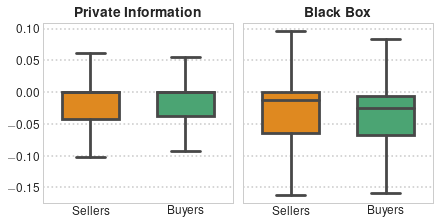

In [119]:
fig, ax = plt.subplots(1,2, figsize=(6,3), sharex=True, sharey=True,
                       constrained_layout=True)

for idx in range(2):
    if idx == 0:
        title = 'Private Information'
        data = df[~df['treatment'].isin(BB_treatments)]
    else:
        title = 'Black Box'
        data = df[df['treatment'].isin(BB_treatments)]

    xorder = ['Seller', 'Buyer']
    _ = sns.boxplot(x='side', y='adjWithin', data=data, ax=ax[idx], showfliers=False, 
                    palette=[side_colours[side] for side in xorder], order=xorder, width=0.6)
    
    _ = ax[idx].set_xticklabels(['{}s'.format(x.get_text()) for x in ax[idx].get_xticklabels()])
    _ = ax[idx].set_xlabel('')
    _ = ax[idx].set_ylabel('')
    _ = ax[idx].set_title(bold_text(title))

Comparison of market sides in Black Box versus Private Information treatments

In [120]:
df_within_BB_PI_pvals = df_within_BB_PI.loc[:, ['Median within-round bid/ask adjustment', 'MWW']].copy()
df_within_BB_PI_pvals.rename_axis(None, inplace=True)

for side, df_side in df.groupby(['side']):
    U, p = stats.mannwhitneyu(df_side[df_side['treatment'].isin(BB_treatments)]['adjWithin'].dropna(),
                              df_side[~df_side['treatment'].isin(BB_treatments)]['adjWithin'].dropna())
    df_within_BB_PI_pvals.loc['$p$-value', ('Median within-round bid/ask adjustment', '{}s'.format(side))] = p

df_within_BB_PI_pvals.round(2)
# print(df_within_BB_PI_pvals.round(2).to_latex())

Median within-round bid/ask adjustment               MWW  \
                                                     Buyers Sellers $p$-value   
Private Information                                    0.00    0.00       0.0   
Black Box                                             -0.03   -0.01       0.0   
$p$-value                                              0.00    0.00       NaN   

                               
                     P(X > Y)  
Private Information      0.48  
Black Box                0.47  
$p$-value                 NaN

### Bid/demand as a function of lagged bid/demand

In [121]:
df_lags = df.copy()

# Create a mask to filter Black Box treatments
df_lags['BB'] = df_lags['treatment'].isin(BB_treatments)

# Lagged bids and lagged relative demands
for var in ['bid', 'reldemand']:
    df_lags['{}-1'.format(var)] = df_lags.groupby(['treatment', 'game', 'round', 'id'])[var].shift()

# Create a mask to filter out outlier seller (lagged) bids
df_lags['truncate'] = ~(df_lags[['bid', 'bid-1']] > bid_q97).any(axis=1)

Correlation between bids/asks and previous bids/asks

Overall correlation between bids/asks and previous bids/asks

,Buyers,Sellers
Private Information,0.747285,0.10735
Black Box,0.870955,0.797211


Median per subject-round bid/ask autocorrelation

,Buyers,Sellers
Private Information,0.711715,0.632456
Black Box,0.960341,0.916311


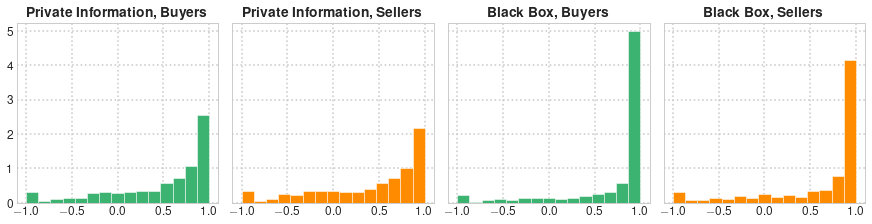

In [122]:
index = pd.Index(['Private Information', 'Black Box'])
columns = ['{}s'.format(side) for side in set(df_lags['side'])]
df_autocorr = pd.DataFrame(index=index, columns=columns)
df_subjAutocorr = pd.DataFrame(index=index, columns=columns)

fig, ax = plt.subplots(1,4, figsize=(12,3), sharex=True, sharey=True, constrained_layout=True)
idx = 0

all_autoCorrs = {}

for (BB_flag, side), df_side in df_lags.groupby(['BB', 'side']):
    treatments = 'Black Box' if BB_flag else 'Private Information'
    
    df_subjectRounds = df_side.groupby(['treatment','game','round','id'])
    # Only keep subject-rounds with more than two bids/asks submitted (for the correlation coefficient to be well-defined)
    df_subjectRounds = df_subjectRounds.filter(lambda g: len(g) > 2).groupby(['treatment','game','round','id'])
    
    autoCorrs = df_subjectRounds['bid'].apply(pd.Series.autocorr, lag=1)
    all_autoCorrs[treatments, side] = autoCorrs
    
    _ = ax[idx].hist(autoCorrs, bins=15, density=True, color=side_colours[side])
    _ = ax[idx].set_title(bold_text('{}, {}'.format(treatments, '{}s'.format(side))))

    df_autocorr.loc[treatments, '{}s'.format(side)] = df_side['bid'].corr(df_side['bid-1'])
    df_subjAutocorr.loc[treatments, '{}s'.format(side)] = autoCorrs.median()
    idx += 1
    
# _ = plt.suptitle('Per subject-round autocorrelation of bids/asks')

printmd('Overall correlation between bids/asks and previous bids/asks')
df_autocorr

printmd('Median per subject-round bid/ask autocorrelation')
df_subjAutocorr

_ = plt.savefig('Figures/Autocorr_bids.pdf', bbox_inches='tight', transparent=True)

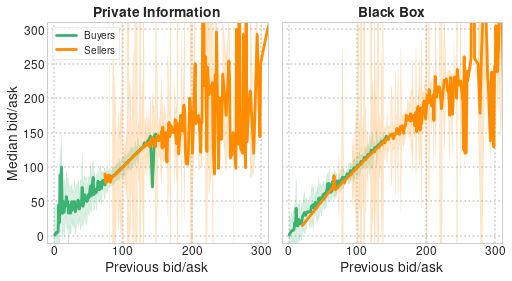

In [123]:
fig, ax = plt.subplots(1,2, figsize=(7,5), sharex=True, sharey=True, constrained_layout=True)
idx = 0

for (BB_flag, side), df_side in df_lags.groupby(['BB', 'side']):
    treatments = 'Black Box' if BB_flag else 'Private Information'
    
    _ = ax[idx//2].set_aspect('equal', adjustable='box')
#     _ = sns.lineplot(x='bid-1', y='bid', data=df_side[(df_side[['bid', 'bid-1']] <= bid_q97)],
    _ = sns.lineplot(x='bid-1', y='bid', data=df_side, estimator='median', ci='sd', ax=ax[idx//2], 
                     color=side_colours[side], label='{}s'.format(side), legend=False)
    _ = ax[idx//2].set_title(bold_text(treatments))

#     if side == 'Seller':
#         _ = ax[idx//2].set_xscale('log')
#         _ = ax[idx//2].set_yscale('log')
    
    _ = ax[idx//2].set_xlabel('Previous bid/ask')
    _ = ax[idx//2].set_ylabel('Median bid/ask')
    _ = ax[idx//2].set_aspect('equal', 'box')
    
    _ = ax[idx//2].set_xlim(-10,310)
    _ = ax[idx//2].set_ylim(-10,310)
    
    idx += 1

_ = ax[0].legend()
# _ = plt.suptitle('Median current bid as a function of previous bid', y=0.92)
_ = plt.savefig('Figures/Medians_bids.pdf', bbox_inches='tight', transparent=True)

**Quantile regression**

Median regression estimates the median of the dependent variable conditional on the values of the independent variable. 

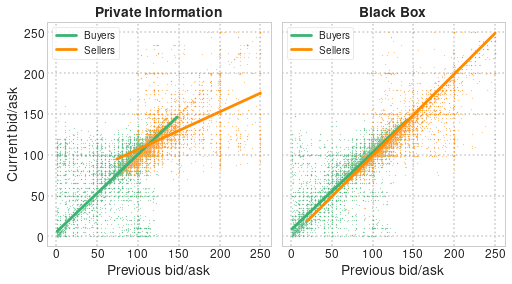

In [124]:
fig, axes = plt.subplots(1,2, figsize=(7,5), sharex=True, sharey=True, constrained_layout=True)

for (BB_flag, side), data in df_lags.rename({'bid-1': 'pbid'}, axis=1).groupby(['BB', 'side']):
    mod = smf.quantreg('bid ~ pbid', data=data)
    res = mod.fit(q=0.5, max_iter=2000)

    a = res.params['Intercept']
    b = res.params['pbid']
    
    ax = axes[int(BB_flag)]
    _ = ax.set_aspect('equal', adjustable='box')
    _ = ax.set_title(bold_text('{}'.format('Black Box' if BB_flag else 'Private Information')))
    _ = sns.scatterplot(x='pbid', y='bid', data=data[data[['bid', 'pbid']] <= bid_q97], ax=ax,
                        s=1.5, alpha=0.5, color=side_colours[side])
    
    xvals = np.arange(min(data[data['pbid'] <= 250]['pbid'].dropna()), max(data[data['pbid'] <= 250]['pbid'].dropna())+1)
    _ = ax.plot(xvals, [a + b*x for x in xvals], label='{}s'.format(side), color=side_colours[side])

    _ = ax.set_xlabel('Previous bid/ask')
    _ = ax.set_ylabel('Current bid/ask')
    
    _ = ax.legend()

[Scatter plots](https://seaborn.pydata.org/generated/seaborn.scatterplot.html) with [kernel density estimates](https://seaborn.pydata.org/generated/seaborn.kdeplot.html)

In [125]:
def scatter_lagged(var, scale, truncate=False, sharexy=False):
    def logTicks(x, pos):
        if x == 0: return '$0$'

        exponent = int(np.log10(abs(x)))
        coeff = x/(10**exponent)

        return r'${:2.1f} \times 10^{{ {:2d} }}$'.format(coeff,exponent)
    
    fig, axes = plt.subplots(2,2, figsize=(15,15), sharex=sharexy, sharey=sharexy,
                             constrained_layout=True)
    
    lagged_var = '{}-1'.format(var)
    
    if truncate:
        data = df_lags[df_lags['truncate']].dropna(subset=[lagged_var, var])
    else:
        data = df_lags.dropna(subset=[lagged_var, var])
            
    for (BB_mask, side), df_side in data.groupby(['BB', 'side']):
        i = int(BB_mask)
        j = int(0 if side == 'Buyer' else 1)     
        ax = axes[i][j]
        
        if scale == 'linear':
            x = lagged_var
            y = var
            log_scale = False
            _ = ax.set_xscale(scale)
            _ = ax.set_yscale(scale)
        elif scale == 'symlog':
            x = df_side[lagged_var].apply(symlog)
            y = df_side[var].apply(symlog)
            log_scale = False            
            _ = ax.set_xscale(scale, linthresh=3)
            _ = ax.set_yscale(scale, linthresh=3)
            _ = ax.xaxis.set_major_formatter(tick.FuncFormatter(logTicks))
            _ = ax.yaxis.set_major_formatter(tick.FuncFormatter(logTicks))
        elif scale == 'log':
            x = lagged_var
            y = var
            log_scale = True
            _ = ax.set_xscale(scale)
            _ = ax.set_yscale(scale)
        
        try:
            _ = sns.kdeplot(x=x, y=y, ax=ax, data=df_side, linewidths=2, log_scale=log_scale, levels=10, cmap=ListedColormap(gray_palette))
        except:
            pass
        
        _ = sns.scatterplot(x=x, y=y, ax=ax, data=df_side, alpha=0.3, hue='side', palette=side_colours, legend=False)
        
        axis_labels = {'bid': 'Bid/ask', 'bid-1': 'Previous bid/ask',
                       'reldemand': 'Relative demand', 'reldemand-1': 'Previous relative demand'}
        try:
            _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
            _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        except:
            pass
        
        _ = ax.set_title(bold_text('{}, {}s'.format('Black Box' if BB_mask else 'Private Information', side)))
        
    _ = plt.suptitle(r'\textbf{{{}s}}, {} scale (truncated data: {}, shared axes: {})'.format(axis_labels[var], scale, truncate, sharexy), y=1.02)

Comparison of different layouts

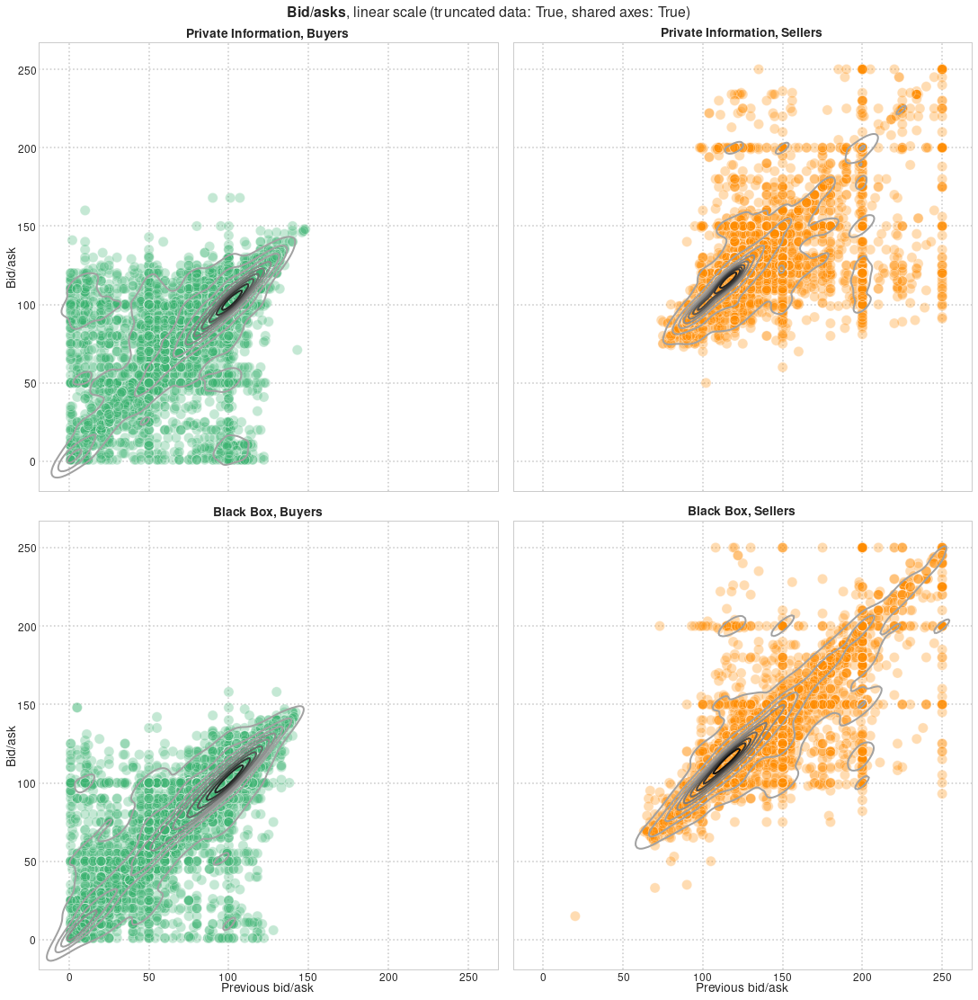

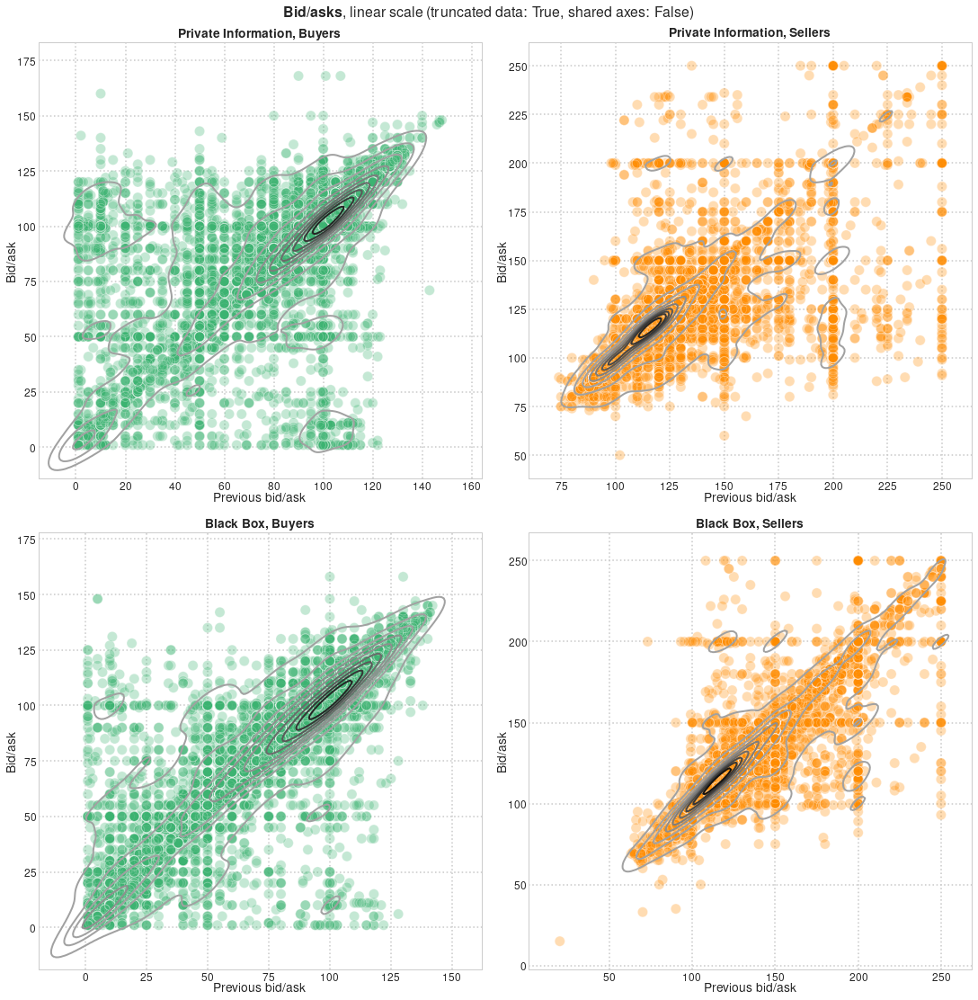

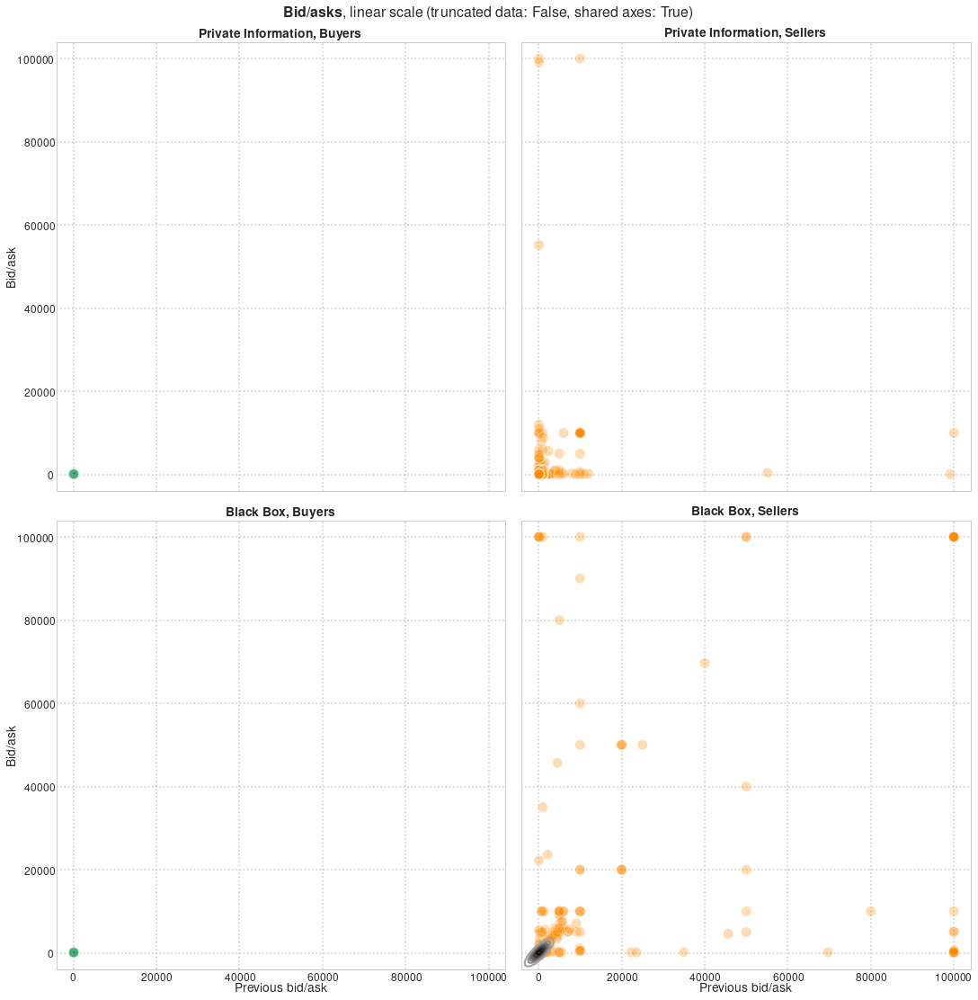

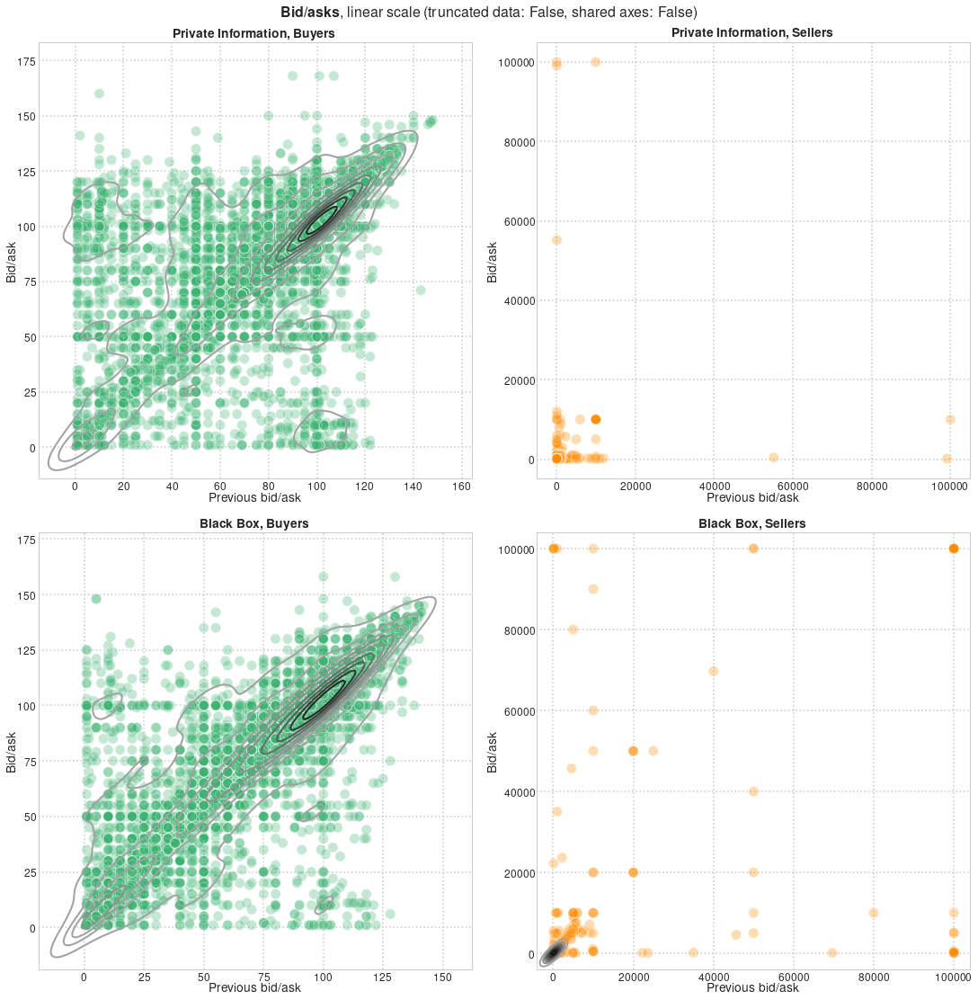

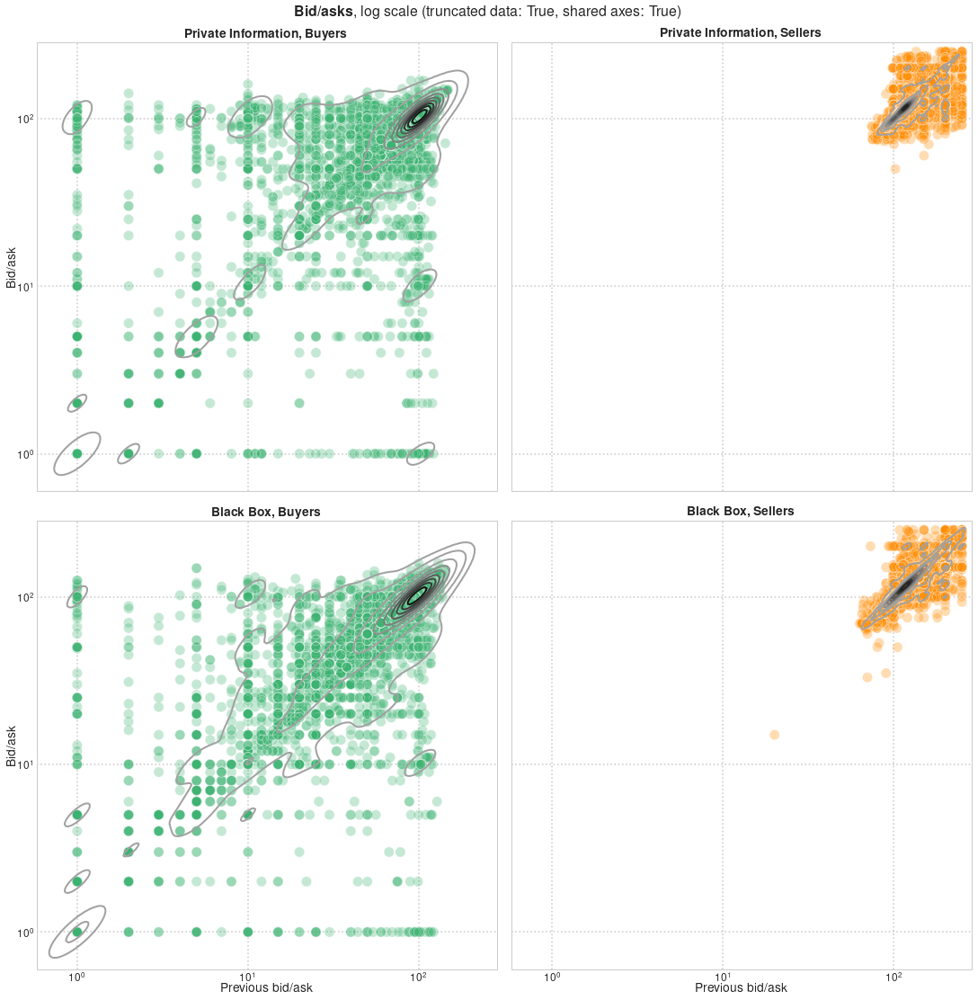

...

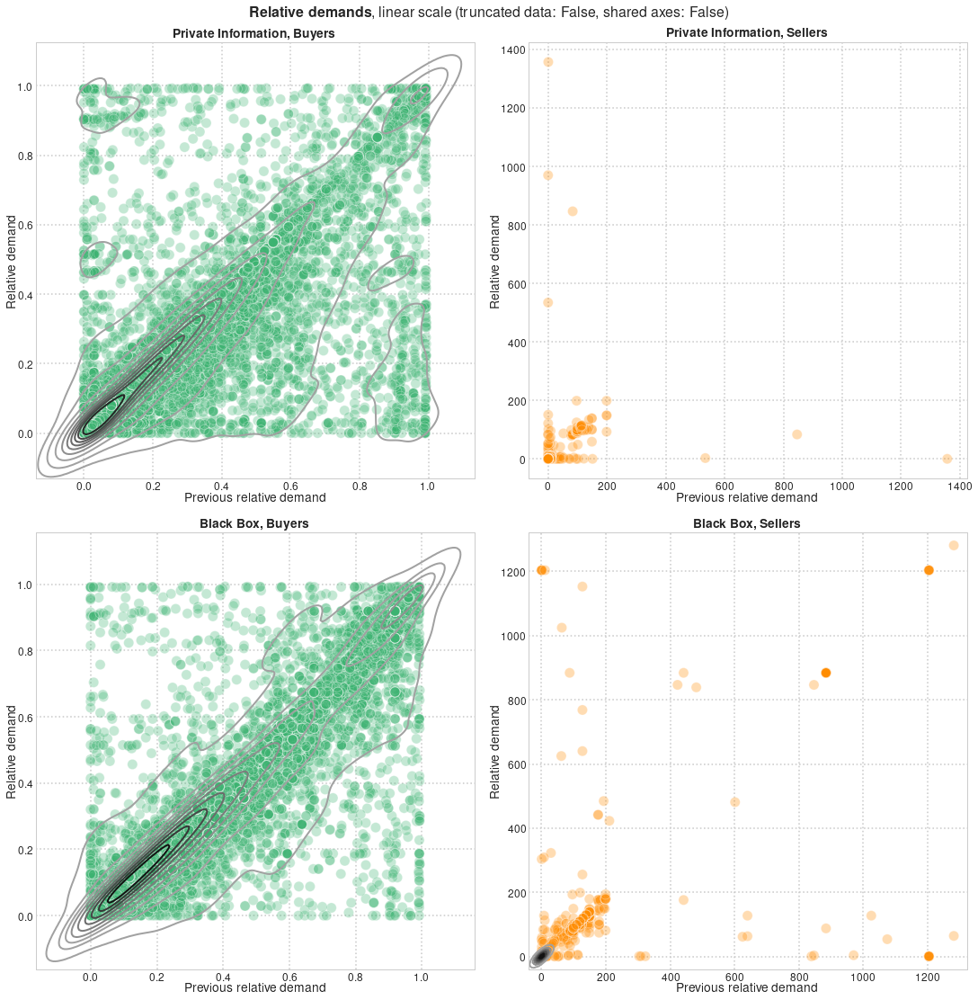

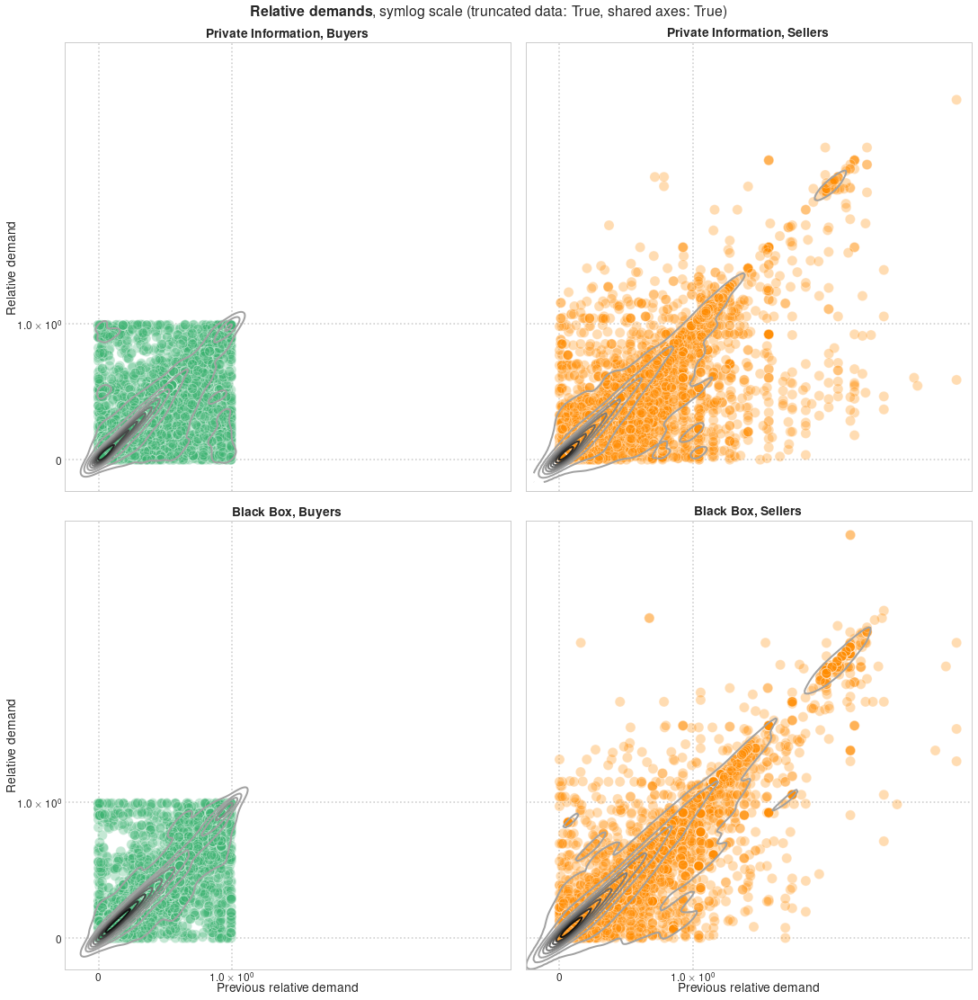

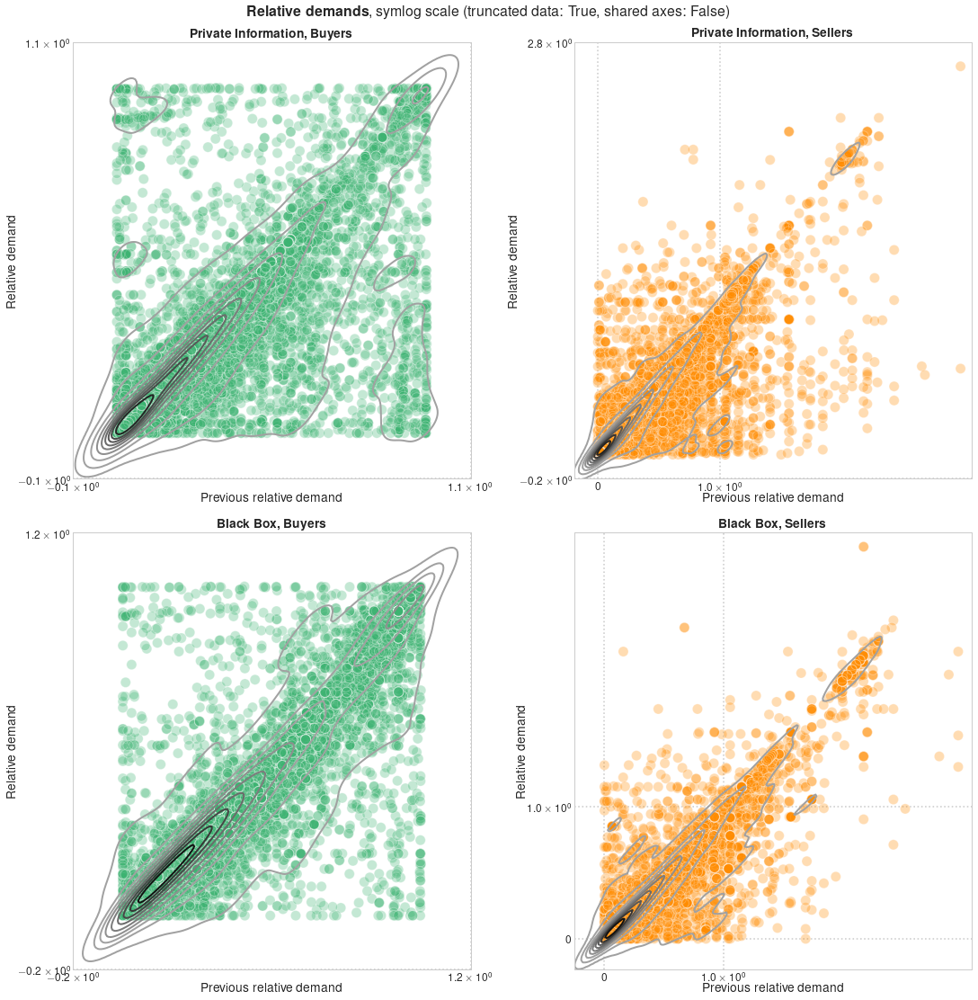

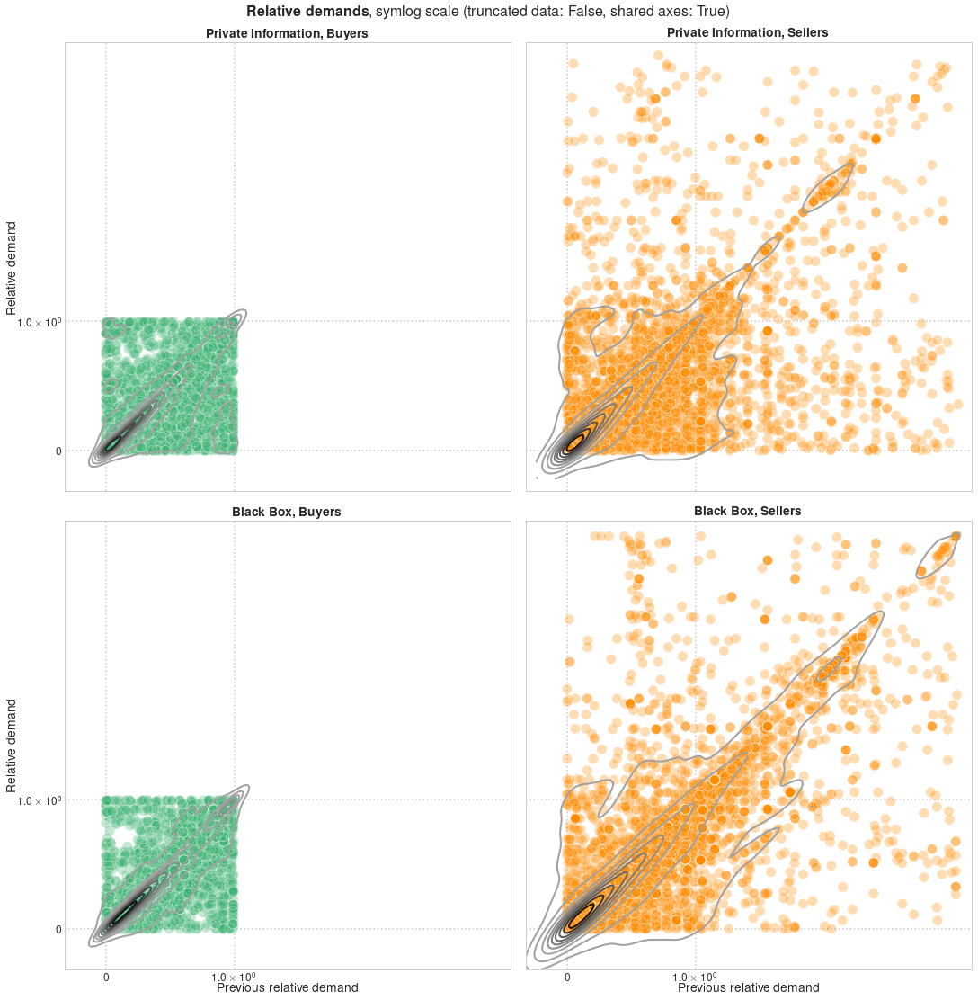

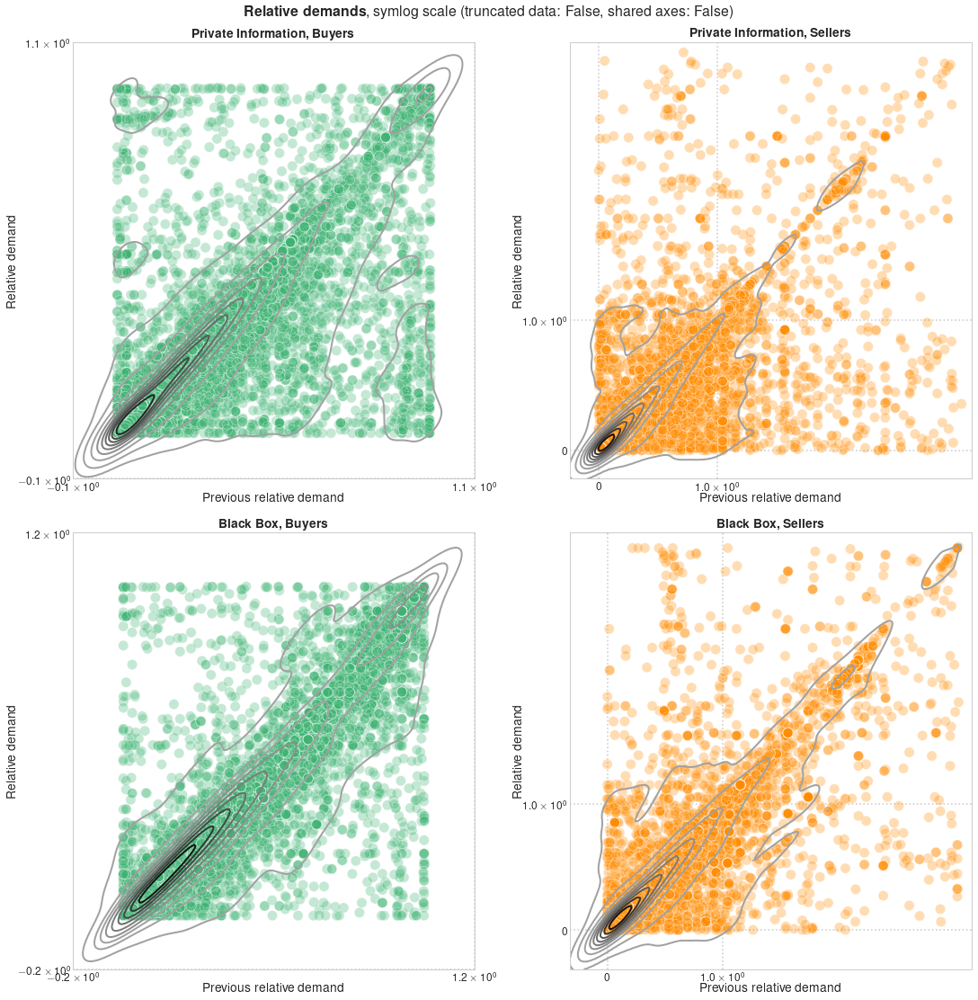

In [126]:
for var in ['bid', 'reldemand']:
    for scale in ['linear', 'log', 'symlog']:
        for truncate in [True, False]:
            for sharexy in [True, False]:
                # skip logarithmic scale for relative demands (since they mostly take values in [0,1])
                if (var == 'reldemand') & (scale == 'log'):
                    continue               
                scatter_lagged(var, scale, truncate, sharexy)
                #_ = plt.savefig('Figures/{}_{}_truncate_{}_sharexy_{}.pdf'.format(var.capitalize(), scale, truncate, sharexy), bbox_inches='tight', transparent=True)
                _ = plt.show()

Current bid as a response to previous bid (shared logarithmic scale, all data) – scatter plots, kernel density estimates, and robust regression as implemented by [```regplot```](https://seaborn.pydata.org/generated/seaborn.regplot.html) (confidence intervals are obtained using bootstrapping). Note that a manual implementation can be found further down below.

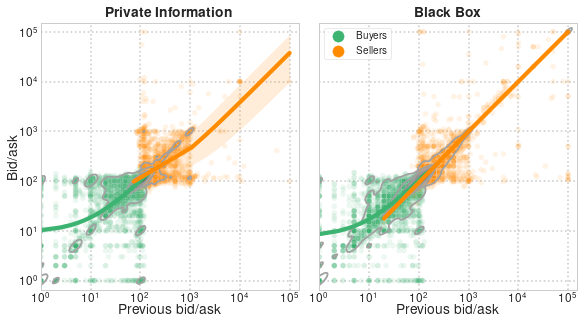

In [127]:
fig, axes = plt.subplots(1,2, figsize=(8,6), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_aspect('equal', adjustable='box')

    x = 'bid-1'
    y = 'bid'
    
    for side, df_side in data.groupby(['side']):  
        _ = sns.kdeplot(x=x, y=y, ax=ax, data=df_side, linewidths=1.8, log_scale=True, 
                        levels=8, cmap=ListedColormap(gray_palette))
        _ = sns.regplot(x=x, y=y, ax=ax, data=df_side, robust=True, scatter=False,
                        color=side_colours[side])
    
    splot = sns.scatterplot(x=x, y=y, ax=ax, data=data, alpha=0.1, s=30,
                            hue='side', hue_order=['Buyer', 'Seller'], palette=side_colours)
    _ = splot.set(xscale='log', yscale='log')

    axis_labels = {'bid': 'Bid/ask', 'bid-1': 'Previous bid/ask'}    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
    except:
        pass

    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'Private Information'))

_ = axes[0].legend_.remove()    
_ = axes[1].legend(title=None)

for label in axes[1].legend_.get_texts():
    label.set_text('{}s'.format(label.get_text()))

Current bid as a response to previous bid (shared logarithmic scale, all data) – kernel density estimates

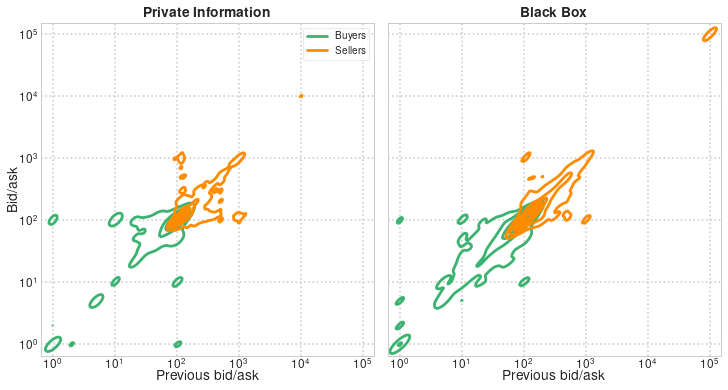

In [128]:
fig, axes = plt.subplots(1,2, figsize=(10,6), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_xscale('log')
    _ = ax.set_yscale('log')
    _ = ax.set_aspect('equal', adjustable='box')

    _ = sns.kdeplot(x='bid-1', y='bid', ax=ax, data=data, log_scale=True, levels=10,
                    hue='side', palette=side_colours, hue_order=['Buyer', 'Seller'])
    
    axis_labels = {'bid': 'Bid/ask', 'bid-1': 'Previous bid/ask'}    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
    except:
        pass

    legend = ax.get_legend()
    legend.set_title(None)

    for label in legend.get_texts():
        label.set_text('{}s'.format(label.get_text()))
        
    if i == 1:
        legend.set_visible(False)
    
    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'Private Information'))

# _ = plt.savefig('Figures/Bids_BB_PI_kde.pdf', bbox_inches='tight', transparent=True)

#### Robust linear regression

In [129]:
df[(df['side'] == 'Seller')]['bid'].quantile(0.95)

300.0

A [robust linear model](https://www.statsmodels.org/stable/generated/statsmodels.robust.robust_linear_model.RLM.html) is used to downweight outliers (sellers' bids at the extreme of the action space, i.e., $\sbid{j}{k} \gg 250$). It is estimated via iteratively reweighted least squares given a robust criterion estimator ([Huber M-estimator](https://www.statsmodels.org/stable/generated/statsmodels.robust.norms.HuberT.html?highlight=hubert)).

Notes:
- In order to estimate $R^2$, [weighted least squares regression](https://www.statsmodels.org/stable/generated/statsmodels.regression.linear_model.WLS.html) is run with weights from the fitted RLM to get a sense of the proportion of _weighted_ variation explained by the model (see [discussion](https://stackoverflow.com/questions/31655196/how-to-get-r-squared-for-robust-regression-rlm-in-statsmodels)).
- Confidence and prediction intervals are extracted by means of [``summary_table``](https://www.statsmodels.org/stable/generated/statsmodels.stats.outliers_influence.OLSInfluence.summary_table.html) and [``wls_prediction_std``](https://tedboy.github.io/statsmodels_doc/generated/statsmodels.sandbox.regression.predstd.wls_prediction_std.html) implemented in ``statsmodels``; probability plots are generated using ``scipy``'s [``probplot``](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.probplot.html) (whereby a _prediction interval_ predicts the range an individual observation is expected to be sampled from and a _confidence interval_ corresponds to the likely range of values to contain the true mean of the population).

In [130]:
def bid_regression(data, scale, out=False):
    data = data.copy().dropna(subset=['bid-1'])
    x = data['bid-1'].values
    y = data['bid'].values
    X = sm.add_constant(x)
    model_RLM = sm.RLM(y, X)
    results_RLM = model_RLM.fit()
    yhat = results_RLM.fittedvalues
    resid = y - yhat

    model_WLS = sm.WLS(model_RLM.endog, model_RLM.exog, weights=model_RLM.weights)
    results_WLS = model_WLS.fit(cov_type='cluster', cov_kwds={'groups': data['id']})
    
    if out: # print out statistics
        printmd('**Robust linear model**')
        print(results_RLM.summary())

        printmd('**Weighted least squares**')
        print(results_WLS.summary())
    
    if scale == 'linear':
        xrange = np.linspace(x.min(), x.max())
    elif scale == 'log':
        xrange = np.geomspace(x.min(), x.max())
    Xrange = sm.add_constant(xrange)
    
    prstd, interval_l, interval_u = wls_prediction_std(results_WLS, exog=Xrange, alpha=0.05)
    _, summaryTable, _ = summary_table(results_WLS, alpha=0.05)
    mean_ci_low, mean_ci_upp = summaryTable[:,4:6].T
    predict_ci_low, predict_ci_upp = summaryTable[:,6:8].T

    # Organise results
    # Information about fitted values, residuals, and confidence intervals
    confInt = pd.DataFrame({'x': x, 'fitted': yhat, 'resid': resid, 'ci_low': mean_ci_low, 'ci_upp': mean_ci_upp})
    confInt = confInt.sort_values('x')
    # Information about prediction intervals
    predInt = pd.DataFrame({'x': xrange, 'predict_ci_low': interval_l, 'predict_ci_upp': interval_u})
    predInt = predInt.sort_values('x')
    
    return confInt, predInt

def regression_plot(ax, colour, confInt, predInt):
    # Fitted values
    _ = ax.plot(confInt['x'], confInt['fitted'], c=colour, label='Robust linear model', linewidth=2)

    # Confidence intervals
    _ = ax.fill_between(confInt['x'], confInt['ci_low'], confInt['ci_upp'], 
                        color=colour, alpha=0.4, label=r'95\% confidence interval')

    # Prediction intervals 
    # Note: negative lower bounds are clipped to 1 to prevent distortions in the logrithmic scale
    _ = ax.fill_between(predInt['x'], predInt['predict_ci_low'].clip(lower=1), predInt['predict_ci_upp'], 
                        color=colour, alpha=0.1, label=r'95\% prediction interval')
    
def residual_plot(x, resid):
    """Residual plot and probability plot of residuals for a normal distribution."""
    fig, ax = plt.subplots(1, 3, figsize=(16, 4))
    
    for idx in range(2):
        _ = sns.scatterplot(x=x, y=resid, s=10, alpha=0.3, color='red', ax=ax[idx])
        _ = ax[idx].plot([0, max(x)], [0, 0], linestyle='dashed', color='black', linewidth=2)
        _ = ax[idx].set_xlabel('Independent variable')
        _ = ax[idx].set_ylabel('Residuals', labelpad=-0.5)
        
        if idx == 0:
            _ = ax[idx].set_title('Linear scale')
        else:
            _ = ax[idx].set_xscale('log')
            _ = ax[idx].set_title('Logarithmic scale')
            
        _ = ax[idx].ticklabel_format(axis='y', style='sci', scilimits=(0,3))
 
    # Probability plot
    _ = stats.probplot(resid, dist='norm', plot=ax[2])
    _ = ax[2].set_xlabel('Quantiles')
    _ = ax[2].set_ylabel('Ordered values', labelpad=-0.5)
    _ = ax[2].ticklabel_format(axis="y", style='sci', scilimits=(0,3))
    _ = ax[2].set_title(r'Probability plot (against normal)')
    _ = ax[2].get_lines()[0].set_markersize(3)
    _ = ax[2].get_lines()[0].set_color('royalblue')    
    _ = ax[2].get_lines()[1].set_linewidth(2)

c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)


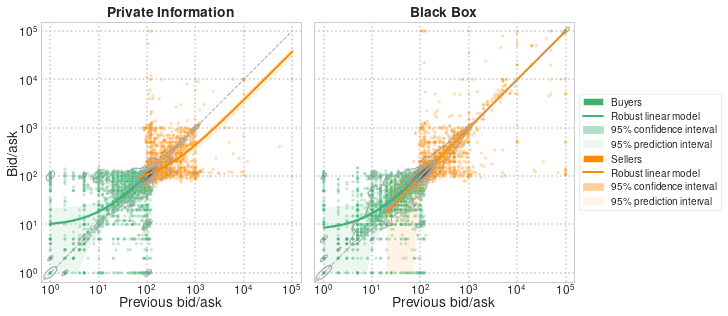

In [131]:
fig, axes = plt.subplots(1,2, figsize=(10,8), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_aspect('equal', adjustable='box')    

    for side, df_side in data.groupby(['side']):
        # Scatter plot, kernel density estimate, and robust linear model
        splot = sns.scatterplot(x='bid-1', y='bid', ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, zorder=1)
        _ = splot.set(xscale='log', yscale='log')

        _ = sns.kdeplot(x='bid-1', y='bid', ax=ax, data=df_side, linewidths=1, log_scale=True,
                        levels=8, cmap=ListedColormap(gray_palette), zorder=2)
    
        confInt, predInt = bid_regression(data=df_side, scale='log', out=False)
        regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)

    # 45-degree line
    _ = ax.plot(range(max(data['bid'])+1), range(max(data['bid'])+1), linestyle='dashed',
                color='darkgray', linewidth=1, zorder=2)
        
    # Axis layout
    axis_labels = {'bid': 'Bid/ask', 'bid-1': 'Previous bid/ask'}
    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        
    except:
        pass
    
    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'Private Information'))

# Legend
handles, labels = axes[1].get_legend_handles_labels()
for idx in range(len(handles)):
    if labels[idx] in ['Buyer', 'Seller']:
        handles[idx] = Patch(facecolor=side_colours[labels[idx]])
        labels[idx] = '{}s'.format(labels[idx])

order = [2,0,3,4,5,1,6,7]
handles = [handles[idx] for idx in order]
labels = [labels[idx] for idx in order]
_ = axes[0].legend_.remove()    
_ = axes[1].legend(handles, labels, title=None, loc='center left', bbox_to_anchor=(1, 0.5))

**Private Information, Buyers**

**Robust linear model**

                    Robust linear Model Regression Results                    
Dep. Variable:                      y   No. Observations:                19098
Model:                            RLM   Df Residuals:                    19096
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Fri, 29 Jan 2021                                         
Time:                        11:52:24                                         
No. Iterations:                    50                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.3863      0.109     85.843      0.0

**Weighted least squares**

                            WLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.907
Model:                            WLS   Adj. R-squared:                  0.907
Method:                 Least Squares   F-statistic:                 1.014e+04
Date:                Fri, 29 Jan 2021   Prob (F-statistic):               0.00
Time:                        11:52:24   Log-Likelihood:                -64487.
No. Observations:               19098   AIC:                         1.290e+05
Df Residuals:                   19096   BIC:                         1.290e+05
Df Model:                           1                                         
Covariance Type:              cluster                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.3863      0.923     10.172      0.0

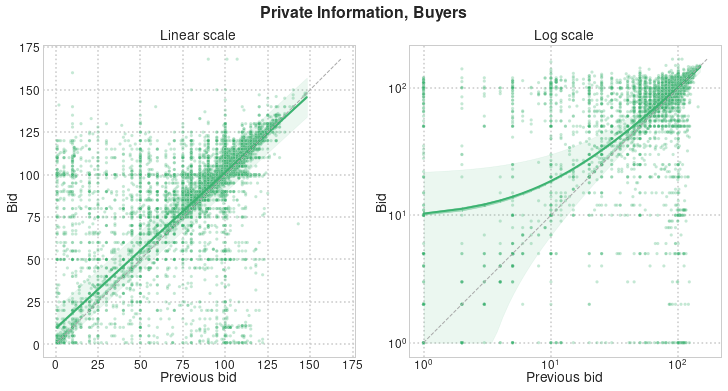

**Private Information, Sellers**

**Robust linear model**

                    Robust linear Model Regression Results                    
Dep. Variable:                      y   No. Observations:                20326
Model:                            RLM   Df Residuals:                    20324
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Fri, 29 Jan 2021                                         
Time:                        11:52:30                                         
No. Iterations:                    50                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         70.1202      0.077    906.882      0.0

**Weighted least squares**

                            WLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.285
Model:                            WLS   Adj. R-squared:                  0.285
Method:                 Least Squares   F-statistic:                     77.06
Date:                Fri, 29 Jan 2021   Prob (F-statistic):           2.61e-17
Time:                        11:52:30   Log-Likelihood:                -98693.
No. Observations:               20326   AIC:                         1.974e+05
Df Residuals:                   20324   BIC:                         1.974e+05
Df Model:                           1                                         
Covariance Type:              cluster                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         70.1202      5.103     13.742      0.0

c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)


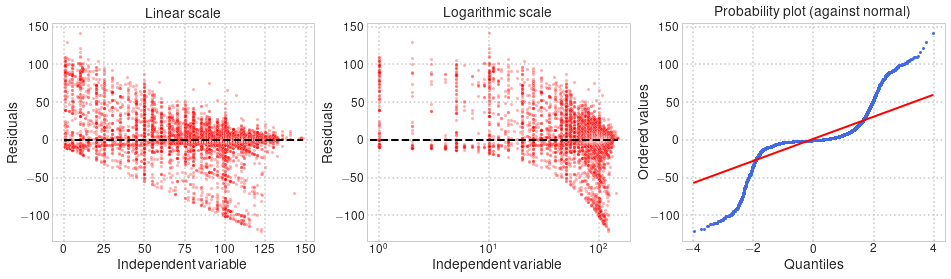

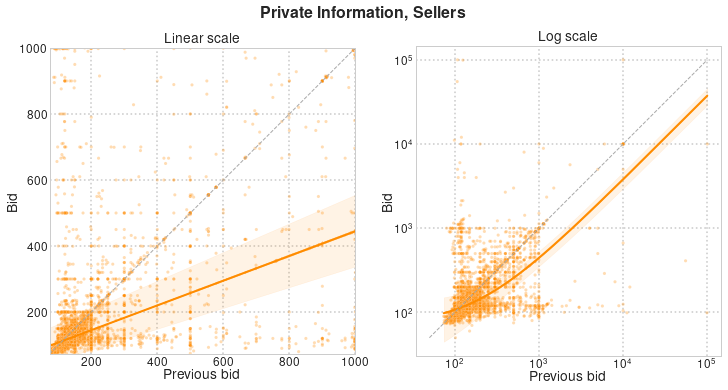

**Black Box, Buyers**

**Robust linear model**

                    Robust linear Model Regression Results                    
Dep. Variable:                      y   No. Observations:                14024
Model:                            RLM   Df Residuals:                    14022
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Fri, 29 Jan 2021                                         
Time:                        11:52:38                                         
No. Iterations:                    24                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.6287      0.136     56.041      0.0

**Weighted least squares**

                            WLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.941
Model:                            WLS   Adj. R-squared:                  0.941
Method:                 Least Squares   F-statistic:                 2.691e+04
Date:                Fri, 29 Jan 2021   Prob (F-statistic):               0.00
Time:                        11:52:38   Log-Likelihood:                -48979.
No. Observations:               14024   AIC:                         9.796e+04
Df Residuals:                   14022   BIC:                         9.798e+04
Df Model:                           1                                         
Covariance Type:              cluster                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.6287      0.552     13.814      0.0

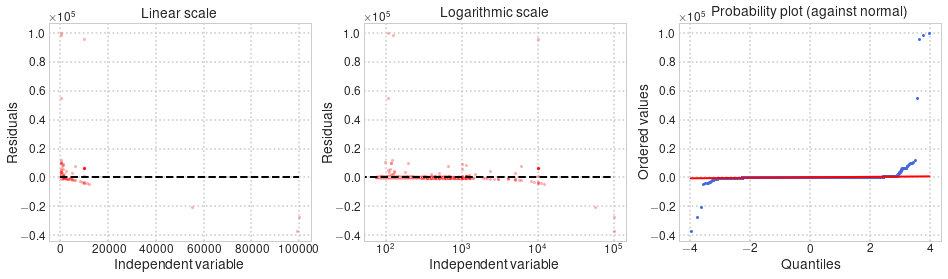

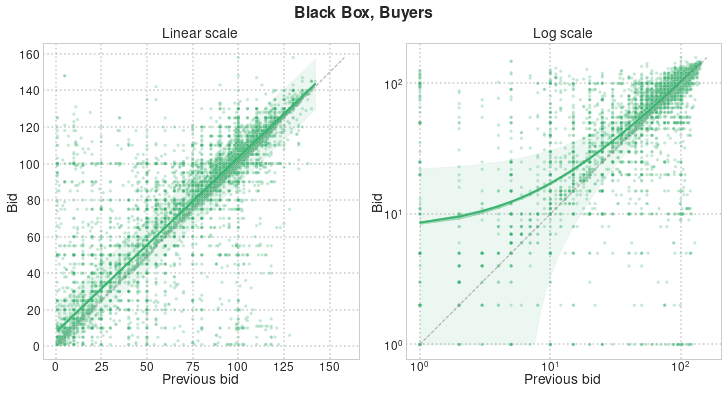

**Black Box, Sellers**

**Robust linear model**

                    Robust linear Model Regression Results                    
Dep. Variable:                      y   No. Observations:                13947
Model:                            RLM   Df Residuals:                    13945
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Fri, 29 Jan 2021                                         
Time:                        11:52:45                                         
No. Iterations:                    42                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.3123      0.041    -56.780      0.0

**Weighted least squares**

                            WLS Regression Results                            
Dep. Variable:                      y   R-squared:                       1.000
Model:                            WLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.750e+09
Date:                Fri, 29 Jan 2021   Prob (F-statistic):               0.00
Time:                        11:52:45   Log-Likelihood:                -73052.
No. Observations:               13947   AIC:                         1.461e+05
Df Residuals:                   13945   BIC:                         1.461e+05
Df Model:                           1                                         
Covariance Type:              cluster                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.3123      0.142    -16.276      0.0

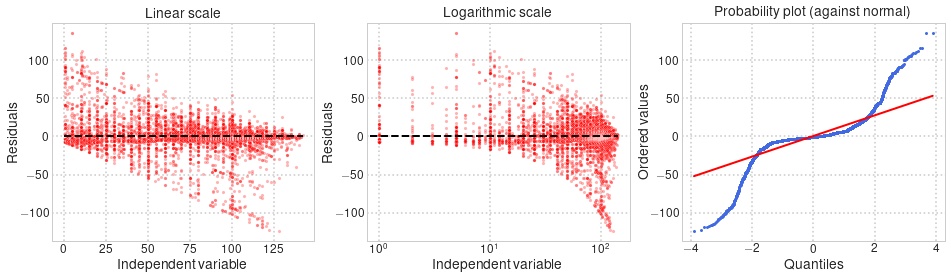

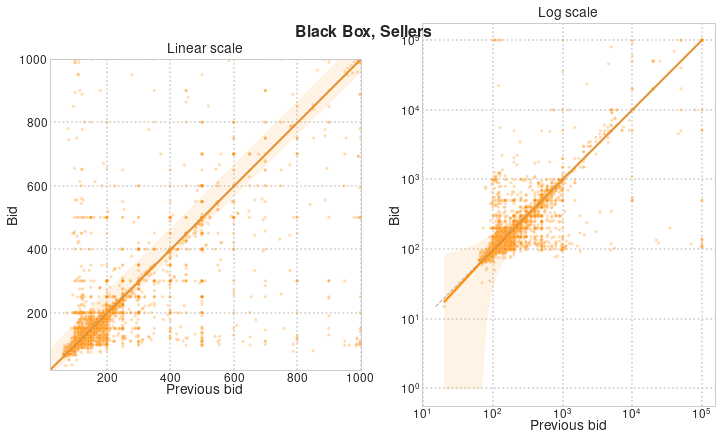

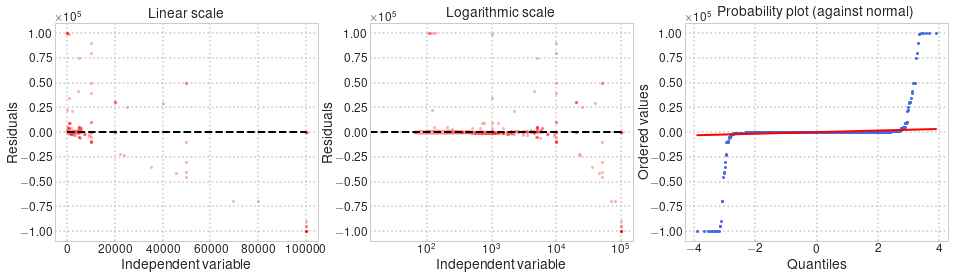

In [132]:
for (BB_mask, side), df_side in df_lags.dropna(subset=['bid-1']).groupby(['BB', 'side']):
    fig, axes = plt.subplots(1, 2, figsize=(10, 6), constrained_layout=True)
    
    suptitle = '{}, {}s'.format('Black Box' if BB_mask else 'Private Information', side)
    printmd('**{}**'.format(suptitle))

    bid_range = range(min(df_side['bid']), max(df_side['bid'])+1)
    
    for idx, scale in enumerate(['linear', 'log']):
        ax = axes[idx]            

        confInt, predInt = bid_regression(data=df_side, scale=scale, out=(idx == 0))
        
        # Scatter plot, robust linear model, 45-degree line
        splot = sns.scatterplot(x='bid-1', y='bid', ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, legend=False)
        regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)
        _ = ax.plot(bid_range, bid_range, linestyle='dashed', color='darkgray', linewidth=1, zorder=2)
        
        # Axis layout
        _ = ax.set_title('{} scale'.format(scale.capitalize()))

        axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid'}    
        
        try:
            _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
            _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
            
        except:
            pass

        _ = ax.set_aspect('equal', adjustable='box')
        _ = splot.set(xscale=scale, yscale=scale)
        
        if (scale != 'log') and max(df_side['bid']) > bid_q97:
            _ = ax.set_xlim(min(df_side['bid-1']), 1000)
            _ = ax.set_ylim(min(df_side['bid-1']), 1000)

    _ = plt.suptitle(bold_text(suptitle), y=0.95)
    _ = plt.show()
    
    # Residual plot
    residual_plot(confInt['x'], confInt['resid'])

In [133]:
index = pd.MultiIndex.from_product([['Private Information', 'Black Box'], ['Buyers', 'Sellers']])
columns = ['Intrercept', 'Slope', 'Observations', r'$R^2$', r'Adjusted $R^2$']

robust_linReg = pd.DataFrame(index=index, columns=columns, dtype=float)

for (BB_mask, side), data in df_lags.dropna(subset=['bid-1']).groupby(['BB', 'side']):
    data = data.copy().dropna(subset=['bid-1'])
    x = data['bid-1'].values
    y = data['bid'].values
    X = sm.add_constant(x)
    model_RLM = sm.RLM(y, X)
    results_RLM = model_RLM.fit()

    model_WLS = sm.WLS(model_RLM.endog, model_RLM.exog, weights=model_RLM.weights)
    results_WLS = model_WLS.fit(cov_type='cluster', cov_kwds={'groups': data['id']})

    intercept = round(results_RLM.params[0], 2)
    slope = round(results_RLM.params[1], 2)
    
    if results_RLM.pvalues[0] < 0.01:
        intercept = '{}***'.format(intercept)
    if results_RLM.pvalues[1] < 0.01:
        slope = '{}***'.format(slope)
    
    results = ['{} {}'.format(intercept, tuple(round(x, 2) for x in results_RLM.conf_int()[0])),
               '{} {}'.format(slope, tuple(round(x, 2) for x in results_RLM.conf_int()[1])),
               len(data), results_WLS.rsquared, results_WLS.rsquared_adj]
    robust_linReg.loc[('Black Box' if BB_mask else 'Private Information', '{}s'.format(side))] = results

robust_linReg['Observations'] = robust_linReg['Observations'].astype(int)
robust_linReg.round(2)

Intrercept                 Slope  \
Private Information Buyers       9.39*** (9.17, 9.6)  0.92*** (0.92, 0.92)   
                    Sellers  70.12*** (69.97, 70.27)  0.37*** (0.37, 0.37)   
Black Box           Buyers       7.63*** (7.36, 7.9)  0.96*** (0.95, 0.96)   
                    Sellers  -2.31*** (-2.39, -2.23)     1.0*** (1.0, 1.0)   

                             Observations  $R^2$  Adjusted $R^2$  
Private Information Buyers          19098   0.91            0.91  
                    Sellers         20326   0.29            0.29  
Black Box           Buyers          14024   0.94            0.94  
                    Sellers         13947   1.00            1.00

In [134]:
print(robust_linReg.drop(['Observations', r'$R^2$', r'Adjusted $R^2$'], axis=1).unstack(level=1).swaplevel(axis=1).sort_index(level=0, axis=1).to_latex())

\begin{tabular}{lllll}
\toprule
{} & \multicolumn{2}{l}{Buyers} & \multicolumn{2}{l}{Sellers} \\
{} &           Intrercept &                 Slope &               Intrercept &                 Slope \\
\midrule
Black Box           &  7.63*** (7.36, 7.9) &  0.96*** (0.95, 0.96) &  -2.31*** (-2.39, -2.23) &     1.0*** (1.0, 1.0) \\
Private Information &  9.39*** (9.17, 9.6) &  0.92*** (0.92, 0.92) &  70.12*** (69.97, 70.27) &  0.37*** (0.37, 0.37) \\
\bottomrule
\end{tabular}



#### Non-linear \& non-parametric regression

Implemented below:
- **LOWESS** (```statsmodels``` locally weighted scatter plot smoother). The algorithm generates a non-parametric smoother using local linear estimates. For every $1 \leq i \leq N$, the smooth $y_i$ is estimated by taking the $r$ closest points to $(x_i,y_i)$ based on their $x_i$ values and applying a weighted linear regression, where $r = fN$ for $f \in (0, 1]$ ($f = 0.2$ in the implementation below). More details: [documentation](https://www.statsmodels.org/stable/generated/statsmodels.nonparametric.smoothers_lowess.lowess.html), [algorithm](https://www.tandfonline.com/doi/abs/10.1080/01621459.1979.10481038).
- **Rational model (n, m)**: $q(x; (a_i)_{i = 0}^n, (b_i)_{i = 0}^m) = \frac{a_0 + a_1 x + \cdots + a_n x^n}{1 + b_1 x + \cdots + b_m x^m}$ fitted with robust non-linear regression in ```SciPy``` (using Huber loss and scale $C = 1$). More details: [documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html), [tutorial](https://scipy-cookbook.readthedocs.io/items/robust_regression.html).

Also tried out (unsuitable due to high sensitivity to outliers):
- ```PyQt-Fit``` kernel methods using a Gaussian kernel (Nadaraya-Watson regression (spatial averaging), local-polynomial regressions: [documentation](https://pythonhosted.org/PyQt-Fit/mod_npr_methods.html), [tutorial](https://pyqt-fit.readthedocs.io/en/latest/NonParam_tut.html).
- ```scikit-learn``` epsilon-support vector regressions using non-linear/linear kernels: [documentation](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVR.html), [tutorial](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVR.html#sklearn.svm.SVR).

In [135]:
def poly_eval(coeff, x):
    return sum([coeff[i]*x**i for i in range(len(coeff))])

def poly_residuals(coeff, x, y):
    return y - poly_eval(coeff, x)

def rational_eval(coeff, n, m, x):
    a_coeff = coeff[0:n+1]
    b_coeff = coeff[n+1:n+1+m]
    b_coeff = np.insert(b_coeff, 0, 1)

    return poly_eval(a_coeff, x)/poly_eval(b_coeff, x)

def rational_residuals(coeff, n, m, x, y):        
    return y - rational_eval(coeff, n, m, x)

def nonparam_regression(data):
    x = data['bid-1']
    y = data['bid']
    fitted_vals = pd.DataFrame({'x': x, 'y': y})
    models = dict()
    colours = dict()
    
    # LOWESS
    fitted_vals['LOWESS'] = sm.nonparametric.lowess(y, x, return_sorted=False, frac=0.2)
    colours['LOWESS'] = 'blue'
    
    # Rational model
    # Given as a tuple (x0, n, m), where x0 provides the initial estimates of the coefficients,
    # n equals the degree in the numerator, and m equals the degree in the denominator.
    rationalModels = [([1,1,0,0], 1, 2), ([1,1,1,1,1], 2, 2)]
    colours['Rational model (1, 2)'] = 'purple'
    colours['Rational model (2, 2)'] = 'violet'   
    
    for (x0, n, m) in rationalModels:
        model_name = 'Rational model ({}, {})'.format(n, m)
        
        rm = least_squares(rational_residuals, x0=x0, loss='huber',
                           f_scale=1, args=(n, m, x, y), jac='cs')
        coeff = rm.x
        model = lambda x, coeff=coeff, n=n, m=m: rational_eval(coeff, n, m, x)
        fitted_vals[model_name] = model(x)
        models[model_name] = model

    # Quadratic polynomial
    # Alternative implementation: least_squares applied to poly_residuals
    X = np.column_stack((x, x**2))
    X = sm.add_constant(X)
    
    model_RLM = sm.RLM(y, X)
    results_RLM = model_RLM.fit()
    fitted_vals['Quadratic polynomial'] = results_RLM.fittedvalues
    models['Quadratic polynomial'] = results_RLM
    colours['Quadratic polynomial'] = 'red'
      
    fitted_vals.sort_values(by='x', inplace=True)

    return fitted_vals, models, colours

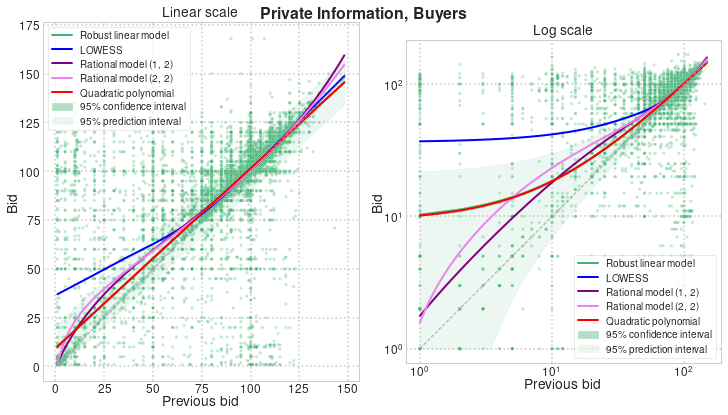

,R2 = 1 - SS_resid/SS_total
RLM,0.506853
LOWESS,0.561323
"Rational model (1, 2)",0.508748
"Rational model (2, 2)",0.522056
Quadratic polynomial,0.506345


c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)


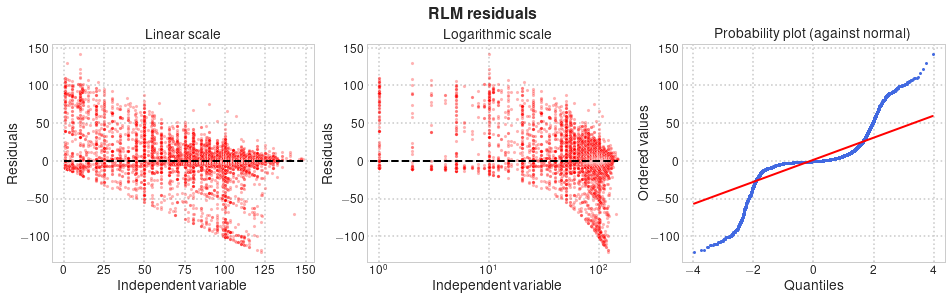

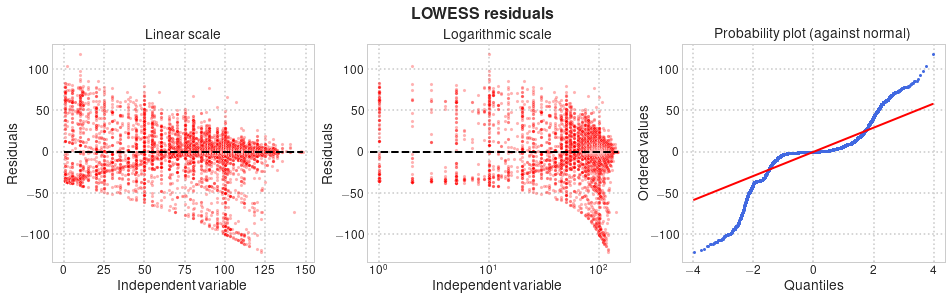

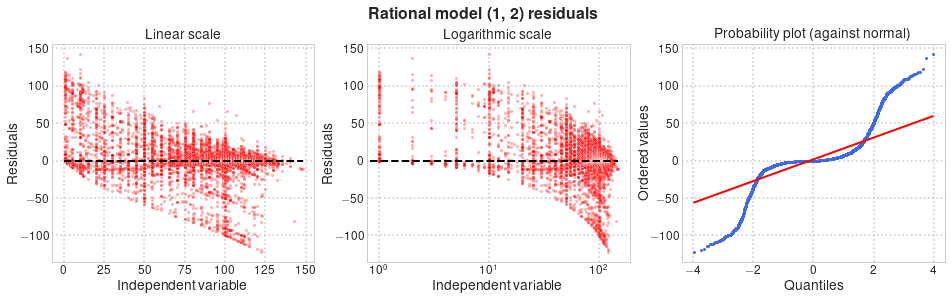

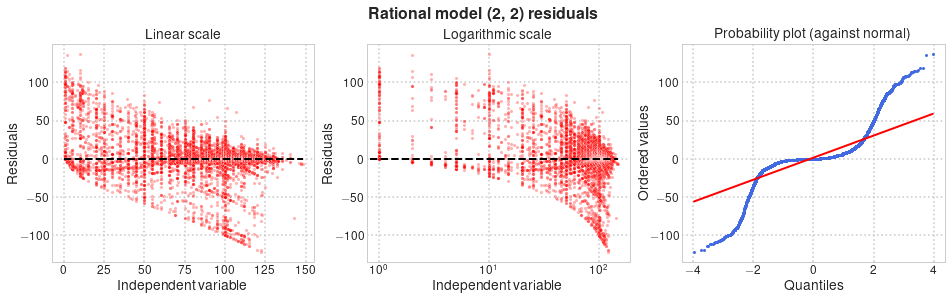

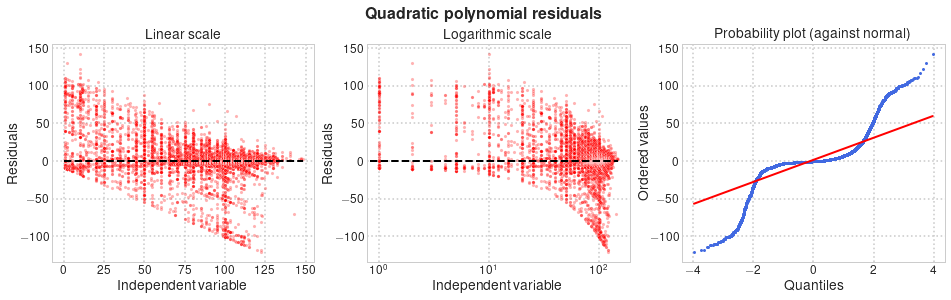

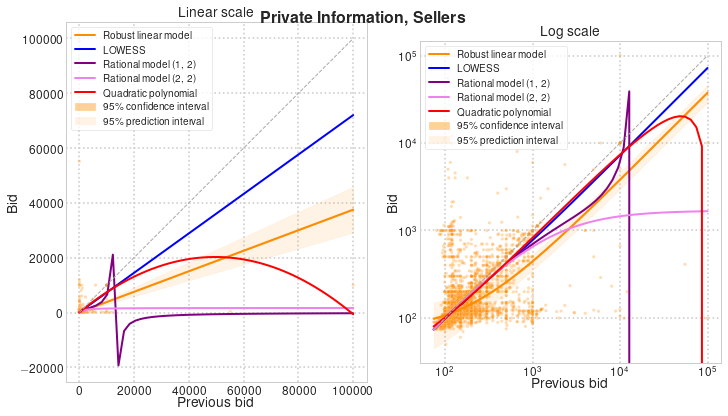

,R2 = 1 - SS_resid/SS_total
RLM,-0.032945
LOWESS,-0.239795
"Rational model (1, 2)",0.044766
"Rational model (2, 2)",0.018314
Quadratic polynomial,0.044534


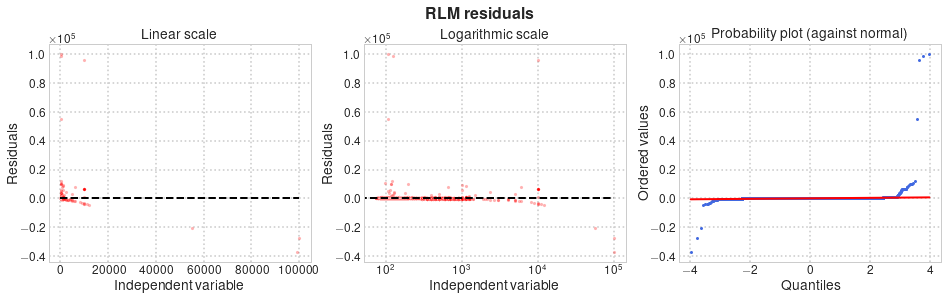

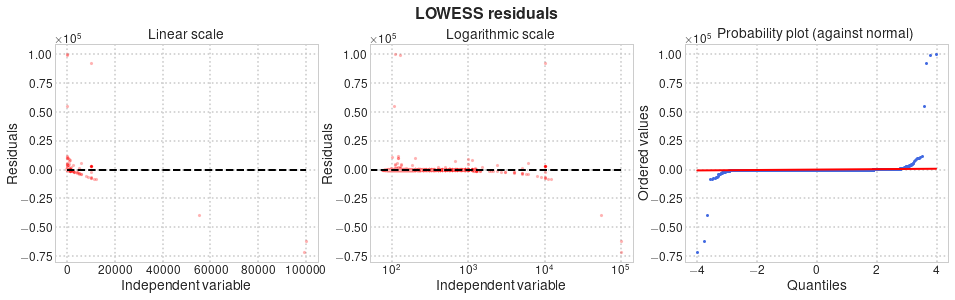

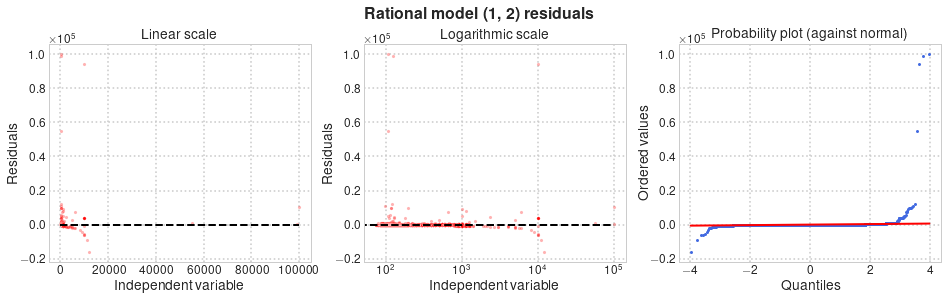

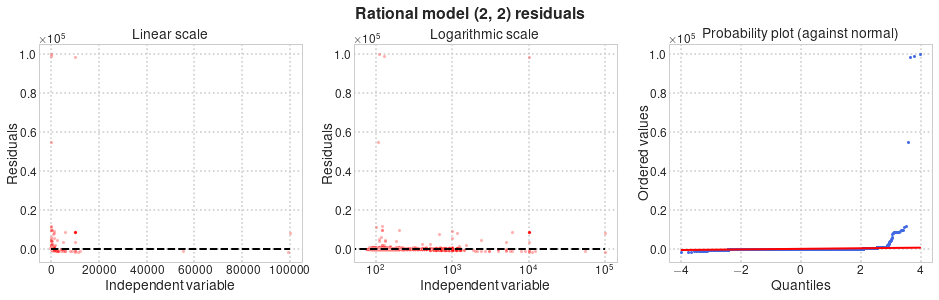

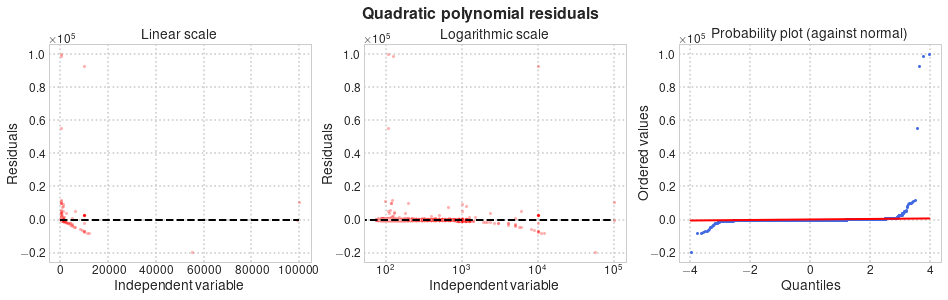

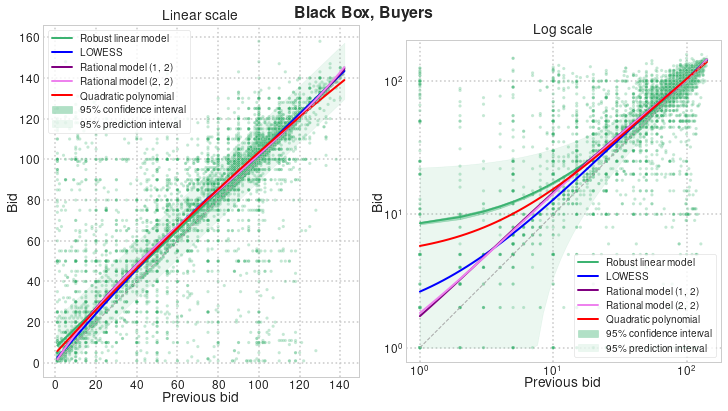

,R2 = 1 - SS_resid/SS_total
RLM,0.749032
LOWESS,0.742197
"Rational model (1, 2)",0.746422
"Rational model (2, 2)",0.746063
Quadratic polynomial,0.747748


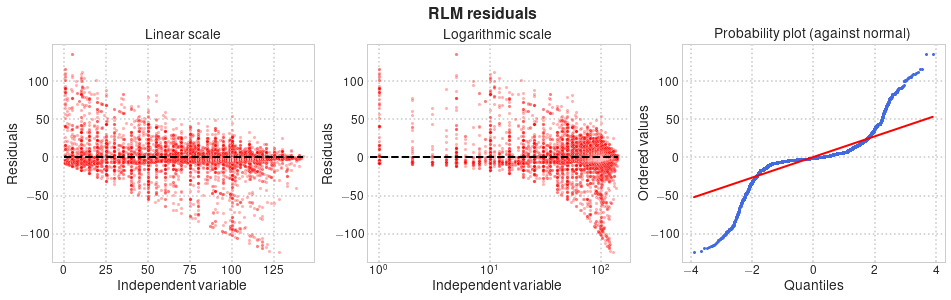

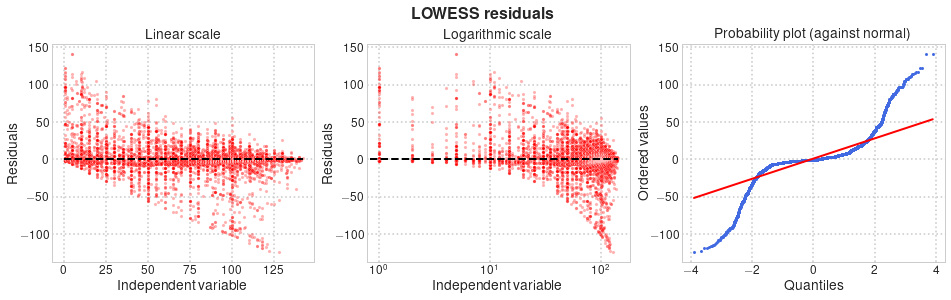

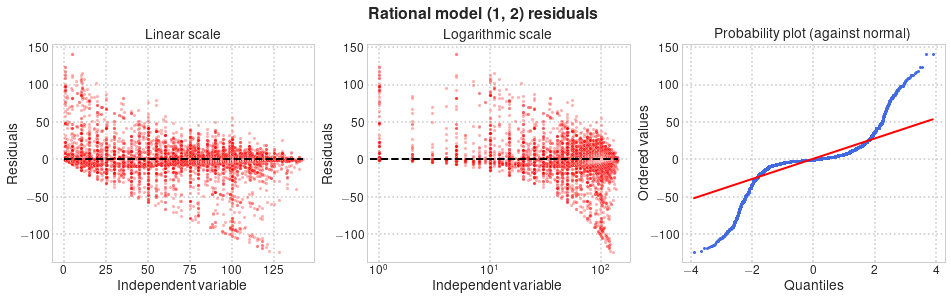

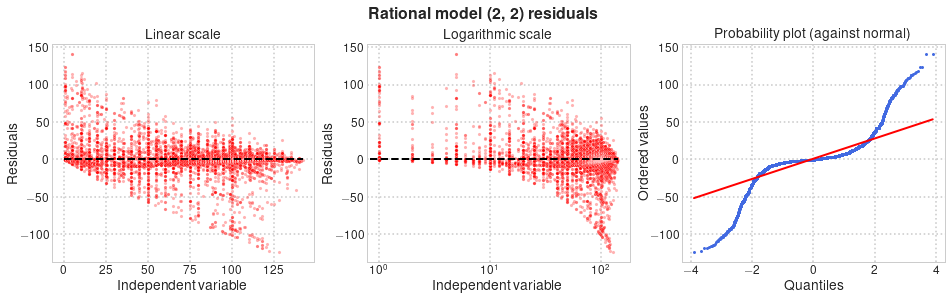

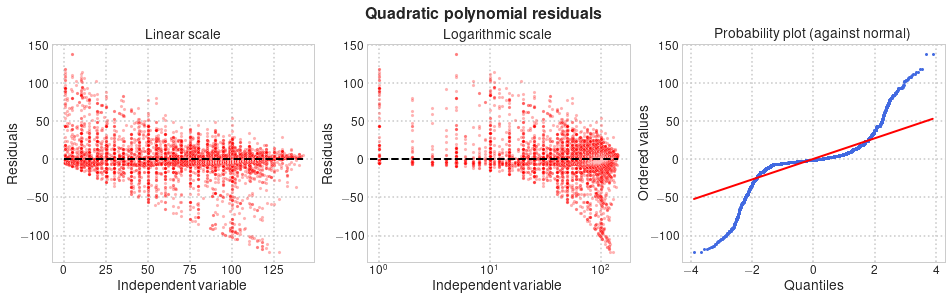

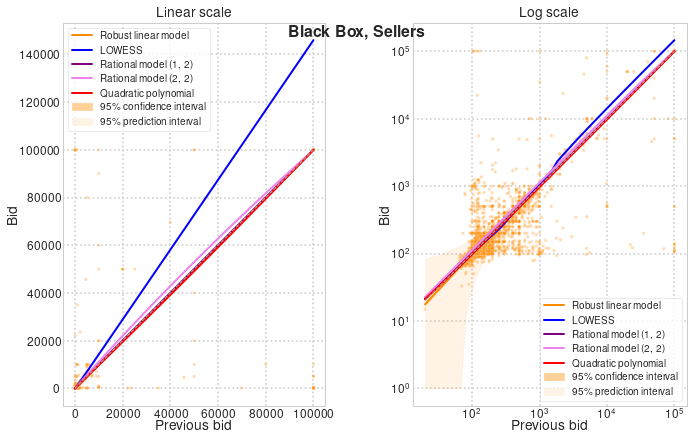

,R2 = 1 - SS_resid/SS_total
RLM,0.583143
LOWESS,0.142260
"Rational model (1, 2)",0.583141
"Rational model (2, 2)",0.583483
Quadratic polynomial,0.583177


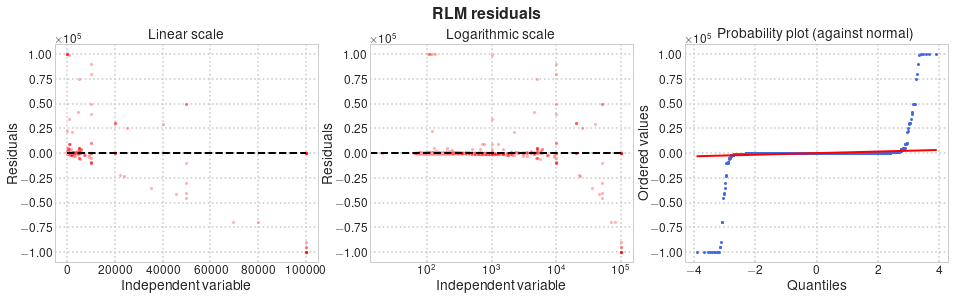

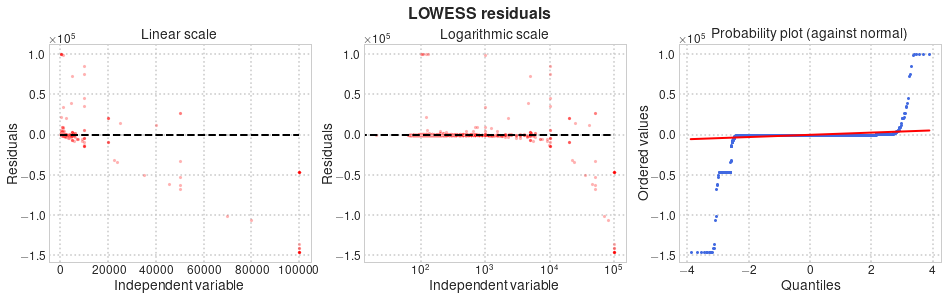

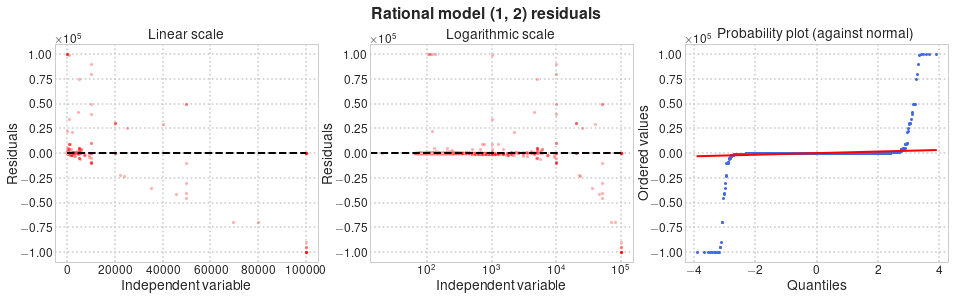

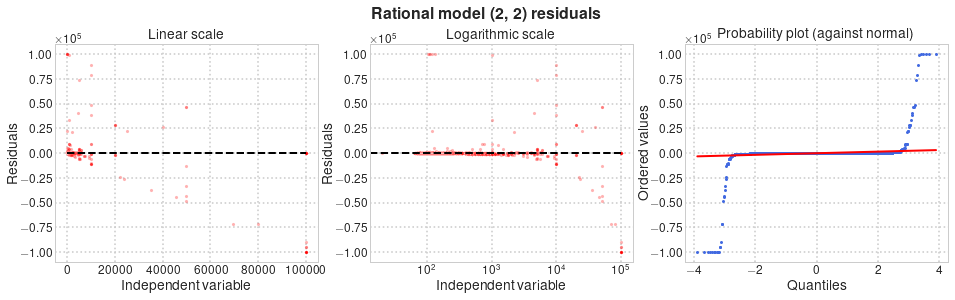

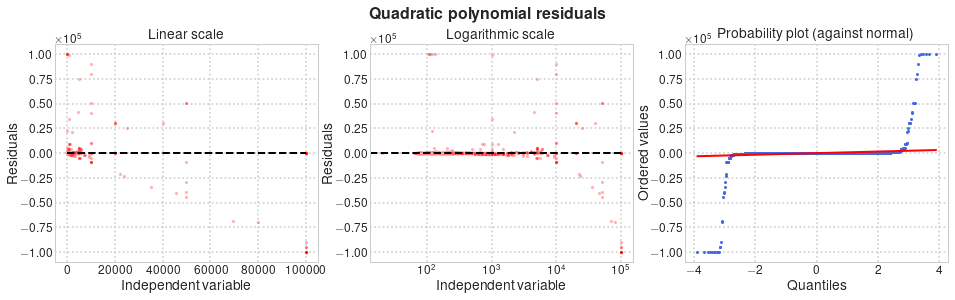

In [136]:
for (BB_mask, side), df_side in df_lags.dropna(subset=['bid-1']).groupby(['BB', 'side']):
    fig, axes = plt.subplots(1, 2, figsize=(10, 6), constrained_layout=True)
    
    suptitle = '{}, {}s'.format('Black Box' if BB_mask else 'Private Information', side)
    _ = plt.suptitle(bold_text(suptitle), y=0.95)
    
    x = df_side['bid-1']
    y = df_side['bid']
    mean_y = y.mean()
    
    xranges = {'linear': np.linspace(min(x), max(x)), 'log': np.geomspace(min(x), max(x))}
    fitted_vals, models, colours = nonparam_regression(df_side)
    
    for idx, scale in enumerate(['linear', 'log']):
        ax = axes[idx]
        xrange = xranges[scale]
        
        confInt, predInt = bid_regression(data=df_side, scale=scale, out=False)
        
        # Scatter plot, robust linear model, non-parametric regression models, 45-degree line
        splot = sns.scatterplot(x=x, y=y, ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, legend=False)
        regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)
                
        for method in fitted_vals.drop(columns=['x', 'y']).columns:
            if method == 'LOWESS':
                f = interp1d(fitted_vals['x'], fitted_vals[method], bounds_error=False)
                _ = ax.plot(xrange, f(xrange), label=method, linewidth=2, c=colours[method])
                
            elif 'Rational model' in method:
                _ = ax.plot(xrange, models[method](xrange), label=method, linewidth=2, c=colours[method])
                
            elif method == 'Quadratic polynomial':
                X = np.column_stack((xrange, xrange**2))
                X = sm.add_constant(X)
                _ = ax.plot(xrange, models[method].predict(X), label=method, linewidth=2, c=colours[method])

        _ = ax.plot(xrange, xrange, linestyle='dashed', color='darkgray', linewidth=1, zorder=2)
                
        # Axis layout
        _ = ax.set_title('{} scale'.format(scale.capitalize()))

        axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid'}
        
        try:
            _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
            _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        
        except:
            pass
        
        _ = ax.set_aspect('equal', adjustable='box')
        _ = splot.set(xscale=scale, yscale=scale)

        _ = ax.legend()
    
    _ = plt.show()
    
    # Residual plots
    SS_total = sum((y - mean_y)**2)
    R2 = {} # 1 - SS_total/SS_resid
    
    residual_plot(confInt['x'], confInt['resid'])
    _ = plt.suptitle(bold_text('RLM residuals'), y=1.01)
    R2['RLM'] = 1 - sum(confInt['resid']**2)/SS_total    
    
    for method in fitted_vals.drop(columns=['x', 'y']).columns:
        yhat = fitted_vals[method]
        resid = fitted_vals['y'] - yhat
        residual_plot(fitted_vals['x'], resid)
        _ = plt.suptitle(bold_text('{} residuals'.format(method)), y=1.01)
        R2[method] = 1 - sum(resid**2)/SS_total
    
    pd.DataFrame.from_dict(R2, orient='index', columns=['R2 = 1 - SS_resid/SS_total'])

The scatter plots below are overlaid with density kernel estimates, robust linear model fits with bootstrap estimates of 95% confidence intervals, and robust non-linear (rational) model fits.

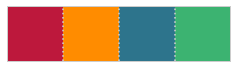

In [137]:
rm_colours = {'Buyer': '#2d748c', 'Seller': '#bd183c'}
sns.palplot([rm_colours['Seller'], side_colours['Seller'], rm_colours['Buyer'], side_colours['Buyer']])

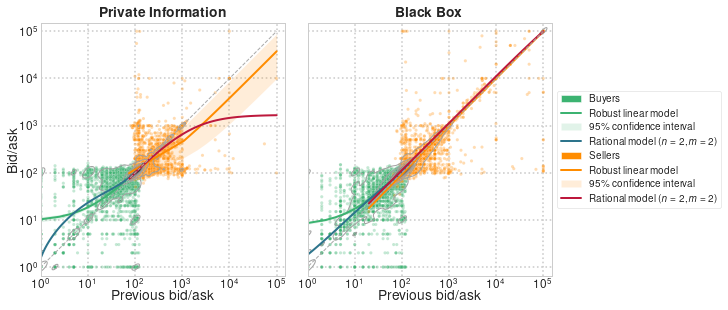

In [138]:
fig, axes = plt.subplots(1,2, figsize=(10,8), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.dropna(subset=['bid-1']).groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_aspect('equal', adjustable='box')    

    for side, df_side in data.groupby(['side']):
        x = df_side['bid-1']
        y = df_side['bid']
        
        # Scatter plot, kernel density estimate, robust linear model, and rational model (2, 2)
        splot = sns.scatterplot(x='bid-1', y='bid', ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, zorder=1)
        _ = splot.set(xscale='log', yscale='log')

        _ = sns.kdeplot(x='bid-1', y='bid', ax=ax, data=df_side, linewidths=1, log_scale=True,
                       levels=8, cmap=ListedColormap(gray_palette), zorder=2)
        
        _ = sns.regplot(x=x, y=y, ax=ax, data=df_side, robust=True, scatter=False,
                        color=side_colours[side], line_kws={'linewidth': 2})
        
        n = m = 2
        rm = least_squares(rational_residuals, x0=[1,1,1,1,1], loss='huber', f_scale=1,
                           args=(n,m,x,y), jac='cs')
        
        coeff = rm.x
        xrange = np.geomspace(min(x), max(x))
        _ = ax.plot(xrange, rational_eval(coeff, n, m, xrange), label=r'Rational model $(n=2, m=2)$',
                    linewidth=2, c=rm_colours[side])
            
        #confInt, predInt = bid_regression(data=df_side, scale='log', out=False)
        #regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)

    # 45-degree line
    _ = ax.plot(range(max(data['bid'])+1), range(max(data['bid'])+1), linestyle='dashed',
                color='darkgray', linewidth=1, zorder=2)
        
    # Axis layout
    axis_labels = {'bid': 'Bid/ask', 'bid-1': 'Previous bid/ask'}
    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        
    except:
        pass
    
    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'Private Information'))
    _ = ax.set_xticks([10**k for k in range(0,6)])

# Legend
handles, labels = axes[0].get_legend_handles_labels()
for idx in range(len(handles)):
    if labels[idx] in ['Buyer', 'Seller']:
        handles[idx] = Patch(facecolor=side_colours[labels[idx]])
        labels[idx] = '{}s'.format(labels[idx])
    if 'Rational model' in labels[idx]:
        labels[idx] = r'Rational model $(n=2, m=2)$'

for side in ['Buyer', 'Seller']:
    handles.extend([Line2D([0], [0], color=side_colours[side], linewidth=2),
                    Patch(facecolor=side_colours[side], alpha=0.15)])
    labels.extend(['Robust linear model', r'95\% confidence interval'])
   
order = [2,4,5,0,3,6,7,1]
handles = [handles[idx] for idx in order]
labels = [labels[idx] for idx in order]
_ = axes[0].legend_.remove()
_ = axes[1].legend(handles, labels, title=None, loc='center left', bbox_to_anchor=(1, 0.5))

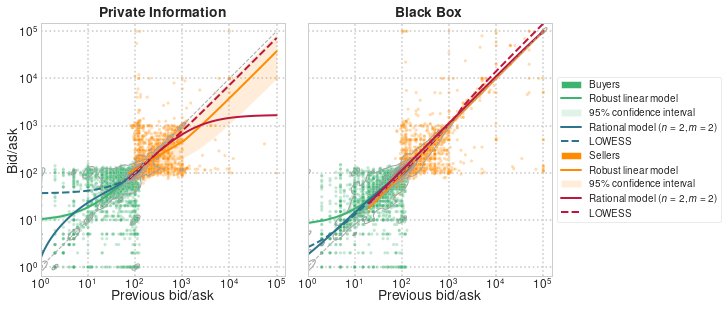

In [139]:
fig, axes = plt.subplots(1,2, figsize=(10,8), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.dropna(subset=['bid-1']).groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_aspect('equal', adjustable='box')    

    for side, df_side in data.groupby(['side']):
        x = df_side['bid-1']
        y = df_side['bid']
        
        # Scatter plot, kernel density estimate, robust linear model, and rational model (2, 2)
        splot = sns.scatterplot(x='bid-1', y='bid', ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, zorder=1)
        _ = splot.set(xscale='log', yscale='log')

        _ = sns.kdeplot(x='bid-1', y='bid', ax=ax, data=df_side, linewidths=1, log_scale=True,
                       levels=8, cmap=ListedColormap(gray_palette), zorder=2)
        
        _ = sns.regplot(x=x, y=y, ax=ax, data=df_side, robust=True, scatter=False,
                        color=side_colours[side], line_kws={'linewidth': 2})
        
        n = m = 2
        rm = least_squares(rational_residuals, x0=[1,1,1,1,1], loss='huber', f_scale=1,
                           args=(n,m,x,y), jac='cs')
        
        coeff = rm.x
        xrange = np.geomspace(min(x), max(x))
        _ = ax.plot(xrange, rational_eval(coeff, n, m, xrange), label=r'Rational model $(n=2, m=2)$',
                    linewidth=2, c=rm_colours[side])
        
        LOWESS = sm.nonparametric.lowess(y, x, return_sorted=False, frac=0.2)
        f = interp1d(x, LOWESS, bounds_error=False)
        _ = ax.plot(xrange, f(xrange), label='LOWESS', linewidth=2,
                    c=rm_colours[side], linestyle='dashed')

        #confInt, predInt = bid_regression(data=df_side, scale='log', out=False)
        #regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)

    # 45-degree line
    _ = ax.plot(range(max(data['bid'])+1), range(max(data['bid'])+1), linestyle='dashed',
                color='darkgray', linewidth=1, zorder=2)
        
    # Axis layout
    axis_labels = {'bid': 'Bid/ask', 'bid-1': 'Previous bid/ask'}
    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        
    except:
        pass
    
    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'Private Information'))
    _ = ax.set_xticks([10**k for k in range(0,6)])

# Legend
handles, labels = axes[0].get_legend_handles_labels()
for idx in range(len(handles)):
    if labels[idx] in ['Buyer', 'Seller']:
        handles[idx] = Patch(facecolor=side_colours[labels[idx]])
        labels[idx] = '{}s'.format(labels[idx])
    if 'Rational model' in labels[idx]:
        labels[idx] = r'Rational model $(n=2, m=2)$'

for side in ['Buyer', 'Seller']:
    handles.extend([Line2D([0], [0], color=side_colours[side], linewidth=2),
                    Patch(facecolor=side_colours[side], alpha=0.15)])
    labels.extend(['Robust linear model', r'95\% confidence interval'])
   
order = [4,6,7,0,1,5,8,9,2,3]
handles = [handles[idx] for idx in order]
labels = [labels[idx] for idx in order]
_ = axes[0].legend_.remove()
_ = axes[1].legend(handles, labels, title=None, loc='center left', bbox_to_anchor=(1, 0.5))

_ = plt.savefig('Figures/Regression_bids.pdf', bbox_inches='tight', transparent=True)

#### Panel data models 

[**Generalized Estimating Equations** (GEE)](https://online.stat.psu.edu/stat504/node/180/) estimate [generalized linear marginal models](https://www.theanalysisfactor.com/extensions-general-linear-model/) for panel, cluster or repeated measures data when the observations are possibly correlated within a cluster but uncorrelated across clusters.

The very crux of GEE is instead of attempting to model the within-subject covariance structure, to treat it as a nuisance and simply _model the mean response_: $g(\mu_i) = x_i^T \beta$. In this framework, the covariance structure doesn't need to be specified correctly to get reasonable estimates of regression coefficients and standard errors.

More details: [```statsmodels``` implementation](https://www.statsmodels.org/stable/gee.html) ([documentation](https://www.statsmodels.org/stable/generated/statsmodels.genmod.generalized_estimating_equations.GEE.html); [tutorial 1](https://nbviewer.jupyter.org/urls/umich.box.com/shared/static/ir0bnkup9rywmqd54zvm.ipynb), [tutorial 2](https://nbviewer.jupyter.org/urls/umich.box.com/shared/static/zyajjg1dxf2nmamztheg.ipynb?create=1)); [GEE in general](https://www4.stat.ncsu.edu/~dzhang2/epid766/index.html).

**Private Information, Buyer**

c:\users\bikica\miniconda3\lib\site-packages\statsmodels\genmod\cov_struct.py:762: RuntimeWarning: divide by zero encountered in true_divide
  wts = 1. / var
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\genmod\cov_struct.py:763: RuntimeWarning: invalid value encountered in true_divide
  wts /= wts.sum()


Skipped AR
                               GEE Regression Results                              
Dep. Variable:                         bid   No. Observations:                19098
Model:                                 GEE   No. clusters:                     3613
Method:                        Generalized   Min. cluster size:                   1
                      Estimating Equations   Max. cluster size:                  50
Family:                           Gaussian   Mean cluster size:                 5.3
Dependence structure:         Exchangeable   Num. iterations:                    28
Date:                     Fri, 29 Jan 2021   Scale:                         372.538
Covariance type:                    robust   Time:                         12:19:21
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         56.9915      1.661     34.311      0.000      53.736      60.

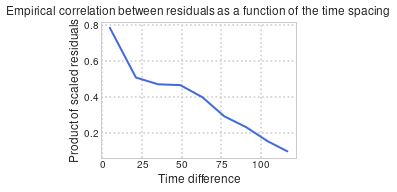

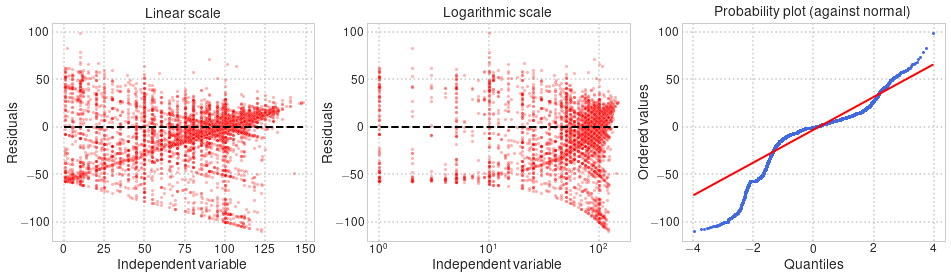

**Private Information, Seller**

c:\users\bikica\miniconda3\lib\site-packages\statsmodels\genmod\cov_struct.py:762: RuntimeWarning: divide by zero encountered in true_divide
  wts = 1. / var
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\genmod\cov_struct.py:763: RuntimeWarning: invalid value encountered in true_divide
  wts /= wts.sum()


Skipped AR
                               GEE Regression Results                              
Dep. Variable:                         bid   No. Observations:                20326
Model:                                 GEE   No. clusters:                     3789
Method:                        Generalized   Min. cluster size:                   1
                      Estimating Equations   Max. cluster size:                  65
Family:                           Gaussian   Mean cluster size:                 5.4
Dependence structure:         Exchangeable   Num. iterations:                    20
Date:                     Fri, 29 Jan 2021   Scale:                     1711142.254
Covariance type:                    robust   Time:                         12:19:31
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        145.0310     13.884     10.446      0.000     117.820     172.

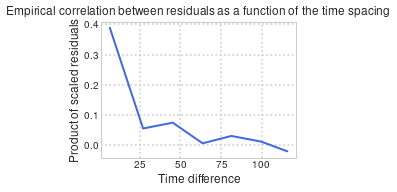

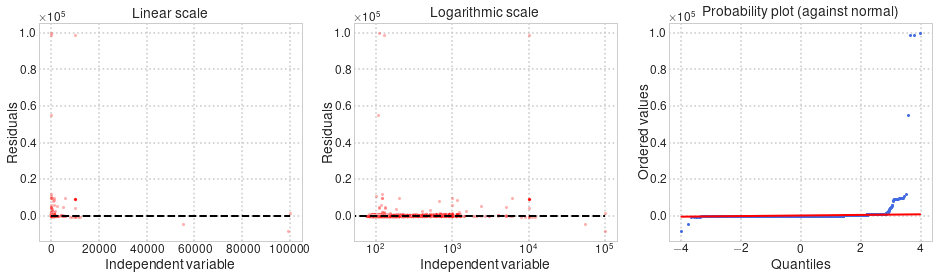

**Black Box, Buyer**

Skipped AR
                               GEE Regression Results                              
Dep. Variable:                         bid   No. Observations:                14024
Model:                                 GEE   No. clusters:                     3220
Method:                        Generalized   Min. cluster size:                   1
                      Estimating Equations   Max. cluster size:                  34
Family:                           Gaussian   Mean cluster size:                 4.4
Dependence structure:         Exchangeable   Num. iterations:                    30
Date:                     Fri, 29 Jan 2021   Scale:                         256.520
Covariance type:                    robust   Time:                         12:19:46
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         17.8694      0.686     26.034      0.000      16.524      19.

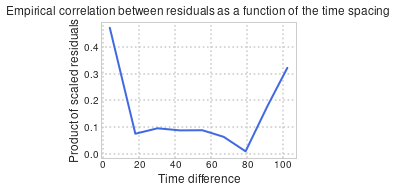

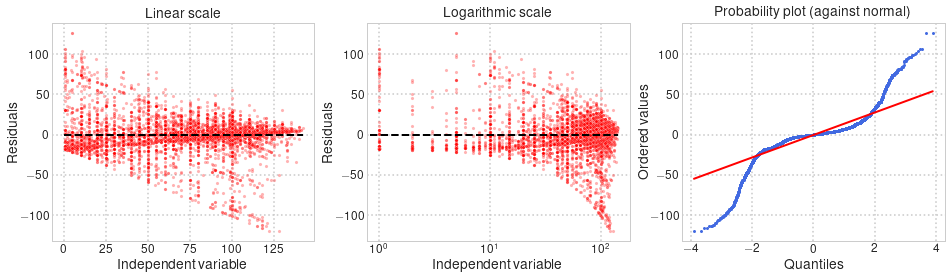

**Black Box, Seller**

c:\users\bikica\miniconda3\lib\site-packages\statsmodels\genmod\generalized_estimating_equations.py:1252: IterationLimitWarning: Iteration limit reached prior to convergence
  IterationLimitWarning)
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\genmod\cov_struct.py:762: RuntimeWarning: divide by zero encountered in true_divide
  wts = 1. / var
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\genmod\cov_struct.py:763: RuntimeWarning: invalid value encountered in true_divide
  wts /= wts.sum()


Skipped AR
                               GEE Regression Results                              
Dep. Variable:                         bid   No. Observations:                13947
Model:                                 GEE   No. clusters:                     3142
Method:                        Generalized   Min. cluster size:                   1
                      Estimating Equations   Max. cluster size:                  44
Family:                           Gaussian   Mean cluster size:                 4.4
Dependence structure:         Exchangeable   Num. iterations:                    60
Date:                     Fri, 29 Jan 2021   Scale:                    15307801.514
Covariance type:                    robust   Time:                         12:20:06
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         71.5789     32.464      2.205      0.027       7.950     135.

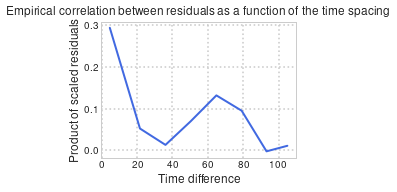

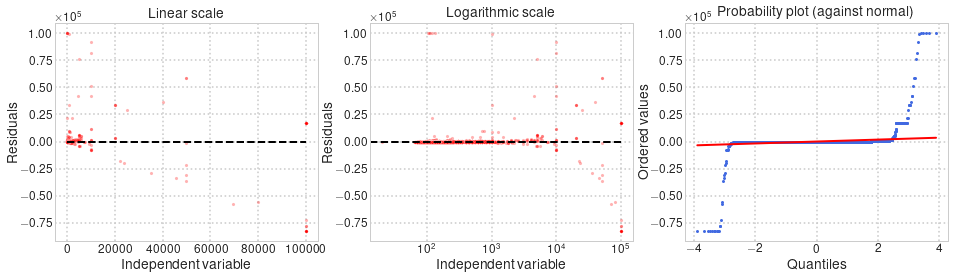

In [140]:
family = sm.families.Gaussian()

for (BB_mask, side), df_side in df_lags.groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))
    
    # Prepare data
    data = df_side.dropna(subset=['bid-1']).copy()   
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()
    y = data['bid']
    x = sm.add_constant(data['bid-1'])

    # Exchangeable working covariance structure
    ex = sm.cov_struct.Exchangeable()
    model = sm.GEE(y, x, groups=data['group'], time=data['time'], family=family, cov_struct=ex)
    results = model.fit()
    
    # Autoregressive working covariance structure
    try:
        ar = sm.cov_struct.Autoregressive()
        ar.dep_params = ex.dep_params
        model = sm.GEE(y, x, groups=data['group'], time=data['time'], family=family, cov_struct=ar)
        results = model.fit(start_params=results.params)
    except:
        print('Skipped AR')
        pass
    
    # Results
    print(results.summary())    
    fig, ax = plt.subplots(1, 1, figsize=(3.5,2.5))
    _ = results.plot_isotropic_dependence(ax=ax)
    _ = ax.set_title('Empirical correlation between residuals as a function of the time spacing')
    ax.get_lines()[0].set_linewidth(2)
    ax.get_lines()[0].set_color('royalblue')    
    ax.xaxis.label.set_size(12)
    ax.yaxis.label.set_size(12)
    ax.tick_params(labelsize=10)
    ax.title.set_size(12)
    residual_plot(x['bid-1'], results.resid)
    _ = plt.show()

[**```linearmodels``` models for panel data**](https://bashtage.github.io/linearmodels/doc/panel/models.html) ([examples](https://bashtage.github.io/linearmodels/doc/panel/examples/examples.html)): 
- fixed effect estimation (```PanelOLS```): $\boxed{y_i = \beta^T x_{it} + \alpha_i + \gamma_t + \varepsilon_{it}}$ ($\alpha_i \neq 0$ if ```entity_effects=True```, $\gamma_t \neq 0$ if ```time_effects=True```),
- panel data OLS (```PooledOLS```): $\boxed{y_i = \beta^T x_{it} + \varepsilon_{it}}$, 
- random effects (```RandomEffects```): $\boxed{y_i = \beta^T x_{it} + u_i + \varepsilon_{it}}$ ($u_i$ is a shock that is independent of $x_{it}$ but common to all entities $i$).

[**```statsmodels``` generalized least squares with AR covariance structure**](https://www.statsmodels.org/stable/examples/notebooks/generated/gls.html) ([documentation](https://www.statsmodels.org/stable/generated/statsmodels.regression.linear_model.GLSAR.html))

**Private Information, Buyer**

                           GLSAR Regression Results                           
Dep. Variable:                    bid   R-squared:                       0.558
Model:                          GLSAR   Adj. R-squared:                  0.558
Method:                 Least Squares   F-statistic:                 2.415e+04
Date:                Fri, 29 Jan 2021   Prob (F-statistic):               0.00
Time:                        12:20:37   Log-Likelihood:                -81758.
No. Observations:               19097   AIC:                         1.635e+05
Df Residuals:                   19095   BIC:                         1.635e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.5721      0.428     69.066      0.0

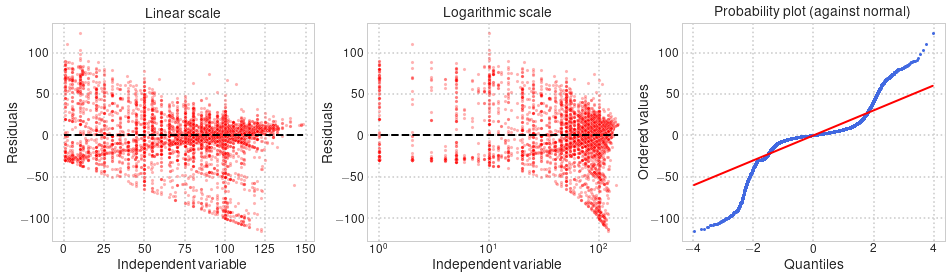

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                          PanelOLS Estimation Summary                           
Dep. Variable:                    bid   R-squared:                        0.1318
Estimator:                   PanelOLS   R-squared (Between):              0.3986
No. Observations:               19098   R-squared (Within):               0.1318
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.4174
Time:                        12:20:38   Log-likelihood                -7.725e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      2351.6
Entities:                        3613   P-value                           0.0000
Avg Obs:                       5.2859   Distribution:                 F(1,15484)
Min Obs:                       1.0000                                           
Max Obs:                       50.000   F-statistic (robust):             155.76
                            

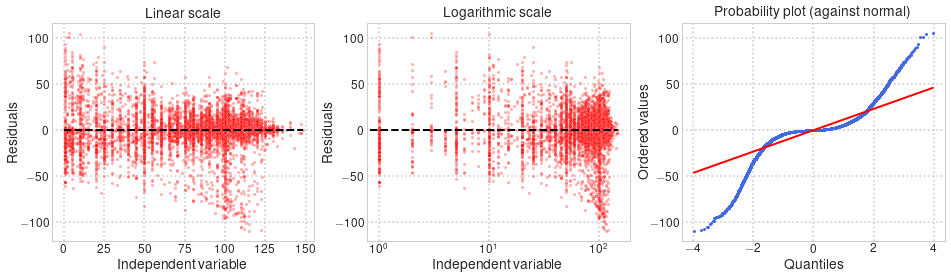

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                          PooledOLS Estimation Summary                          
Dep. Variable:                    bid   R-squared:                        0.5584
Estimator:                  PooledOLS   R-squared (Between):              0.4652
No. Observations:               19098   R-squared (Within):              -0.0028
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.5584
Time:                        12:20:40   Log-likelihood                -8.176e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                   2.415e+04
Entities:                        3613   P-value                           0.0000
Avg Obs:                       5.2859   Distribution:                 F(1,19096)
Min Obs:                       1.0000                                           
Max Obs:                       50.000   F-statistic (robust):             2087.2
                            

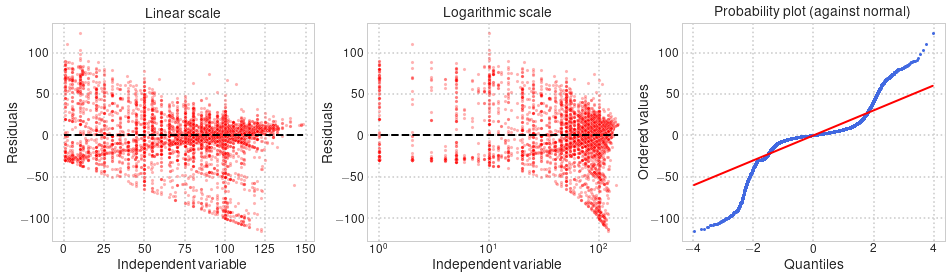

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                        RandomEffects Estimation Summary                        
Dep. Variable:                    bid   R-squared:                        0.5911
Estimator:              RandomEffects   R-squared (Between):              0.5097
No. Observations:               19098   R-squared (Within):               0.1074
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.5048
Time:                        12:20:43   Log-likelihood                -7.947e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                   2.761e+04
Entities:                        3613   P-value                           0.0000
Avg Obs:                       5.2859   Distribution:                 F(1,19096)
Min Obs:                       1.0000                                           
Max Obs:                       50.000   F-statistic (robust):             1166.7
                            

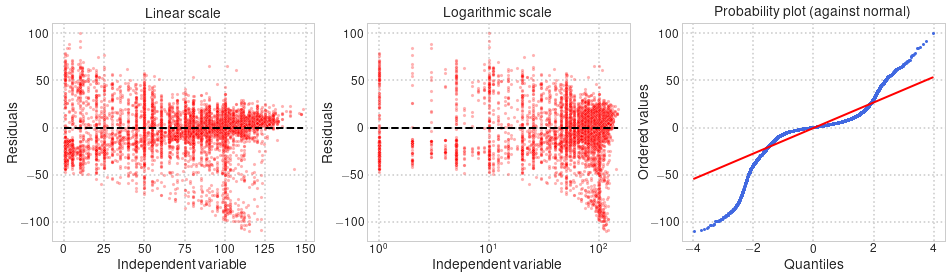

                           Model Comparison                          
                             PanelOLS     PooledOLS     RandomEffects
---------------------------------------------------------------------
Dep. Variable                     bid           bid               bid
Estimator                    PanelOLS     PooledOLS     RandomEffects
No. Observations                19098         19098             19098
Cov. Est.                   Clustered     Clustered         Clustered
R-squared                      0.1318        0.5584            0.5911
R-Squared (Within)             0.1318       -0.0028            0.1074
R-Squared (Between)            0.3986        0.4652            0.5097
R-Squared (Overall)            0.4174        0.5584            0.5048
F-statistic                    2351.6     2.415e+04         2.761e+04
P-value (F-stat)               0.0000        0.0000            0.0000
=====================     ===========   ===========   ===============
const               

**Private Information, Seller**

                           GLSAR Regression Results                           
Dep. Variable:                    bid   R-squared:                       0.012
Model:                          GLSAR   Adj. R-squared:                  0.011
Method:                 Least Squares   F-statistic:                     236.9
Date:                Fri, 29 Jan 2021   Prob (F-statistic):           3.67e-53
Time:                        12:20:45   Log-Likelihood:            -1.7469e+05
No. Observations:               20325   AIC:                         3.494e+05
Df Residuals:                   20323   BIC:                         3.494e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        144.4162      9.271     15.578      0.0

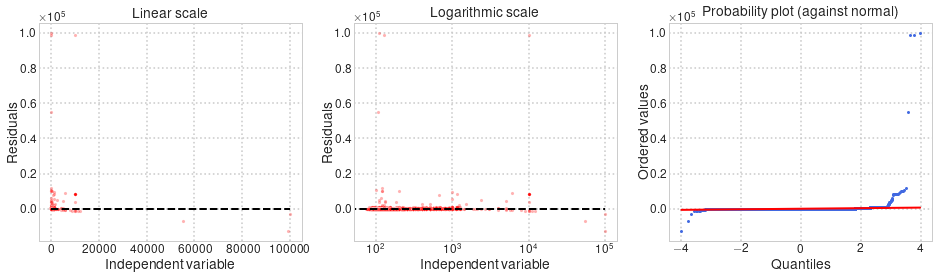

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                          PanelOLS Estimation Summary                           
Dep. Variable:                    bid   R-squared:                        0.0007
Estimator:                   PanelOLS   R-squared (Between):              0.0305
No. Observations:               20326   R-squared (Within):               0.0007
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.0049
Time:                        12:20:46   Log-likelihood                -1.738e+05
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      11.124
Entities:                        3789   P-value                           0.0009
Avg Obs:                       5.3645   Distribution:                 F(1,16536)
Min Obs:                       1.0000                                           
Max Obs:                       65.000   F-statistic (robust):             0.1449
                            

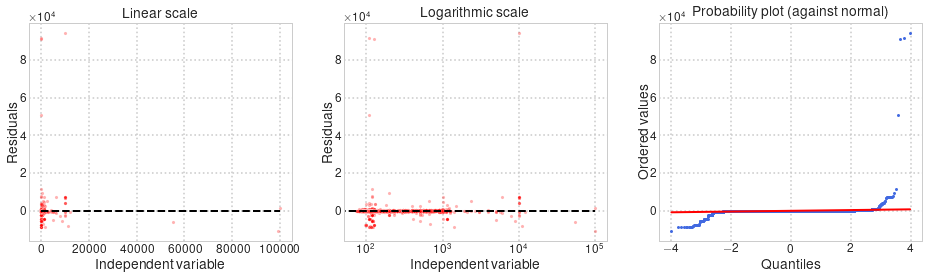

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                          PooledOLS Estimation Summary                          
Dep. Variable:                    bid   R-squared:                        0.0115
Estimator:                  PooledOLS   R-squared (Between):              0.1502
No. Observations:               20326   R-squared (Within):              -0.0059
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.0115
Time:                        12:20:48   Log-likelihood                -1.747e+05
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      236.94
Entities:                        3789   P-value                           0.0000
Avg Obs:                       5.3645   Distribution:                 F(1,20324)
Min Obs:                       1.0000                                           
Max Obs:                       65.000   F-statistic (robust):             3.4951
                            

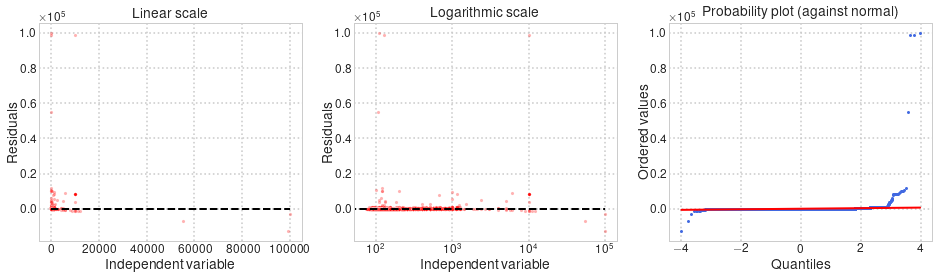

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                        RandomEffects Estimation Summary                        
Dep. Variable:                    bid   R-squared:                        0.0115
Estimator:              RandomEffects   R-squared (Between):              0.1502
No. Observations:               20326   R-squared (Within):              -0.0059
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.0115
Time:                        12:20:51   Log-likelihood                -1.747e+05
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      236.94
Entities:                        3789   P-value                           0.0000
Avg Obs:                       5.3645   Distribution:                 F(1,20324)
Min Obs:                       1.0000                                           
Max Obs:                       65.000   F-statistic (robust):             3.4951
                            

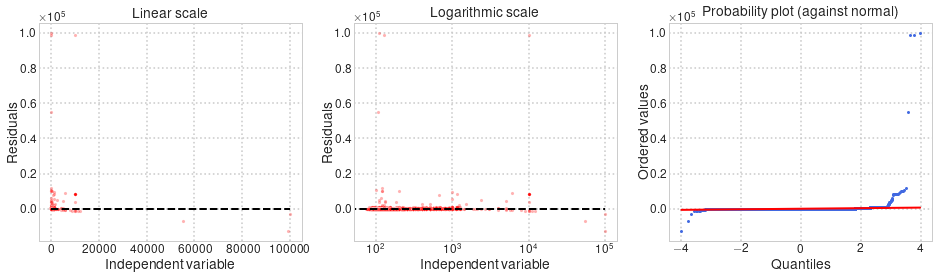

                           Model Comparison                          
                             PanelOLS     PooledOLS     RandomEffects
---------------------------------------------------------------------
Dep. Variable                     bid           bid               bid
Estimator                    PanelOLS     PooledOLS     RandomEffects
No. Observations                20326         20326             20326
Cov. Est.                   Clustered     Clustered         Clustered
R-squared                      0.0007        0.0115            0.0115
R-Squared (Within)             0.0007       -0.0059           -0.0059
R-Squared (Between)            0.0305        0.1502            0.1502
R-Squared (Overall)            0.0049        0.0115            0.0115
F-statistic                    11.124        236.94            236.94
P-value (F-stat)               0.0009        0.0000            0.0000
=====================     ===========   ===========   ===============
const               

**Black Box, Buyer**

                           GLSAR Regression Results                           
Dep. Variable:                    bid   R-squared:                       0.758
Model:                          GLSAR   Adj. R-squared:                  0.758
Method:                 Least Squares   F-statistic:                 4.403e+04
Date:                Fri, 29 Jan 2021   Prob (F-statistic):               0.00
Time:                        12:20:53   Log-Likelihood:                -58773.
No. Observations:               14023   AIC:                         1.176e+05
Df Residuals:                   14021   BIC:                         1.176e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         15.7630      0.353     44.699      0.0

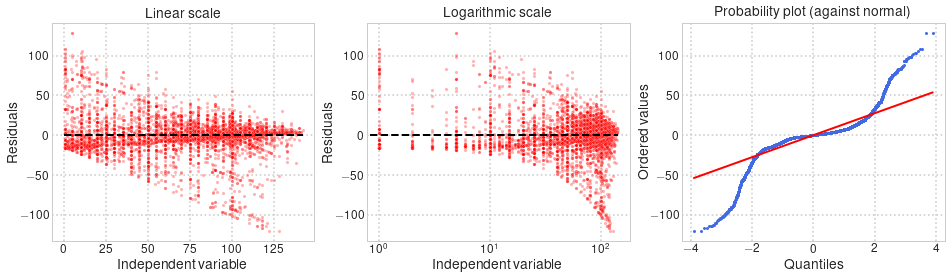

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                          PanelOLS Estimation Summary                           
Dep. Variable:                    bid   R-squared:                        0.3328
Estimator:                   PanelOLS   R-squared (Between):              0.7430
No. Observations:               14024   R-squared (Within):               0.3328
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.6758
Time:                        12:20:55   Log-likelihood                -5.585e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      5387.4
Entities:                        3220   P-value                           0.0000
Avg Obs:                       4.3553   Distribution:                 F(1,10803)
Min Obs:                       1.0000                                           
Max Obs:                       34.000   F-statistic (robust):             607.12
                            

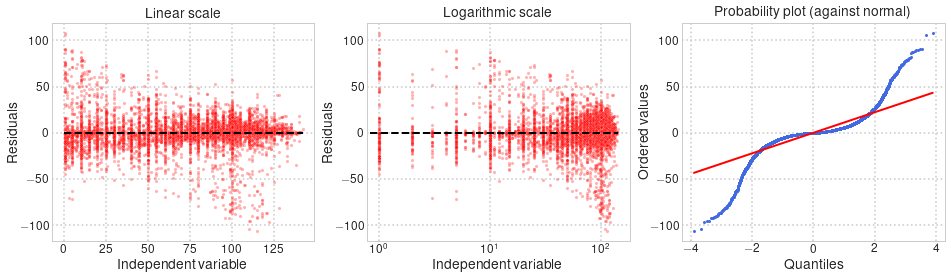

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                          PooledOLS Estimation Summary                          
Dep. Variable:                    bid   R-squared:                        0.7586
Estimator:                  PooledOLS   R-squared (Between):              0.8589
No. Observations:               14024   R-squared (Within):               0.2518
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.7586
Time:                        12:20:57   Log-likelihood                -5.878e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                   4.406e+04
Entities:                        3220   P-value                           0.0000
Avg Obs:                       4.3553   Distribution:                 F(1,14022)
Min Obs:                       1.0000                                           
Max Obs:                       34.000   F-statistic (robust):          1.308e+04
                            

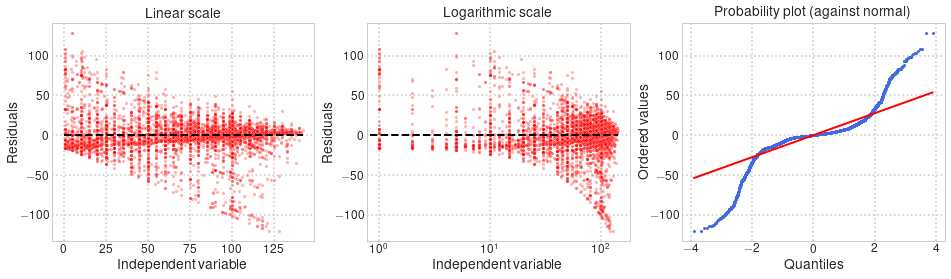

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                        RandomEffects Estimation Summary                        
Dep. Variable:                    bid   R-squared:                        0.7236
Estimator:              RandomEffects   R-squared (Between):              0.8521
No. Observations:               14024   R-squared (Within):               0.2785
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.7554
Time:                        12:20:59   Log-likelihood                -5.808e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                   3.671e+04
Entities:                        3220   P-value                           0.0000
Avg Obs:                       4.3553   Distribution:                 F(1,14022)
Min Obs:                       1.0000                                           
Max Obs:                       34.000   F-statistic (robust):             7351.5
                            

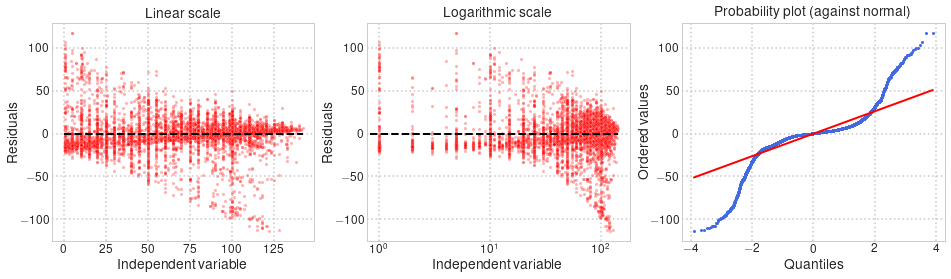

                           Model Comparison                          
                             PanelOLS     PooledOLS     RandomEffects
---------------------------------------------------------------------
Dep. Variable                     bid           bid               bid
Estimator                    PanelOLS     PooledOLS     RandomEffects
No. Observations                14024         14024             14024
Cov. Est.                   Clustered     Clustered         Clustered
R-squared                      0.3328        0.7586            0.7236
R-Squared (Within)             0.3328        0.2518            0.2785
R-Squared (Between)            0.7430        0.8589            0.8521
R-Squared (Overall)            0.6758        0.7586            0.7554
F-statistic                    5387.4     4.406e+04         3.671e+04
P-value (F-stat)               0.0000        0.0000            0.0000
=====================     ===========   ===========   ===============
const               

**Black Box, Seller**

                           GLSAR Regression Results                           
Dep. Variable:                    bid   R-squared:                       0.636
Model:                          GLSAR   Adj. R-squared:                  0.636
Method:                 Least Squares   F-statistic:                 2.432e+04
Date:                Fri, 29 Jan 2021   Prob (F-statistic):               0.00
Time:                        12:21:01   Log-Likelihood:            -1.3510e+05
No. Observations:               13946   AIC:                         2.702e+05
Df Residuals:                   13944   BIC:                         2.702e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        118.1670     33.183      3.561      0.0

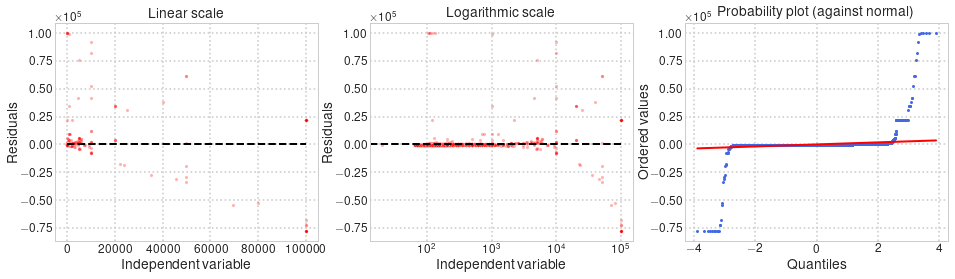

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                          PanelOLS Estimation Summary                           
Dep. Variable:                    bid   R-squared:                        0.0354
Estimator:                   PanelOLS   R-squared (Between):              0.3271
No. Observations:               13947   R-squared (Within):               0.0354
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.2623
Time:                        12:21:03   Log-likelihood                -1.317e+05
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      396.20
Entities:                        3142   P-value                           0.0000
Avg Obs:                       4.4389   Distribution:                 F(1,10804)
Min Obs:                       1.0000                                           
Max Obs:                       44.000   F-statistic (robust):             0.6371
                            

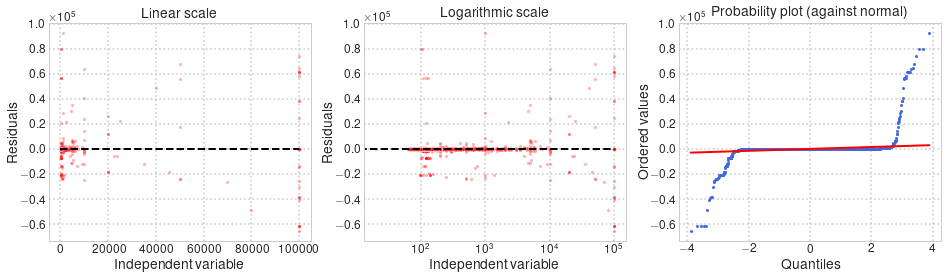

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                          PooledOLS Estimation Summary                          
Dep. Variable:                    bid   R-squared:                        0.6355
Estimator:                  PooledOLS   R-squared (Between):              0.9174
No. Observations:               13947   R-squared (Within):              -0.3453
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.6355
Time:                        12:21:05   Log-likelihood                -1.351e+05
Cov. Estimator:             Clustered                                           
                                        F-statistic:                   2.432e+04
Entities:                        3142   P-value                           0.0000
Avg Obs:                       4.4389   Distribution:                 F(1,13945)
Min Obs:                       1.0000                                           
Max Obs:                       44.000   F-statistic (robust):             106.07
                            

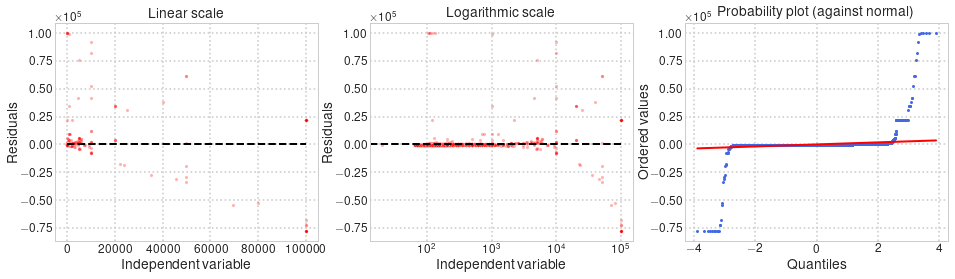

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


                        RandomEffects Estimation Summary                        
Dep. Variable:                    bid   R-squared:                        0.6355
Estimator:              RandomEffects   R-squared (Between):              0.9174
No. Observations:               13947   R-squared (Within):              -0.3453
Date:                Fri, Jan 29 2021   R-squared (Overall):              0.6355
Time:                        12:21:07   Log-likelihood                -1.351e+05
Cov. Estimator:             Clustered                                           
                                        F-statistic:                   2.432e+04
Entities:                        3142   P-value                           0.0000
Avg Obs:                       4.4389   Distribution:                 F(1,13945)
Min Obs:                       1.0000                                           
Max Obs:                       44.000   F-statistic (robust):             106.07
                            

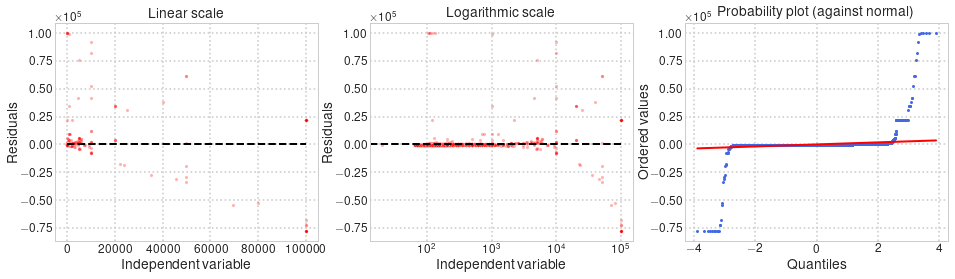

                           Model Comparison                          
                             PanelOLS     PooledOLS     RandomEffects
---------------------------------------------------------------------
Dep. Variable                     bid           bid               bid
Estimator                    PanelOLS     PooledOLS     RandomEffects
No. Observations                13947         13947             13947
Cov. Est.                   Clustered     Clustered         Clustered
R-squared                      0.0354        0.6355            0.6355
R-Squared (Within)             0.0354       -0.3453           -0.3453
R-Squared (Between)            0.3271        0.9174            0.9174
R-Squared (Overall)            0.2623        0.6355            0.6355
F-statistic                    396.20     2.432e+04         2.432e+04
P-value (F-stat)               0.0000        0.0000            0.0000
=====================     ===========   ===========   ===============
const               

In [141]:
for (BB_mask, side), df_side in df_lags.groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))
    
    models = {}
    
    # Prepare data
    data = df_side.dropna(subset=['bid-1']).copy()
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()

    data = data.set_index(['group', 'time'])
    y = data['bid']
    x = sm.add_constant(data['bid-1'])

    # Generalized Least Squares with AR covariance structure
    model = sm.GLSAR(y, x, rho=1)
    results = model.iterative_fit(1)
    print(results.summary())
    residual_plot(x['bid-1'], results.resid)
    _ = plt.show()
    
    # Panel OLS
    model = PanelOLS(y, x, entity_effects=True, time_effects=False)
    results = model.fit(cov_type='clustered', cluster_entity=True, cluster_time=True)
    models['PanelOLS'] = results
    print(results)
    residual_plot(x['bid-1'], results.resids)
    _ = plt.show()
    
    # Pooled OLS
    model = PooledOLS(y, x)
    results = model.fit(cov_type='clustered', cluster_entity=True, cluster_time=True)
    models['PooledOLS'] = results
    print(results)
    residual_plot(x['bid-1'], results.resids)
    _ = plt.show()
    
    # Random effects
    model = RandomEffects(y, x)
    results = model.fit(cov_type='clustered', cluster_entity=True, cluster_time=True)
    models['RandomEffects'] = results
    print(results)   
    residual_plot(x['bid-1'], results.resids)
    _ = plt.show()
    
    print(compare(models))

**```R``` package ```plm```** ([documentation](https://cran.r-project.org/web/packages/plm/), [Panel Data Econometrics in R: The plm Package](https://www.jstatsoft.org/article/view/v027i02))

Panel data models: ```plm(..., model=c("within", "random", "ht", "between", "pooling", "fd"), ...)```\

|Syntax | Model | Description |
|-------|-------|-------------|
| ```within``` | fixed effects | individual error component correlated with the regressors |
| ```random``` | random | individual error component uncorrelated with the regressors |
| ```pooling``` | pooling | individual error component missing altogether |
| ```fd``` | first-difference | removes time-invariant individual components by first-differencing the data (usually preferred if the errors are strongly persistent in time, because then $\Delta \varepsilon$ will tend to be serially uncorrelated) |
| ```between```| between | computed on time (group) averages of the data, discards all the information due to intragroup variability but is consistent in some settings (e.g., nonstationarity) where the others are not, and is often preferred to estimate long-run relationships |

**How do we know if fixed and/or random effects exist in panel data in hand?** Fixed effects are tested by the F test, while random effects are examined by the Lagrange multiplier (LM) test (Breusch and Pagan, 1980). The former compares a fixed effect model and OLS to see how much the fixed effect model can improve the goodness-of-fit, whereas the latter contrast a random effect model with OLS. If the null hypothesis is not rejected in either test, the pooled OLS regression is favored. The Hausman specification test (Hausman, 1978) compares a random effect model to its fixed counterpart. If the null hypothesis that the individual effects are uncorrelated with the other regressors is not rejected, a random effect model is favored over its fixed counterpart.

**Private Information, Buyer**

Test of individual and/or time effects based on the comparison of the within and the pooling model.


	F test for individual effects

data:  bid ~ lag(bid) + 1
F = 1050.1, df1 = -1, df2 = 19097, p-value = NA
alternative hypothesis: significant effects



	F test for time effects

data:  bid ~ lag(bid) + 1
F = 1.9926, df1 = -4771, df2 = 23867, p-value = NA
alternative hypothesis: significant effects



	F test for twoways effects

data:  bid ~ lag(bid) + 1
F = 25.713, df1 = 49, df2 = 19047, p-value < 2.2e-16
alternative hypothesis: significant effects




Tests of individual and/or time effects for panel models.


	Lagrange Multiplier Test - (Honda) for unbalanced panels

data:  bid ~ lag(bid) + 1
normal = 38.15, p-value < 2.2e-16
alternative hypothesis: significant effects



	Lagrange Multiplier Test - time effects (Honda) for unbalanced panels

data:  bid ~ lag(bid) + 1
normal = 664.19, p-value < 2.2e-16
alternative hypothesis: significant effects



	Lagrange Multiplier Test - two-ways effects (Honda) for unbalanced
	panels

data:  bid ~ lag(bid) + 1
normal = 496.63, p-value < 2.2e-16
alternative hypothesis: significant effects




To decide between fixed or random effects a Hausman test can be run where the null hypothesis is that the 
            preferred model is random effects vs. the alternative the fixed effects. It tests whether the unique
            errors (u_i) are correlated with the regressors, the null hypothesis is they are not. If the p-value is 
            significant (e.g. < 0.05) then use fixed effects, if not use random effects.


	Hausman Test

data:  bid ~ lag(bid) + 1
chisq = 5638.6, df = 1, p-value < 2.2e-16
alternative hypothesis: one model is inconsistent


Twoways effects Within Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, effect = "twoways", 
    model = "within", index = c("group", "step"))

Unbalanced Panel: n = 4821, T = 1-51, N = 23919

Residuals:
      Min.    1st Qu.     Median    3rd Qu.       Max. 
-111.72708   -3.22867   -0.20812    4.58729  104.62526 

Coefficients:
          Estimate Std. Error t-value  Pr(>|t|)    
lag(bid) 0.1553269  0.0069196  22.448 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    5631300
Residual Sum of Squares: 5486100
R-Squared:      0.025773
Adj. R-Squared: -0.22337
F-statistic: 503.889 on 1 and 19047 DF, p-value: < 2.22e-16



First–differencing–based test of serial correlation for (the idiosyncratic component of) the errors in
            either levels or first–differenced panel models.


	Wooldridge's first-difference test for serial correlation in panels

data:  fd
F = 6.4579, df1 = 1, df2 = 15483, p-value = 0.01106
alternative hypothesis: serial correlation in differenced errors



	Wooldridge's first-difference test for serial correlation in panels

data:  fd
F = 758.97, df1 = 1, df2 = 15483, p-value < 2.2e-16
alternative hypothesis: serial correlation in original errors




Test of serial correlation for (the idiosyncratic component of) the errors in fixed–effects panel models.


	Wooldridge's test for serial correlation in FE panels

data:  plm.model
F = 50.104, df1 = 1, df2 = 19096, p-value = 1.509e-12
alternative hypothesis: serial correlation




Semi-parametric test for the presence of (individual or time) unobserved effects in panel models.

Pooling Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, model = "pooling", 
    index = c("group", "step"))

Unbalanced Panel: n = 4821, T = 1-51, N = 23919

Residuals:
     Min.   1st Qu.    Median   3rd Qu.      Max. 
-113.6069   -2.7290    3.1463    8.1472  119.1557 

Coefficients:
              Estimate Std. Error t-value  Pr(>|t|)    
(Intercept) 34.5932520  0.4850353  71.321 < 2.2e-16 ***
lag(bid)     0.6251064  0.0050471 123.854 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    17244000
Residual Sum of Squares: 10506000
R-Squared:      0.39075
Adj. R-Squared: 0.39073
F-statistic: 15339.8 on 1 and 23917 DF, p-value: < 2.22e-16


	Wooldridge's test for unobserved individual effects

data:  formula
z = 4.7618, p-value = 1.919e-06
alternative hypothesis: unobserved effect



	Wooldridge's test for unobserved time effects

data:  formula
z = 1.227, p-value = 0.2198
alternative hypothesis: unobserved effect




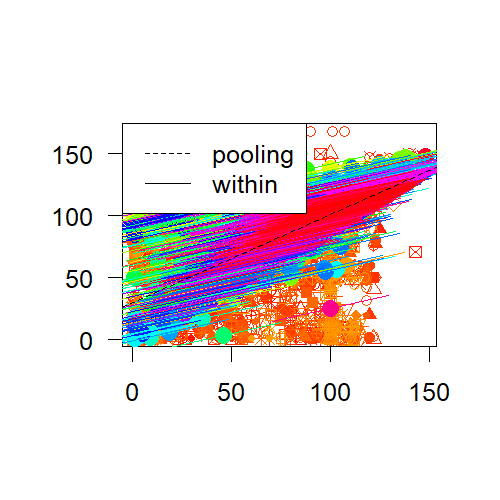

**Private Information, Seller**

Test of individual and/or time effects based on the comparison of the within and the pooling model.


	F test for individual effects

data:  bid ~ lag(bid) + 1
F = Inf, df1 = 0, df2 = 20324, p-value = NA
alternative hypothesis: significant effects



	F test for time effects

data:  bid ~ lag(bid) + 1
F = 0.036791, df1 = -4871, df2 = 25195, p-value = NA
alternative hypothesis: significant effects



	F test for twoways effects

data:  bid ~ lag(bid) + 1
F = 26.804, df1 = 65, df2 = 20259, p-value < 2.2e-16
alternative hypothesis: significant effects




Tests of individual and/or time effects for panel models.


	Lagrange Multiplier Test - (Honda) for unbalanced panels

data:  bid ~ lag(bid) + 1
normal = 19.142, p-value < 2.2e-16
alternative hypothesis: significant effects



	Lagrange Multiplier Test - time effects (Honda) for unbalanced panels

data:  bid ~ lag(bid) + 1
normal = 0.40318, p-value = 0.3434
alternative hypothesis: significant effects



	Lagrange Multiplier Test - two-ways effects (Honda) for unbalanced
	panels

data:  bid ~ lag(bid) + 1
normal = 13.821, p-value < 2.2e-16
alternative hypothesis: significant effects




To decide between fixed or random effects a Hausman test can be run where the null hypothesis is that the 
            preferred model is random effects vs. the alternative the fixed effects. It tests whether the unique
            errors (u_i) are correlated with the regressors, the null hypothesis is they are not. If the p-value is 
            significant (e.g. < 0.05) then use fixed effects, if not use random effects.


	Hausman Test

data:  bid ~ lag(bid) + 1
chisq = 82.069, df = 1, p-value < 2.2e-16
alternative hypothesis: one model is inconsistent


Twoways effects Within Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, effect = "twoways", 
    model = "within", index = c("group", "step"))

Unbalanced Panel: n = 4937, T = 1-66, N = 25262

Residuals:
      Min.    1st Qu.     Median    3rd Qu.       Max. 
-9549.1778   -17.5597     3.4824    15.5726 93973.2769 

Coefficients:
          Estimate Std. Error t-value  Pr(>|t|)    
lag(bid) 0.0248867  0.0072164  3.4487 0.0005645 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    3.2e+10
Residual Sum of Squares: 3.1981e+10
R-Squared:      0.00058671
Adj. R-Squared: -0.24617
F-statistic: 11.8932 on 1 and 20259 DF, p-value: 0.00056454



First–differencing–based test of serial correlation for (the idiosyncratic component of) the errors in
            either levels or first–differenced panel models.


	Wooldridge's first-difference test for serial correlation in panels

data:  fd
F = 17.886, df1 = 1, df2 = 16535, p-value = 2.358e-05
alternative hypothesis: serial correlation in differenced errors



	Wooldridge's first-difference test for serial correlation in panels

data:  fd
F = 33.41, df1 = 1, df2 = 16535, p-value = 7.6e-09
alternative hypothesis: serial correlation in original errors




Test of serial correlation for (the idiosyncratic component of) the errors in fixed–effects panel models.


	Wooldridge's test for serial correlation in FE panels

data:  plm.model
F = 0.071451, df1 = 1, df2 = 20323, p-value = 0.7892
alternative hypothesis: serial correlation




Semi-parametric test for the presence of (individual or time) unobserved effects in panel models.

Pooling Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, model = "pooling", 
    index = c("group", "step"))

Unbalanced Panel: n = 4937, T = 1-66, N = 25262

Residuals:
     Min.   1st Qu.    Median   3rd Qu.      Max. 
-9060.323   -52.535   -41.678   -33.150 99842.954 

Coefficients:
              Estimate Std. Error t-value  Pr(>|t|)    
(Intercept) 1.4630e+02 7.4775e+00  19.565 < 2.2e-16 ***
lag(bid)    9.0261e-02 6.2662e-03  14.405 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    3.5319e+10
Residual Sum of Squares: 3.5031e+10
R-Squared:      0.0081472
Adj. R-Squared: 0.008108
F-statistic: 207.49 on 1 and 25260 DF, p-value: < 2.22e-16


	Wooldridge's test for unobserved individual effects

data:  formula
z = 1.204, p-value = 0.2286
alternative hypothesis: unobserved effect



	Wooldridge's test for unobserved time effects

data:  formula
z = 0.54233, p-value = 0.5876
alternative hypothesis: unobserved effect




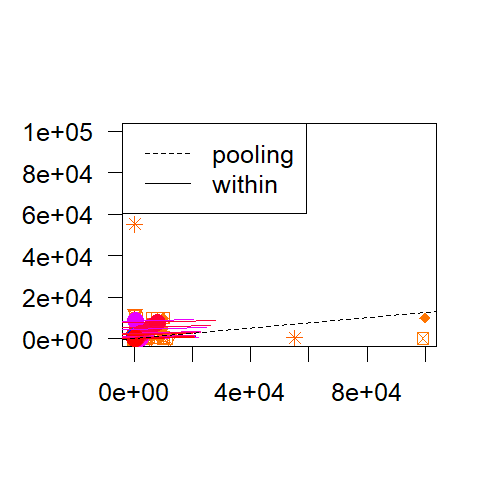

**Black Box, Buyer**

Test of individual and/or time effects based on the comparison of the within and the pooling model.


	F test for individual effects

data:  bid ~ lag(bid) + 1
F = -Inf, df1 = 0, df2 = 14022, p-value = NA
alternative hypothesis: significant effects



	F test for time effects

data:  bid ~ lag(bid) + 1
F = 2.8428, df1 = -4639, df2 = 18661, p-value = NA
alternative hypothesis: significant effects



	F test for twoways effects

data:  bid ~ lag(bid) + 1
F = -17.537, df1 = 34, df2 = 13988, p-value = 1
alternative hypothesis: significant effects




Tests of individual and/or time effects for panel models.


	Lagrange Multiplier Test - (Honda) for unbalanced panels

data:  bid ~ lag(bid) + 1
normal = 34.009, p-value < 2.2e-16
alternative hypothesis: significant effects



	Lagrange Multiplier Test - time effects (Honda) for unbalanced panels

data:  bid ~ lag(bid) + 1
normal = 422.92, p-value < 2.2e-16
alternative hypothesis: significant effects



	Lagrange Multiplier Test - two-ways effects (Honda) for unbalanced
	panels

data:  bid ~ lag(bid) + 1
normal = 323.1, p-value < 2.2e-16
alternative hypothesis: significant effects




To decide between fixed or random effects a Hausman test can be run where the null hypothesis is that the 
            preferred model is random effects vs. the alternative the fixed effects. It tests whether the unique
            errors (u_i) are correlated with the regressors, the null hypothesis is they are not. If the p-value is 
            significant (e.g. < 0.05) then use fixed effects, if not use random effects.


	Hausman Test

data:  bid ~ lag(bid) + 1
chisq = 739.34, df = 1, p-value < 2.2e-16
alternative hypothesis: one model is inconsistent


Twoways effects Within Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, effect = "twoways", 
    model = "within", index = c("group", "step"))

Unbalanced Panel: n = 4674, T = 1-35, N = 18697

Residuals:
     Min.   1st Qu.    Median   3rd Qu.      Max. 
-101.8836   -4.4657    0.0000    4.6324   95.6003 

Coefficients:
          Estimate Std. Error t-value  Pr(>|t|)    
lag(bid) 0.1742915  0.0060427  28.843 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    3970300
Residual Sum of Squares: 3747400
R-Squared:      0.056136
Adj. R-Squared: -0.26154
F-statistic: 831.928 on 1 and 13988 DF, p-value: < 2.22e-16



First–differencing–based test of serial correlation for (the idiosyncratic component of) the errors in
            either levels or first–differenced panel models.


	Wooldridge's first-difference test for serial correlation in panels

data:  fd
F = 11.775, df1 = 1, df2 = 10801, p-value = 0.0006026
alternative hypothesis: serial correlation in differenced errors



	Wooldridge's first-difference test for serial correlation in panels

data:  fd
F = 260.31, df1 = 1, df2 = 10801, p-value < 2.2e-16
alternative hypothesis: serial correlation in original errors




Test of serial correlation for (the idiosyncratic component of) the errors in fixed–effects panel models.


	Wooldridge's test for serial correlation in FE panels

data:  plm.model
F = 293.61, df1 = 1, df2 = 14021, p-value < 2.2e-16
alternative hypothesis: serial correlation




Semi-parametric test for the presence of (individual or time) unobserved effects in panel models.

Pooling Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, model = "pooling", 
    index = c("group", "step"))

Unbalanced Panel: n = 4674, T = 1-35, N = 18697

Residuals:
     Min.   1st Qu.    Median   3rd Qu.      Max. 
-121.9548   -6.6827    6.0085   12.2342  114.0410 

Coefficients:
              Estimate Std. Error t-value  Pr(>|t|)    
(Intercept) 30.8253172  0.5084889  60.621 < 2.2e-16 ***
lag(bid)     0.6267315  0.0056979 109.993 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    21420000
Residual Sum of Squares: 13004000
R-Squared:      0.39289
Adj. R-Squared: 0.39286
F-statistic: 12098.4 on 1 and 18695 DF, p-value: < 2.22e-16


	Wooldridge's test for unobserved individual effects

data:  formula
z = 12.172, p-value < 2.2e-16
alternative hypothesis: unobserved effect



	Wooldridge's test for unobserved time effects

data:  formula
z = 1.1218, p-value = 0.2619
alternative hypothesis: unobserved effect




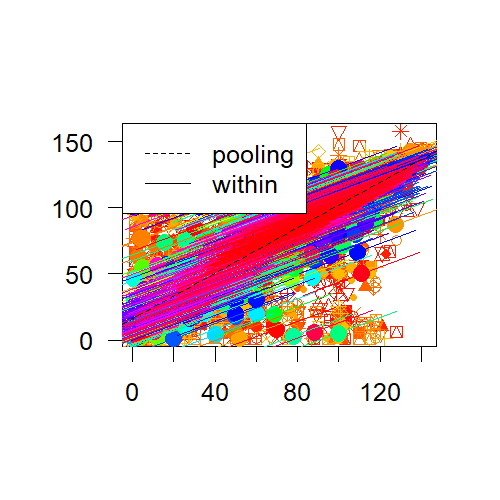

**Black Box, Seller**

Test of individual and/or time effects based on the comparison of the within and the pooling model.


	F test for individual effects

data:  bid ~ lag(bid) + 1
F = Inf, df1 = 0, df2 = 13945, p-value = NA
alternative hypothesis: significant effects



	F test for time effects

data:  bid ~ lag(bid) + 1
F = 1.9323, df1 = -4513, df2 = 18458, p-value = NA
alternative hypothesis: significant effects



	F test for twoways effects

data:  bid ~ lag(bid) + 1
F = 84.406, df1 = 44, df2 = 13901, p-value < 2.2e-16
alternative hypothesis: significant effects




Tests of individual and/or time effects for panel models.


	Lagrange Multiplier Test - (Honda) for unbalanced panels

data:  bid ~ lag(bid) + 1
normal = 31.996, p-value < 2.2e-16
alternative hypothesis: significant effects



	Lagrange Multiplier Test - time effects (Honda) for unbalanced panels

data:  bid ~ lag(bid) + 1
normal = -1.4286, p-value = 0.9234
alternative hypothesis: significant effects



	Lagrange Multiplier Test - two-ways effects (Honda) for unbalanced
	panels

data:  bid ~ lag(bid) + 1
normal = 21.615, p-value < 2.2e-16
alternative hypothesis: significant effects




To decide between fixed or random effects a Hausman test can be run where the null hypothesis is that the 
            preferred model is random effects vs. the alternative the fixed effects. It tests whether the unique
            errors (u_i) are correlated with the regressors, the null hypothesis is they are not. If the p-value is 
            significant (e.g. < 0.05) then use fixed effects, if not use random effects.


	Hausman Test

data:  bid ~ lag(bid) + 1
chisq = 9296.2, df = 1, p-value < 2.2e-16
alternative hypothesis: one model is inconsistent


Twoways effects Within Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, effect = "twoways", 
    model = "within", index = c("group", "step"))

Unbalanced Panel: n = 4558, T = 1-45, N = 18504

Residuals:
      Min.    1st Qu.     Median    3rd Qu.       Max. 
-69717.328    -55.383      0.000     41.438  90035.589 

Coefficients:
          Estimate Std. Error t-value  Pr(>|t|)    
lag(bid) 0.0474250  0.0063826  7.4304 1.146e-13 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    1.6802e+11
Residual Sum of Squares: 1.6735e+11
R-Squared:      0.003956
Adj. R-Squared: -0.32579
F-statistic: 55.2102 on 1 and 13901 DF, p-value: 1.1462e-13



First–differencing–based test of serial correlation for (the idiosyncratic component of) the errors in
            either levels or first–differenced panel models.


	Wooldridge's first-difference test for serial correlation in panels

data:  fd
F = 2.6119, df1 = 1, df2 = 10802, p-value = 0.1061
alternative hypothesis: serial correlation in differenced errors



	Wooldridge's first-difference test for serial correlation in panels

data:  fd
F = 2.1668, df1 = 1, df2 = 10802, p-value = 0.141
alternative hypothesis: serial correlation in original errors




Test of serial correlation for (the idiosyncratic component of) the errors in fixed–effects panel models.


	Wooldridge's test for serial correlation in FE panels

data:  plm.model
F = 0.38882, df1 = 1, df2 = 13944, p-value = 0.5329
alternative hypothesis: serial correlation




Semi-parametric test for the presence of (individual or time) unobserved effects in panel models.

Pooling Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, model = "pooling", 
    index = c("group", "step"))

Unbalanced Panel: n = 4558, T = 1-45, N = 18504

Residuals:
     Min.   1st Qu.    Median   3rd Qu.      Max. 
-66375.16   -167.21   -161.03   -152.44  99739.88 

Coefficients:
              Estimate Std. Error  t-value  Pr(>|t|)    
(Intercept) 1.9947e+02 3.4437e+01   5.7923 7.055e-09 ***
lag(bid)    6.6281e-01 5.5049e-03 120.4048 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    7.1766e+11
Residual Sum of Squares: 4.0238e+11
R-Squared:      0.43932
Adj. R-Squared: 0.43929
F-statistic: 14497.3 on 1 and 18502 DF, p-value: < 2.22e-16


	Wooldridge's test for unobserved individual effects

data:  formula
z = 2.0351, p-value = 0.04184
alternative hypothesis: unobserved effect



	Wooldridge's test for unobserved time effects

data:  formula
z = -1.6333, p-value = 0.1024
alternative hypothesis: unobserved effect




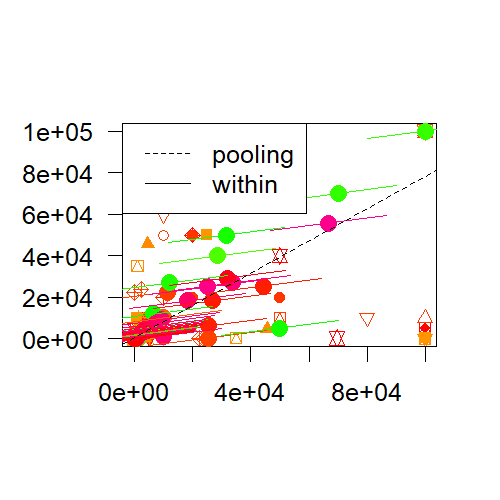

In [142]:
for (BB_mask, side), data in df_lags.groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))
    
    ######################################################################
    # Prepare data
    ######################################################################
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()
    # Replace time steps with consecutive integers
    data['step'] = data.groupby(['treatment', 'game', 'round', 'id'])['time'].cumcount()
#     data.rename({'bid-1': 'pbid'}, axis=1, inplace=True)
#     # Only take the last bid when two bids were submitted at the same time
#     data = data.groupby(['treatment','game','round','id','time']).tail(1)
#     data = data.dropna(subset=['bid-1'], axis=1)

    ######################################################################
    # Export data to R
    ######################################################################
    robjects.globalenv['rdf'] = data
    _ = r('rdf <- pdata.frame(rdf, index= c("group", "step"))')
    
    ########################################################################################################
    # F Test for Individual and/or Time Effects
    ########################################################################################################
    printmd('Test of individual and/or time effects based on the comparison of the within and the pooling model.')
    print(r('pFtest(bid ~ lag(bid) + 1, data = rdf, effect = "individual")'))
    print(r('pFtest(bid ~ lag(bid) + 1, data = rdf, effect = "time")'))
    print(r('pFtest(bid ~ lag(bid) + 1, data = rdf, effect = "twoways")'))
    
    ######################################################################
    # Lagrange FF multiplier tests
    ######################################################################
    printmd('''Tests of individual and/or time effects for panel models.''')
    print(r('plmtest(bid ~ lag(bid) + 1, data = rdf, effect = "individual")'))
    print(r('plmtest(bid ~ lag(bid) + 1, data = rdf, effect = "time")'))
    print(r('plmtest(bid ~ lag(bid) + 1, data = rdf, effect = "twoways")'))
        
    ######################################################################
    # Hausman test https://dss.princeton.edu/training/Panel101R.pdf
    ######################################################################
    printmd('''To decide between fixed or random effects a Hausman test can be run where the null hypothesis is that the 
            preferred model is random effects vs. the alternative the fixed effects. It tests whether the unique
            errors (u_i) are correlated with the regressors, the null hypothesis is they are not. If the p-value is 
            significant (e.g. < 0.05) then use fixed effects, if not use random effects.''')
    _ = r('wi <- plm(bid ~ lag(bid) + 1, data = rdf, index = c("group", "step"), model = "within", effect = "twoways")')
    _ = r('ra <- plm(bid ~ lag(bid) + 1, data = rdf, index = c("group", "step"), model = "random", effect = "twoways")')
    print(r('phtest(wi, ra, method = "aux", vcov = vcovHC)'))
    
    print(r('summary(wi)'))
        
    ########################################################################################################
    # Wooldridge first–difference–based test for AR(1) errors in levels for first–differenced panel models
    ########################################################################################################
    printmd('''First–differencing–based test of serial correlation for (the idiosyncratic component of) the errors in
            either levels or first–differenced panel models.''')
    _ = r('fd <- plm(bid ~ lag(bid) + 1, data = rdf, index = c("group", "step"), model = "fd", effect = "individual")')    
    print(r('pwfdtest(fd, type = "HC3", h0 = "fd")'))
    print(r('pwfdtest(fd, type = "HC3", h0 = "fe")'))
    
    ########################################################################################################
    # Wooldridge Test for AR(1) Errors in FE Panel Models
    ########################################################################################################
    printmd('Test of serial correlation for (the idiosyncratic component of) the errors in fixed–effects panel models.')
    print(r('pwartest(bid ~ lag(bid) + 1, data = rdf)'))
    
    ########################################################################################################
    # Wooldridge's Test for Unobserved Effects in Panel Models
    ########################################################################################################
    printmd('Semi-parametric test for the presence of (individual or time) unobserved effects in panel models.')
    
    _ = r('pool <- plm(bid ~ lag(bid) + 1, data = rdf, index = c("group", "step"), model = "pooling")')
    print(r('summary(pool)'))
    print(r('pwtest(pool, effect="individual")'))
    print(r('pwtest(pool, effect="time")'))
         
    with r_inline_plot(width=500, height=500, dpi=150):
        _ = r('plot(pool)')

**Private Information, Buyer**

[67.55221267 34.30255669 36.98221919 ... 74.10169999 99.93412042
 97.45476936]


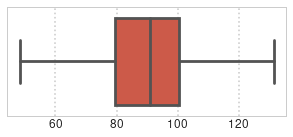

Oneway (individual) effect Within Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, effect = "individual", 
    model = "within", index = c("group", "step"))

Unbalanced Panel: n = 4821, T = 1-51, N = 23919

Residuals:
      Min.    1st Qu.     Median    3rd Qu.       Max. 
-109.14256   -2.26172    0.11673    4.30478  107.37498 

Coefficients:
          Estimate Std. Error t-value  Pr(>|t|)    
lag(bid) 0.0867748  0.0068787  12.615 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    6241000
Residual Sum of Squares: 6189400
R-Squared:      0.0082642
Adj. R-Squared: -0.2421
F-statistic: 159.136 on 1 and 19097 DF, p-value: < 2.22e-16



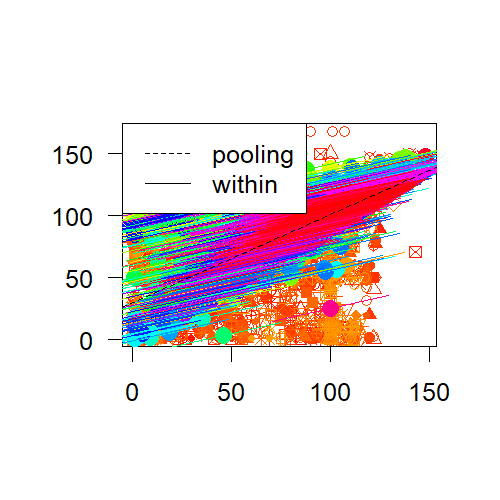

**Private Information, Seller**

Oneway (individual) effect Random Effect Model 
   (Swamy-Arora's transformation)

Call:
plm(formula = log(bid) ~ lag(log(bid)) + 1, data = rdf, effect = "individual", 
    model = "random", index = c("group", "step"))

Unbalanced Panel: n = 4937, T = 1-66, N = 25262

Effects:
                  var std.dev share
idiosyncratic 0.08649 0.29409     1
individual    0.00000 0.00000     0
theta:
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
      0       0       0       0       0       0 

Residuals:
      Min.    1st Qu.     Median    3rd Qu.       Max. 
-4.0628593 -0.0901599 -0.0355970  0.0049649  6.7733802 

Coefficients:
               Estimate Std. Error z-value  Pr(>|z|)    
(Intercept)   2.0501988  0.0248740  82.423 < 2.2e-16 ***
lag(log(bid)) 0.5743830  0.0051462 111.612 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    3955.7
Residual Sum of Squares: 2649.2
R-Squared:      0.33028
Adj. R-Squared: 0.33025
Chisq: 12457.2 on 1

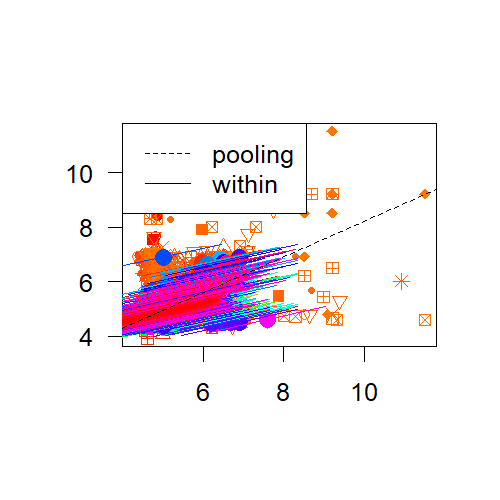

**Black Box, Buyer**

[63.74423478 96.3454672   8.40466509 ... 69.31295522 60.54530628
 60.18923826]


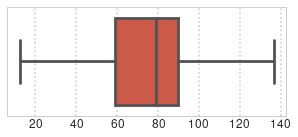

Oneway (individual) effect Within Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, effect = "individual", 
    model = "within", index = c("group", "step"))

Unbalanced Panel: n = 4674, T = 1-35, N = 18697

Residuals:
       Min.     1st Qu.      Median     3rd Qu.        Max. 
-101.888376   -4.543952    0.045489    6.364685   99.821117 

Coefficients:
          Estimate Std. Error t-value  Pr(>|t|)    
lag(bid) 0.1819579  0.0064732   28.11 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    5147800
Residual Sum of Squares: 4873200
R-Squared:      0.053345
Adj. R-Squared: -0.26221
F-statistic: 790.15 on 1 and 14022 DF, p-value: < 2.22e-16



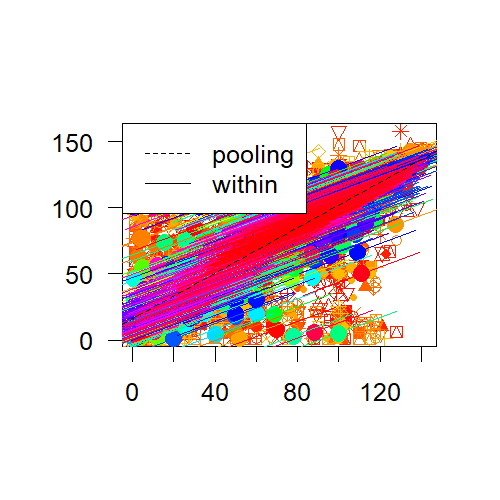

**Black Box, Seller**

[107.96649979  83.89174218 946.60561727 ...  87.26716573 103.85109648
 100.41905172]


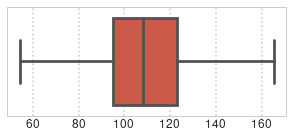

Oneway (individual) effect Within Model

Call:
plm(formula = bid ~ lag(bid) + 1, data = rdf, effect = "individual", 
    model = "within", index = c("group", "step"))

Unbalanced Panel: n = 4558, T = 1-45, N = 18504

Residuals:
       Min.     1st Qu.      Median     3rd Qu.        Max. 
-6.9793e+04 -5.6910e+00 -1.6111e-02  3.1200e+00  9.1533e+04 

Coefficients:
          Estimate Std. Error t-value  Pr(>|t|)    
lag(bid) 0.0483324  0.0063693  7.5883 3.446e-14 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Total Sum of Squares:    1.6857e+11
Residual Sum of Squares: 1.6787e+11
R-Squared:      0.0041123
Adj. R-Squared: -0.3214
F-statistic: 57.5823 on 1 and 13945 DF, p-value: 3.4464e-14



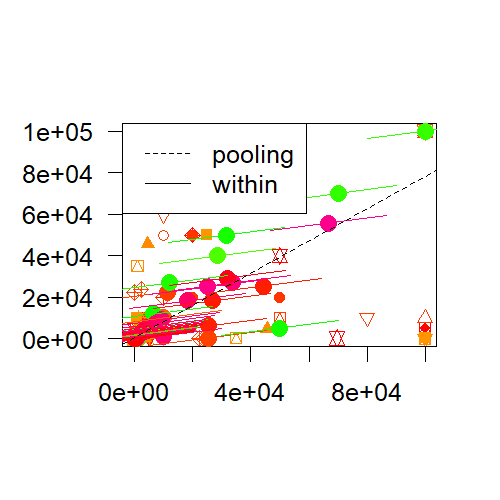

In [143]:
for (BB_mask, side), data in df_lags.groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))
    
    ######################################################################
    # Prepare data
    ######################################################################
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()
    # Replace time steps with consecutive integers
    data['step'] = data.groupby(['treatment', 'game', 'round', 'id'])['time'].cumcount()

    ######################################################################
    # Export data to R
    ######################################################################
    robjects.globalenv['rdf'] = data
    _ = r('rdf <- pdata.frame(rdf, index= c("group", "step"))')
    
    if (BB_mask == False) & (side == 'Seller'):
        _ = r('out <- plm(log(bid) ~ lag(log(bid)) + 1, data = rdf, index = c("group", "step"), model = "random", effect = "individual")')
    else:
        _ = r('out <- plm(bid ~ lag(bid) + 1, data = rdf, index = c("group", "step"), model = "within", effect = "individual")')
        print(r('fixef(out)'))
        
        intercepts = r('fixef(out)')
        fig, ax = plt.subplots(1,1, figsize=(5,2))
        _ = sns.boxplot(x=intercepts, ax=ax, showfliers=False)
        _ = plt.show()
    
    print(r('summary(out)'))
         
    with r_inline_plot(width=500, height=500, dpi=150):
        _ = r('plot(out)')

#### Dynamic panel data models

[How to do xtabond2: An introduction to difference and system GMM in Stata](https://www.stata-journal.com/article.html?article=st0159)

[Dynamic panel data models: a guide to micro data methods and practice](https://link.springer.com/article/10.1007/s10258-002-0009-9)

[Dynamic Panel Data Models](https://books.google.si/books?id=yhueDwAAQBAJ&pg=PA390&lpg=PA390&dq=pgmm+onestep+or+twosteps&source=bl&ots=4YQsm7i2CQ&sig=ACfU3U0qbbfib9R1gQ6LlSvOIjjpRdHrAA&hl=de&sa=X&ved=2ahUKEwipgJys5JvtAhUDyoUKHeFlBM0Q6AEwC3oECAcQAg#v=onepage&q=pgmm%20onestep%20or%20twosteps&f=false)

In cases in which we want to estimate dynamic models with panel data, the usual approaches such as fixed-effects or random-effects models won’t work.

Instead, we can use the _IV estimator_ by Andersson and Hsiao or the _Arellano Bond GMM estimator_. Both estimators use the first-difference transformation to get rid of the time invariant effects. Andersson and Hsiao propose to use the second lag as an IV for the first lagged variable. Likewise, Arellano and Bond (AB) propose to use all available IVs, defined by the dimensionality of $T$. Both estimators return consistent results, but only the AB GMM estimator exploits all available orthogonality conditions.

Because of the lag structure, gaps in unbalanced panels will widen. For panels with large $T$, the number of IVs in the GMM estimator might become too large because the number of
moment conditions grows quadratically with $T$. It is advisable to reduce the number of lags to around 2–5.

**Generalised method-of-moments**

GMM estimators (in ```R```: ```pgmm```):
- **Difference GMM** (``transformation="d"``): Arellano–Bond estimation starts by transforming all regressors, usually by differencing, and uses the generalized method of moments. In ```pgmm```, only differenced variables are used as IVs.
- **System GMM** (``transformation="ld"``): The Arellano–Bover/Blundell–Bond estimator augments Arellano–Bond by making an additional assumption that first differences of instrument variables are uncorrelated with the fixed effects. This allows the introduction of more instruments and can dramatically improve efficiency. It builds a system of two equations – the original equation and the transformed one.

Simulations show that the System GMM estimator often is more efficient and, in some cases, even more consistent than the Difference GMM. Especially if the instruments of the Difference GMM are weak, applying the System GMM often leads to dramatic improvements of the GMM estimator.

Approaches to compute the weighting matrix of the moments:
- **One-step**: the weighting matrix is calculated based on the covariate matrix and a known weighting matrix.
- **Two-step**: the residuals of the one-step model are used to calculate the weighting matrix.

The two-step approach usually results in more
asymptotically efficient estimates, because the two-step approach uses the consistent
covariance matrix from one-step GMM and it is more robust toward heteroscedasticity
and other disturbances.

Furthermore, we can choose option ```effect = "individual"``` if we want to estimate the classical AB GMM estimator where we get rid of the time invariant effects through first-differencing or option ```effect = "twoways"``` (the default) if we want to additionally capture time effects by adding time dummies.

The robust argument of the summary method enables to use the robust covariance matrix proposed by Windmeijer (2005).

**Tests for Panel GMM**

-  ```mtest```: the Arellano-Bond test for serial correlation to test higher order processes
- ```sargan```: the Hansen-Sargan test on the overidentifying restrictions (the hypothesis being tested is that the instrumental variables are uncorrelated to some set of residuals, and therefore they are acceptable, healthy instruments). If the null hypothesis is not rejected, the instruments pass the test; they are valid by this criterion. A $p$-value close to one indicates overidentification.

**Rule of thumb** (Bond, 2001)

1. The dynamic model should be initially estimated by pooled OLS and the LSDV approach (i.e., using the "within" or fixed effects approach); 
2. The pooled OLS estimate for $\rho$ should be considered an upper-bound estimate, while the corresponding fixed effects estimate should be considered a lower-bound estimate;
3. If the difference GMM estimate obtained is close to or below the fixed effects estimate, this suggests that the former estimate is downward-biased because of weak instrumentation, and a system GMM estimator should be preferred instead. It is also advisable to use system GMM if variable exhibits a random walk (persistent).

Standard results for omitted variable bias indicate that, at least in large samples, the OLS levels estimator is biased upwards. Standard results for omitted variables bias indicate that, at least in large samples, the Within Groups estimator is biased downwards.

The fact that these two estimators are likely to be biased in opposite directions is useful. Thus we might hope that a candidate consistent estimator will lie between the OLS and Within Groups estimates, or at least not be significantly higher than the former or significantly lower than the latter.

The OLS estimate is likely to be biased upwards and the Within Groups estimate is likely to be biased downwards if the AR(1) model of the form $y_{it} = \rho y_{i, t-1} + \gamma_t + u_i + \varepsilon_{it}$ provides a good representation for this series.

In [144]:
for (BB_mask, side), data in df_lags[df_lags['round'] <= 1].groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))

    # Prepare data
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()
    # Replace time steps with consecutive integers
    data['step'] = data.groupby(['treatment', 'game', 'round', 'id'])['time'].cumcount()

#     # Only take the last bid when two bids were submitted at the same time
#    data = data.groupby(['treatment','game','round','id','time']).tail(1)
#    data.dropna(subset=['bid-1'], inplace=True)

    # Export data to R
    robjects.globalenv['rdf'] = data
    _ = r('rdf <- pdata.frame(rdf, index= c("group", "step"))')

    ##############################################################
    # Upper-bound estimate on the lagged dependent variable
    ##############################################################
    data_PanelOLS = data.set_index(['group', 'step'])
    data_PanelOLS.dropna(subset=['bid-1'], inplace=True)
    y = data_PanelOLS['bid']
    x = sm.add_constant(data_PanelOLS['bid-1'])
    model = PanelOLS(y, x)
    results = model.fit(cov_type='clustered', cluster_entity=True, cluster_time=True)
    print('Panel OLS: lag(bid): {}'.format(results.params['bid-1']))

    ##############################################################
    # Lower-bound estimate on the lagged dependent variable
    ##############################################################
    _ = r('wi <- plm(bid ~ lag(bid) + 1, data = rdf, index = c("group", "step"), model = "within", effect = "individual")')
    lagBid_wi = r('coefficients(wi)')[0]
    print('Fixed effects model: lag(bid): {}'.format(lagBid_wi))

    ##############################################################
    # Difference GMM
    # If the estimate is close to or smaller than the lower bound,
    # DGMM is downward biased and system GMM should be used.
    ##############################################################    
    _ = r('dgmm <- pgmm(bid ~ plm::lag(bid) + 1 | plm::lag(bid, 2:99), data = rdf, index = c("group", "step"), model = "twosteps", effect = "individual", transformation="d")')
    lagBid_DGMM = r('coefficients(dgmm)')[0]
    print('Difference GMM: lag(bid): {}'.format(lagBid_DGMM))

    ##############################################################
    # System GMM
    ##############################################################    
    _ = r('dgmm <- pgmm(bid ~ plm::lag(bid) + 1 | plm::lag(bid, 2:99), data = rdf, index = c("group", "step"), model = "twosteps", effect = "individual", collapse = TRUE, transformation="ld")')
    print(r('summary(dgmm, robust = TRUE)'))

**Private Information, Buyer**

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


Panel OLS: lag(bid): 0.5441721815854642
Fixed effects model: lag(bid): -0.15108239220105668
Difference GMM: lag(bid): 0.38761868941379524
Oneway (individual) effect Two steps model

Call:
pgmm(formula = bid ~ plm::lag(bid) + 1 | plm::lag(bid, 2:99), 
    data = rdf, effect = "individual", model = "twosteps", collapse = TRUE, 
    transformation = "ld", index = c("group", "step"))

Unbalanced Panel: n = 486, T = 1-27, N = 1886

Number of Observations Used: 2337

Residuals:
    Min.  1st Qu.   Median     Mean  3rd Qu.     Max. 
-195.785    0.000    0.000    0.558    0.000  219.954 

Coefficients:
              Estimate Std. Error z-value  Pr(>|z|)    
plm::lag(bid) 1.018793   0.029551  34.476 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Sargan test: chisq(25) = 33.49282 (p-value = 0.1192)
Autocorrelation test (1): normal = -4.292238 (p-value = 1.7688e-05)
Autocorrelation test (2): normal = 0.5893594 (p-value = 0.55562)
Wald test for coefficients: chis

**Private Information, Seller**

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


Panel OLS: lag(bid): 0.6684101255759861
Fixed effects model: lag(bid): 0.5426985329488931
Difference GMM: lag(bid): 0.49637549276480525
Oneway (individual) effect Two steps model

Call:
pgmm(formula = bid ~ plm::lag(bid) + 1 | plm::lag(bid, 2:99), 
    data = rdf, effect = "individual", model = "twosteps", collapse = TRUE, 
    transformation = "ld", index = c("group", "step"))

Unbalanced Panel: n = 492, T = 1-35, N = 1949

Number of Observations Used: 2336

Residuals:
     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
-9895.000     0.000     0.000     1.613     0.000  9323.049 

Coefficients:
              Estimate Std. Error z-value  Pr(>|z|)    
plm::lag(bid) 0.676951   0.010691  63.318 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Sargan test: chisq(33) = 16.25444 (p-value = 0.99356)
Autocorrelation test (1): normal = -1.159125 (p-value = 0.24641)
Autocorrelation test (2): normal = 1.024128 (p-value = 0.30577)
Wald test for coefficient

**Black Box, Buyer**

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


Panel OLS: lag(bid): 0.9275652766992891
Fixed effects model: lag(bid): 0.1321104738873192
Difference GMM: lag(bid): 0.5778626969822499
Oneway (individual) effect Two steps model

Call:
pgmm(formula = bid ~ plm::lag(bid) + 1 | plm::lag(bid, 2:99), 
    data = rdf, effect = "individual", model = "twosteps", collapse = TRUE, 
    transformation = "ld", index = c("group", "step"))

Unbalanced Panel: n = 322, T = 1-22, N = 1276

Number of Observations Used: 1638

Residuals:
     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
-160.9480    0.0000    0.0000    0.3323    0.0000  230.5266 

Coefficients:
              Estimate Std. Error z-value  Pr(>|z|)    
plm::lag(bid) 1.085826   0.043754  24.816 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Sargan test: chisq(20) = 13.7543 (p-value = 0.84273)
Autocorrelation test (1): normal = -3.359018 (p-value = 0.0007822)
Autocorrelation test (2): normal = 1.13338 (p-value = 0.25705)
Wald test for coefficients

**Black Box, Seller**

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


Panel OLS: lag(bid): 0.338898311037772
Fixed effects model: lag(bid): -0.3529497247246885
Difference GMM: lag(bid): -0.17277691316749214
Oneway (individual) effect Two steps model

Call:
pgmm(formula = bid ~ plm::lag(bid) + 1 | plm::lag(bid, 2:99), 
    data = rdf, effect = "individual", model = "twosteps", collapse = TRUE, 
    transformation = "ld", index = c("group", "step"))

Unbalanced Panel: n = 328, T = 1-15, N = 1458

Number of Observations Used: 1937

Residuals:
     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
-99887.05      0.00      0.00     92.65      0.00 105291.23 

Coefficients:
               Estimate Std. Error z-value Pr(>|z|)
plm::lag(bid) -0.052923   0.293169 -0.1805   0.8567

Sargan test: chisq(13) = 6.734494 (p-value = 0.91531)
Autocorrelation test (1): normal = -0.897668 (p-value = 0.36936)
Autocorrelation test (2): normal = 0.9044235 (p-value = 0.36577)
Wald test for coefficients: chisq(1) = 0.03258742 (p-value = 0.85674)



In [1455]:
for (BB_mask, side), data in df_lags.groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))
    
    # Prepare data
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()
    # Replace time steps with consecutive integers
    data['step'] = data.groupby(['treatment', 'game', 'round', 'id'])['time'].cumcount()
    
#     # Only take the last relative demand when two relative demands were submitted at the same time
#    data = data.groupby(['treatment','game','round','id','time']).tail(1)
#    data.dropna(subset=['reldemand-1'], inplace=True)

    # Export data to R
    robjects.globalenv['rdf'] = data
    _ = r('rdf <- pdata.frame(rdf, index= c("group", "step"))')

    ##############################################################
    # Upper-bound estimate on the lagged dependent variable
    ##############################################################
    data_PanelOLS = data.set_index(['group', 'step'])
    data_PanelOLS.dropna(subset=['reldemand-1'], inplace=True)
    y = data_PanelOLS['reldemand']
    x = sm.add_constant(data_PanelOLS['reldemand-1'])
    model = PanelOLS(y, x)
    results = model.fit(cov_type='clustered', cluster_entity=True, cluster_time=True)
    print('Panel OLS: lag(reldemand): {}'.format(results.params['reldemand-1']))
    
    ##############################################################
    # Lower-bound estimate on the lagged dependent variable
    ##############################################################
    _ = r('wi <- plm(reldemand ~ lag(reldemand) + 1, data = rdf, index = c("group", "step"), model = "within", effect = "individual")')
    lagReld_wi = r('coefficients(wi)')[0]
    print('Fixed effects model: lag(reldemand): {}'.format(lagReld_wi))
      
    ##############################################################
    # Difference GMM
    # If the estimate is close to or smaller than the lower bound,
    # DGMM is downward biased and system GMM should be used.
    ##############################################################    
    _ = r('dgmm <- pgmm(reldemand ~ plm::lag(reldemand) + 1 | plm::lag(reldemand, 2:15), data = rdf, index = c("group", "step"), model = "twosteps", effect = "individual", transformation="d")')
    lagReld_DGMM = r('coefficients(dgmm)')[0]
    print('Difference GMM: lag(reldemand): {}'.format(lagReld_DGMM))

    ##############################################################
    # System GMM
    ##############################################################    
    _ = r('dgmm <- pgmm(reldemand ~ plm::lag(reldemand) + 1 | plm::lag(reldemand, 2:15), data = rdf, index = c("group", "step"), model = "twosteps", effect = "individual", collapse = TRUE, transformation="ld")')
    print(r('summary(dgmm, robust = TRUE)'))

**Private Information, Buyer**

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


Panel OLS: lag(reldemand): 0.7139829620432003
Fixed effects model: lag(reldemand): 0.11573230884185273
Difference GMM: lag(reldemand): 0.5753436720840469
Oneway (individual) effect Two steps model

Call:
pgmm(formula = reldemand ~ plm::lag(reldemand) + 1 | plm::lag(reldemand, 
    2:15), data = rdf, effect = "individual", model = "twosteps", 
    collapse = TRUE, transformation = "ld", index = c("group", 
        "step"))

Unbalanced Panel: n = 4822, T = 1-51, N = 23920

Number of Observations Used: 30081

Residuals:
     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
-1.685013  0.000000  0.000000  0.001769  0.000000  1.685013 

Coefficients:
                    Estimate Std. Error z-value  Pr(>|z|)    
plm::lag(reldemand) 0.700761   0.034453  20.339 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Sargan test: chisq(14) = 196.395 (p-value = < 2.22e-16)
Autocorrelation test (1): normal = -14.89795 (p-value = < 2.22e-16)
Autocorrelation test (2)

**Private Information, Seller**

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


Panel OLS: lag(reldemand): 0.2704539355543396
Fixed effects model: lag(reldemand): -0.018215042387428798
Difference GMM: lag(reldemand): -0.028689808811579967
Oneway (individual) effect Two steps model

Call:
pgmm(formula = reldemand ~ plm::lag(reldemand) + 1 | plm::lag(reldemand, 
    2:15), data = rdf, effect = "individual", model = "twosteps", 
    collapse = TRUE, transformation = "ld", index = c("group", 
        "step"))

Unbalanced Panel: n = 4937, T = 1-66, N = 25263

Number of Observations Used: 30502

Residuals:
      Min.    1st Qu.     Median       Mean    3rd Qu.       Max. 
-1394.5558     0.0000     0.0000     0.0335     0.0000  1356.8567 

Coefficients:
                    Estimate Std. Error z-value Pr(>|z|)  
plm::lag(reldemand) 0.028046   0.016305  1.7201  0.08541 .
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Sargan test: chisq(14) = 20.06439 (p-value = 0.12812)
Autocorrelation test (1): normal = -1.371903 (p-value = 0.17009)
Autocorrelation te

**Black Box, Buyer**

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


Panel OLS: lag(reldemand): 0.849444544648821
Fixed effects model: lag(reldemand): 0.18954876414704347
Difference GMM: lag(reldemand): 0.7616499352043895
Oneway (individual) effect Two steps model

Call:
pgmm(formula = reldemand ~ plm::lag(reldemand) + 1 | plm::lag(reldemand, 
    2:15), data = rdf, effect = "individual", model = "twosteps", 
    collapse = TRUE, transformation = "ld", index = c("group", 
        "step"))

Unbalanced Panel: n = 4674, T = 1-35, N = 18698

Number of Observations Used: 24077

Residuals:
      Min.    1st Qu.     Median       Mean    3rd Qu.       Max. 
-1.9007567  0.0000000  0.0000000 -0.0005005  0.0000000  1.8668584 

Coefficients:
                    Estimate Std. Error z-value  Pr(>|z|)    
plm::lag(reldemand) 0.917003   0.017811  51.486 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Sargan test: chisq(14) = 30.91576 (p-value = 0.005696)
Autocorrelation test (1): normal = -9.917534 (p-value = < 2.22e-16)
Autocorrelatio

**Black Box, Seller**

c:\users\bikica\miniconda3\lib\site-packages\linearmodels\panel\data.py:98: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_categorical(s):


Panel OLS: lag(reldemand): 0.7063299018927505
Fixed effects model: lag(reldemand): 0.05336816507240835
Difference GMM: lag(reldemand): -0.11383375389892149
Oneway (individual) effect Two steps model

Call:
pgmm(formula = reldemand ~ plm::lag(reldemand) + 1 | plm::lag(reldemand, 
    2:15), data = rdf, effect = "individual", model = "twosteps", 
    collapse = TRUE, transformation = "ld", index = c("group", 
        "step"))

Unbalanced Panel: n = 4558, T = 1-45, N = 18505

Number of Observations Used: 22833

Residuals:
      Min.    1st Qu.     Median       Mean    3rd Qu.       Max. 
-1216.9359     0.0000     0.0000     0.2321     0.0000  1353.3502 

Coefficients:
                      Estimate Std. Error z-value  Pr(>|z|)    
plm::lag(reldemand) -0.0564478  0.0060756 -9.2909 < 2.2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Sargan test: chisq(14) = 16.39742 (p-value = 0.28971)
Autocorrelation test (1): normal = -1.579859 (p-value = 0.11414)
Autocorrela

**Private Information, Buyer**


Dynamic linear panel estimation (twostep)
Estimation steps: 2

Coefficients:
       Estimate Std.Err.rob z-value.rob Pr(>|z.rob|)    
L1.bid  0.39069     0.10027       3.896        1e-04 ***
L0.1    0.16031     0.01963       8.167       <2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

 326 total instruments are employed to estimate 2 parameters
 325 linear (DIF) 
 1 further controls (LEV) 
 no time dummies 
 
J-Test (overid restrictions):  99.33 with 324 DF, pvalue: 1
F-Statistic (slope coeff):  3157.62 with 2 DF, pvalue: <0.001
F-Statistic (time dummies):  no time dummies included in estimation



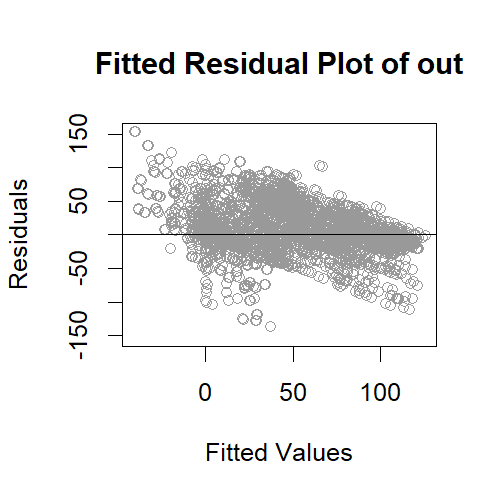

**Private Information, Seller**


Dynamic linear panel estimation (twostep)
Estimation steps: 2

Coefficients:
       Estimate Std.Err.rob z-value.rob Pr(>|z.rob|)   
L1.bid  -0.3324      0.3039      -1.094      0.27395   
L0.1     0.5214      0.1639       3.180      0.00147 **
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

 562 total instruments are employed to estimate 2 parameters
 561 linear (DIF) 
 1 further controls (LEV) 
 no time dummies 
 
J-Test (overid restrictions):  90.57 with 560 DF, pvalue: 1
F-Statistic (slope coeff):  18.41 with 2 DF, pvalue: <0.001
F-Statistic (time dummies):  no time dummies included in estimation



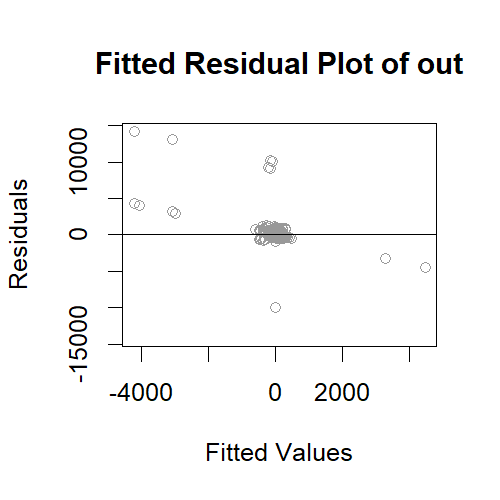

**Black Box, Buyer**


Dynamic linear panel estimation (twostep)
Estimation steps: 2

Coefficients:
       Estimate Std.Err.rob z-value.rob Pr(>|z.rob|)    
L1.bid  0.60211     0.18032       3.339      0.00084 ***
L0.1    0.10901     0.03211       3.395      0.00069 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

 211 total instruments are employed to estimate 2 parameters
 210 linear (DIF) 
 1 further controls (LEV) 
 no time dummies 
 
J-Test (overid restrictions):  55.96 with 209 DF, pvalue: 1
F-Statistic (slope coeff):  855.1 with 2 DF, pvalue: <0.001
F-Statistic (time dummies):  no time dummies included in estimation



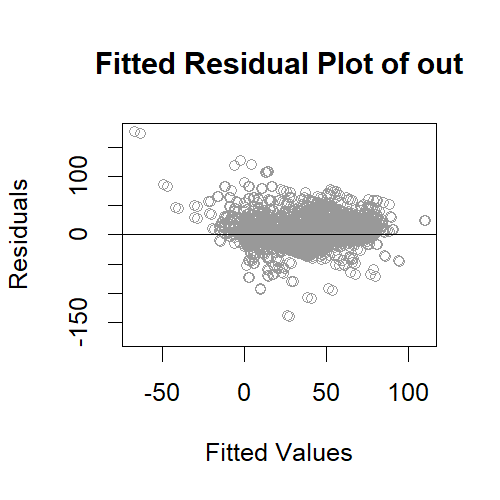

**Black Box, Seller**


Dynamic linear panel estimation (twostep)
Estimation steps: 2

Coefficients:
       Estimate Std.Err.rob z-value.rob Pr(>|z.rob|)    
L1.bid   0.5898      0.1554       3.796      0.00015 ***
L0.1     1.5993      1.8767       0.852      0.39421    
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

 92 total instruments are employed to estimate 2 parameters
 91 linear (DIF) 
 1 further controls (LEV) 
 no time dummies 
 
J-Test (overid restrictions):  12.22 with 90 DF, pvalue: 1
F-Statistic (slope coeff):  23.45 with 2 DF, pvalue: <0.001
F-Statistic (time dummies):  no time dummies included in estimation



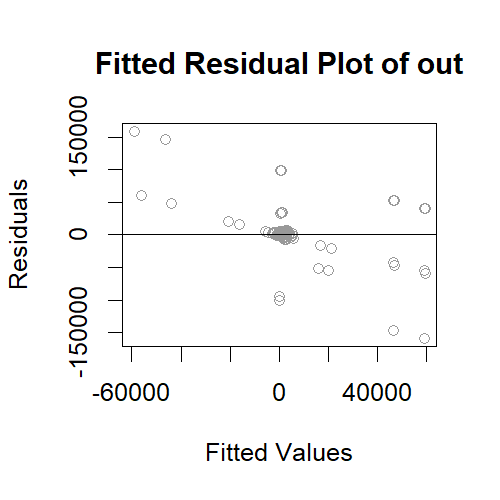

In [146]:
for (BB_mask, side), data in df_lags[df_lags['round'] <= 1].groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))
    
    # Prepare data
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()
    # Replace time steps with consecutive integers
    data['step'] = data.groupby(['treatment', 'game', 'round', 'id'])['time'].cumcount()
#     # Only take the last bid when two bids were submitted at the same time
#     data = data.groupby(['treatment','game','round','id','time']).tail(1)
#     data = data.dropna(subset=['bid-1'], axis=1)

    # Export data to R
    robjects.globalenv['rdf'] = data
   
    _ = r('''out <- pdynmc(dat = rdf, varname.i = "group", varname.t = "step", 
             use.mc.diff = TRUE, use.mc.lev = FALSE, use.mc.nonlin = FALSE,
             include.y = TRUE, varname.y = "bid", lagTerms.y = 1,
             varname.reg.fur = c(1), lagTerms.reg.fur = c(0),
             fur.con = TRUE, fur.con.diff = FALSE, fur.con.lev = TRUE,
             w.mat = "iid.err", w.mat.stata = TRUE, inst.stata = TRUE,
             std.err = "corrected", estimation = "twostep", opt.meth = "none")''')
    print(r('summary(out)'))
    
    with r_inline_plot(width=500, height=500, dpi=150):
        _ = r('plot(out)')

**Private Information, Buyer**


Dynamic linear panel estimation (twostep)
Estimation steps: 2

Coefficients:
              Estimate Std.Err.rob z-value.rob Pr(>|z.rob|)    
L1.reldemand 7.101e-01   1.194e-01       5.948       <2e-16 ***
L0.1         3.066e-05   1.335e-04       0.230        0.818    
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

 652 total instruments are employed to estimate 2 parameters
 325 linear (DIF) 325 linear (LEV) 
 1 further controls (DIF) 1 further controls (LEV) 
 no time dummies 
 
J-Test (overid restrictions):  52.81 with 650 DF, pvalue: 1
F-Statistic (slope coeff):  1295.12 with 2 DF, pvalue: <0.001
F-Statistic (time dummies):  no time dummies included in estimation



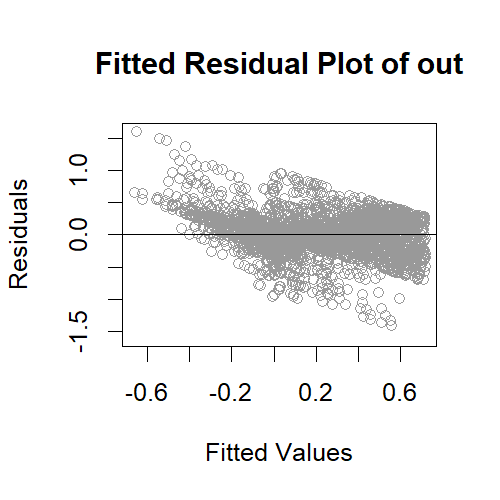

**Private Information, Seller**


Dynamic linear panel estimation (twostep)
Estimation steps: 2

Coefficients:
              Estimate Std.Err.rob z-value.rob Pr(>|z.rob|)    
L1.reldemand 0.5814766   0.0867252       6.705       <2e-16 ***
L0.1         0.0000767   0.0001259       0.609        0.543    
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

 1124 total instruments are employed to estimate 2 parameters
 561 linear (DIF) 561 linear (LEV) 
 1 further controls (DIF) 1 further controls (LEV) 
 no time dummies 
 
J-Test (overid restrictions):  15.65 with 1122 DF, pvalue: 1
F-Statistic (slope coeff):  146.32 with 2 DF, pvalue: <0.001
F-Statistic (time dummies):  no time dummies included in estimation



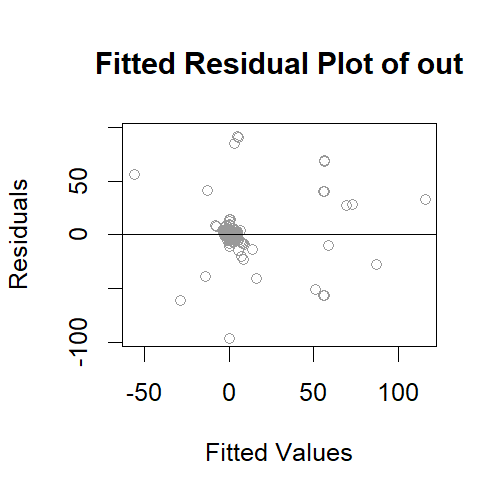

**Black Box, Buyer**


Dynamic linear panel estimation (twostep)
Estimation steps: 2

Coefficients:
               Estimate Std.Err.rob z-value.rob Pr(>|z.rob|)    
L1.reldemand  9.028e-01   6.292e-02      14.348       <2e-16 ***
L0.1         -4.933e-05   1.924e-04      -0.256        0.798    
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

 422 total instruments are employed to estimate 2 parameters
 210 linear (DIF) 210 linear (LEV) 
 1 further controls (DIF) 1 further controls (LEV) 
 no time dummies 
 
J-Test (overid restrictions):  18.64 with 420 DF, pvalue: 1
F-Statistic (slope coeff):  4170.35 with 2 DF, pvalue: <0.001
F-Statistic (time dummies):  no time dummies included in estimation



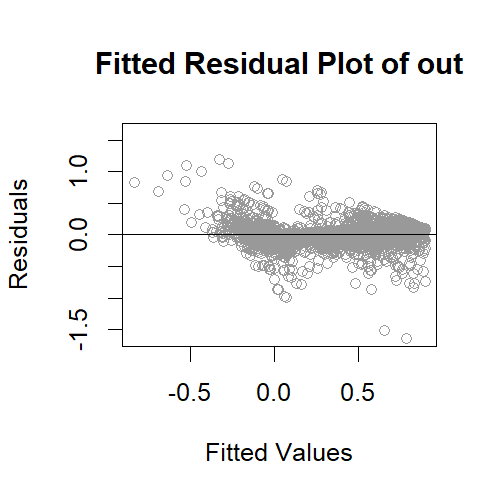

**Black Box, Seller**


Dynamic linear panel estimation (twostep)
Estimation steps: 2

Coefficients:
             Estimate Std.Err.rob z-value.rob Pr(>|z.rob|)    
L1.reldemand 0.145689    0.019236       7.574       <2e-16 ***
L0.1         0.005952    0.004230       1.407        0.159    
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

 184 total instruments are employed to estimate 2 parameters
 91 linear (DIF) 91 linear (LEV) 
 1 further controls (DIF) 1 further controls (LEV) 
 no time dummies 
 
J-Test (overid restrictions):  4.95 with 182 DF, pvalue: 1
F-Statistic (slope coeff):  59.11 with 2 DF, pvalue: <0.001
F-Statistic (time dummies):  no time dummies included in estimation



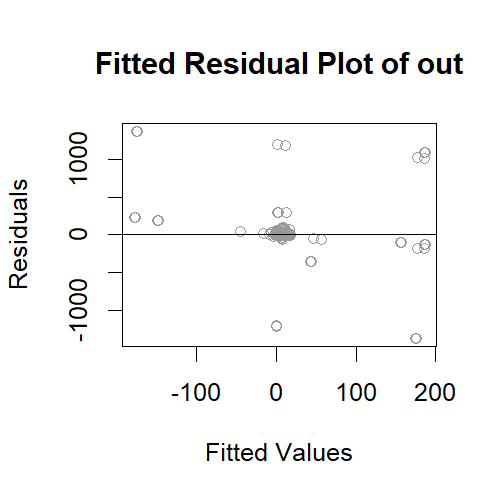

In [147]:
for (BB_mask, side), data in df_lags[df_lags['round'] <= 1].groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))
    
    # Prepare data
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()
    # Replace time steps with consecutive integers
    data['step'] = data.groupby(['treatment', 'game', 'round', 'id'])['time'].cumcount()
#     # Only take the last relative demand when two relative demands were submitted at the same time
#     data = data.groupby(['treatment','game','round','id','time']).tail(1)
#     data = data.dropna(subset=['reldemand-1'], axis=1)

    # Export data to R
    robjects.globalenv['rdf'] = data
   
    _ = r('''out <- pdynmc(dat = rdf, varname.i = "group", varname.t = "step", 
             use.mc.diff = TRUE, use.mc.lev = TRUE, use.mc.nonlin = FALSE,
             include.y = TRUE, varname.y = "reldemand", lagTerms.y = 1,
             varname.reg.fur = c(1), lagTerms.reg.fur = c(0),
             fur.con = TRUE, fur.con.diff = TRUE, fur.con.lev = TRUE,
             w.mat = "iid.err", w.mat.stata = TRUE, inst.stata = TRUE,
             std.err = "corrected", estimation = "twostep", opt.meth = "none")''')
    print(r('summary(out)'))
    
    with r_inline_plot(width=500, height=500, dpi=150):
        _ = r('plot(out)')

In [148]:
for (BB_mask, side), data in df_lags[df_lags['round'] <= 5].groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))
    
    # Prepare data
    # Consider each subject-round as a different cluster
    data['group'] = data.groupby(['treatment','game','round','id']).ngroup()
    # Replace time steps with consecutive integers
    data['step'] = data.groupby(['treatment', 'game', 'round', 'id'])['time'].cumcount()
#     # Only take the last bid when two bids were submitted at the same time
#     data = data.groupby(['treatment','game','round','id','time']).tail(1)
#     data = data.dropna(subset=['bid-1'], axis=1)

    # Export data to R
    robjects.globalenv['rdf'] = data
   
    _ = r('''out <- pvargmm(data = rdf, dependent_vars = c("reldemand"),
              lags = 1,
              transformation = "fod",
              panel_identifier = c("group", "step"),
              steps = c("twostep"),
              system_instruments = TRUE,
              system_constant = TRUE,
              max_instr_dependent_vars = 5,
              collapse = TRUE,
              progressbar = FALSE)''')
    print(r('summary(out)'))

**Private Information, Buyer**

---------------------------------------------------
Dynamic Panel VAR estimation, two-step GMM 
---------------------------------------------------
Transformation: Forward orthogonal deviations 
Group variable: group 
Time variable: step 
Number of observations = 7871 
Number of groups = 2438 
Obs per group: min = 0 
               avg = 3.228466 
               max = 48 
Number of instruments = 6 

                reldemand  
---------------------------
lag1_reldemand   0.6358 ***
                (0.0375)   
const            0.0644 ***
                (0.0112)   
*** p < 0.001; ** p < 0.01; * p < 0.05

---------------------------------------------------
Instruments for  equation
 Standard
  
 GMM-type
  Dependent vars: L(2, 5)
  Collapse =  TRUE 
---------------------------------------------------

Hansen test of overid. restrictions: chi2(4) = 81.53 Prob > chi2 = 0
(Robust, but weakened by many instruments.)


**Private Information, Seller**

---------------------------------------------------
Dynamic Panel VAR estimation, two-step GMM 
---------------------------------------------------
Transformation: Forward orthogonal deviations 
Group variable: group 
Time variable: step 
Number of observations = 8107 
Number of groups = 2487 
Obs per group: min = 0 
               avg = 3.259751 
               max = 41 
Number of instruments = 6 

                reldemand  
---------------------------
lag1_reldemand   0.0320    
                (0.0447)   
const            0.5874 ***
                (0.1076)   
*** p < 0.001; ** p < 0.01; * p < 0.05

---------------------------------------------------
Instruments for  equation
 Standard
  
 GMM-type
  Dependent vars: L(2, 5)
  Collapse =  TRUE 
---------------------------------------------------

Hansen test of overid. restrictions: chi2(4) = 6.11 Prob > chi2 = 0.191
(Robust, but weakened by many instruments.)


**Black Box, Buyer**

---------------------------------------------------
Dynamic Panel VAR estimation, two-step GMM 
---------------------------------------------------
Transformation: Forward orthogonal deviations 
Group variable: group 
Time variable: step 
Number of observations = 4417 
Number of groups = 1652 
Obs per group: min = 0 
               avg = 2.673729 
               max = 30 
Number of instruments = 6 

                reldemand  
---------------------------
lag1_reldemand   0.9082 ***
                (0.0247)   
const           -0.0107    
                (0.0115)   
*** p < 0.001; ** p < 0.01; * p < 0.05

---------------------------------------------------
Instruments for  equation
 Standard
  
 GMM-type
  Dependent vars: L(2, 5)
  Collapse =  TRUE 
---------------------------------------------------

Hansen test of overid. restrictions: chi2(4) = 21.85 Prob > chi2 = 0
(Robust, but weakened by many instruments.)


**Black Box, Seller**

---------------------------------------------------
Dynamic Panel VAR estimation, two-step GMM 
---------------------------------------------------
Transformation: Forward orthogonal deviations 
Group variable: group 
Time variable: step 
Number of observations = 4869 
Number of groups = 1660 
Obs per group: min = 0 
               avg = 2.933133 
               max = 39 
Number of instruments = 6 

                reldemand 
--------------------------
lag1_reldemand  -0.2780   
                (0.1943)  
const            5.8534 **
                (2.0993)  
*** p < 0.001; ** p < 0.01; * p < 0.05

---------------------------------------------------
Instruments for  equation
 Standard
  
 GMM-type
  Dependent vars: L(2, 5)
  Collapse =  TRUE 
---------------------------------------------------

Hansen test of overid. restrictions: chi2(4) = 3.93 Prob > chi2 = 0.416
(Robust, but weakened by many instruments.)


#### Time-series regression

**Private Information, Buyer**


Time series regression with "zoo" data:
Start = 6, End = 23920

Call:
dynlm(formula = bid ~ bidLag, data = rdf)

Residuals:
     Min       1Q   Median       3Q      Max 
-115.289   -3.543    0.349    4.530  123.320 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 29.571635   0.428153   69.07   <2e-16 ***
bidLag       0.710795   0.004574  155.40   <2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Residual standard error: 17.5 on 19096 degrees of freedom
  (3865 observations deleted due to missingness)
Multiple R-squared:  0.5584,	Adjusted R-squared:  0.5584 
F-statistic: 2.415e+04 on 1 and 19096 DF,  p-value: < 2.2e-16




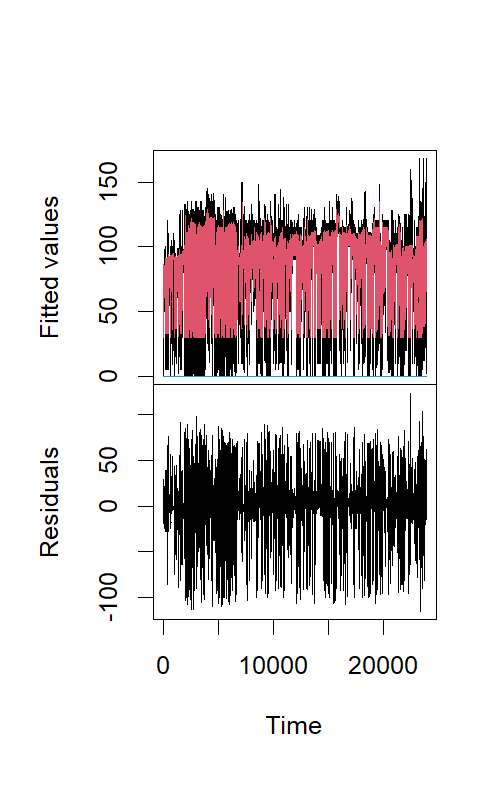

**Private Information, Seller**


Time series regression with "zoo" data:
Start = 12, End = 25263

Call:
dynlm(formula = bid ~ bidLag, data = rdf)

Residuals:
   Min     1Q Median     3Q    Max 
-12637    -55    -45    -38  99841 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 1.444e+02  9.270e+00   15.58   <2e-16 ***
bidLag      1.270e-01  8.252e-03   15.39   <2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Residual standard error: 1307 on 20324 degrees of freedom
  (3982 observations deleted due to missingness)
Multiple R-squared:  0.01152,	Adjusted R-squared:  0.01148 
F-statistic: 236.9 on 1 and 20324 DF,  p-value: < 2.2e-16




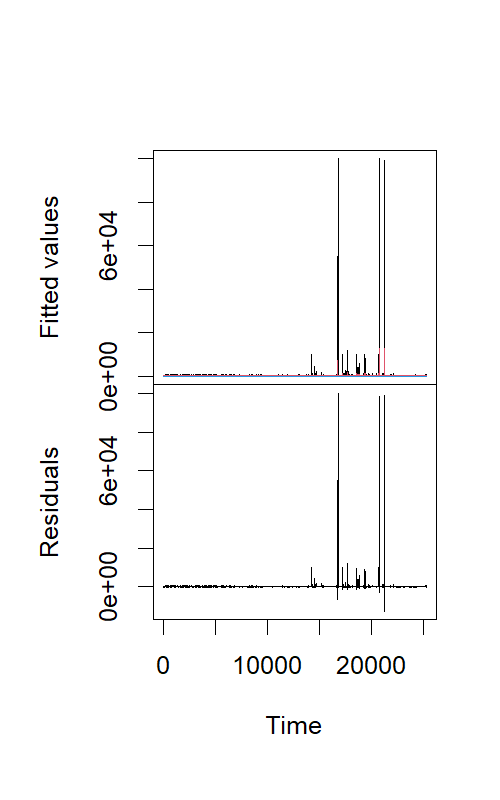

**Black Box, Buyer**


Time series regression with "zoo" data:
Start = 4, End = 18698

Call:
dynlm(formula = bid ~ bidLag, data = rdf)

Residuals:
     Min       1Q   Median       3Q      Max 
-120.143   -3.272    0.252    4.062  127.931 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 15.756631   0.352563   44.69   <2e-16 ***
bidLag       0.862397   0.004109  209.89   <2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Residual standard error: 16 on 14022 degrees of freedom
  (3773 observations deleted due to missingness)
Multiple R-squared:  0.7586,	Adjusted R-squared:  0.7585 
F-statistic: 4.406e+04 on 1 and 14022 DF,  p-value: < 2.2e-16




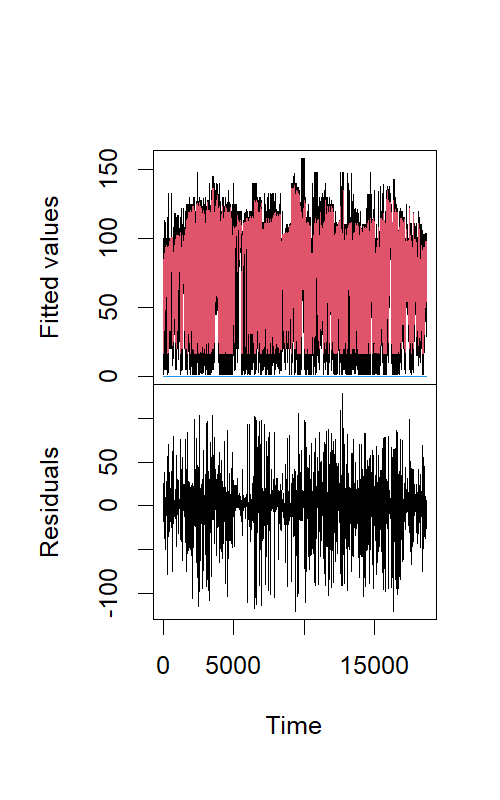

**Black Box, Seller**


Time series regression with "zoo" data:
Start = 18, End = 18505

Call:
dynlm(formula = bid ~ bidLag, data = rdf)

Residuals:
   Min     1Q Median     3Q    Max 
-77707    -98    -94    -90  99802 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 1.182e+02  3.318e+01   3.561 0.000371 ***
bidLag      7.769e-01  4.982e-03 155.941  < 2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Residual standard error: 3900 on 13945 degrees of freedom
  (3672 observations deleted due to missingness)
Multiple R-squared:  0.6355,	Adjusted R-squared:  0.6355 
F-statistic: 2.432e+04 on 1 and 13945 DF,  p-value: < 2.2e-16




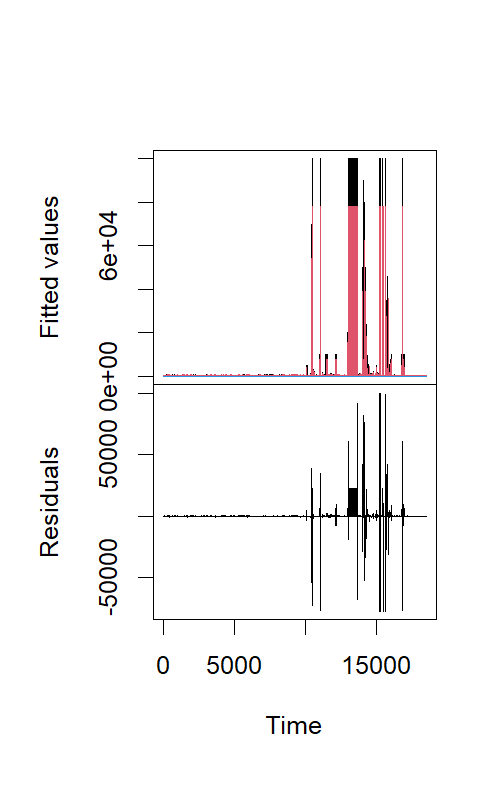

In [149]:
for (BB_mask, side), data in df_lags.groupby(['BB', 'side']):
    printmd('**{}, {}**'.format('Black Box' if BB_mask else 'Private Information', side))

    data.rename({'bid-1': 'bidLag'}, axis=1, inplace=True)
    # Export data to R
    robjects.globalenv['rdf'] = data
    
    _ = r('res <- dynlm(bid ~ bidLag, data = rdf)')
    print(r('summary(res)'))
    
    with r_inline_plot(width=500, height=800, dpi=150):
        _ = r('plot(merge(as.zoo(rdf[,"bid"]), fitted(res), 0, residuals(res)), screens = rep(1:2, c(3, 3)), col = rep(c(1, 2, 4), 2), xlab = "Time", ylab = c("Fitted values", "Residuals"), main = "")')
        _ = r('legend(0.05, 0.95, c("observed", "res"), col = c(1, 2, 4), lty = 1, bty = "n")')

### Buyers versus sellers

In [152]:
def adjustment_comparison(quantity):
    fig, axes = plt.subplots(1,2, figsize=(10,2.5), sharex=True, sharey=True, constrained_layout=True)

    df_10_rounds = df[(df['round'] <= 10)].copy()
    df_10_rounds.dropna(subset=[quantity], inplace=True)
    df_10_rounds['BB'] = df_10_rounds['treatment'].str.contains('BB')

    for BB_flag, data in df_10_rounds.groupby('BB'):
        ax = axes[int(BB_flag)]
        _ = ax.set_title(r'\textbf{Black Box}' if BB_flag else r'\textbf{Private Information}')

        _ = sns.boxplot(x='round', y=quantity, data=data, hue='side', hue_order=['Seller', 'Buyer'],
                         palette=side_colours, width=0.8, showfliers=False, linewidth=1, ax=ax)

        for side, df_side in data.groupby('side'):
            if side == 'Buyer':
                offset = min(data['round']) - 0.2
                zorder = 100
            else:
                offset = min(data['round']) + 0.2
                zorder = 50

            _ = sns.lineplot(x=data['round']-offset, y=quantity, data=df_side, estimator=np.median, ci=95,
                             color=side_colours[side], style='side', markers=True, zorder=zorder,
                             **{'markersize': 10, 'linewidth': 3}, ax=ax)

        for i, artist in enumerate(ax.artists):
            *rgb, alpha = artist.get_facecolor()
            artist.set_facecolor((*rgb, 0.3))
            artist.set_edgecolor((*rgb, alpha))

            for j in range(i*5,i*5+5):
                line = ax.lines[j]
                line.set_color((*rgb, alpha))
                line.set_mfc((*rgb, alpha))
                line.set_mec((*rgb, alpha))

        _ = ax.set_xlabel('')
        _ = ax.set_ylabel('')
        _ = ax.set_ylim((-0.2,0.2))

    handles = []
    labels = []

    for side in ['Seller', 'Buyer']:
        handles.append(Patch(facecolor=side_colours[side], alpha=0.3))
        labels.append('{}s'.format(side))

        _ = axes[0].legend(handles, labels, loc=4)
    _ = axes[1].get_legend().remove()
    
    return axes

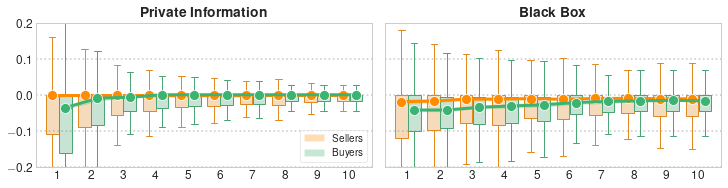

In [153]:
axes = adjustment_comparison('adjWithin')
_ = plt.savefig('Figures/adjustments_within_buyers_sellers.pdf', bbox_inches='tight', transparent=True)

## Between-round bid/ask adjustments

\begin{equation*}
    \delta_l^T := 
    \begin{cases}
        \frac{\bval{l} - \bbid{l}{1, T}}{\bval{i}} - \frac{\bval{l} - \bbid{l}{1, T - 1}}{\bval{l}}, & b_l \in B \\
        \frac{\sbid{l}{1, T} - \sval{l}}{\sval{l}} - \frac{\sbid{l}{1, T - 1} - \sval{l}}{\sval{l}}, & s_l \in S
    \end{cases}
\end{equation*}

In [154]:
# Extract, for each round separately, each player's first bid
firstBid_indices = df.groupby(['treatment', 'game', 'round', 'id'])['time'].idxmin().values
df['first_bid'] = df.index.isin(firstBid_indices)

# Between-round adjustments
df.loc[firstBid_indices, 'adjBetween'] = df.loc[firstBid_indices].groupby(['treatment', 'game', 'id'])['reldemand'].diff()
# Discard adjustments between non-consecutive rounds
player_histories = df.groupby(['treatment', 'game', 'id'], as_index=False)
nonConsecutive = lambda row: (row['round'] != row['round'].shift() + 1) & (row['first_bid'])
df.loc[player_histories.apply(nonConsecutive).reset_index(level=0, drop=True), 'adjBetween'] = np.nan

# Determine whether the previous round resulted in a deal
deal_previous_round = lambda row: (row['round'] == row['round'].shift() + 1) & (row['price'].shift().notna())
df['dealPreviousRound'] = player_histories.apply(deal_previous_round).reset_index(level=0, drop=True)

In [155]:
def betweenRound_adjustments(data, ax, title=None):    
    with sns.axes_style('white'):
        fig = sns.boxplot(x='side', y='adjBetween', hue='dealPreviousRound',
                          data=data, width=0.6, notch=False, orient="v", showfliers=False,
                          order=['Seller', 'Buyer'], hue_order=[False, True], ax=ax)
    
        if title == None:
             title = emphasise_text(treatment_names[treatment], separator=', ', part=bold_title_part).replace(',', ',\n')
        _ = ax.set_title(title, fontsize=10, y=0.8)

        _ = ax.axhline(y=0, linestyle='dashed', color='gray', zorder=0, alpha=0.7, linewidth=2)

        xlabels = ax.get_xticklabels()
        _ = ax.set_xticklabels(['{}s'.format(side.get_text()) for side in xlabels])
        _ = ax.set_xlabel('')

        _ = ax.set(ylim=(-0.5, 0.5))
        _ = ax.set_ylabel('')
        #_ = ax.legend_.remove()
        _ = ax.legend().set_visible(False)

        # Boxplot style
        for j, artist in enumerate(ax.artists):
            if j % 2 == 0:
                _ = artist.set_hatch('//')
                _ = artist.set(alpha=0.7)

                for k in range(5*j, 5*j+5):
                    line = ax.lines[k]
                    _ = line.set(alpha=0.7)

            if j <= 1:
                _ = artist.set_facecolor(side_colours['Seller'])
            else:
                _ = artist.set_facecolor(side_colours['Buyer'])

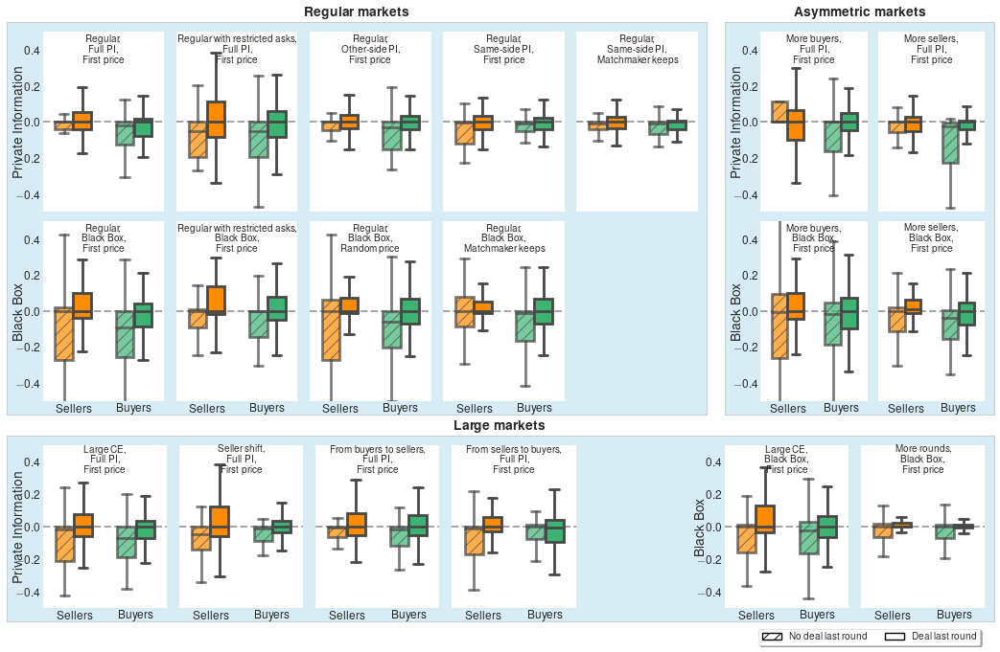

In [156]:
fig = plt.figure(figsize=(13,5))

subplot_layouts = {'Regular markets': (2,5), 'Asymmetric markets': (2,2), 'Large markets': (1,7)}

bottom = [1,1,0]
top = [3,3,1]
left = [0,1,0]
right = [1,1.4,1.4]

for i, (title, gs_size) in enumerate(subplot_layouts.items()):
    # Outer frame
    outer_gs = plt.GridSpec(1,1)
    outer_gs.update(bottom=bottom[i]*0.6+0.01, left=left[i]*0.8+0.01,
                    top=top[i]*0.6-0.05,  right=right[i]*0.8-0.01)
    outer_ax = fig.add_subplot(outer_gs[0])
    
    _ = outer_ax.set_title(r'\textbf{{{}}}'.format(title))
    outer_ax.tick_params(axis='both', which='both', bottom=0, left=0, labelbottom=0, labelleft=0)
    outer_ax.set_facecolor('#7cc3df')
    outer_ax.patch.set_alpha(0.3)

    # Inner frames
    gs = plt.GridSpec(*gs_size)
    gs.update(bottom=bottom[i]*0.6+0.05, left=left[i]*0.8+0.05, 
              top=top[i]*0.6-0.08,  right=right[i]*0.8-0.02,
              wspace=0.1, hspace=0.05)
    
    treatments = [vals for key, vals in treatment_groups.items() if key[0] == title]
    
    for k, treatment in enumerate(flatten_list(treatments)):
        if k == 0:
            ax0 = ax = fig.add_subplot(gs[k])
        else:
            if (title == 'Large markets') & (k >= 4):
                k += 1

            ax = fig.add_subplot(gs[k], sharey=ax0)
            
        ax_title = treatment_names[treatment].replace(',', ',\n')
        betweenRound_adjustments(df[df['treatment'] == treatment], ax, title=ax_title)
        _ = ax.set_ylabel('Black Box' if ax_title.split(',\n ')[1] == 'Black Box' else 'Private Information', labelpad=-10)
        
        for side in ['top', 'bottom', 'left', 'right']:
            _ = ax.spines[side].set_visible(False)

axes = plt.gcf().axes
            
for ax in axes:
    if ax.get_title() != 'Large CE,\n Black Box,\n First price':
        try:
            ax.label_outer()
        except:
            pass
    _ = ax.grid(False)

handles = {}
newhandles = []

for legpatch in axes[-1].get_legend().get_patches():
    legpatch.set_edgecolor('black')
    legpatch.set_facecolor('None')
    
    if legpatch.get_label() == 'False':
        legpatch.set_hatch('//')
        l = 'No deal last round'
    else:
        l = 'Deal last round'
        
    legpatch.set_label(l)
    handles[l] = legpatch
    newhandles.append(legpatch) 

_ = axes[-1].legend(handles=newhandles, shadow=True, fancybox=True, ncol=2, bbox_to_anchor=(1,-0.1))
        
_ = plt.savefig('Figures/BetweenAdj.pdf', bbox_inches='tight')

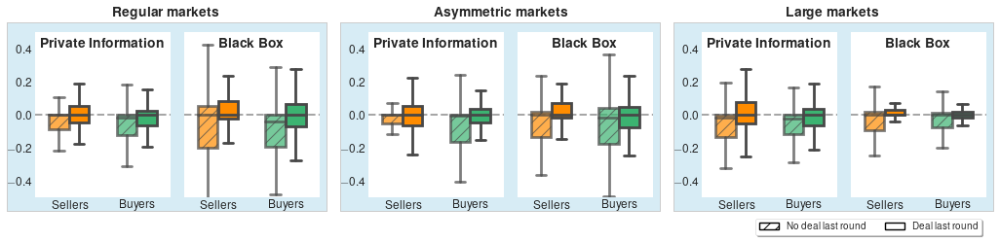

In [157]:
fig = plt.figure(figsize=(10,5))

subplot_layouts = {'Regular markets': (1,2), 'Asymmetric markets': (1,2), 'Large markets': (1,2)}

bottom = [0,0,0]
top = [1,1,1]
left = [0,0.5,1]
right = [0.5,1,1.5]

for i, (title, gs_size) in enumerate(subplot_layouts.items()):
    # Outer frame
    outer_gs = plt.GridSpec(1,1)
    outer_gs.update(bottom=bottom[i]*0.6+0.01, left=left[i]*0.95+0.01,
                    top=top[i]*0.6-0.05,  right=right[i]*0.95-0.01)
    outer_ax = fig.add_subplot(outer_gs[0])
    
    _ = outer_ax.set_title(r'\textbf{{{}}}'.format(title))
    outer_ax.tick_params(axis='both', which='both', bottom=0, left=0, labelbottom=0, labelleft=0)
    outer_ax.set_facecolor('#7cc3df')
    outer_ax.patch.set_alpha(0.3)

    # Inner frames
    gs = plt.GridSpec(*gs_size)
    gs.update(bottom=bottom[i]*0.6+0.05, left=left[i]*0.95+0.05, 
              top=top[i]*0.6-0.08,  right=right[i]*0.95-0.02,
              wspace=0.1, hspace=0.05)
    
    treatments = [(key[1], vals) for key, vals in treatment_groups.items() if key[0] == title]
    
    for k, (feedback, treatment_group) in enumerate(treatments):
        if k == 0:
            ax0 = ax = fig.add_subplot(gs[k])
        else:
            ax = fig.add_subplot(gs[k], sharey=ax0)
            
        betweenRound_adjustments(df[df['treatment'].isin(treatment_group)], ax)
        _ = ax.set_title(r'\textbf{{{}}}'.format(feedback), y=0.88)
        
        for side in ['top', 'bottom', 'left', 'right']:
            _ = ax.spines[side].set_visible(False)

axes = plt.gcf().axes

for ax in axes:
    try:
        ax.label_outer()
    except:
        pass
    _ = ax.grid(False)

handles = {}
newhandles = []

for legpatch in axes[-1].get_legend().get_patches():
    legpatch.set_edgecolor('black')
    legpatch.set_facecolor('None')
    
    if legpatch.get_label() == 'False':
        legpatch.set_hatch('//')
        l = 'No deal last round'
    else:
        l = 'Deal last round'
        
    legpatch.set_label(l)
    handles[l] = legpatch
    newhandles.append(legpatch) 

_ = axes[-1].legend(handles=newhandles, shadow=True, fancybox=True, ncol=2, bbox_to_anchor=(1,-0.1))
_ = plt.savefig('Figures/BetweenAdjGroups.pdf', bbox_inches='tight')

In [158]:
def between_round_adjustments_add_row(idx, df, df_results):
    for side, df_side in df.dropna(subset=['adjBetween']).groupby(['side']):
        for deal_flag, df_deal in df_side.groupby(['dealPreviousRound']):
            deal = 'After deal' if deal_flag else 'After no deal'
            df_results.loc[idx, ('Median between-round bid/ask adjustment', '{}s'.format(side), deal)] = df_deal['adjBetween'].median()

            n_all = df_deal['adjBetween'].count()
            df_results.loc[idx, ('Sample size', '{}s'.format(side), deal)] = n_all
    
        after_deal = df_side[df_side['dealPreviousRound']]['adjBetween']
        after_no_deal = df_side[~df_side['dealPreviousRound']]['adjBetween']
        
        U, p = stats.mannwhitneyu(after_no_deal, after_deal)
        df_results.loc[idx, ('Median between-round bid/ask adjustment', '{}s'.format(side), '$p$-value (MWW)')] = p
        df_results.loc[idx, ('Median between-round bid/ask adjustment', '{}s'.format(side), 'P(X > Y) (MWW)')] = U/(len(after_no_deal)*len(after_deal))

In [159]:
PI_treatment_groups = {key: value for key, value in treatment_groups.items() if key[1] == 'Private Information'}
BB_treatment_groups = {key: value for key, value in treatment_groups.items() if key[1] == 'Black Box'}

index_list = []

for idx, groups in enumerate([PI_treatment_groups, BB_treatment_groups]):
    if idx == 0:
        index_list.append(('Private Information', '', ''))
    else:
        index_list.append(('Black Box', '', ''))
        
    for key, treatments in groups.items():
        index_list.append((key[1], key[0], ''))

        for treatment in treatments:
            name = treatment_names[treatment]
            name = name.split(', ')
            index_list.append((name[1], name[0], name[2]))

index_list.append(('', '', ''))
        
index = pd.MultiIndex.from_tuples(index_list, names=['Feedback', 'Market structure', 'Price rule'])
dtypes = {('Median between-round bid/ask adjustment', 'Buyers', 'After no deal'): float,  ('Median between-round bid/ask adjustment', 'Buyers', 'After deal'): float, 
          ('Median between-round bid/ask adjustment', 'Buyers', '$p$-value (MWW)'): float,
          ('Median between-round bid/ask adjustment', 'Buyers', 'P(X > Y) (MWW)'): float,
          ('Median between-round bid/ask adjustment', 'Sellers', 'After no deal'): float,  ('Median between-round bid/ask adjustment', 'Sellers', 'After deal'): float, 
          ('Median between-round bid/ask adjustment', 'Sellers', '$p$-value (MWW)'): float,          
          ('Median between-round bid/ask adjustment', 'Sellers', 'P(X > Y) (MWW)'): float,
          ('Sample size', 'Buyers', 'After no deal'): int, ('Sample size', 'Buyers', 'After deal'): int,
          ('Sample size', 'Sellers', 'After no deal'): int, ('Sample size', 'Sellers', 'After deal'): int}
columns = pd.MultiIndex.from_tuples(dtypes.keys())
df_between_round_adjustments_all = pd.DataFrame(index=index, columns=columns, dtype=float)
df_between_round_adjustments_all.sort_index(inplace=True)

between_round_adjustments_add_row(('Black Box', '', ''), df[df['treatment'].str.contains('BB')], df_results=df_between_round_adjustments_all)
between_round_adjustments_add_row(('Private Information', '', ''), df[~df['treatment'].str.contains('BB')], df_results=df_between_round_adjustments_all)

for key, treatments in treatment_groups.items():
    between_round_adjustments_add_row((key[1], key[0], ''), df[df['treatment'].isin(treatments)], df_results=df_between_round_adjustments_all)
    
    for treatment in treatments:
        name = treatment_names[treatment]
        name = name.split(', ')
        
        between_round_adjustments_add_row((name[1], name[0], name[2]), df[df['treatment'] == treatment], df_results=df_between_round_adjustments_all)

between_round_adjustments_add_row(('', '', ''), df, df_results=df_between_round_adjustments_all)

In [160]:
df_between_round_adjustments_all = df_between_round_adjustments_all.astype(dtypes)
df_between_round_adjustments_all[('Median between-round bid/ask adjustment', 'Buyers', '$p$-value (MWW)')] = df_between_round_adjustments_all[('Median between-round bid/ask adjustment', 'Buyers', '$p$-value (MWW)')].apply(lambda p: r'$< 0.01$' if p < 0.01 else ('' if np.isnan(p) else r'$({})$'.format(np.round(p,2))))
df_between_round_adjustments_all[('Median between-round bid/ask adjustment', 'Sellers', '$p$-value (MWW)')] = df_between_round_adjustments_all[('Median between-round bid/ask adjustment', 'Sellers', '$p$-value (MWW)')].apply(lambda p: r'$< 0.01$' if p < 0.01 else ('' if np.isnan(p) else r'$({})$'.format(np.round(p,2))))
columns_round = {}

for key, val in dtypes.items():
    if val == float:
        columns_round[key] = 2

df_between_round_adjustments_all = df_between_round_adjustments_all.round(columns_round)

for side, deal in itertools.product(['Buyers', 'Sellers'], ['After no deal', 'After deal']):
    for idx, row in df_between_round_adjustments_all.iterrows():
        df_between_round_adjustments_all.loc[idx, ('Median between-round bid/ask adjustment', side, deal)] = '{} ({})'.format(row[('Median between-round bid/ask adjustment', side, deal)], row[('Sample size', side, deal)])
    
    df_between_round_adjustments_all.drop(('Sample size', side, deal), axis=1, inplace=True)

df_between_round_adjustments_all = df_between_round_adjustments_all.reindex(index_list)

print(df_between_round_adjustments_all.drop([('Median between-round bid/ask adjustment', 'Buyers', 'P(X > Y) (MWW)'), ('Median between-round bid/ask adjustment', 'Sellers', 'P(X > Y) (MWW)')], axis=1).to_latex(escape=False))

\begin{tabular}{lllllllll}
\toprule
          &             &             & \multicolumn{6}{l}{Median between-round bid/ask adjustment} \\
          &             &             & \multicolumn{3}{l}{Buyers} & \multicolumn{3}{l}{Sellers} \\
          &             &             &                           After no deal &   After deal & $p$-value (MWW) & After no deal &  After deal & $p$-value (MWW) \\
Feedback & Market structure & Price rule &                                         &              &                 &               &             &                 \\
\midrule
Private Information &             &             &                             -0.02 (973) &   0.0 (3292) &        $< 0.01$ &    0.0 (1080) &  0.0 (3296) &        $< 0.01$ \\
          & Regular markets &             &                             -0.02 (383) &   0.0 (1181) &        $< 0.01$ &     0.0 (241) &  0.0 (1175) &        $< 0.01$ \\
Full PI & Regular & First price &                              -0.02 (69) &    

In [161]:
df_between_round_adjustments_all

Median between-round bid/ask adjustment  \
                                                                                                   Buyers   
                                                                                            After no deal   
Feedback            Market structure             Price rule                                                 
Private Information                                                                           -0.02 (973)   
                    Regular markets                                                           -0.02 (383)   
Full PI             Regular                      First price                                   -0.02 (69)   
                    Regular with restricted asks First price                                   -0.05 (91)   
Other-side PI       Regular                      First price                                   -0.03 (59)   
Same-side PI        Regular                      First price                                   -0.01 (99)   
                                                 Matchmaker keeps                              -0.01 (65)   
Private Information Asymmetric markets                                                        -0.01 (404)   
Full PI             More buyers                  First price                                    0.0 (381)   
                    More sellers                 First price                                   -0.02 (23)   
Private Information Large markets                                                             -0.03 (186)   
Full PI             Large CE                     First price                                   -0.07 (62)   
                    Seller shift                 First price                                   -0.01 (41)   
                    From buyers to sellers       First price                                   -0.02 (40)   
                    From sellers to buyers       First price                                     0.0 (43)   
Black Box                                                                                    -0.01 (1632)   
                    Regular markets                                                           -0.04 (434)   
                    Regular                      First price                                   -0.09 (92)   
                    Regular with restricted asks First price                                     0.0 (72)   
                    Regular                      Random price                                 -0.06 (132)   
                                                 Matchmaker keeps                             -0.01 (138)   
                    Asymmetric markets                                                        -0.02 (448)   
                    More buyers                  First price                                  -0.02 (349)   
                    More sellers                 First price                                   -0.04 (99)   
                    Large markets                                                               0.0 (750)   
                    Large CE                     First price                                  -0.02 (112)   
                    More rounds                  First price                                    0.0 (638)   
                                                                                             -0.01 (2605)   

                                                                                \
                                                                                 
                                                                    After deal   
Feedback            Market structure             Price rule                      
Private Information                                                 0.0 (3292)   
                    Regular markets                                 0.0 (1181)   
Full PI             Regular                      First price         0.0 (248)   
   

### Buyers versus sellers

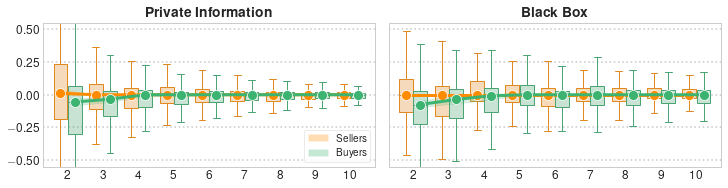

In [162]:
axes = adjustment_comparison('adjBetween')
_ = axes[0].set_ylim((-0.55,0.55))
_ = plt.savefig('Figures/adjustments_between_buyers_sellers.pdf', bbox_inches='tight', transparent=True)

## Airplane plots

Within- and between-round adjustments across rounds

In [163]:
def airplane_plot(df, treatment, game, subjects):
    fig, ax = plt.subplots(1,1,figsize=(15,3))
    
    df_game = df[(df['treatment'] == treatment) & (df['game'] == game)]
    
    rounds = np.arange(1,max(df[(df['treatment'] == treatment)]['round'])+1)
    time_elapsed = pd.Series((max(df_game['time'])+9)//10*10, index=rounds)
    time_elapsed = time_elapsed.expanding(1).sum()
    time_elapsed.loc[time_elapsed.first_valid_index() - 1] = 0
    time_elapsed.sort_index(inplace=True)
    time_steps = time_elapsed.rolling(2).mean().shift(-1)[:-1]

    # Add rounds in which no bids were submitted
    missing_rounds = pd.DataFrame({'round': [rnd for rnd in rounds if rnd not in rounds]}, columns=df_game.columns)
    df_game = df_game.merge(missing_rounds, how='outer').sort_values(['round','time'])
    
    _ = ax.set_xlabel('Round');
    _ = ax.set_ylabel('Bid/ask');
    _ = ax.set_xticks(ticks=time_steps)
    _ = ax.set_xticks(time_elapsed, minor=True)
    _ = ax.set_xlim(min(time_elapsed)-2, max(time_elapsed)+2)
    _ = ax.xaxis.grid(True, which='minor')
    _ = ax.xaxis.grid(False, which='major')
    _ = ax.set_xticklabels(rounds, size=12)
    
    df_game['time_elapsed'] = df_game.apply(lambda row: row['time'] + time_elapsed[row['round'] - 1], axis=1)
    
    for idx, dfi in df_game.groupby(['id']):
        if idx in subjects:
            colour = side_colours[dfi['side'].iloc[0]]
            kwargs = {'markersize': 12, 'linewidth': 3, 'zorder': 50}
            zorder = 100
            markersizes = {'*': 20, 's': 10}
        else:
            colour = 'lightgray'
            kwargs = {'markersize': 8, 'linewidth': 2, 'zorder': 0}
            zorder = 0
            markersizes = {'*': 12, 's': 6}
            
        for rnd, dfr in dfi.groupby(['round']):
            _ = ax.plot(dfr['time_elapsed'], dfr['bid'], color=colour, marker=".", **kwargs)
                        
            if not np.isnan(dfr['price'].iloc[-1]):
                marker = "*"
                _ = ax.plot(dfr['time_elapsed'].iloc[-1], dfr['bid'].iloc[-1], color=colour, 
                            marker=marker, markersize=markersizes[marker], zorder=zorder)
    
    legend_elements = []
    
    for side, colour in side_colours.items():
        legend_elements.append(Line2D([0], [0], marker='.', color=colour, markerfacecolor=colour,
                                      markersize=15, label=side))
        
    legend_elements.append(Line2D([0], [0], marker='*', markeredgecolor='gray', markerfacecolor='w', linestyle='None',
                                  markeredgewidth=1.5, markersize=13, label='Deal'))

    _ = ax.legend(handles=legend_elements, fontsize=10)

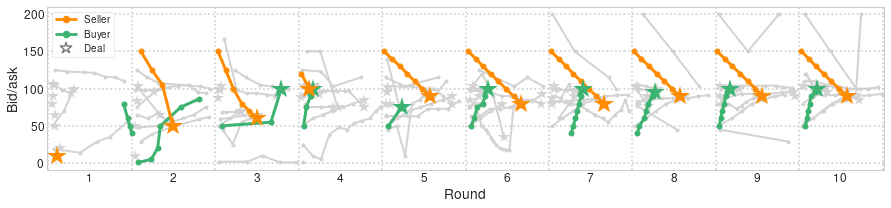

In [164]:
airplane_plot(df, 'BBLimS', 5, [218,227])
_ = plt.savefig('Figures/Airplane_plot.pdf', bbox_inches='tight', transparent=True)

**Rolling median bid/ask** (all markets taken into account; rolling window size: 100, minimum 5)

Only one bid was submitted at a time > 200; omitted in the figures below

In [165]:
df[df['time'] > 200]

,treatment,game,round,time,id,side,valuation,bid,price,match_id,...,type,status,demand,reldemand,initial_bid,rescaledBid,adjWithin,first_bid,adjBetween,dealPreviousRound
78413,BBLimS,2,4,262,184,Seller,93,200,NaN,NaN,...,Manual,Expired,107,1.150538,False,1.040816,NaN,True,0.0,False


In [166]:
def rolling_median(quantity, legend_loc, window_size=100, min_periods=5):
    fig, ax = plt.subplots(1,1, figsize=(15,3))

    data = df[(df['round'] <= 10) & (df['time'] <= 200)].copy()
    data['BB'] = data['treatment'].str.contains('BB')
    
    rounds = np.arange(1,11)
    time_elapsed = pd.Series((max(data['time'])+9)//10*10, index=rounds)
    time_elapsed = time_elapsed.expanding(1).sum()
    time_elapsed.loc[time_elapsed.first_valid_index() - 1] = 0
    time_elapsed.sort_index(inplace=True)
    time_steps = time_elapsed.rolling(2).mean().shift(-1)[:-1]

    _ = ax.set_xlabel('Round');
    _ = ax.set_ylabel('Rolling median');
    _ = ax.set_xticks(ticks=time_steps)
    _ = ax.set_xticks(time_elapsed, minor=True)
    _ = ax.set_xlim(min(time_elapsed)-2, max(time_elapsed)+2)
    _ = ax.xaxis.grid(True, which='minor')
    _ = ax.xaxis.grid(False, which='major')
    _ = ax.set_xticklabels(rounds, size=12)

    data['time_elapsed'] = data.apply(lambda row: row['time'] + time_elapsed[row['round'] - 1], axis=1)

    colours = {('Buyer', False): side_colours['Buyer'], ('Buyer', True): 'dodgerblue', ('Seller', False): side_colours['Seller'], ('Seller', True): 'crimson'}
    
    for rnd, df_round in data.groupby('round'):
#         df_round['rolling_median'] = df_round.sort_values('time_elapsed').groupby(['side'], as_index=False).rolling(window_size, min_periods=min_periods)[quantity].median().reset_index(level=0, drop=True)

        for (side, BB_flag), df_side in df_round.groupby(['side','BB']):
            df_side.sort_values('time_elapsed', inplace=True)
            df_side = df_side.reset_index()
            
            df_side['rolling_median'] = df_side[quantity].rolling(window_size, min_periods=min_periods).median()
            _ = sns.lineplot(x='time_elapsed', y='rolling_median', data=df_side, ax=ax, color=colours[side, BB_flag], ci=None, estimator=None, 
                             **{'linewidth': 1, 'alpha': 1})
    
    legend_elements = []

    for key, colour in colours.items():
        legend_elements.append(Line2D([0], [0], color=colour, label='{}s in {}'.format(key[0], 'Black Box' if key[1] else 'Private Information')))

    _ = ax.legend(handles=legend_elements, fontsize=10, loc=legend_loc)
    
    return ax

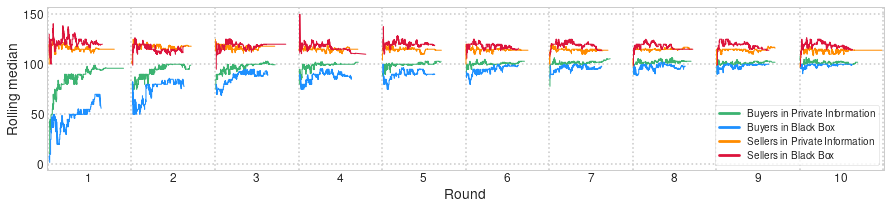

In [167]:
ax = rolling_median('bid', legend_loc=4)
_ = ax.set_yticks([k*50 for k in range(0,4)])

**Rolling absolute bid/ask distance to CE** (all markets taken into account; rolling window size: 100, minimum 5)

In [168]:
for (treatment, game, rnd), df_round in df.groupby(['treatment', 'game', 'round']):
    epr1, epr2 = EPR_rounds[treatment, game, rnd]
    
    for index, row in df_round.iterrows():
        bid = row['bid']
        
        if bid > epr2:
            DCE = bid - epr2
        elif bid < epr1:
            DCE = bid - epr1
        else:
            DCE = 0
        
        df.loc[index, 'DCE'] = DCE
        
df['absDCE'] = abs(df['DCE'])

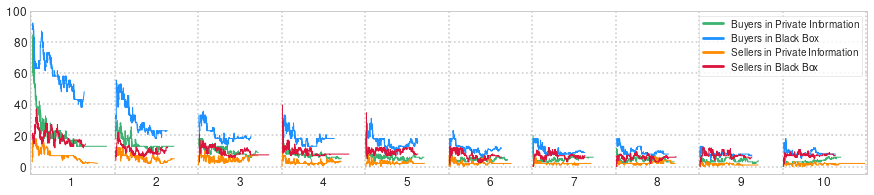

In [169]:
ax = rolling_median('absDCE', legend_loc=1)
_ = ax.set_xlabel('');
_ = ax.set_ylabel('');
_ = ax.set_yticks([k*20 for k in range(0,6)])
_ = plt.savefig('Figures/Rolling_median_DCE.pdf', bbox_inches='tight', transparent=True)

**LOWESS** curve fit to absolute bid/ask distance to CE

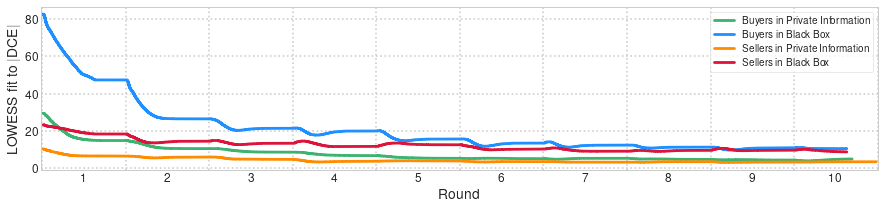

In [170]:
data = df[(df['round'] <= 10) & (df['time'] <= 200)].copy()
data['BB'] = data['treatment'].str.contains('BB')

fig, ax = plt.subplots(1,1, figsize=(15,3))

rounds = np.arange(1,11)
time_elapsed = pd.Series((max(data['time'])+9)//10*10, index=rounds)
time_elapsed = time_elapsed.expanding(1).sum()
time_elapsed.loc[time_elapsed.first_valid_index() - 1] = 0
time_elapsed.sort_index(inplace=True)
time_steps = time_elapsed.rolling(2).mean().shift(-1)[:-1]

_ = ax.set_xlabel('Round');
_ = ax.set_ylabel(r'LOWESS fit to $\lvert \mathrm{DCE} \rvert$');
_ = ax.set_xticks(ticks=time_steps)
_ = ax.set_xticks(time_elapsed, minor=True)
_ = ax.set_xlim(min(time_elapsed)-2, max(time_elapsed)+2)
_ = ax.xaxis.grid(True, which='minor')
_ = ax.xaxis.grid(False, which='major')
_ = ax.set_xticklabels(rounds, size=12)

data['time_elapsed'] = data.apply(lambda row: row['time'] + time_elapsed[row['round'] - 1], axis=1)

colours = {('Buyer', False): side_colours['Buyer'], ('Buyer', True): 'dodgerblue', ('Seller', False): side_colours['Seller'], ('Seller', True): 'crimson'}

for (side, BB_flag), df_side in data.groupby(['side', 'BB']):
    df_side.sort_values('time_elapsed', inplace=True)
    df_side['lowess'] = sm.nonparametric.lowess(df_side['absDCE'], np.arange(len(df_side['absDCE'])), frac=0.1)[:, 1]
    _ = sns.lineplot(x='time_elapsed', y='lowess', data=df_side, ax=ax, color=colours[side, BB_flag], ci=None, estimator=None)
    
legend_elements = []
    
for key, colour in colours.items():
    legend_elements.append(Line2D([0], [0], color=colour, label='{}s in {}'.format(key[0], 'Black Box' if key[1] else 'Private Information')))

_ = ax.legend(handles=legend_elements, fontsize=10, loc=1)

## Extra-marginal supply and demand

### Overall influence on prices

In [171]:
rows_list = []

for key, eq in eq_quantity_rounds.items():
    treatment, game, rnd = key
    vals = get_valuations(df[(df['treatment'] == treatment) & (df['game'] == game) & (df['round'] == rnd)])
    deals = df[(df['treatment'] == treatment) & (df['game'] == game) & (df['round'] == rnd) & (df['price'] == df['bid'])]
    CE_midpoint = np.mean(EPR_rounds[key])
    
    if 'MoreB' in treatment:
        structure = 'More buyers'
    elif 'MoreS' in treatment:
        structure = 'More sellers'
    else:
        structure = 'Regular and Large'
    
    for idx, row in deals.iterrows():
        row_dict = {'treatment': treatment, 'game': game, 'round': rnd, 'structure': structure,
                    'extraSupply': len(vals['Seller']) - eq, 'extraDemand': len(vals['Buyer']) - eq,
                    'price': row['price'], 'DCE': row['DCE'], 'match_time': row['match_time'], 'midCE': CE_midpoint}

        rows_list.append(row_dict)

df_extra = pd.DataFrame(rows_list)
df_extra['excDemand'] = df_extra['extraDemand'] - df_extra['extraSupply']

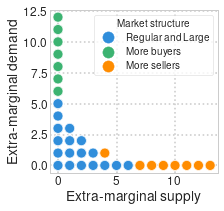

In [172]:
fig, ax = plt.subplots(1,1, figsize=(3,3))
_ = sns.scatterplot(x='extraSupply', y='extraDemand', data=df_extra, hue='structure', s=100, alpha=0.8,
                    palette=extraMarg_palette)
_ = ax.set_xlabel('Extra-marginal supply')
_ = ax.set_ylabel('Extra-marginal demand')
_ = ax.legend(title='Market structure')

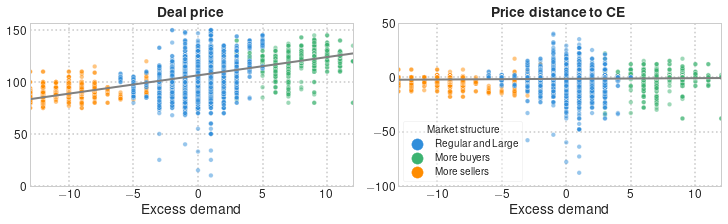

In [173]:
fig, ax = plt.subplots(1,2, figsize=(10,3), constrained_layout=True)

for idx, var in enumerate(['price', 'DCE']):
    _ = sns.scatterplot(x='excDemand', y=var, data=df_extra, hue='structure', ax=ax[idx],
                        palette=extraMarg_palette, **{'s': 20, 'alpha': 0.5})
    _ = sns.regplot(x='excDemand', y=var, data=df_extra, scatter=False, ax=ax[idx],
                    line_kws={'color': 'gray', 'linewidth': 2})
    _ = ax[idx].set_xlabel('Excess demand')
    _ = ax[idx].set_ylabel('')
    
_ = ax[0].set_title(r'\textbf{Deal price}')
_ = ax[1].set_title(r'\textbf{Price distance to CE}')

_ = ax[0].set_yticks([0,50,100,150])
_ = ax[1].set_yticks([-100,-50,0,50])

_ = ax[0].get_legend().remove()
_ = ax[1].legend(title='Market structure', loc=3, framealpha=0.4)

### Influence on first-round prices

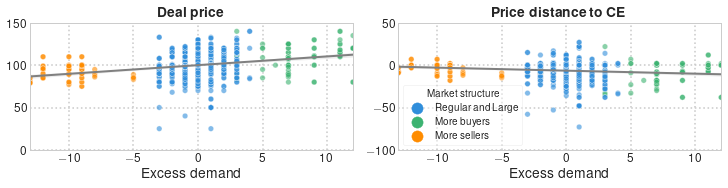

In [174]:
fig, ax = plt.subplots(1,2, figsize=(10,2.5), constrained_layout=True)

for idx, var in enumerate(['price', 'DCE']):
    _ = sns.scatterplot(x='excDemand', y=var, data=df_extra[df_extra['round'] == 1], hue='structure', ax=ax[idx],
                        palette=extraMarg_palette, **{'s': 30, 'alpha': 0.6})
    _ = sns.regplot(x='excDemand', y=var, data=df_extra[df_extra['round'] == 1], scatter=False, ax=ax[idx],
                    line_kws={'color': 'gray', 'linewidth': 2})
    _ = ax[idx].set_xlabel('Excess demand')
    _ = ax[idx].set_ylabel('')
    
_ = ax[0].set_title(r'\textbf{Deal price}')
_ = ax[1].set_title(r'\textbf{Price distance to CE}')

_ = ax[0].set_yticks([0,50,100,150])
_ = ax[1].set_yticks([-100,-50,0,50])

_ = ax[0].get_legend().remove()
_ = ax[1].legend(title='Market structure', loc=3, framealpha=0.4)

_ = plt.savefig('Figures/ExcessDemandPrices.pdf', bbox_inches='tight', transparent=True)

Deal prices versus CE midpoints

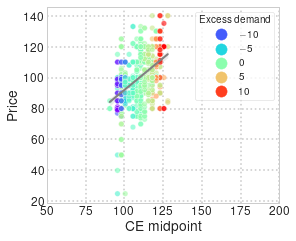

In [175]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)
_ = sns.scatterplot(x='midCE', y='price', data=df_extra[df_extra['round'] == 1], hue='excDemand', ax=ax,
                    **{'s': 30, 'alpha': 0.6}, palette='rainbow', legend='brief')
_ = sns.regplot(x='midCE', y='price', data=df_extra[df_extra['round'] == 1], scatter=False, ax=ax,
                line_kws={'color': 'gray', 'linewidth': 2})
_ = ax.set_xlabel('CE midpoint')
_ = ax.set_ylabel('Price')
_ = ax.set_xlim((50,200))
_ = ax.set_aspect('equal')
_ = ax.legend(title='Excess demand')

Price and DCE distributions across different market structures

More buyers: median price: 110.0, median DCE: -8.0
More sellers: median price: 95.0, median DCE: 0.0
Regular and Large: median price: 100.0, median DCE: -3.0


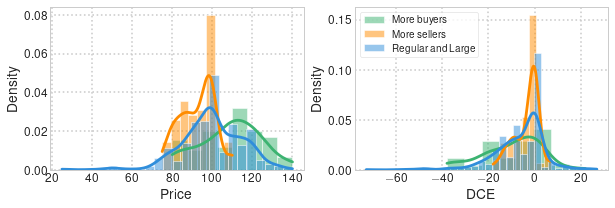

**Price**

$H_0$: the three samples originate from the same distribution

KruskalResult(statistic=61.31125201210252, pvalue=4.857701073553735e-14)

More buyers versus regular and large

MannwhitneyuResult(statistic=16303.5, pvalue=5.992848991716389e-07)

More buyers versus more sellers

MannwhitneyuResult(statistic=1368.5, pvalue=1.0309537139574164e-13)

More sellers versus regular and large

MannwhitneyuResult(statistic=19398.5, pvalue=8.449234053210105e-09)

**DCE**

$H_0$: the three samples originate from the same distribution

KruskalResult(statistic=10.226368039191014, pvalue=0.0060168944816892484)

More buyers versus regular and large

MannwhitneyuResult(statistic=21271.0, pvalue=0.02701045277265911)

More buyers versus more sellers

MannwhitneyuResult(statistic=2826.0, pvalue=0.0011272236037023194)

More sellers versus regular and large

MannwhitneyuResult(statistic=25709.5, pvalue=0.009708567664226144)

In [176]:
fig, ax = plt.subplots(1,2, figsize=(10,3))

for structure, df_structure in df_extra[df_extra['round'] == 1].groupby('structure'):
    print('{}: median price: {}, median DCE: {}'.format(structure, df_structure['price'].median(), df_structure['DCE'].median()))
    
    _ = sns.histplot(df_structure['price'], kde=True, stat='density', label=structure, color=extraMarg_palette[structure], ax=ax[0])
    _ = sns.histplot(df_structure['DCE'], kde=True, stat='density', label=structure, color=extraMarg_palette[structure], ax=ax[1])

_ = ax[0].set_xlabel('Price')
_ = plt.legend()
_ = plt.show()

df_extra_MB = df_extra[(df_extra['round'] == 1) & (df_extra['structure'] == 'More buyers')]
df_extra_MS = df_extra[(df_extra['round'] == 1) & (df_extra['structure'] == 'More sellers')]
df_extra_RL = df_extra[(df_extra['round'] == 1) & (df_extra['structure'] == 'Regular and Large')]

for var in ['price', 'DCE']:
    printmd('**{}**'.format(var.capitalize() if var == 'price' else var))
    printmd('$H_0$: the three samples originate from the same distribution')
    stats.kruskal(df_extra_MB[var], df_extra_MS[var], df_extra_RL[var])
    
    printmd('More buyers versus regular and large')
    stats.mannwhitneyu(df_extra_MB[var], df_extra_RL[var])
    
    printmd('More buyers versus more sellers')
    stats.mannwhitneyu(df_extra_MB[var], df_extra_MS[var])

    printmd('More sellers versus regular and large')
    stats.mannwhitneyu(df_extra_MS[var], df_extra_RL[var])

## Feedback from the order book

In all Private Information settings, subjects learn about **realised prices** via an instant broadcast to all market participants displayed visually in the center of the screen for 3 seconds. In addition, depending on treatment, subjects also have real-time access to bids and/or asks placed by other players. At any given time, these are displayed to each individual in the form of a sorted list of all currently active bids/asks (or both, for that matter). The greater the gains of trade a bid/ask would generate if matched, the higher it is positioned in the list. For quick reference, a player’s own bid/ask is also always clearly marked.

Feedback impulses:
- **same-side**: median of the last 10 bids observed on the same side;
- **other-side**: median of the last 10 bids observed on the other side;
- **deals**: last deal observed.

In [177]:
df_feedback = df.copy()

feedback_types = ['BB', 'Full', 'Same', 'Other']

for treatment, df_treatment in df_feedback.groupby('treatment'):
    for f in feedback_types:
        if f in treatment:
            df_feedback.loc[df_treatment.index, 'feedback'] = f

Extract the feedback impulses

In [178]:
df_feedback['same'] = [[] for i in range(len(df))]
df_feedback['other'] = [[] for i in range(len(df))]
df_feedback['deal'] = np.nan

for (treatment, game, rnd), dfr in df_feedback.groupby(['treatment', 'game', 'round']):
    for index, row in dfr.iterrows():
        side, t = row[['side', 'time']]

        same_bids = dfr[(dfr['time'] < t) & (dfr['side'] == side)].iloc[-10:, :]
        other_bids = dfr[(dfr['time'] < t) & (dfr['side'] != side)].iloc[-10:, :]
        last_deals = dfr[(dfr['price'].notna()) & (dfr['match_time'] < t) & (dfr['id'] < dfr['match_id'])].sort_values('match_time')
        
        if len(same_bids) > 0:               
            df_feedback.at[index, 'same'] = same_bids['bid'].values

        if len(other_bids) > 0:
            df_feedback.at[index, 'other'] = other_bids['bid'].values
            
        if len(last_deals) > 0:
            df_feedback.loc[index, 'deal'] = last_deals['price'].iloc[-1]

Measure the distances between current bids/asks and feedback impulses

In [179]:
for index, row in df_feedback.iterrows():
    if len(row['same']) > 0:
        df_feedback.loc[index, 'distSame'] = row['bid'] - np.median(row['same'])
    if len(row['other']) > 0:
        df_feedback.loc[index, 'distOther'] = row['bid'] - np.median(row['other'])
    if not np.isnan(row['deal']):
        df_feedback.loc[index, 'distDeal'] = row['bid'] - row['deal']

In [180]:
def feedback_distance(feedback):
    col_order = ['Buyer', 'Seller']
    hue_order = ['BB', 'Same', 'Other', 'Full']

    with sns.axes_style('white'):
        g = sns.catplot(x='round', y=feedback, hue='feedback', kind='box', data=df_feedback[(df_feedback['round'].isin([1,5,10]))].dropna(subset=[feedback]), showfliers=False,
                        col='side', height=5, width=0.7, aspect=1.5, legend_out=False, col_order=col_order, hue_order=hue_order) 

    axes = g.axes.flatten()

    feedback_style = {'BB': {'label': 'Black Box', 'hatch': ''}, 'Full': {'label': 'Full PI', 'hatch': '//'},
                      'Same': {'label': 'Same-side PI', 'hatch': ''}, 'Other': {'label': 'Other-side PI', 'hatch': ''}}

    for i, ax in enumerate(axes):
        side = col_order[i]
        other_side = col_order[abs(i-1)]
        colours = {'BB': 'white', 'Same': side_colours[side], 'Other': side_colours[other_side], 'Full': side_colours[side]}

        # Boxplots
        for j, line in enumerate(ax.lines):
            _ = line.set(alpha=0.7, color=colours['Same'])

            if j in [9+5*k+20*l for k in range(0,3) for l in range(0,3)]:      
                _ = line.set(alpha=0.7, color='white')

        _ = ax.axhline(y=0, linestyle='dashed', color='gray', zorder=0, alpha=0.7, linewidth=2)

        # Layout
        _ = ax.set_title(r'\textbf{{{}s}}'.format(side), fontsize=25)
        _ = ax.tick_params(axis='x', labelsize=18)
        _ = ax.set_xlabel(r'Round $T$', fontsize=20)
        _ = ax.tick_params(axis='y', labelsize=18)
        _ = ax.set_ylabel('')
        _ = ax.set_ylim((-150,150))

        # New legend
        _ = ax.legend()
        newhandles = []

        for legpatch in ax.get_legend().get_patches():
            label = legpatch.get_label()
            style = feedback_style[label]

            legpatch.set_label(style['label'])
            legpatch.set_edgecolor(colours['Same'])
            legpatch.set_facecolor(colours[label])
            legpatch.set_hatch(style['hatch'])
            newhandles.append(legpatch)

            _ = ax.legend(handles=newhandles, title='Feedback setting', fontsize=15, title_fontsize=15,
                          shadow=True, ncol=2, loc=1 if i == 0 else 4)

        for a, artist in enumerate(ax.artists):
            label = hue_order[a % 4]
            artist.set_edgecolor(colours['Same'])

            if label == 'Full':
                plt.rcParams["hatch.linewidth"] = 3
                artist.set_hatch('//')
                artist.set_facecolor(colours['Other'])
            else:
                artist.set_facecolor(colours[label])

distSame

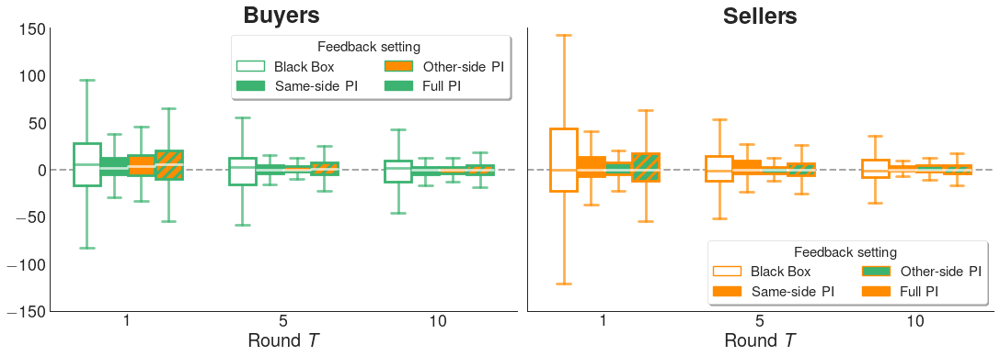

distOther

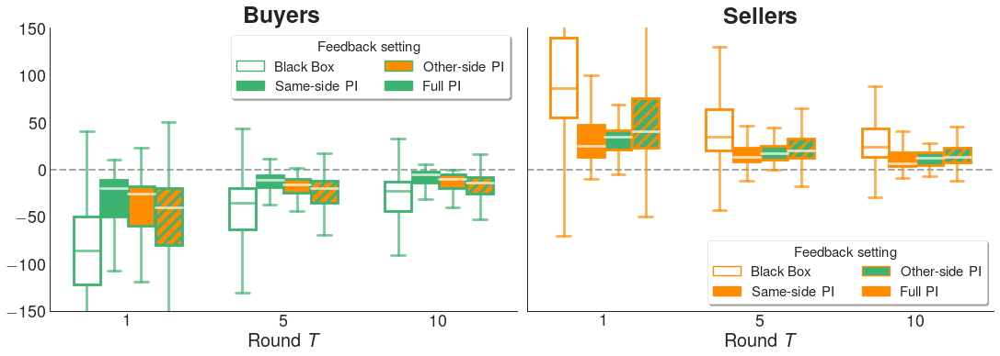

distDeal

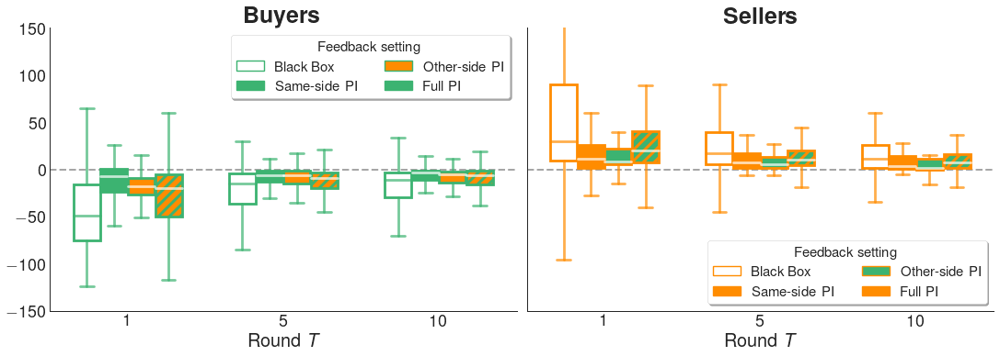

In [181]:
for dist in ['distSame', 'distOther', 'distDeal']:
    printmd(dist)
    feedback_distance(dist)
    _ = plt.savefig('Figures/{}.pdf'.format(dist), bbox_inches='tight', transparent=True)
    _ = plt.show()

Time window before the first deal takes place

**Round**

DescribeResult(nobs=104, minmax=(1, 4), mean=1.0480769230769231, variance=0.1044622852875279, skewness=7.927777481962956, kurtosis=66.68764959138652)

Median: 1.0


**Match time**

DescribeResult(nobs=104, minmax=(5.0, 90.0), mean=14.384615384615385, variance=183.46228528752798, skewness=2.907375044612337, kurtosis=10.284522555956933)

Median: 10.0


**Active players**

DescribeResult(nobs=104, minmax=(2, 23), mean=7.451923076923077, variance=16.813200149365198, skewness=1.0442734348823424, kurtosis=1.101565961531886)

Median: 7.0


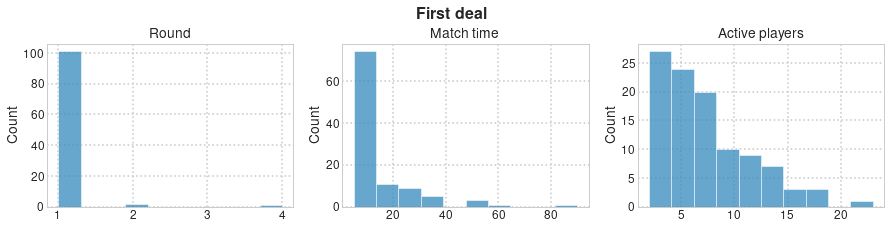

In [182]:
rounds = []
match_times = []
n_subjects = []

for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    first_deals = df_game[df_game['price'].notna()].nsmallest(1, ['round', 'match_time'], keep='last')
    rounds.append(first_deals['round'].iloc[0])
    match_times.append(first_deals['match_time'].iloc[0])
    n_subjects.append(len(set(df_game.loc[:first_deals.index[0]]['id'])))
    
fig, ax = plt.subplots(1,3, figsize=(15,3))
_ = plt.suptitle('\\textbf{First deal}', y=1.05)

for idx, (label, data) in enumerate(zip(['Round', 'Match time', 'Active players'], [rounds, match_times, n_subjects])):
    _ = ax[idx].set_title(label)
    _ = sns.histplot(data, ax=ax[idx], bins=10)
    printmd('**{}**'.format(label))
    stats.describe(data)
    print('Median: {}'.format(np.median(data)))

**Mann-Whitney-Wilcoxon tests** across trading rounds $r \in \{ 1, 2, \ldots, 10 \}$\
$H_0$: the distributions of the Black-Box feedback distances and the feedback distances under consideration are equal

In [183]:
def MWW_feedback(dist):
    index = range(1,11)
    columns = pd.MultiIndex.from_product([['Same', 'Other', 'Full', 'PI'], ['Buyers', 'Sellers'], ['Median', '$p$-value', 'P(X > Y)']])
    df_results = pd.DataFrame(index=index, columns=columns)

    for (rnd, side), dfr in df_feedback[df_feedback['round'] <= 10].groupby(['round', 'side']):
        distances_BB = dfr[dfr['feedback'] == 'BB'][dist].dropna().apply(abs)
        
        for feedback in set(columns.get_level_values(0)):
            if feedback == 'PI':
                distances_f = dfr[dfr['feedback'] != 'BB'][dist].dropna().apply(abs)
            else:
                distances_f = dfr[dfr['feedback'] == feedback][dist].dropna().apply(abs)
        
            U, p = stats.mannwhitneyu(distances_BB, distances_f)

            df_results.loc[rnd, (feedback, '{}s'.format(side), '$p$-value')] = p
            df_results.loc[rnd, (feedback, '{}s'.format(side), 'P(X > Y)')] = U/(len(distances_BB)*len(distances_f))
            df_results.loc[rnd, (feedback, '{}s'.format(side), 'Median')] = np.median(distances_f)
        
        df_results.loc[rnd, ('BB', '{}s'.format(side), 'Median')] = np.median(distances_BB)
    
    return df_results

In [184]:
def feedbackDistance_rounds(df_results):
    fig, ax = plt.subplots(1,1, figsize=(7,4))
    for key, group in df_results.groupby(level=[0,1], axis=1):
        _ = ax.plot(group.index, group[key]['Median'], color=feedback_palette[key[0]], label='{}, {}'.format(key[0], key[1]),
                     linestyle='dashed' if key[1] == 'Buyers' else 'solid')
        _ = ax.set_xticks(group.index)

    _ = plt.legend(ncol=2)
    
    with pd.option_context('display.max_columns', None): 
        display(df_results.astype(float).round(2))

In [188]:
new_labels = {'BB': 'Black Box', 'Same': 'Same-side PI', 'Other': 'Other-side PI', 'Full': 'Full-side PI'}

def distance_evolution(metric, title):
    fig, ax = plt.subplots(1,1, figsize=(18,3), sharex=True, sharey=True)
    markers = {'BB': 'o', 'Full': 'o', 'Same': 's', 'Other': 'D'}

    data = df_feedback[(df_feedback['round'] <= 10) & (df_feedback['time'] <= 200)].copy()
    rounds = np.arange(1,11)
    time_elapsed = pd.Series((max(data['time'])+9)//10*10, index=rounds)
    time_elapsed = time_elapsed.expanding(1).sum()
    time_elapsed.loc[time_elapsed.first_valid_index() - 1] = 0
    time_elapsed.sort_index(inplace=True)
    time_steps = time_elapsed.rolling(2).mean().shift(-1)[:-1]
    data['time_elapsed'] = data.apply(lambda row: row['time'] + time_elapsed[row['round'] - 1], axis=1)
    
    for side, df_side in data.groupby(['side']):
        _ = ax.set_title(r'\textbf{{{}}}'.format(title))   
        _ = ax.set_xlabel('Round');
        _ = ax.set_ylabel('Rolling median');
        _ = ax.set_xticks(ticks=time_steps)
        _ = ax.set_xticks(time_elapsed, minor=True)
        _ = ax.set_xlim(min(time_elapsed)-2, max(time_elapsed)+2)
        _ = ax.xaxis.grid(True, which='minor')
        _ = ax.xaxis.grid(False, which='major')
        _ = ax.set_xticklabels(rounds, size=12)

        for (rnd, feedback), dff in df_side.groupby(['round', 'feedback']):
            dff.sort_values('time_elapsed', inplace=True)
            dff = dff.reset_index()

            dff['rolling_median'] = dff[metric].apply(abs).rolling(100, min_periods=10).median()

            _ = sns.lineplot(x='time_elapsed', y='rolling_median', data=dff, ax=ax, 
                             color=feedback_palette[feedback], ci=None, estimator=None, 
                             **{'linewidth': 1, 'alpha': 1})

        _ = ax.set_xlabel('');
        _ = ax.set_ylabel('');
        
    legend_elements = []

    for feedback in df_side['feedback'].unique():
        legend_elements.append(Line2D([0], [0], color=feedback_palette[feedback], label=new_labels[feedback]))

    _ = ax.legend(handles=legend_elements, fontsize=10, loc=1)

### Same-side feedback

Median absolute feedback distance to the same-side impulse

Same                                                Other            \
   Buyers                    Sellers                    Buyers             
   Median $p$-value P(X > Y)  Median $p$-value P(X > Y) Median $p$-value   
1    9.75       0.0     0.35    9.25       0.0     0.30   12.0       0.0   
2    6.75       0.0     0.28    5.00       0.0     0.29    7.5       0.0   
3    5.00       0.0     0.25    4.50       0.0     0.29    5.0       0.0   
4    4.50       0.0     0.22    4.00       0.0     0.32    5.0       0.0   
5    4.00       0.0     0.22    5.50       0.0     0.34    3.0       0.0   
6    4.00       0.0     0.28    3.50       0.0     0.28    2.0       0.0   
7    4.00       0.0     0.30    3.50       0.0     0.31    2.0       0.0   
8    3.00       0.0     0.28    5.00       0.0     0.40    2.0       0.0   
9    4.00       0.0     0.36    2.50       0.0     0.30    1.5       0.0   
10   3.00       0.0     0.29    1.75       0.0     0.26    3.0       0.0   

                                         Full                             \
            Sellers                    Buyers                    Sellers   
   P(X > Y)  Median $p$-value P(X > Y) Median $p$-value P(X > Y)  Median   
1      0.38     7.0       0.0     0.28  16.00       0.0     0.43    15.0   
2      0.28     5.0       0.0     0.33  11.25       0.0     0.38    10.0   
3      0.28     4.5       0.0     0.30   9.00       0.0     0.36     9.0   
4      0.25     5.0       0.0     0.34   7.00       0.0     0.33     6.5   
5      0.23     3.0       0.0     0.26   6.50       0.0     0.34     6.5   
6      0.21     2.0       0.0     0.22   6.00       0.0     0.38     6.5   
7      0.22     2.0       0.0     0.29   4.50       0.0     0.36     6.0   
8      0.22     4.0       0.0     0.41   5.00       0.0     0.38     5.0   
9      0.21     3.0       0.0     0.29   5.00       0.0     0.40     5.0   
10     0.30     3.0       0.0     0.31   5.00       0.0     0.35     4.0   

                          PI                                                \
                      Buyers                    Sellers                      
   $p$-value P(X > Y) Median $p$-value P(X > Y)  Median $p$-value P(X > Y)   
1        0.0     0.36   15.0       0.0     0.41    12.5       0.0     0.34   
2        0.0     0.39   10.0       0.0     0.35     9.0       0.0     0.36   
3        0.0     0.37    7.5       0.0     0.33     7.5       0.0     0.35   
4        0.0     0.36    6.0       0.0     0.30     6.0       0.0     0.35   
5        0.0     0.37    5.0       0.0     0.31     6.0       0.0     0.35   
6        0.0     0.39    5.0       0.0     0.35     5.0       0.0     0.36   
7        0.0     0.40    4.0       0.0     0.34     5.0       0.0     0.38   
8        0.0     0.39    4.0       0.0     0.35     5.0       0.0     0.39   
9        0.0     0.39    4.5       0.0     0.38     4.5       0.0     0.36   
10       0.0     0.36    4.0       0.0     0.33     4.0       0.0     0.34   

       BB          
   Buyers Sellers  
   Median  Median  
1    22.5    30.0  
2    21.0    19.5  
3    15.0    15.0  
4    16.0    13.5  
5    14.0    12.5  
6    11.0    11.0  
7    10.0    10.0  
8     9.5     9.5  
9     8.5     9.5  
10   10.0     9.0

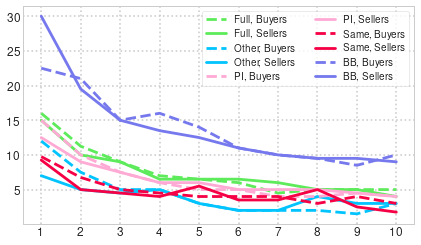

In [189]:
printmd('Median absolute feedback distance to the same-side impulse')
df_results = MWW_feedback('distSame')
feedbackDistance_rounds(df_results)

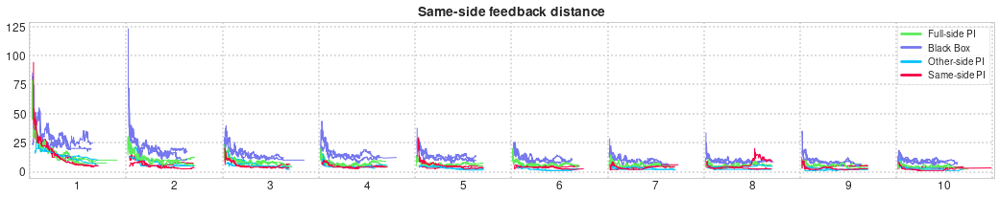

In [190]:
distance_evolution('distSame', 'Same-side feedback distance')

Copying behaviour

In [191]:
copy = []

for index, row in df_feedback.iterrows():
    if row['bid'] in row['same']:
        copy.append(True)
    else:
        copy.append(False)

df_feedback['copy'] = copy

In [192]:
copy_ratios = {'feedback': [], 'ratioBuyers': [], 'ratioSellers': []}

for (feedback, treatment, game), data in df_feedback.groupby(['feedback', 'treatment', 'game']):
    buyers = data[data['side'] == 'Buyer']
    sellers = data[data['side'] == 'Seller']
    
    copy_ratios['feedback'].append(feedback)
    copy_ratios['ratioBuyers'].append(len(buyers[buyers['copy']])/len(buyers))
    copy_ratios['ratioSellers'].append(len(sellers[sellers['copy']])/len(sellers))

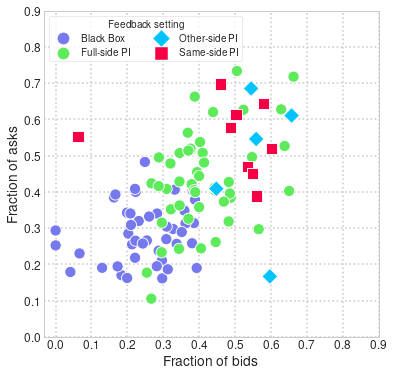

In [193]:
new_labels = {'BB': 'Black Box', 'Same': 'Same-side PI', 'Other': 'Other-side PI', 'Full': 'Full-side PI'}
markers = {'BB': 'o', 'Full': 'o', 'Same': 's', 'Other': 'D'}

_ = plt.figure(figsize=(6,6))
_ = sns.scatterplot(x='ratioBuyers', y='ratioSellers', data=copy_ratios, hue='feedback',
                    palette=feedback_palette, markers=markers, style='feedback')

ticks = [0.1*x for x in range(10)]
_ = plt.xticks(ticks)
_ = plt.yticks(ticks)
_ = plt.xlabel('Fraction of bids')
_ = plt.ylabel('Fraction of asks')

handles, labels = plt.gca().get_legend_handles_labels()
labels = [new_labels[label] for label in labels]
_ = plt.legend(handles, labels, fancybox=True, ncol=2, fontsize=10,
               title='Feedback setting', loc=2, framealpha=0.8)
_ = plt.savefig('Figures/Same_fraction.pdf', bbox_inches='tight', transparent=True)

### Other-side feedback

Median absolute feedback distance to the other-side impulse

Same                                                Other            \
   Buyers                    Sellers                    Buyers             
   Median $p$-value P(X > Y)  Median $p$-value P(X > Y) Median $p$-value   
1   19.50       0.0     0.18   25.75       0.0     0.18  25.50       0.0   
2   17.00       0.0     0.20   19.00       0.0     0.21  34.00       0.0   
3   15.50       0.0     0.21   15.00       0.0     0.23  29.00       0.0   
4   13.00       0.0     0.16   13.50       0.0     0.25  20.00       0.0   
5   11.50       0.0     0.18   13.50       0.0     0.24  16.00       0.0   
6   10.00       0.0     0.18   10.50       0.0     0.21  14.00       0.0   
7    9.50       0.0     0.19   10.00       0.0     0.27  16.75       0.0   
8    9.25       0.0     0.22   10.00       0.0     0.31  13.00       0.0   
9    8.00       0.0     0.24    7.50       0.0     0.29   9.50       0.0   
10   5.50       0.0     0.20    7.00       0.0     0.25  10.00       0.0   

                                         Full                             \
            Sellers                    Buyers                    Sellers   
   P(X > Y)  Median $p$-value P(X > Y) Median $p$-value P(X > Y)  Median   
1      0.22    35.0       0.0     0.19   40.0       0.0     0.30    40.0   
2      0.39    25.0       0.0     0.27   37.5       0.0     0.39    35.0   
3      0.40    20.0       0.0     0.33   30.0       0.0     0.38    27.0   
4      0.26    20.5       0.0     0.33   23.0       0.0     0.34    21.0   
5      0.31    17.0       0.0     0.26   20.0       0.0     0.33    20.0   
6      0.32    16.5       0.0     0.31   18.0       0.0     0.37    16.5   
7      0.34    14.5       0.0     0.29   16.5       0.0     0.35    15.0   
8      0.35    14.0       0.0     0.38   16.0       0.0     0.35    14.0   
9      0.26    11.0       0.0     0.30   15.5       0.0     0.36    14.5   
10     0.30    12.5       0.0     0.29   15.0       0.0     0.37    13.5   

                          PI                                                \
                      Buyers                    Sellers                      
   $p$-value P(X > Y) Median $p$-value P(X > Y)  Median $p$-value P(X > Y)   
1        0.0     0.25  35.00       0.0     0.27    35.5       0.0     0.23   
2        0.0     0.34  31.25       0.0     0.35    30.0       0.0     0.31   
3        0.0     0.37  25.50       0.0     0.35    24.0       0.0     0.34   
4        0.0     0.32  20.00       0.0     0.30    20.0       0.0     0.31   
5        0.0     0.33  18.50       0.0     0.30    19.0       0.0     0.31   
6        0.0     0.34  15.50       0.0     0.33    15.0       0.0     0.32   
7        0.0     0.33  15.00       0.0     0.32    14.0       0.0     0.32   
8        0.0     0.34  14.00       0.0     0.32    13.0       0.0     0.34   
9        0.0     0.36  14.00       0.0     0.33    13.0       0.0     0.34   
10       0.0     0.32  13.00       0.0     0.33    12.5       0.0     0.31   

       BB          
   Buyers Sellers  
   Median  Median  
1    86.0   86.00  
2    56.5   56.75  
3    44.0   40.50  
4    42.0   37.50  
5    35.0   35.50  
6    29.5   28.50  
7    27.5   26.50  
8    26.5   24.00  
9    25.0   23.50  
10   22.5   23.50

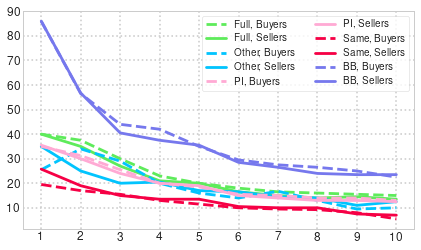

In [194]:
printmd('Median absolute feedback distance to the other-side impulse')
df_results = MWW_feedback('distOther')
feedbackDistance_rounds(df_results)

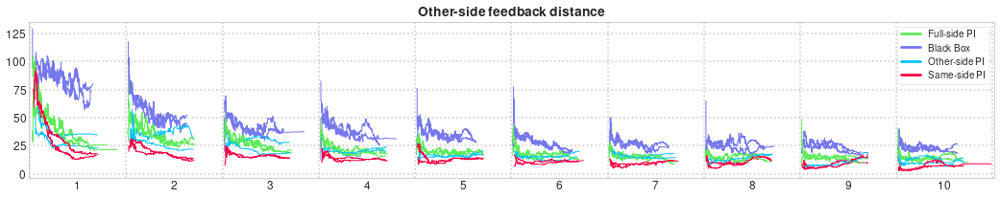

In [195]:
distance_evolution('distOther', 'Other-side feedback distance')

### Deal prices

In [196]:
df_price = df_feedback[df_feedback['price'].notna()].copy()

In [197]:
rows = []
cols = ['Feedback', 'Round', 'Deals', 'Time between deals']

for (feedback, treatment, game, rnd), dfr in df_price[df_price['round'] <= 10].groupby(['feedback', 'treatment', 'game', 'round']):
    n_deals = dfr['price'].count()/2
    dt_deals = dfr[dfr['id'] < dfr['match_id']].sort_values('match_time')['match_time'].diff().dropna().values
    
    rows.append([feedback, rnd, n_deals, dt_deals])
        
deals = pd.DataFrame(rows, columns=cols)
deals['BB'] = deals['Feedback'] == 'BB'

#### Black Box versus Private Information

Round: 1

Median number of deals in Black Box versus lack Private Information: 3.5 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 17.0 versus 8.0

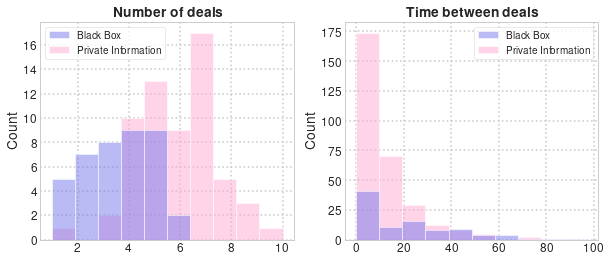

Round: 2

Median number of deals in Black Box versus lack Private Information: 4.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 17.0 versus 10.0

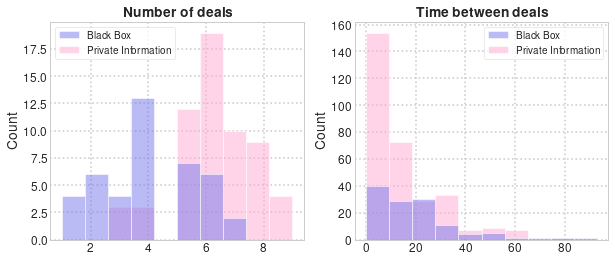

Round: 3

Median number of deals in Black Box versus lack Private Information: 5.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 12.0 versus 10.0

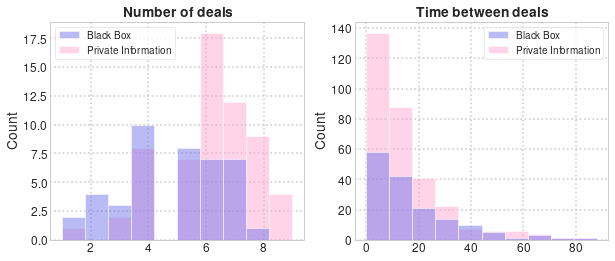

Round: 4

Median number of deals in Black Box versus lack Private Information: 5.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 14.0 versus 10.0

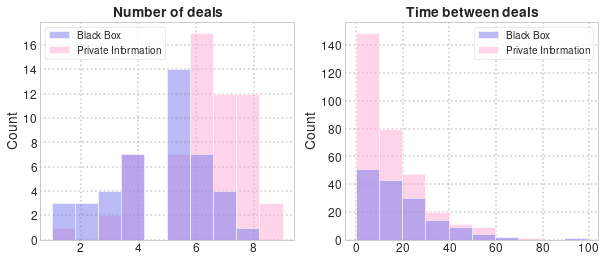

Round: 5

Median number of deals in Black Box versus lack Private Information: 5.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 14.0 versus 11.0

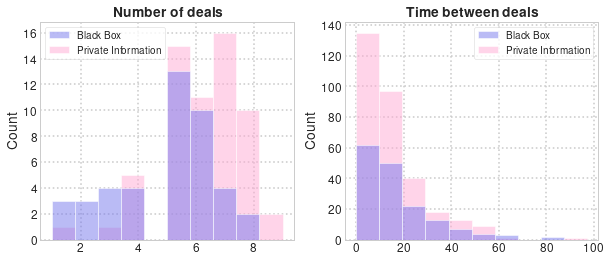

Round: 6

Median number of deals in Black Box versus lack Private Information: 6.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 13.0 versus 10.0

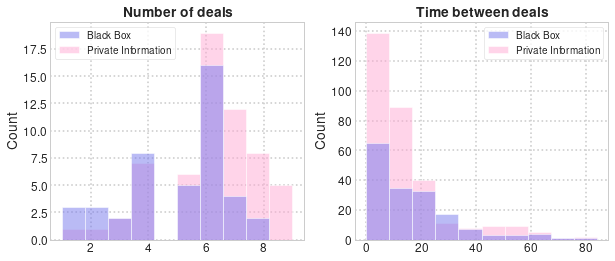

Round: 7

Median number of deals in Black Box versus lack Private Information: 5.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 12.0 versus 10.0

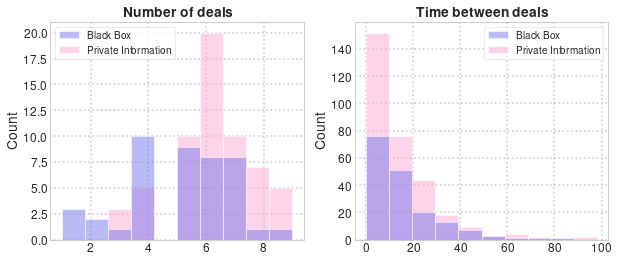

Round: 8

Median number of deals in Black Box versus lack Private Information: 5.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 12.0 versus 10.0

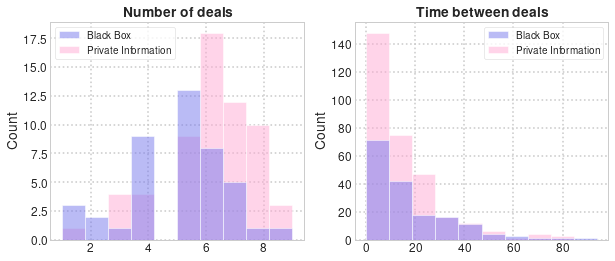

Round: 9

Median number of deals in Black Box versus lack Private Information: 5.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 11.0 versus 9.0

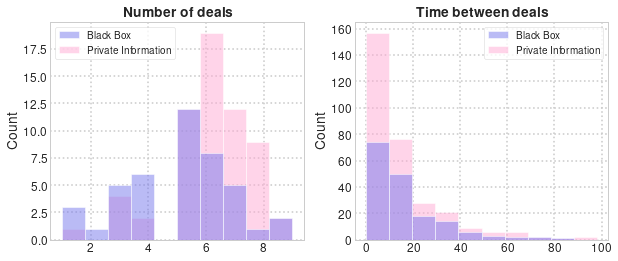

Round: 10

Median number of deals in Black Box versus lack Private Information: 5.0 versus 6.0

Median time between consecutive deals in Black Box versus Private Information: 12.0 versus 9.0

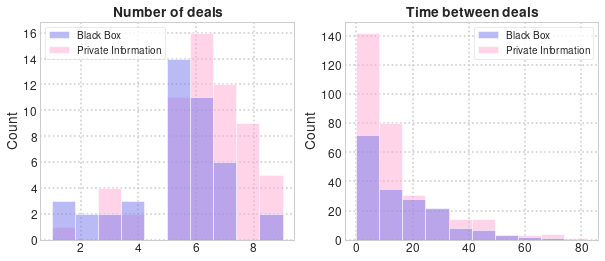

In [198]:
labels = {True: 'Black Box', False: 'Private Information'}
palette = {'Black Box': feedback_palette['BB'], 'Private Information': feedback_palette['PI']}

for rnd, dfr in deals.groupby(['Round']):
    printmd('Round: {}'.format(rnd))
    
    BB = dfr[dfr['BB']]
    PI = dfr[~dfr['BB']]
    
    printmd('Median number of deals in Black Box versus lack Private Information: {} versus {}'.format(np.median(BB['Deals']), np.median(PI['Deals'])))
    printmd('Median time between consecutive deals in Black Box versus Private Information: {} versus {}'.format(np.median(np.concatenate(BB['Time between deals'].values)),
                                                                                                                 np.median(np.concatenate(PI['Time between deals'].values))))    
    
    fig, ax = plt.subplots(1,2, figsize=(10,4))
    _ = ax[0].set_title('\\textbf{Number of deals}')
    hist = sns.histplot({labels[key]: dfr[dfr['BB'] == key]['Deals'] for key in dfr['BB'].unique()},
                        bins=10, ax=ax[0], palette=palette, alpha=0.5)
    
    _ = ax[1].set_title('\\textbf{Time between deals}')
    _ = sns.histplot({labels[key]: np.concatenate(dfr[dfr['BB'] == key]['Time between deals'].values) for key in dfr['BB'].unique()},
                     bins=10, ax=ax[1], palette=palette, alpha=0.5)
    _ = plt.show()

#### Feedback comparison

Across rounds

Round: 1

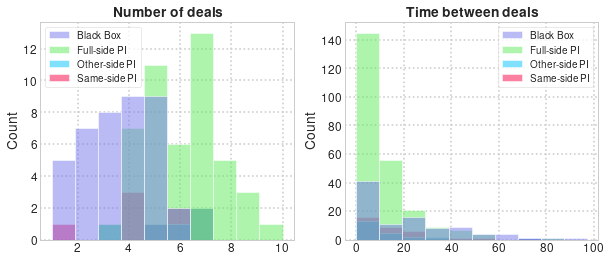

**Median time between consecutive deals**

{'Black Box': 17.0,
 'Full-side PI': 8.0,
 'Other-side PI': 8.0,
 'Same-side PI': 10.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,96.0,21.614583,20.899443,1.0,4.0,17.0,32.25,97.0
Full-side PI,243.0,12.189300,12.022240,0.0,5.0,8.0,14.50,84.0
Other-side PI,23.0,13.826087,15.077533,0.0,6.5,8.0,14.00,70.0
Same-side PI,35.0,15.714286,15.416896,1.0,6.5,10.0,23.00,76.0


**Median number of deals**

{'Black Box': 3.5,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 5.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,40.0,3.400000,1.464100,1.0,2.0,3.5,5.0,6.0
Full,47.0,6.170213,1.632804,3.0,5.0,6.0,7.0,10.0
Other,5.0,5.600000,1.673320,3.0,5.0,6.0,7.0,7.0
Same,9.0,4.888889,1.900292,1.0,4.0,5.0,6.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,1.58585e-10,0.284061,0.0399192
BB,NaN,NaN,0.00627739,0.0111932
Other,0.289516,NaN,NaN,0.26996
Same,0.676877,0.801983,0.390862,NaN


Round: 2

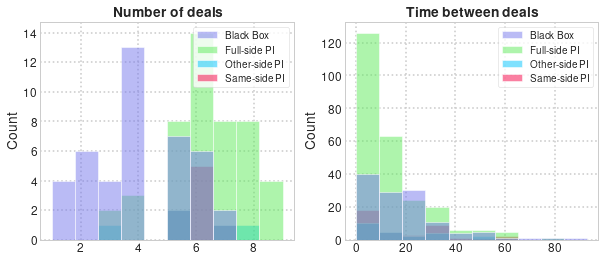

**Median time between consecutive deals**

{'Black Box': 17.0,
 'Full-side PI': 9.0,
 'Other-side PI': 14.0,
 'Same-side PI': 12.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,123.0,18.926829,16.254720,0.0,6.5,17.0,25.0,93.0
Full-side PI,251.0,14.406375,13.568279,0.0,5.5,9.0,18.0,77.0
Other-side PI,23.0,17.347826,13.982485,0.0,6.5,14.0,27.5,48.0
Same-side PI,39.0,19.564103,16.135601,3.0,7.0,12.0,30.0,64.0


**Median number of deals**

{'Black Box': 4.0,
 'Full-side PI': 6.0,
 'Other-side PI': 5.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,42.0,3.928571,1.658575,1.0,3.00,4.0,5.0,7.0
Full,47.0,6.340426,1.536181,3.0,5.00,6.0,7.5,9.0
Other,5.0,5.600000,1.949359,3.0,5.00,5.0,7.0,8.0
Same,8.0,5.875000,0.640870,5.0,5.75,6.0,6.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,4.23088e-09,0.187843,0.172212
BB,NaN,NaN,0.03813,0.000699354
Other,0.363624,0.797758,NaN,0.379766
Same,0.169721,NaN,0.171236,NaN


Round: 3

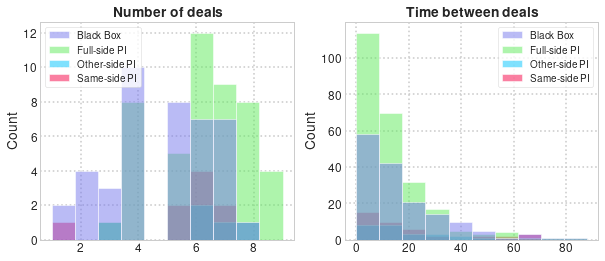

**Median time between consecutive deals**

{'Black Box': 12.0,
 'Full-side PI': 9.0,
 'Other-side PI': 14.0,
 'Same-side PI': 12.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,156.0,17.410256,16.150051,1.0,6.0,12.0,24.00,80.0
Full-side PI,248.0,13.794355,13.480007,0.0,6.0,9.0,18.00,88.0
Other-side PI,25.0,16.880000,12.450971,0.0,8.0,14.0,24.00,44.0
Same-side PI,40.0,19.375000,19.792109,0.0,6.0,12.0,24.25,70.0


**Median number of deals**

{'Black Box': 5.0,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,42.0,4.714286,1.784564,1.0,4.0,5.0,6.0,8.0
Full,47.0,6.276596,1.611131,3.0,5.0,6.0,7.5,9.0
Other,5.0,6.000000,1.870829,3.0,6.0,6.0,7.0,8.0
Same,9.0,5.444444,1.810463,1.0,5.0,6.0,6.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,8.6446e-05,0.412408,0.142431
BB,NaN,NaN,0.0708546,0.0856457
Other,0.175492,0.631137,NaN,0.242571
Same,0.389926,0.341549,0.335561,NaN


Round: 4

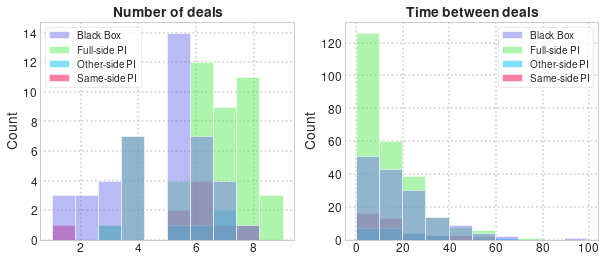

**Median time between consecutive deals**

{'Black Box': 14.0,
 'Full-side PI': 10.0,
 'Other-side PI': 18.0,
 'Same-side PI': 11.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,154.0,18.246753,16.005437,0.0,6.0,14.0,27.0,99.0
Full-side PI,254.0,14.590551,12.590450,0.0,6.0,10.0,21.0,71.0
Other-side PI,23.0,20.000000,15.945931,1.0,7.5,18.0,25.0,65.0
Same-side PI,41.0,17.146341,15.337146,0.0,6.0,11.0,24.0,56.0


**Median number of deals**

{'Black Box': 5.0,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,43.0,4.581395,1.707582,1.0,4.0,5.0,6.0,8.0
Full,47.0,6.404255,1.569541,3.0,5.5,6.0,8.0,9.0
Other,5.0,5.600000,1.673320,3.0,5.0,6.0,7.0,7.0
Same,9.0,5.555556,1.943651,1.0,5.0,6.0,6.0,8.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,2.45265e-06,0.15944,0.117975
BB,NaN,NaN,0.0922303,0.030132
Other,0.396552,0.509164,NaN,0.5
Same,0.399827,0.483992,0.187325,NaN


Round: 5

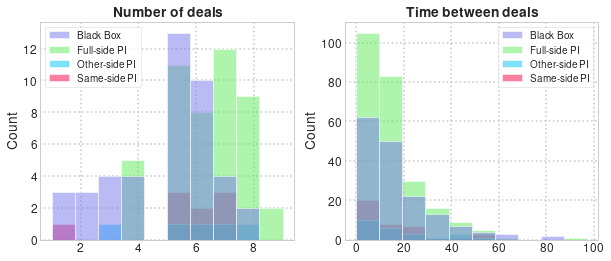

**Median time between consecutive deals**

{'Black Box': 14.0,
 'Full-side PI': 11.0,
 'Other-side PI': 13.5,
 'Same-side PI': 10.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,163.0,17.269939,15.819609,0.0,5.50,14.0,23.00,79.0
Full-side PI,250.0,15.156000,13.345113,0.0,7.00,11.0,19.00,97.0
Other-side PI,24.0,17.166667,14.562210,1.0,6.00,13.5,23.00,49.0
Same-side PI,40.0,15.500000,14.698683,1.0,5.75,10.0,20.75,58.0


**Median number of deals**

{'Black Box': 5.0,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,43.0,4.790698,1.806841,1.0,4.0,5.0,6.0,8.0
Full,47.0,6.319149,1.415848,4.0,5.0,6.0,7.0,9.0
Other,5.0,5.800000,1.923538,3.0,5.0,6.0,7.0,8.0
Same,9.0,5.444444,1.878238,1.0,5.0,6.0,7.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,7.11938e-05,0.306045,0.129215
BB,NaN,NaN,0.124262,0.107925
Other,0.243979,0.504298,NaN,0.392046
Same,0.409254,0.302869,0.276555,NaN


Round: 6

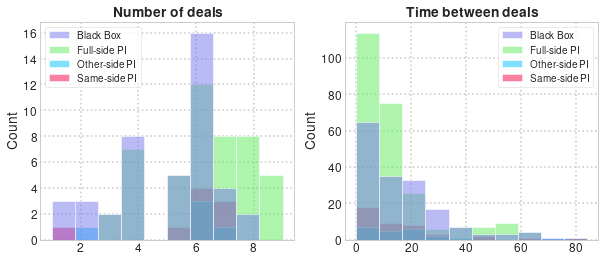

**Median time between consecutive deals**

{'Black Box': 13.0,
 'Full-side PI': 9.0,
 'Other-side PI': 15.0,
 'Same-side PI': 12.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,169.0,16.869822,15.731213,0.0,5.0,13.0,23.00,84.0
Full-side PI,249.0,14.381526,14.543422,0.0,5.0,9.0,16.00,78.0
Other-side PI,22.0,17.636364,15.031857,1.0,8.0,15.0,23.50,69.0
Same-side PI,42.0,16.833333,16.336278,0.0,7.0,12.0,21.75,80.0


**Median number of deals**

{'Black Box': 6.0,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,43.0,4.930233,1.830890,1.0,4.0,6.0,6.0,8.0
Full,47.0,6.297872,1.692887,3.0,5.0,6.0,8.0,9.0
Other,5.0,5.400000,1.949359,2.0,6.0,6.0,6.0,7.0
Same,9.0,5.666667,1.870829,1.0,6.0,6.0,7.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,0.000642076,0.196576,0.251173
BB,NaN,NaN,0.215579,0.0699992
Other,0.44988,0.272632,NaN,0.414376
Same,0.279108,0.348605,0.250771,NaN


Round: 7

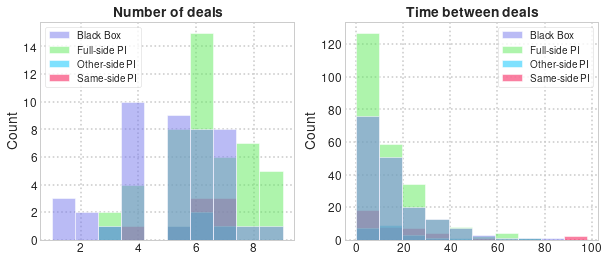

**Median time between consecutive deals**

{'Black Box': 12.0,
 'Full-side PI': 9.0,
 'Other-side PI': 15.5,
 'Same-side PI': 10.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,173.0,15.317919,14.405570,0.0,5.0,12.0,20.00,87.0
Full-side PI,248.0,14.068548,13.148149,0.0,6.0,9.0,19.25,69.0
Other-side PI,22.0,18.272727,15.341142,2.0,6.5,15.5,21.25,70.0
Same-side PI,40.0,18.100000,22.056803,0.0,5.0,10.0,25.25,98.0


**Median number of deals**

{'Black Box': 5.0,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,43.0,5.023256,1.857909,1.0,4.00,5.0,6.0,9.0
Full,47.0,6.276596,1.597581,3.0,5.00,6.0,7.5,9.0
Other,5.0,5.400000,1.516575,3.0,5.00,6.0,6.0,7.0
Same,8.0,6.000000,1.069045,4.0,5.75,6.0,7.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,0.00125888,0.162249,0.375271
BB,NaN,NaN,0.327677,0.0661796
Other,0.434858,0.237431,NaN,0.245502
Same,0.112133,0.486435,0.292985,NaN


Round: 8

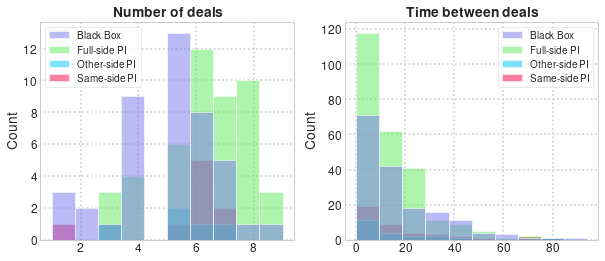

**Median time between consecutive deals**

{'Black Box': 12.0,
 'Full-side PI': 10.0,
 'Other-side PI': 9.0,
 'Same-side PI': 12.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,168.0,17.619048,16.822358,0.0,5.0,12.0,25.25,94.0
Full-side PI,250.0,14.388000,13.722635,0.0,4.0,10.0,20.75,81.0
Other-side PI,21.0,15.714286,18.793996,1.0,5.0,9.0,20.00,82.0
Same-side PI,41.0,18.926829,20.111427,2.0,5.0,12.0,24.00,84.0


**Median number of deals**

{'Black Box': 5.0,
 'Full-side PI': 6.0,
 'Other-side PI': 5.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,43.0,4.906977,1.770310,1.0,4.0,5.0,6.0,9.0
Full,47.0,6.319149,1.616577,3.0,5.0,6.0,8.0,9.0
Other,5.0,5.200000,1.483240,3.0,5.0,5.0,6.0,7.0
Same,9.0,5.555556,1.810463,1.0,6.0,6.0,6.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,0.000114391,0.0688378,0.141826
BB,NaN,NaN,0.351964,0.0513586
Other,0.56233,0.198119,NaN,0.220457
Same,0.347362,0.295946,0.255834,NaN


Round: 9

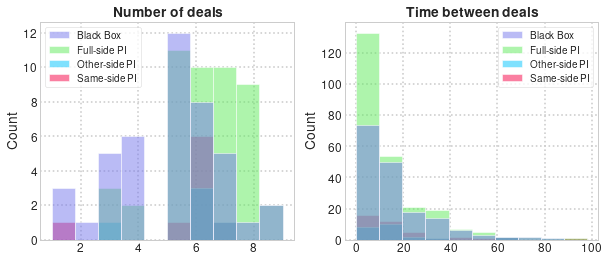

**Median time between consecutive deals**

{'Black Box': 11.0,
 'Full-side PI': 9.0,
 'Other-side PI': 11.0,
 'Same-side PI': 13.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,170.0,16.158824,15.493215,0.0,5.0,11.0,21.00,79.0
Full-side PI,245.0,14.359184,15.651742,0.0,4.0,9.0,18.00,90.0
Other-side PI,23.0,17.000000,17.446021,0.0,5.5,11.0,19.00,65.0
Same-side PI,40.0,18.950000,20.573757,1.0,6.0,13.0,20.25,98.0


**Median number of deals**

{'Black Box': 5.0,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,43.0,4.953488,1.901797,1.0,4.0,5.0,6.0,9.0
Full,47.0,6.212766,1.531356,3.0,5.0,6.0,7.0,9.0
Other,5.0,5.600000,1.516575,3.0,6.0,6.0,6.0,7.0
Same,9.0,5.444444,1.740051,1.0,6.0,6.0,6.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,0.000557872,0.247904,0.160363
BB,NaN,NaN,0.159739,0.0997078
Other,0.29649,0.345593,NaN,0.407713
Same,0.342767,0.231408,0.191088,NaN


Round: 10

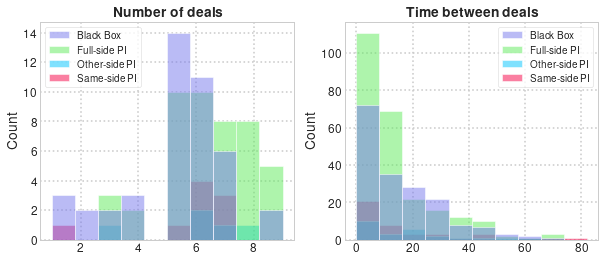

**Median time between consecutive deals**

{'Black Box': 12.0,
 'Full-side PI': 9.0,
 'Other-side PI': 16.0,
 'Same-side PI': 9.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,178.0,16.073034,14.336168,0.0,4.0,12.0,24.0,67.0
Full-side PI,246.0,14.174797,13.602443,0.0,5.0,9.0,17.0,70.0
Other-side PI,25.0,17.120000,16.646621,0.0,4.0,16.0,21.0,58.0
Same-side PI,42.0,16.833333,19.752020,0.0,5.0,9.0,19.0,82.0


**Median number of deals**

{'Black Box': 5.0,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,43.0,5.139535,1.846250,1.0,5.0,5.0,6.0,9.0
Full,46.0,6.347826,1.662894,3.0,5.0,6.0,8.0,9.0
Other,5.0,6.000000,1.870829,3.0,6.0,6.0,7.0,8.0
Same,9.0,5.666667,1.870829,1.0,6.0,6.0,7.0,7.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,0.00158412,0.410818,0.2471
BB,NaN,NaN,0.106489,0.0800369
Other,0.206971,0.436882,NaN,0.362738
Same,0.304067,0.244445,0.267454,NaN


In [199]:
labels = {'BB': 'Black Box', 'Same': 'Same-side PI', 'Other': 'Other-side PI', 'Full': 'Full-side PI'}
index = df_price['feedback'].unique()
palette = {label: feedback_palette[key] for key, label in labels.items()}

for rnd, dfr in deals.groupby(['Round']):
    printmd('Round: {}'.format(rnd))
    
    n_deals = {labels[key]: dfr[dfr['Feedback'] == key]['Deals'] for key in dfr['Feedback'].unique()}
    dt_deals = {labels[key]: np.concatenate(dfr[dfr['Feedback'] == key]['Time between deals'].values) for key in dfr['Feedback'].unique()}
    
    fig, ax = plt.subplots(1,2, figsize=(10,4))
    _ = ax[0].set_title('\\textbf{Number of deals}')
    _ = sns.histplot(n_deals, bins=10, ax=ax[0], palette=palette, alpha=0.5)
    _ = ax[1].set_title('\\textbf{Time between deals}')
    _ = sns.histplot(dt_deals, bins=10, ax=ax[1], palette=palette, alpha=0.5)
    _ = plt.show()
    
    printmd('**Median time between consecutive deals**')
    {key: np.median(vals) for key, vals in dt_deals.items()}
    dt_deals = pd.DataFrame([(k,) + (v,) for k, vals in dt_deals.items() for v in vals], columns=['Feedback', 'dt'])
    dt_deals.groupby('Feedback')['dt'].describe()

    printmd('**Median number of deals**')
    {key: np.median(vals) for key, vals in n_deals.items()}
    dfr.groupby('Feedback')['Deals'].describe()
    
    df_results = pd.DataFrame(index=index, columns=index)
    
    for i in range(len(index)):
        for j in range(i+1, len(index)):
            deals_i = dfr[dfr['Feedback'] == index[i]]['Deals']
            deals_j = dfr[dfr['Feedback'] == index[j]]['Deals']

            u, p = stats.mannwhitneyu(deals_i, deals_j)
            df_results.iloc[i, j] = p

            if p > 0.01:
                p, t1, t2 = ttost_ind(deals_i, deals_j, -1, 1, usevar='pooled', weights=(None, None), transform=None)
                df_results.iloc[j, i] = p 

    printmd('Upper triangle: MWW tests, lower-triangle: equivalence tests')
    df_results

Overall

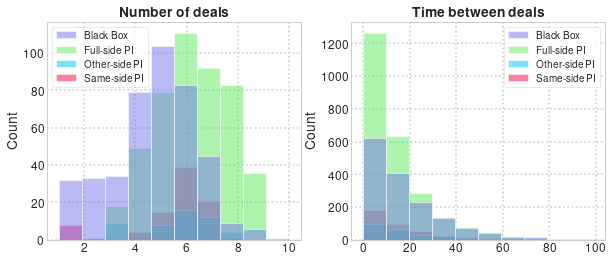

**Median time between consecutive deals**

{'Black Box': 13.0,
 'Full-side PI': 9.0,
 'Other-side PI': 13.0,
 'Same-side PI': 11.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
Black Box,1550.0,17.298710,16.046187,0.0,5.0,13.0,24.0,99.0
Full-side PI,2484.0,14.157005,13.593381,0.0,5.0,9.0,18.0,97.0
Other-side PI,231.0,17.099567,15.338600,0.0,6.0,13.0,23.5,82.0
Same-side PI,400.0,17.707500,18.082987,0.0,6.0,11.0,24.0,98.0


**Median number of deals**

{'Black Box': 5.0,
 'Full-side PI': 6.0,
 'Other-side PI': 6.0,
 'Same-side PI': 6.0}

,count,mean,std,min,25%,50%,75%,max
Feedback,,,,,,,,
BB,425.0,4.647059,1.824272,1.0,4.0,5.0,6.00,9.0
Full,469.0,6.296375,1.574234,3.0,5.0,6.0,8.00,10.0
Other,50.0,5.620000,1.602167,2.0,5.0,6.0,7.00,8.0
Same,88.0,5.545455,1.653343,1.0,5.0,6.0,6.25,8.0


Upper triangle: MWW tests, lower-triangle: equivalence tests

,Full,BB,Other,Same
Full,NaN,2.56506e-37,0.00840399,0.000870749
BB,NaN,NaN,5.81106e-05,5.67395e-08
Other,NaN,NaN,NaN,0.413087
Same,NaN,NaN,0.000866497,NaN


In [200]:
labels = {'BB': 'Black Box', 'Same': 'Same-side PI', 'Other': 'Other-side PI', 'Full': 'Full-side PI'}
index = df_price['feedback'].unique()

n_deals = {labels[key]: deals[deals['Feedback'] == key]['Deals'] for key in deals['Feedback'].unique()}
dt_deals = {labels[key]: np.concatenate(deals[deals['Feedback'] == key]['Time between deals'].values) for key in deals['Feedback'].unique()}

fig, ax = plt.subplots(1,2, figsize=(10,4))
_ = ax[0].set_title('\\textbf{Number of deals}')
_ = sns.histplot(n_deals, bins=10, ax=ax[0], palette=palette, alpha=0.5)
_ = ax[1].set_title('\\textbf{Time between deals}')
_ = sns.histplot(dt_deals, bins=10, ax=ax[1], palette=palette, alpha=0.5)
_ = plt.show()

printmd('**Median time between consecutive deals**')
{key: np.median(vals) for key, vals in dt_deals.items()}
dt_deals = pd.DataFrame([(k,) + (v,) for k, vals in dt_deals.items() for v in vals], columns=['Feedback', 'dt'])
dt_deals.groupby('Feedback')['dt'].describe()

printmd('**Median number of deals**')
{key: np.median(vals) for key, vals in n_deals.items()}
deals.groupby('Feedback')['Deals'].describe()

df_results = pd.DataFrame(index=index, columns=index)

for i in range(len(index)):
    for j in range(i+1, len(index)):
        deals_i = deals[deals['Feedback'] == index[i]]['Deals']
        deals_j = deals[deals['Feedback'] == index[j]]['Deals']

        u, p = stats.mannwhitneyu(deals_i, deals_j)
        df_results.iloc[i, j] = p

        if p > 0.01:
            p, t1, t2 = ttost_ind(deals_i, deals_j, -1, 1, usevar='pooled', weights=(None, None), transform=None)
            df_results.iloc[j, i] = p 

printmd('Upper triangle: MWW tests, lower-triangle: equivalence tests')
df_results

First round versus overall

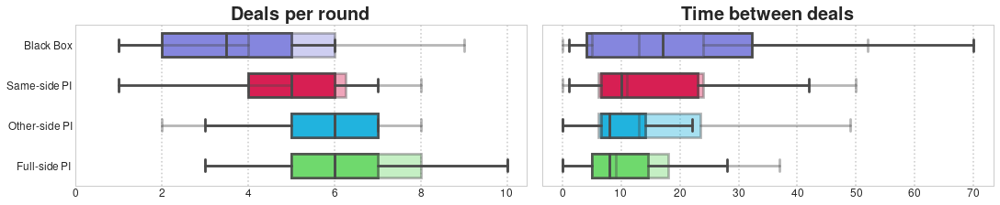

In [201]:
labels = {'BB': 'Black Box', 'Same': 'Same-side PI', 'Other': 'Other-side PI', 'Full': 'Full-side PI'}

fig, ax = plt.subplots(1, 2, figsize=(15,3), sharey=True, constrained_layout=True)

dt_deals = pd.DataFrame([(row['Feedback'],) + (row['Round'],) + (v,) for idx, row in deals.iterrows() for v in row['Time between deals']], columns=['Feedback', 'Round', 'dt'])

for idx, data in enumerate([deals, dt_deals]):
    x = 'Deals' if idx == 0 else 'dt'
    for rounds in [[1], range(1,11)]:
        _ = sns.boxplot(x=x, y='Feedback', data=data[data['Round'].isin(rounds)],
                        order=['BB', 'Same', 'Other', 'Full'], orient='h', ax=ax[idx], 
                        width=0.6, showfliers=False, palette=feedback_palette)

    for i, artist in enumerate(ax[idx].artists):
        if i >= 4:
            _ = artist.set(alpha=0.4)

    for i, line in enumerate(ax[idx].lines):
        if i >= 20:
            _ = line.set(alpha=0.4)
      
_ = ax[0].set_title(r'\textbf{Deals per round}', fontsize=20)
_ = ax[1].set_title(r'\textbf{Time between deals}', fontsize=20)

_ = ax[0].set_xticks(range(0,11,2))
_ = ax[0].set_yticklabels(labels.values())

for axi in ax:
    _ = axi.set_xlabel('')
    _ = axi.set_ylabel('')
    
_ = plt.savefig('Figures/Deals.pdf', bbox_inches='tight', transparent=True)

#### Deal-price feedback

Median absolute feedback distance to the deal-price impulse

Same                                                Other            \
   Buyers                    Sellers                    Buyers             
   Median $p$-value P(X > Y)  Median $p$-value P(X > Y) Median $p$-value   
1    10.0       0.0     0.21    12.0       0.0     0.30   18.5       0.0   
2    10.0       0.0     0.29     5.0       0.0     0.26   13.0       0.0   
3     9.0       0.0     0.26     5.0       0.0     0.25   10.0       0.0   
4     7.0       0.0     0.25     6.0       0.0     0.30    9.0       0.0   
5     6.0       0.0     0.26     7.0       0.0     0.31    6.0       0.0   
6     5.0       0.0     0.26     5.0       0.0     0.30    8.0       0.0   
7     5.0       0.0     0.31     5.0       0.0     0.30    5.0       0.0   
8     4.0       0.0     0.26     5.0       0.0     0.39    4.0       0.0   
9     5.0       0.0     0.34     4.0       0.0     0.30    4.0       0.0   
10    4.0       0.0     0.28     3.0       0.0     0.30    5.0       0.0   

                                         Full                             \
            Sellers                    Buyers                    Sellers   
   P(X > Y)  Median $p$-value P(X > Y) Median $p$-value P(X > Y)  Median   
1      0.29    10.0       0.0     0.28   21.0       0.0     0.33    20.0   
2      0.32     7.0       0.0     0.33   18.0       0.0     0.41    15.0   
3      0.33    10.0       0.0     0.33   15.0       0.0     0.40    14.0   
4      0.31     8.0       0.0     0.35   11.0       0.0     0.38    11.0   
5      0.30     5.0       0.0     0.25   10.0       0.0     0.37    10.0   
6      0.32     5.0       0.0     0.30    8.0       0.0     0.37    10.0   
7      0.30     7.0       0.0     0.36    8.0       0.0     0.41     8.0   
8      0.27     5.0       0.0     0.39    7.0       0.0     0.37     8.0   
9      0.27     4.0       0.0     0.33    7.0       0.0     0.38     8.0   
10     0.34     3.0       0.0     0.30    7.0       0.0     0.38     8.0   

                          PI                                                \
                      Buyers                    Sellers                      
   $p$-value P(X > Y) Median $p$-value P(X > Y)  Median $p$-value P(X > Y)   
1        0.0     0.38   19.0       0.0     0.30    19.0       0.0     0.36   
2        0.0     0.40   15.0       0.0     0.38    14.0       0.0     0.37   
3        0.0     0.39   12.0       0.0     0.36    11.0       0.0     0.36   
4        0.0     0.38   10.0       0.0     0.35    10.0       0.0     0.36   
5        0.0     0.36    8.0       0.0     0.35    10.0       0.0     0.35   
6        0.0     0.41    8.0       0.0     0.35     8.0       0.0     0.38   
7        0.0     0.40    7.0       0.0     0.38     8.0       0.0     0.38   
8        0.0     0.42    5.0       0.0     0.34     8.0       0.0     0.41   
9        0.0     0.43    6.0       0.0     0.37     7.0       0.0     0.40   
10       0.0     0.40    6.0       0.0     0.36     7.0       0.0     0.38   

       BB          
   Buyers Sellers  
   Median  Median  
1    50.0    32.0  
2    28.0    23.0  
3    22.0    21.0  
4    19.0    18.0  
5    16.0    18.0  
6    15.0    15.0  
7    12.5    13.0  
8    14.0    12.0  
9    12.0    12.0  
10   12.0    12.0

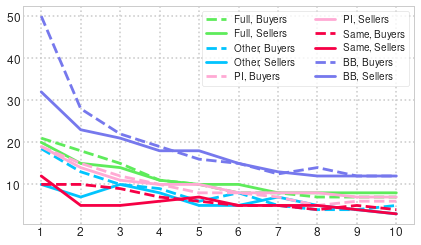

In [202]:
printmd('Median absolute feedback distance to the deal-price impulse')
df_results = MWW_feedback('distDeal')
feedbackDistance_rounds(df_results)

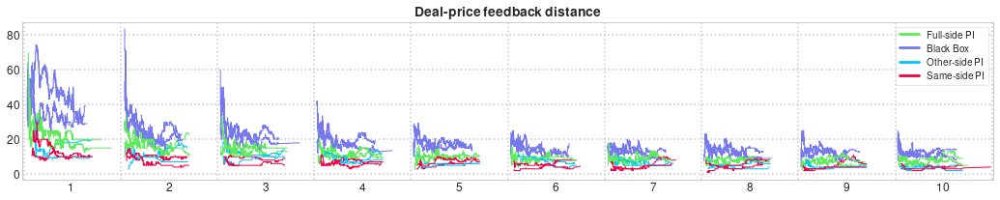

In [203]:
distance_evolution('distDeal', 'Deal-price feedback distance')

### Relative demands over time

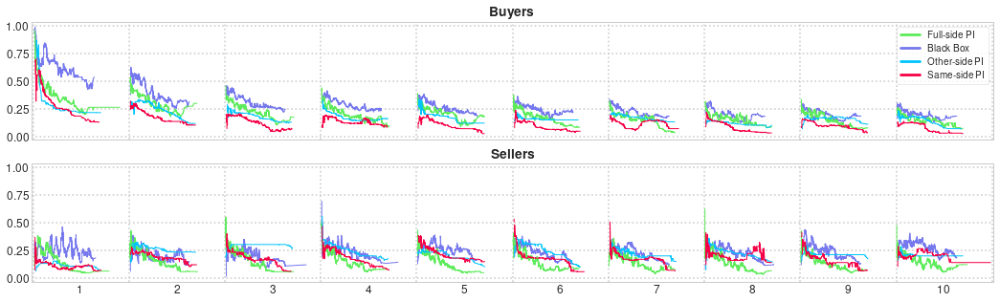

In [204]:
fig, axes = plt.subplots(2,1, figsize=(18,5), sharex=True, sharey=True)
new_labels = {'BB': 'Black Box', 'Same': 'Same-side PI', 'Other': 'Other-side PI', 'Full': 'Full-side PI'}

data = df_feedback[(df_feedback['round'] <= 10) & (df_feedback['time'] <= 200)].copy()
rounds = np.arange(1,11)
time_elapsed = pd.Series((max(data['time'])+9)//10*10, index=rounds)
time_elapsed = time_elapsed.expanding(1).sum()
time_elapsed.loc[time_elapsed.first_valid_index() - 1] = 0
time_elapsed.sort_index(inplace=True)
time_steps = time_elapsed.rolling(2).mean().shift(-1)[:-1]
data['time_elapsed'] = data.apply(lambda row: row['time'] + time_elapsed[row['round'] - 1], axis=1)

for idx, (side, df_side) in enumerate(data.groupby(['side'])):
    ax = axes[idx]
    
    _ = ax.set_title(r'\textbf{{{}s}}'.format(side))   
    _ = ax.set_xlabel('Round');
    _ = ax.set_ylabel('Rolling median');
    _ = ax.set_xticks(ticks=time_steps)
    _ = ax.set_xticks(time_elapsed, minor=True)
    _ = ax.set_xlim(min(time_elapsed)-2, max(time_elapsed)+2)
    _ = ax.xaxis.grid(True, which='minor')
    _ = ax.xaxis.grid(False, which='major')
    _ = ax.set_xticklabels(rounds, size=12)

    for (rnd, feedback), dff in df_side.groupby(['round', 'feedback']):
        dff.sort_values('time_elapsed', inplace=True)
        dff = dff.reset_index()

        dff['rolling_median'] = dff['reldemand'].rolling(100, min_periods=5).median()

        _ = sns.lineplot(x='time_elapsed', y='rolling_median', data=dff, ax=ax, color=feedback_palette[feedback],
                         ci=None, estimator=None, **{'linewidth': 1, 'alpha': 1})
    
    _ = ax.set_xlabel('');
    _ = ax.set_ylabel('');
    
legend_elements = []

for feedback in df_side['feedback'].unique():
    legend_elements.append(Line2D([0], [0], color=feedback_palette[feedback], label=new_labels[feedback]))

_ = axes[0].legend(handles=legend_elements, fontsize=10, loc=1)

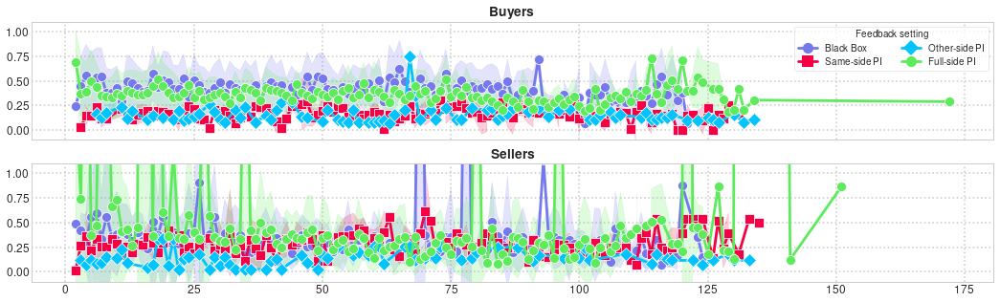

In [205]:
new_labels = {'BB': 'Black Box', 'Same': 'Same-side PI', 'Other': 'Other-side PI', 'Full': 'Full-side PI'}

fig, axes = plt.subplots(2,1, figsize=(18,5), sharex=True, sharey=True)

for idx, (side, df_side) in enumerate(data.groupby(['side'])):
    ax = axes[idx]
    df_side = df_side.reset_index()
    
    _ = ax.set_title(r'\textbf{{{}s}}'.format(side))   
    _ = ax.set_xlabel('Round');
    _ = ax.set_ylabel('Rolling median');
    
    df_side['rolling_median'] = df_side.groupby(['treatment', 'game', 'round'], sort=False).rolling(20, min_periods=1)['reldemand'].median().reset_index(drop=True)
    
    _ = sns.lineplot(x='time_elapsed', y='rolling_median', markers=markers, style='feedback', legend='brief', data=df_side[df_side['round'] <= 1], ci='sd', estimator='mean', hue='feedback',
                     hue_order=['BB', 'Same', 'Other', 'Full'], ax=ax, palette=feedback_palette, markersize=10, dashes=False)

    _ = ax.set_ylim((-0.1,1.1))
    _ = ax.set_xlabel('');
    _ = ax.set_ylabel('');
    
    if idx == 0:
        handles, labels = ax.get_legend_handles_labels()
        labels = [new_labels[label] for label in labels]
        _ = ax.legend(handles, labels, fancybox=True, ncol=2, fontsize=10, title='Feedback setting', loc=1, framealpha=0.8)
    else:
        _ = ax.get_legend().remove()
        
_ = plt.savefig('Figures/EvolReldemandsRound1.pdf', bbox_inches='tight', transparent=True)